# Model + data reference code

## Data Loading and Processing

### big data set (unused)
this dataset is too big to run on google colab

In [ ]:
# !gdown --id 17-FCstm8Fz3bDzFgTmOWHa_c39lTR_1P -O CMFD_1.zip
# !gdown --id 1XClQlP9_V6UmmnwTyzjF28vlrVHNSw2H -O CMFD_2.zip
# !gdown --id 1gjltyD_MnNWcnd56NnjUOizdi39CUEPF -O IMFD_1.zip
# !gdown --id 1qvbcuTHSLBTxQd3wXNAUIYVXBBJCa2WF -O IMFD_2.zip

### kaggle dataset

In [ ]:
from typing import Tuple
import os
from tqdm import tqdm
import cv2
import numpy as np

###############################
# Loading in data
###############################
def find_dir_within_path(path, dir_name):
  for root_path, list_of_dirs, list_of_files in os.walk(path):
    if dir_name in list_of_dirs:
      return str(os.path.join(root_path, dir_name))
  raise Exception(f'Directory {dir_name} not found under {path}')

def fetch_dataset_path():
  try:
    import kagglehub
    dataset_path = kagglehub.dataset_download('ashishjangra27/face-mask-12k-images-dataset')
  except ImportError:
    print("Could not import kagglehub")
    dataset_path = find_dir_within_path(os.getcwd(), 'face-mask-12k-images-dataset')
  return dataset_path


###############################
# preprocessing data
###############################
def get_balanced_data_batch_from_each_class(data:np.ndarray, labels:np.ndarray, batch_size=0)->Tuple[np.ndarray, np.ndarray]:
  assert len(data) == len(labels)
  assert batch_size is not None and batch_size > 0

  balanced_indices = []
  for c in np.unique(labels):
      class_indices = np.where(np.asarray(labels) == c)[0]
      selected = np.random.choice(class_indices, min(batch_size, len(class_indices)), replace=False)
      balanced_indices.extend(selected)
  return data[balanced_indices], labels[balanced_indices]

def one_hot_encode(label_indexes:np.ndarray)->np.ndarray:
  num_classes = len(np.unique(label_indexes))
  I = np.eye(num_classes)
  return I[label_indexes]

def load_images_from_directory(directory:str, image_size = (40,40), balanced_data = True, image_mode = cv2.IMREAD_COLOR, num_classes = 4)->Tuple[np.ndarray, np.ndarray, list]:
    data, label_indexes = [], []
    class_labels = list(set(os.listdir(directory)))[:num_classes]
    assert len(class_labels) > 0
    for label_index, class_name in enumerate(class_labels):
        class_path = os.path.join(directory, class_name)
        if not os.path.isdir(class_path):
            continue
        for img_name in tqdm(os.listdir(class_path), desc=f"Loading {class_name} from {directory}"):
            img = cv2.imread(os.path.join(class_path, img_name), image_mode)
            if img is None:
                continue
            if image_mode == cv2.IMREAD_COLOR:
              img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, image_size).astype(np.float32) / 255.0
            if image_mode == cv2.IMREAD_GRAYSCALE:
              img = np.asarray(img).reshape((*image_size, 1))
            data.append(img)
            label_indexes.append(label_index)
    data = np.asarray(data)
    label_indexes = np.asarray(label_indexes)
    if balanced_data:
      _, counts = np.unique(label_indexes, return_counts=True)
      print(f"Class counts: {counts}")
      max_numer_choices = int(np.min(counts))
      print(f"Balancing data with {max_numer_choices=} examples from each class")
      data, label_indexes = get_balanced_data_batch_from_each_class(data, label_indexes, max_numer_choices)
    # one-hot encode
    labels = one_hot_encode(label_indexes)
    return data, labels, class_labels

## Network

### Network Utils

In [ ]:
import numpy as np
NEAR_ZERO = 1e-8
def get_windows_for_kernel(data:np.ndarray, single_kernel_shape:tuple, output_shape:tuple, stride=1)->np.ndarray:
    """
    Returns a strided view of data for extracting sliding windows.
    The view shape is: output_shape + (1, *single_kernel_shape)
    and the corresponding strides are: (s0, stride*s1, stride*s2, 0, s1, s2, s3)
    """
    assert data.ndim == 4
    view_shape = output_shape + single_kernel_shape  # e.g., (N, outH, outW, kH, kW, C)
    s0, s1, s2, s3 = data.strides
    mem_strides = (s0, stride * s1, stride * s2, s1, s2, s3)
    return np.lib.stride_tricks.as_strided(data, shape=view_shape, strides=mem_strides)

def get_windows_output_base_shape(data_shape, kernels_shape, stride=1)->tuple:
    N, H, W, _ = data_shape
    _, kH, kW, _ = kernels_shape
    outH = (H - kH) // stride + 1
    outW = (W - kW) // stride + 1
    return N, outH, outW

class AdamLearn:

    def __init__(self, rho1=.9, rho2=.999, delta =NEAR_ZERO):
        self.rho1 = rho1
        self.rho2 = rho2
        self.delta = delta
        self.iterations = 1
        self.s = 0
        self.r = 0
        self.relative_multiplier = 0

    def getAdamGrad(self, grads):
        self.s = self.rho1 * self.s + (1-self.rho1) * grads
        self.r = self.rho2 * self.r + (1-self.rho2) * np.power(grads,2)
        top_term = np.divide(
            self.s,
             1-np.power(self.rho1,self.iterations)
         )
        bottom_term = np.sqrt(np.divide(
            self.r,
            1-np.power(self.rho2,self.iterations)
        )) + self.delta
        self.iterations += 1
        output = top_term / bottom_term
        self.relative_multiplier = np.mean(np.divide(grads, output + NEAR_ZERO))
        assert output.shape == grads.shape
        return output

    def get_relative_multiplier(self):
        return self.relative_multiplier

### Layers

#### Abstract classes

In [ ]:
from abc import ABC, abstractmethod
import numpy as np
class Layer(ABC):
    def __init__(self):
        self.__prev_in = np.asarray([])
        self.__prev_out = np.asarray([])
        self.__debug_mode = False
    def set_prev_in(self, dataIn):
        self.__prev_in = dataIn
    def set_prev_out(self, out):
        self.__prev_out = out
    def get_prev_in(self):
        return self.__prev_in
    def get_prev_out(self):
        return self.__prev_out
    def set_debug_mode(self, debug_mode=False):
        self.__debug_mode = debug_mode
    @abstractmethod
    def forward(self, data_in:np.ndarray)->np.ndarray:
        pass
    def backward(self,gradIn:np.ndarray)->np.ndarray:
        sg = self.gradient()
        if(sg.ndim == 3):  #tensor coming back
            gradOut = np.zeros((gradIn.shape[0],sg.shape[2]))
            for i in range(gradIn.shape[0]):
                gradOut[i] = np.atleast_2d(gradIn[i])@np.atleast_2d(sg[i])
        else:
            gradOut = np.atleast_2d(gradIn)@sg
        return gradOut

    def backward2(self, gradIn:np.ndarray)->np.ndarray:
        sg = self.gradient()
        return np.multiply(gradIn, sg)
    @abstractmethod
    def get_output_shape(self, input_shape):
        pass
    @abstractmethod
    def gradient(self, *args):
        pass
class Activation(Layer):
    def __init__(self):
        super().__init__()
    @abstractmethod
    def activation_function(self, x):
        pass
    def forward(self, data_in):
        self.set_prev_in(data_in)
        data_out = self.activation_function(data_in)
        assert data_out.shape == data_in.shape
        self.set_prev_out(data_out)
        return data_out
    def get_output_shape(self, input_shape):
        return input_shape
class ObjectiveLayer(Layer):
    def __init__(self):
        super().__init__()
    def forward(self, data_in):
        pass
    def backward(self, *grad):
        pass
    def eval(self, prediction, truth):
        pass
    def get_output_shape(self, input_shape):
        return input_shape
    @abstractmethod
    def gradient(self, prediction, truth):
        pass
class WeightedLayer(Layer):
    def __init__(self):
        super().__init__()
        self.is_adaptive = False
    @abstractmethod
    def set_adaptive(self, is_adaptive=False):
        pass
    @abstractmethod
    def update_weights(self, grad, learning_rate):
        pass

#### Util Layers

In [ ]:
class FlatteningLayer(Layer):
    def __init__(self):
        super().__init__()
    def forward(self, data):
        self.input_shape = data.shape
        return data.reshape(data.shape[0], -1)
    def gradient(self, data):
        pass
    def backward(self, grad):
        return grad.reshape(self.input_shape)
    def get_output_shape(self, input_shape):
        return tuple((input_shape[0], np.prod(input_shape[1:], dtype=int)))
a = np.random.rand(2, 4)
b = a.reshape(2, 2, 2)
FL = FlatteningLayer()

assert FL.get_output_shape(b.shape) == a.shape
assert np.allclose(FL.forward(b), a)
assert np.allclose(FL.backward(a), b)


In [ ]:
def max_pool_argmax_4d(data, window_size, stride=1):
  assert data.ndim == 4, f'{data.ndim=} '
  channels = data.shape[-1]
  single_kernel_shape = (window_size, window_size, channels)
  flattened_kernel_len = window_size ** 2
  base_output_shape = get_windows_output_base_shape(data.shape, (1, *single_kernel_shape), stride)
  # get windows and prep for argmax
  data_inds = np.arange(np.prod(data.shape)).reshape(data.shape)
  windows = get_windows_for_kernel(data, single_kernel_shape, base_output_shape, stride)
  windows_flattened = windows.reshape(-1, channels, flattened_kernel_len)
  windows_inds = get_windows_for_kernel(data_inds, single_kernel_shape, base_output_shape, stride)
  windows_inds_flattened = windows_inds.reshape(-1, channels, flattened_kernel_len)
  # need argmax instead of max because we need to save the indexes
  flat_windows_max_indexes = np.argmax(windows_flattened, axis=-1, keepdims=True)
  data_inds_flattened = np.take_along_axis(windows_inds_flattened, flat_windows_max_indexes, axis=-1)
  # unraveled indexes relative to original data
  full_indexes_list = np.unravel_index(data_inds_flattened, data.shape)
  return np.array(data[full_indexes_list]).reshape((*base_output_shape, -1)), full_indexes_list

class MaxPoolingLayer(Layer):
    def __init__(self, kernel_size, stride=1):
        super().__init__()
        assert stride>=1
        self.kernel_size = kernel_size
        self.stride = stride
        self.max_indexes = ()

    def forward(self,dataIn):
        self.set_prev_in(dataIn)
        output, self.max_indexes = max_pool_argmax_4d(dataIn, self.kernel_size, stride=self.stride)
        return output

    def backward(self,gradIn):
        channels = self.get_prev_in().shape[-1]
        gradOut = np.asarray(np.zeros_like(self.get_prev_in()))
        gradOut[self.max_indexes] = gradIn.reshape(-1, channels, 1)
        return gradOut

    def gradient(self):
        pass
    def get_output_shape(self, input_shape):
        assert len(input_shape) == 4
        channels = input_shape[-1]
        kernel_shape = (1, self.kernel_size, self.kernel_size, input_shape[-1])
        output_shape = get_windows_output_base_shape(input_shape, kernel_shape, stride=self.stride)
        return (*output_shape, channels)

MP = MaxPoolingLayer(kernel_size=2, stride=2)
a = np.arange(4*4).reshape(1, 4, 4, 1)
a_pooled = np.asarray([5,7,13,15]).reshape(1,2,2,1)
a_mask = np.sum([a == val for val in a_pooled.flatten()], axis=0)
assert np.allclose(MP.forward(a), a_pooled)
assert np.allclose(MP.backward(a_pooled), np.where(a_mask, a, 0))
assert MP.get_output_shape(a.shape) == a_pooled.shape

#### Activation Layers

In [ ]:
class ReLU(Activation):
    def activation_function(self, x):
        return np.maximum(0, x)
    def gradient(self):
        return self.get_prev_in() > 0
    def backward(self, grad):
        return np.where(self.get_prev_in() > 0, grad, 0)
RL = ReLU()
a = np.random.rand(2, 4) - 0.5
a_mask = a > 0
b = np.random.rand(2, 4)
assert np.allclose(RL.forward(a), np.where(a_mask, a, 0))
assert np.allclose(RL.backward(b), np.where(a_mask, b, 0))

In [ ]:
class SoftmaxLayer(Activation):
    def __init__(self):
        super().__init__()
    def activation_function(self, data):
        axis = 0
        if np.ndim(data) > 1:
            axis = 1
        max_data = np.max(data, axis=axis, keepdims=True)
        e_x = np.exp(data - max_data)
        return e_x/np.sum(e_x, axis=axis, keepdims=True)
    def gradient(self):
        # TODO
        prev_out = self.get_prev_out()
        prev_out_shape = prev_out.shape
        output = np.zeros((*prev_out_shape, prev_out_shape[-1]))
        if output.ndim == 2:
            data = np.asarray(prev_out)
            return np.diag(data) - np.dot(data.T, data)
        for _i, data in enumerate(prev_out):
            g_z = np.array([data])
            output[_i] = np.diag(data) - np.dot(g_z.T, g_z)
        return output


#### Objective Layers

In [ ]:
class CrossEntropy(ObjectiveLayer):

    def __init__(self):
        super().__init__()
        self.prediction = None
        self.target = None

    def eval(self, prediction, target):
        self.prediction = prediction
        self.target = target
        prediction = np.clip(prediction, NEAR_ZERO, 1 - NEAR_ZERO)
        return -np.mean(np.sum(target * np.log(prediction), axis=1))

    def gradient(self, prediction, target):
        assert prediction.shape == target.shape
        return - np.divide(target, prediction + NEAR_ZERO)

#### Weighted Layers

In [ ]:
# xavier initialization for softmax
def xavier_initialization_uniform(shape):
  limit = np.sqrt(6/(np.sum(shape)))
  return np.random.uniform(-limit, limit, shape)

def xavier_initialization_normal(shape):
  stddev = np.sqrt(2/(np.sum(shape)))
  weights = np.random.normal(0, stddev, shape)

def initialization_uniform(shape):
  return np.random.uniform(-NEAR_ZERO, NEAR_ZERO, shape)

# kaiming initialization for relu and linear
def kaiming_initialization(shape, activation='relu'):
    if activation == 'relu':
        gain = np.sqrt(2.0)
    elif activation == 'linear':
        gain = 1.0
    else:
        raise ValueError("Activation function not supported.")
    fan_in = shape[0]
    std = gain / np.sqrt(fan_in)
    return np.random.normal(loc=0.0, scale=std, size=shape)

class FullyConnectedLayer(WeightedLayer):

    def init_weights(self):
        if self.sizeIn < 1: return
        self.weights = np.asarray(self.weight_initializer((self.sizeIn, self.sizeOut)))
        self.bias = np.asarray(self.weight_initializer((1, self.sizeOut)))

    def __init__(self, sizeIn, sizeOut, is_adaptive=False, weight_initializer=initialization_uniform):
        # +- NEAR_ZERO value
        super().__init__()
        self.sizeIn = sizeIn
        self.sizeOut = sizeOut
        self.weight_initializer = weight_initializer
        self.init_weights()
        self.set_adaptive(is_adaptive)

    def set_adaptive(self, is_adaptive=False):
        self.weights_adaptive = AdamLearn()
        self.bias_adaptive = AdamLearn()
        self.is_adaptive = is_adaptive
        return self

    def get_weights(self):
        return self.weights

    def set_weights(self, weights):
        self.weights = weights

    def get_biases(self):
        return self.bias

    def set_biases(self, bias):
        self.bias = bias

    def forward(self, data_in):
        self.set_prev_in(data_in)
        out = np.dot(data_in, self.weights) + self.bias
        self.set_prev_out(out)
        return out

    def update_weights(self, gradIn, eta):
        N = gradIn.shape[0]
        dJdb = np.sum(gradIn, axis=0) / N
        dJdW = (self.get_prev_in().T @ gradIn) / N
        if self.is_adaptive:
            dJdb = self.bias_adaptive.getAdamGrad(dJdb)
            dJdW = self.weights_adaptive.getAdamGrad(dJdW)
        self.weights -= eta * dJdW
        self.bias -= eta * dJdb

    def get_output_shape(self, input_shape):
        return (self.sizeOut)

    def gradient(self):
        return self.weights.T

    def backward(self, gradIn):
        return gradIn @ self.weights.T

In [ ]:
def cross_correlation_4d(data:np.ndarray, kernels:np.ndarray, stride=1):
    assert data.ndim == 4 and kernels.ndim == 4
    assert data.shape[-1] == kernels.shape[-1]
    # data: (N, H, W, C); kernels: (K, kH, kW, C)
    output_base_shape = get_windows_output_base_shape(data.shape, kernels.shape, stride)
    single_kernel_shape = kernels.shape[1:]
    flattened_kernel_len = np.prod(single_kernel_shape)
    windows = get_windows_for_kernel(data, single_kernel_shape, output_base_shape, stride)
    # windows shape: (N, outH, outW, kH, kW, C)
    windows_reshaped = windows.reshape(*output_base_shape, flattened_kernel_len)
    # Reshape kernels to (kH*kW*C, K)
    kernels_reshaped = kernels.reshape(-1, flattened_kernel_len).T
    # Matrix multiply to get output of shape (N, outH, outW, K)
    return np.matmul(windows_reshaped, kernels_reshaped)

class ConvolutionalLayer(WeightedLayer):
    def __init__(self, kernel_size, channels = 1, number_kernels=1, is_adaptive=False, weight_initializer=initialization_uniform):
        super().__init__()
        assert kernel_size >= 1
        assert channels >= 1
        assert number_kernels >= 1
        self.kernels = weight_initializer((
            number_kernels,
            kernel_size, kernel_size,
            channels
        ))
        self.set_adaptive(is_adaptive)

    def get_weights(self):
        return self.kernels

    def get_kernels(self):
        return self.kernels

    def get_output_shape(self, input_shape):
        output_shape_base = get_windows_output_base_shape(input_shape, self.kernels.shape)
        return (*output_shape_base, self.kernels.shape[0])

    def set_adaptive(self, is_adaptive=True):
        self.kernels_adaptive = AdamLearn()
        self.is_adaptive = is_adaptive
        return self

    def set_kernels(self, kernels):
        if kernels.ndim == 2:
            self.kernels = kernels.reshape(1,*kernels.shape, 1)
        elif kernels.ndim == 4:
            self.kernels = np.asarray(kernels, dtype=float)

    def gradient(self):
        pass

    def forward(self, dataIn):
        assert dataIn.ndim == 4
        self.set_prev_in(dataIn)
        output = cross_correlation_4d(dataIn, self.kernels)
        assert output.ndim == 4
        self.set_prev_out(output)
        return output

    def update_weights(self, gradIn, eta):
        self.update_kernels(gradIn, eta)

    def update_kernels(self, gradIn, learning_rate):
        # mean along axis 0 (data count)
        # TODO: update
        sum_data = np.sum(
            self.get_prev_in(), axis=0, keepdims=True
        ).transpose((3,1,2,0))
        # To convolute all kernels at once
        gradIn_sum_per_kernel = np.sum(
            gradIn, axis=0, keepdims=True
        ).transpose((3,1,2,0))
        # undo transpose
        dKdj = cross_correlation_4d(
            sum_data,
            gradIn_sum_per_kernel
        ).transpose((3,1,2,0))
        if self.is_adaptive:
            dKdj = self.kernels_adaptive.getAdamGrad(dKdj)
        self.kernels -= learning_rate * dKdj

    def backward(self,gradIn):
        # TODO: update
        pad_size=self.kernels[0].shape[0]-1
        # default 0
        z_pad_grad_in = np.pad(gradIn,
                               (
                                   (0,0),
                                   (pad_size, pad_size),
                                   (pad_size, pad_size),
                                   (0,0),
                               )
                                , 'constant')
        gradOut = cross_correlation_4d(
            z_pad_grad_in, self.kernels.transpose(3, 2, 1, 0)
        ).reshape(self.get_prev_in().shape)
        return gradOut

def get_windows_ref(data, kernel_shape, output_shape, stride=1):
    (kH, kW) = kernel_shape
    (N, outH, outW) = output_shape
    view_shape = (N, outH, outW, kH, kW, data.shape[3])
    strides = (
        data.strides[0],
        data.strides[1] * stride,
        data.strides[2] * stride,
        data.strides[1],
        data.strides[2],
        data.strides[3]
    )
    return np.lib.stride_tricks.as_strided(data, view_shape, strides)

def cross_correlation_4d_ref(data, kernels, stride=1):
    N, H, W, C = data.shape
    kn, kH, kW, kC = kernels.shape
    assert C == kC, "Channel mismatch: data C != kernel C"
    outH = (H - kH) // stride + 1
    outW = (W - kW) // stride + 1
    windows = get_windows_ref(data, (kH, kW), (N, outH, outW), stride)
    windows_reshaped = windows.reshape(N * outH * outW, kH * kW * C)
    kernels_reshaped = kernels.reshape(kn, kH * kW * C).T
    out = windows_reshaped @ kernels_reshaped
    out = out.reshape(N, outH, outW, kn)
    return out

class ConvolutionalLayerRef(Layer):
    def __init__(self, kernel_size, channels=1, number_kernels=1, adaptive=False):
        super().__init__()
        self.kernels = np.random.rand(number_kernels, kernel_size, kernel_size, channels) * 2 * NEAR_ZERO - NEAR_ZERO
        self.is_adaptive = adaptive
        if adaptive:
            self.kernels_adaptive = AdamLearn()
    def get_weights(self):
        pass
    def get_output_shape(self, input_shape):
        pass
    def set_weights(self, weights):
        pass
    def setAdaptive(self, is_adaptive=True):
        self.is_adaptive = is_adaptive
        if is_adaptive:
            self.kernels_adaptive = AdamLearn()
        return self

    def forward(self, data_in: np.ndarray) -> np.ndarray:
        assert data_in.ndim == 4, "Input must be (N, H, W, C)"
        self.set_prev_in(data_in)
        out = cross_correlation_4d_ref(data_in, self.kernels, stride=1)
        self.set_prev_out(out)
        return out

    def gradient(self) -> np.ndarray:
        return self.kernels

    def backward(self, grad_in: np.ndarray) -> np.ndarray:
        flipped_kernels = np.flip(self.kernels, (1, 2)).transpose(3, 1, 2, 0)
        pad_size=self.kernels[0].shape[0]-1
        # default 0
        z_pad_grad_in = np.pad(grad_in,
                               (
                                   (0,0),
                                   (pad_size, pad_size),
                                   (pad_size, pad_size),
                                   (0,0),
                               )
                                , 'constant')
        out = cross_correlation_4d_ref(z_pad_grad_in, flipped_kernels, stride=1)
        return out

    def update_kernels(self, grad: np.ndarray, lr: float):
        """
        Compute the gradient with respect to the kernels.
        grad: gradient of loss with respect to layer output, shape (N, outH, outW, number_kernels)
        The gradient for the kernels is computed by correlating the input windows with grad.
        """
        X = self.get_prev_in()  # shape: (N, H, W, C)
        N, H, W, C = X.shape
        kn, kH, kW, _ = self.kernels.shape
        # For 'valid' convolution with stride 1, output shape is:
        outH = H - kH + 1
        outW = W - kW + 1
        # Extract sliding windows from input X:
        windows = get_windows_ref(X, (kH, kW), (N, outH, outW), stride=1)
        # windows shape: (N, outH, outW, kH, kW, C)
        windows_reshaped = windows.reshape(N * outH * outW, kH * kW * C)  # shape: (N*outH*outW, kH*kW*C)
        grad_reshaped = grad.reshape(N * outH * outW, kn)  # shape: (N*outH*outW, kn)
        # Compute kernel gradient:
        # Multiply windows^T (shape: (kH*kW*C, N*outH*outW)) by grad_reshaped (shape: (N*outH*outW, kn))
        grad_kernels = (windows_reshaped.T @ grad_reshaped)  # shape: (kH*kW*C, kn)
        grad_kernels = grad_kernels.reshape(kH, kW, C, kn).transpose(3, 0, 1, 2)  # shape: (kn, kH, kW, C)
        if self.is_adaptive:
            grad_kernels = self.kernels_adaptive.get_grad(grad_kernels)
        self.kernels -= lr * grad_kernels

cl = ConvolutionalLayer(kernel_size=9, channels=3, number_kernels=3)
clr = ConvolutionalLayerRef(kernel_size=9, channels=3, number_kernels=3)
X = np.random.rand(255, 40, 40, 3)
kernels = clr.kernels
cl.kernels = kernels
cl_out = cl.forward(X)
clr_out = clr.forward(X)
assert np.allclose(cl_out, clr_out)

cl_grad = clr_out
cl.update_kernels(cl_grad, 1)
clr.update_kernels(cl_grad, 1)
assert np.allclose(cl.kernels, clr.kernels)

clb = cl.backward(cl_grad)
clrb = clr.backward(cl_grad)
print(f'{clb.shape=}')
print(f'{clrb.shape=}')
assert np.allclose(clb, clrb)

clb.shape=(255, 40, 40, 3)
clrb.shape=(255, 40, 40, 3)


## Network Class

In [ ]:
import datetime
import pickle
import os
import matplotlib.pyplot as plt
import numpy as np
from collections.abc import Callable
import seaborn as sns
import time
import pandas as pd

def accuracy(output, target):
    y_pred = np.argmax(output, axis=1)
    y_true = np.argmax(target, axis=1)
    return np.mean(y_pred == y_true)

class Model:
    def __init__(self, layers:list, name = f'model'):
        self.layers = layers
        self.name = name
        self.train_loss_list = []
        self.train_first_eval_list = []
        self.test_first_eval_list = []
        self.test_loss_list = []
    def set_layers_input_shapes(self, input_shape):
      layer_output_shape_list = []
      print(f'{input_shape=}')
      for i, layer in enumerate(self.layers):
        if isinstance(layer, FullyConnectedLayer):
          layer.sizeIn = np.prod(input_shape)
          layer.init_weights()
        layer_output_shape_list.append(layer.get_output_shape(input_shape))
        input_shape = layer_output_shape_list[-1]
        print(f'{i} {layer.__class__.__name__} output shape: {input_shape}')
      return self

    def forward_propagate(self, data_in, target):
        data_store = data_in
        for layer in self.layers:
            if isinstance(layer, ObjectiveLayer):
                return data_store, layer.eval(data_store, target)
            data_store = layer.forward(data_store)
        return data_store, None

    def backward_propagate(self, Y_pred, Y_true, learning_rate = 1e-3):
        grad = self.layers[-1].gradient(Y_pred, Y_true)
        for layer in reversed(self.layers[:-1]):
            new_grad = layer.backward(grad)
            # accounts for both FC and Convolutionsl layers
            if isinstance(layer, WeightedLayer):
                assert grad.shape == layer.get_prev_out().shape
                layer.update_weights(grad, learning_rate)
            grad = new_grad
        return grad
    def plot_learning_curve(self, file_path=None, save=False):
      evaluation_metric = self.evaluation_metrics[0].__name__
      fig, ax1 = plt.subplots()
      ax2 = ax1.twinx()
      ax2.plot(self.train_first_eval_list, 'g-',label=f'Train accuracy {self.train_first_eval_list[-1]:.8f}')
      ax2.plot(self.test_first_eval_list, 'r-',label=f'Test accuracy {self.test_first_eval_list[-1]:.8f}')
      ax1.plot(self.train_loss_list, 'b-', label=f'Train Loss {self.train_loss_list[-1]:.8f}')
      ax1.plot(self.test_loss_list, 'c-', label=f'Test Loss {self.test_loss_list[-1]:.8f}')
      ax1.set_xlabel('epochs')
      ax1.set_ylabel('loss')
      ax2.set_ylabel(evaluation_metric)
      fig.legend(loc='lower left')
      plt.title(f'{evaluation_metric} & loss vs epoch: {len(self.train_loss_list)}')
      plt.show()
      if save and file_path is not None:
          fig_name = f'{evaluation_metric}_loss_v_epoch_{len(self.train_loss_list)}_model_{self.name}_{datetime.datetime.now()}.png'
          fig.savefig(os.path.join(file_path, fig_name))

    def train_model(self,
                    x_train, y_train, x_test, y_test,
                    y_class_labels = [],
                    max_epochs=int(1e5),
                    learning_rate=1e-3,
                    min_loss=1e-3,
                    batch_size=None,
                    graph_display_frequency=10,
                    graph_save_frequency=100,
                    evaluation_metrics=[accuracy],
                    file_path=os.getcwd()):
      assert len(self.layers) > 0
      assert x_train.shape[0] == y_train.shape[0]
      assert x_test.shape[0] == y_test.shape[0]
      assert batch_size is None or batch_size <= x_train.shape[0]
      assert max_epochs > 0
      assert learning_rate > 0
      assert min_loss > 0
      assert evaluation_metrics is not None and len(evaluation_metrics) > 0
      assert np.unique(y_class_labels).shape[0] == np.asarray(y_class_labels).shape[0]
      self.y_class_labels = y_class_labels

      self.train_loss_list = []
      self.train_first_eval_list = []
      self.test_first_eval_list = []
      self.test_loss_list = []
      self.evaluation_metrics = evaluation_metrics
      self.max_epochs = max_epochs
      self.learning_rate = learning_rate
      self.min_loss = min_loss
      self.batch_size = batch_size
      self.graph_display_frequency = graph_display_frequency
      self.graph_save_frequency = graph_save_frequency

      self.set_start_time()
      for epoch in tqdm(range(max_epochs), desc=f'Training model {self.name}'):
        evaluation_list, y_pred_test = self.evaluate_model_performance(x_test, y_test, evaluation_metrics)
        test_loss, test_first_eval, *_ = evaluation_list
        self.test_first_eval_list.append(test_first_eval)
        self.test_loss_list.append(test_loss)
        # TODO: random data transforms etc
        if batch_size is None:
            x_train_batch, y_train_batch = x_train, y_train
        else:
          x_train_batch, y_train_batch = get_balanced_data_batch_from_each_class(x_train, y_train, batch_size)
        evaluation_list, y_pred = self.evaluate_model_performance(x_train_batch, y_train_batch, evaluation_metrics)
        loss, acc, *_ = evaluation_list
        self.train_first_eval_list.append(acc)
        self.train_loss_list.append(loss)
        if len(self.train_loss_list) > 2 and np.abs(self.train_loss_list[-2] - self.train_loss_list[-1]) < min_loss:
            print(f'Early stopping at epoch {epoch}')
            break
        self.backward_propagate(y_pred, y_train, learning_rate=self.learning_rate)
        if epoch % 10 == 0 and epoch > 0:
          will_save = epoch % self.graph_save_frequency == 0
          self.plot_learning_curve(save=will_save, file_path=file_path)
      self.set_end_time()
      self.run_time_seconds = (self.end_time-self.start_time)
      self.plot_learning_curve(save=True, file_path=file_path)
      self.print_model_performance(y_train, y_pred, "Last Training Set",y_test,y_pred_test,"Test Set", file_path=file_path)
      return self

    def save_model(self, file_path):
      assert self.name is not None
      file_name = f'{self.name}_{datetime.datetime.now()}.pkl'
      file_path = os.path.join(file_path, file_name)
      with open(file_path, 'wb') as f:
        pickle.dump(self, f)
      print(f'model saved at {file_path=}')
      return file_path

    @classmethod
    def import_model(self, file_path_name):
      assert os.path.exists(file_path_name) and file_path_name.endswith('.pkl')
      with open(file_path_name, 'rb') as inp:
        self = pickle.load(inp)
      return self

    def evaluate_model_weights(self):
      # TODO implement
      # kernel visualization
      # maximal image generation (optional)
      pass
    def evaluate_model_performance(self, x_test, y_test, evaluation_metrics=[accuracy]):
      # TODO implement
      # confusion matrix
      # TP, FP, TN, FN breakdown
      # accuracy
      # speed
      y_pred, loss = self.forward_propagate(x_test, y_test)
      assert y_pred.shape == y_test.shape
      assert evaluation_metrics is not None
      evaluation_list = [loss]
      for metric in evaluation_metrics:
        if hasattr(metric, "__call__"):
          evaluation_list.append(metric(y_pred, y_test))
      return evaluation_list, y_pred

    def print_model_performance(self,y,yh,title,test_y,test_yh,test_title, file_path = './'):
        names = self.y_class_labels
        train_confusion = self.confusion_matrix(y,yh)
        self.get_nice_confusion(train_confusion,title,names,file_path=file_path,  dataset_type="Train")
        self.create_table_plt(train_confusion,names, file_path=file_path, dataset_type="Train")
        self.create_table_df(train_confusion,names,file_path=file_path, dataset_type="Train")

        test_confusion = self.confusion_matrix(test_y,test_yh)
        self.get_nice_confusion(test_confusion,test_title,names, file_path=file_path, dataset_type="Test")
        self.create_table_plt(test_confusion,names, file_path=file_path, dataset_type="Test")
        self.create_table_df(test_confusion,names, file_path=file_path, dataset_type="Test")

        print("Training Accuracy : ",accuracy(yh, y))
        print("Test Accuracy : ",accuracy(test_yh, y_test))
        print("Run time (minutes) : ",(self.end_time-self.start_time)/60)
        return self

    def set_start_time(self):
        self.start_time = time.perf_counter()

    def set_end_time(self):
        self.end_time = time.perf_counter()

    def confusion_matrix(self,y,yh):
        con_mat = np.zeros((y.shape[1],y.shape[1]))
        for i in range(y.shape[0]):
            con_mat[np.argmax(y[i]),np.argmax(yh[i])] = con_mat[np.argmax(y[i]),np.argmax(yh[i])]+1
        return con_mat

    def get_nice_confusion(self,conf_matrix,title,names, file_path = './', dataset_type=''):
        count = ["{0:0.0f}".format(value) for value in conf_matrix.flatten()]
        percentages = ["{0:.2%}".format(value) for value in (conf_matrix/conf_matrix.sum(axis=1)[:,None]).flatten()]
        labels = [f"{v1}\n{v2}" for v1, v2 in zip(count,percentages)]
        labels = np.asarray(labels).reshape(conf_matrix.shape[0],conf_matrix.shape[1])
        hm = sns.heatmap(conf_matrix, annot=labels, fmt='', xticklabels=names, yticklabels=names, cmap='Blues', linewidths = 2, linecolor = "orange")#, annot_kws={'size': 15})
        hm.set(ylabel="Actual",xlabel="Predicted",title=title)
        plt.show()
        fig_name = f'{dataset_type}_confusion_matrix_model_{self.name}_{datetime.datetime.now()}.png'
        hm.get_figure().savefig(os.path.join(file_path, fig_name))
        # figure.savefig(os.path.join(file_path, fig_name))


    def calculate_metrics(self, conf_matrix):
        true_pos = conf_matrix[np.eye(conf_matrix.shape[0], dtype=bool)]
        tp_fp = np.sum(conf_matrix, axis=0)
        tp_fn = np.sum(conf_matrix, axis=1)
        precision = np.atleast_2d(true_pos/tp_fp)
        recall = np.atleast_2d(true_pos/tp_fn)
        f1score = np.atleast_2d((2*precision*recall)/(precision+recall))
        concat = np.concatenate((precision,recall,f1score), axis=0)
        return concat

    def create_table_plt(self, conf_matrix, labels, file_path='./', dataset_type=''):
        rows = ['Precision','Recall','F1 Score']
        concat = self.calculate_metrics(conf_matrix)
        fig,ax = plt.subplots()
        fig.patch.set_visible(False)
        ax.axis('off')
        ax.axis('tight')
        table = ax.table(cellText=concat, rowLabels=rows, colLabels=labels,loc='center')
        fig.tight_layout()
        plt.show()
        fig_name = f'{dataset_type}_class_metrics_model_{self.name}_{datetime.datetime.now()}.png'
        fig.savefig(os.path.join(file_path, fig_name))

    def create_table_df(self, conf_matrix, labels, file_path='./', dataset_type=''):
        rows = ['Precision','Recall','F1 Score']
        concat = self.calculate_metrics(conf_matrix)
        df = pd.DataFrame(concat, columns=labels, index=rows)
        df.style

        df.to_csv(os.path.join(
            file_path,
            f'{dataset_type}_class_metrics_model_{self.name}_{datetime.datetime.now()}.csv'))
        print(df)



# Training models

## Training utils

### Google drive connection
if you don't want google to access your drive, run the cell and deny the prompt and the results will be saved locally on the runtime instance

In [ ]:
### SHARED  COLAB NOTEBOOK SCRIPT ###
import os
def find_dir_within_path(path, dir_name):
  # os.walk goes recusively through each directory starting at a given path
  # separate os.walk outputs into separate variables
  for root_path, list_of_dirs, list_of_files in os.walk(path):
    # for lists, we can just use this syntax to check if a primitive (int string)
    # is in a list (strings are also lists in python)
    if dir_name in list_of_dirs:
      return str(os.path.join(root_path, dir_name))
  # f-strings have this syntax, avoids doing a + ":" + b
  raise Exception(f'Directory {dir_name} not found under {path}')


try:
  from google.colab import drive
  DRIVE_PATH = '/content/drive'

  if not os.path.exists(DRIVE_PATH):
    drive.mount(DRIVE_PATH)
  shared_path = find_dir_within_path(f'{DRIVE_PATH}/My Drive/', "CS583")
  data_path = find_dir_within_path(shared_path, "models")
except BaseException as e:
  print(e)
  # if not, just find the assignemnt dir
  assignment_path=os.getcwd()
  data_path = assignment_path

print(f'{data_path=}')
os.listdir(data_path)

mount failed
data_path='/content'


['.config', 'sample_data']

### util to clear dir of model

In [ ]:
# directory = ''
# for _file in os.listdir(directory):
#   os.remove(os.path.join(directory, _file))

## full color Models

#### load full color data

['Validation', 'Train', 'Test']


Loading WithoutMask from /root/.cache/kagglehub/datasets/ashishjangra27/face-mask-12k-images-dataset/versions/1/Face Mask Dataset/Train: 100%|██████████| 5000/5000 [00:02<00:00, 2081.08it/s]
Loading WithMask from /root/.cache/kagglehub/datasets/ashishjangra27/face-mask-12k-images-dataset/versions/1/Face Mask Dataset/Train: 100%|██████████| 5000/5000 [00:07<00:00, 665.77it/s]


Class counts: [5000 5000]
Balancing data with max_numer_choices=5000 examples from each class


Loading WithoutMask from /root/.cache/kagglehub/datasets/ashishjangra27/face-mask-12k-images-dataset/versions/1/Face Mask Dataset/Test: 100%|██████████| 509/509 [00:00<00:00, 2063.92it/s]
Loading WithMask from /root/.cache/kagglehub/datasets/ashishjangra27/face-mask-12k-images-dataset/versions/1/Face Mask Dataset/Test: 100%|██████████| 483/483 [00:00<00:00, 671.14it/s]


Class counts: [509 483]
Balancing data with max_numer_choices=483 examples from each class
x_train.shape=(2000, 40, 40, 3), y_train.shape=(2000, 2)
x_test.shape=(966, 40, 40, 3), y_test.shape=(966, 2)


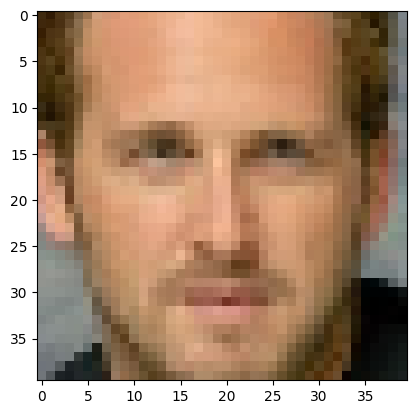

In [ ]:
from os.path import join
import cv2
print(os.listdir(fetch_dataset_path()+'/Face Mask Dataset'))
dataset_path = join(fetch_dataset_path(), 'Face Mask Dataset')
TESTING, TRAINING, VALIDATION = join(dataset_path, 'Test'), join(dataset_path, 'Train'), join(dataset_path, 'Validation')

IMAGE_MODE = cv2.IMREAD_COLOR
# IMAGE_MODE = cv2.IMREAD_GRAYSCALE
image_size = (40, 40)

x_train, y_train, train_class_labels = load_images_from_directory(TRAINING, image_size, image_mode = IMAGE_MODE)
# limit num
n_train_cap = 2000
# TODO: make even sample of masked/nomask
picked_inds = np.random.choice(np.arange(x_train.shape[0], dtype=int), n_train_cap, replace=False)
x_train, y_train = x_train[picked_inds], y_train[picked_inds]

x_test, y_test, test_class_labels = load_images_from_directory(TESTING, image_size, image_mode = IMAGE_MODE)
assert set(train_class_labels) == set(test_class_labels)
num_classes = len(set(train_class_labels))
print(f'{x_train.shape=}, {y_train.shape=}')
print(f'{x_test.shape=}, {y_test.shape=}')
channels = x_train.shape[-1]
assert x_train.shape[0] == y_train.shape[0]
assert x_test.shape[0] == y_test.shape[0]

import matplotlib.pyplot as plt
plt.imshow(x_train[0])
plt.show()

### 3. CNN w/ multiple kernels (on grayscale and/or color)

input_shape=(1, 40, 40, 3)
0 ConvolutionalLayer output shape: (1, 32, 32, 2)
1 ReLU output shape: (1, 32, 32, 2)
2 MaxPoolingLayer output shape: (1, 16, 16, 2)
3 FlatteningLayer output shape: (1, np.int64(512))
4 FullyConnectedLayer output shape: 2
5 SoftmaxLayer output shape: 2
6 CrossEntropy output shape: 2


Training model color_cnn_multi_kernel:   0%|          | 10/10000 [00:51<14:11:03,  5.11s/it]

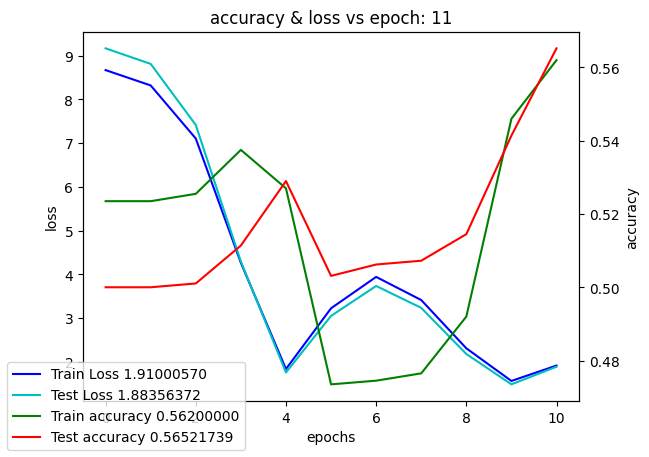

Training model color_cnn_multi_kernel:   0%|          | 20/10000 [01:42<14:09:54,  5.11s/it]

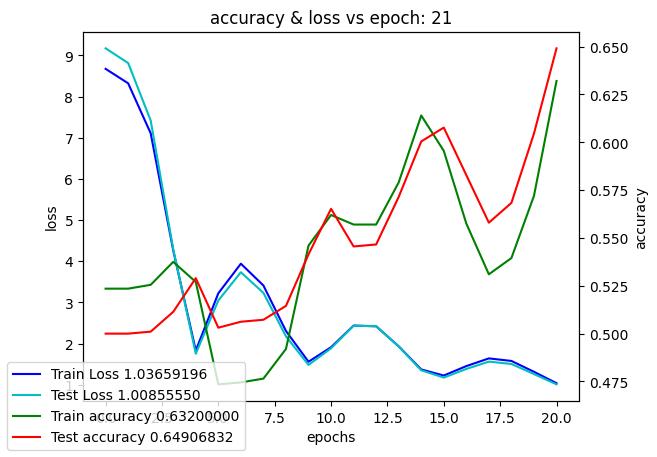

Training model color_cnn_multi_kernel:   0%|          | 30/10000 [02:33<14:15:56,  5.15s/it]

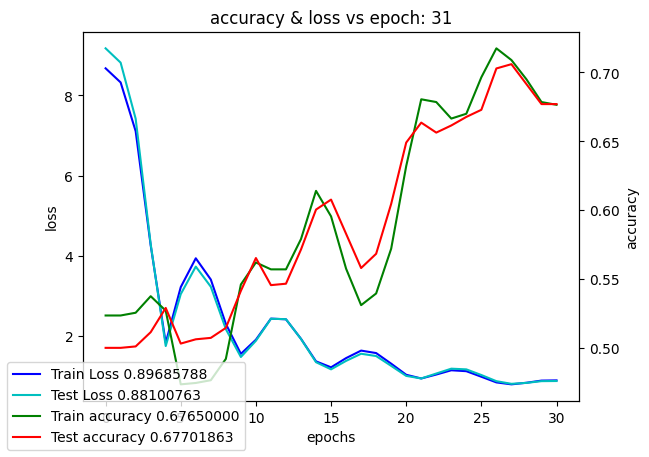

Training model color_cnn_multi_kernel:   0%|          | 40/10000 [03:25<14:20:56,  5.19s/it]

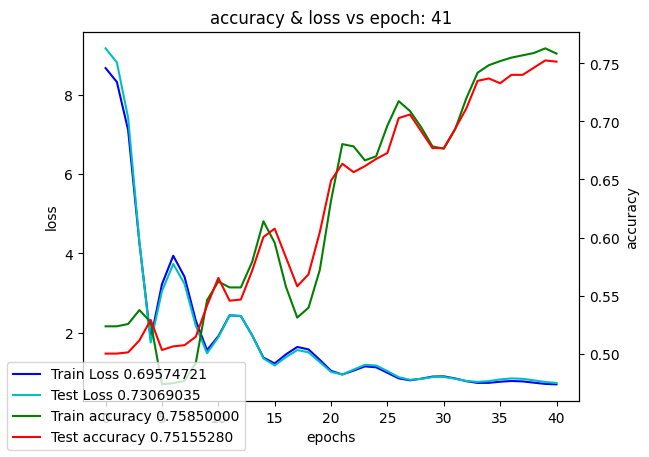

Training model color_cnn_multi_kernel:   0%|          | 50/10000 [04:21<14:27:26,  5.23s/it]

Early stopping at epoch 50


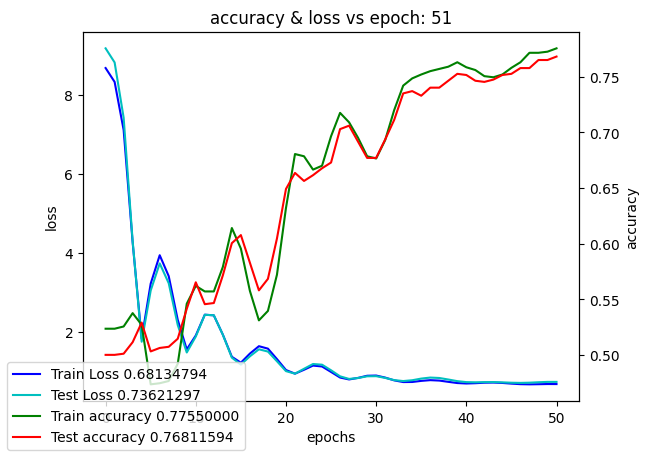

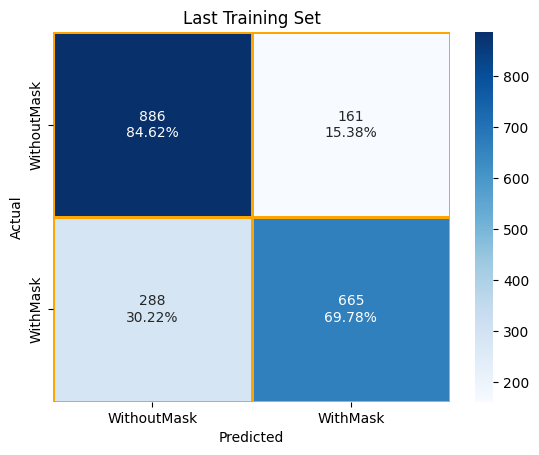

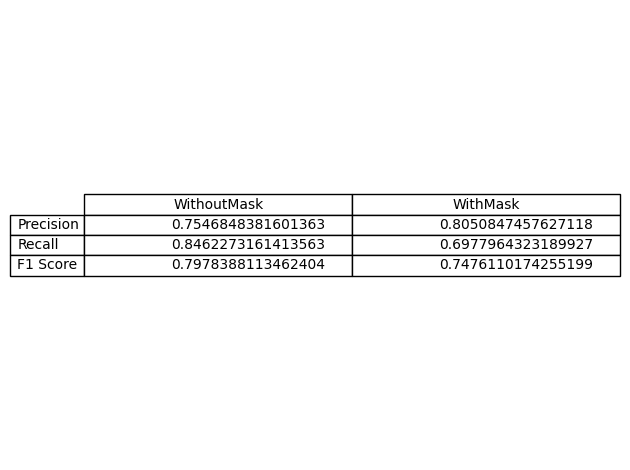

           WithoutMask  WithMask
Precision     0.754685  0.805085
Recall        0.846227  0.697796
F1 Score      0.797839  0.747611


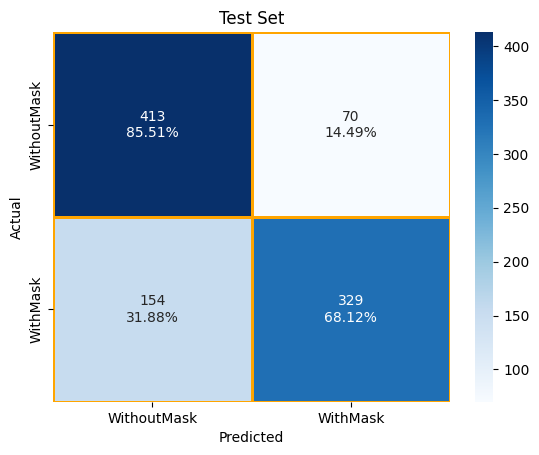

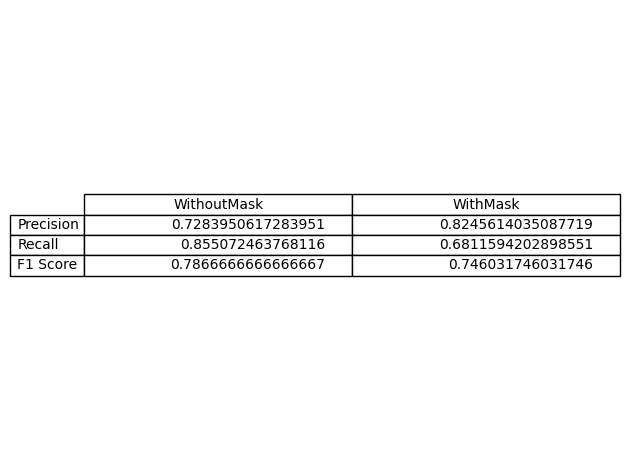

           WithoutMask  WithMask
Precision     0.728395  0.824561
Recall        0.855072  0.681159
F1 Score      0.786667  0.746032
Training Accuracy :  0.7755
Test Accuracy :  0.7681159420289855
Run time (minutes) :  4.359048921566667
model saved at file_path='/content/drive/My Drive/CS583/models/color_cnn_multi_kernel/color_cnn_multi_kernel_2025-11-04 06:28:14.982917.pkl'


In [ ]:
color_cnn_multi_kernel_path = os.path.join(data_path, 'color_cnn_multi_kernel')
os.makedirs(color_cnn_multi_kernel_path, exist_ok=True)

# find pkl model and load it if it exists
CNN = None
for _file in os.listdir(color_cnn_multi_kernel_path):
  if _file.endswith('.pkl'):
    # CNN = Model.import_model(os.path.join(color_cnn_multi_kernel_path, _file))
    break
if CNN is None:
  is_adaptive_learning = True
  layers = [
    ConvolutionalLayer(9, channels=channels, number_kernels=num_classes, is_adaptive=is_adaptive_learning, weight_initializer=kaiming_initialization),
    ReLU(),
    MaxPoolingLayer(2, stride=2),
    FlatteningLayer(),
    FullyConnectedLayer(-1, num_classes, is_adaptive=is_adaptive_learning, weight_initializer=xavier_initialization_uniform),
    SoftmaxLayer(),
    CrossEntropy()
  ]
  CNN = Model(layers, name='color_cnn_multi_kernel')
  CNN.set_layers_input_shapes(x_train[0:1].shape)
  CNN.train_model(
      x_train,
      y_train,
      x_test,
      y_test,
      y_class_labels=train_class_labels,
      max_epochs=int(1e4),
      learning_rate=1e-3,
      min_loss=1e-3,
      batch_size=None,
      file_path = color_cnn_multi_kernel_path
  )
  CNN.save_model(color_cnn_multi_kernel_path)

### 2. CNN on color version of images (requires 3D kernel) single kernel

input_shape=(1, 40, 40, 3)
0 ConvolutionalLayer output shape: (1, 32, 32, 1)
1 ReLU output shape: (1, 32, 32, 1)
2 MaxPoolingLayer output shape: (1, 16, 16, 1)
3 FlatteningLayer output shape: (1, np.int64(256))
4 FullyConnectedLayer output shape: 2
5 SoftmaxLayer output shape: 2
6 CrossEntropy output shape: 2


Training model color_cnn_single_kernel:   0%|          | 10/10000 [00:42<11:43:46,  4.23s/it]

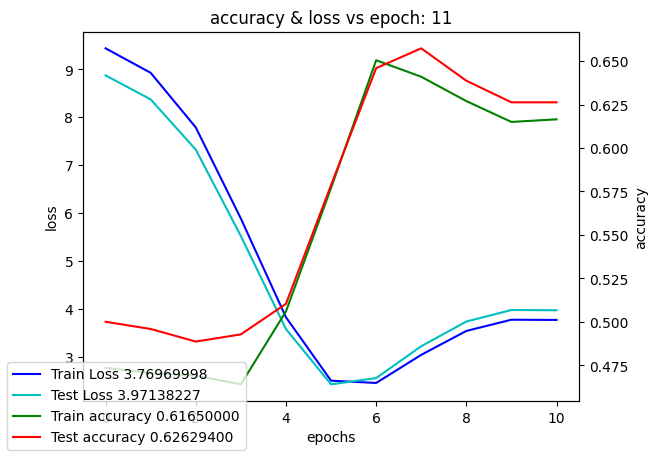

Training model color_cnn_single_kernel:   0%|          | 20/10000 [01:25<11:44:57,  4.24s/it]

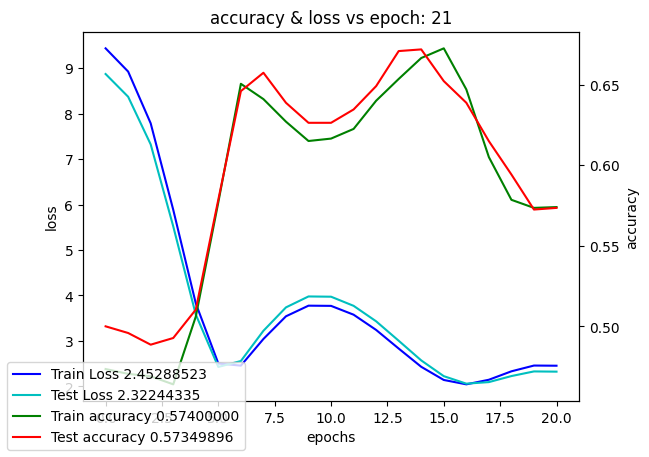

Training model color_cnn_single_kernel:   0%|          | 30/10000 [02:07<11:45:11,  4.24s/it]

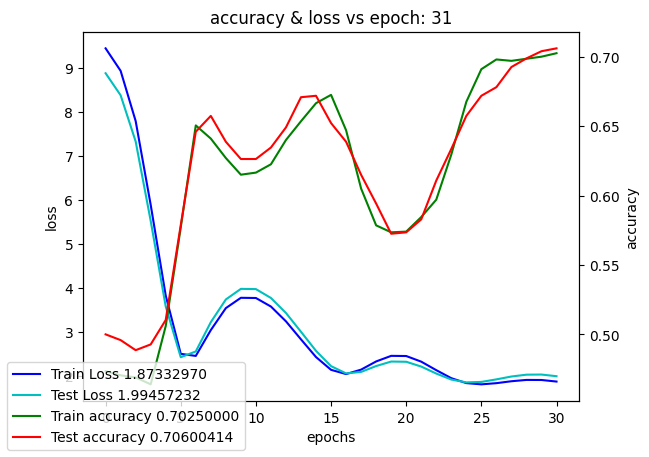

Training model color_cnn_single_kernel:   0%|          | 40/10000 [02:50<11:45:46,  4.25s/it]

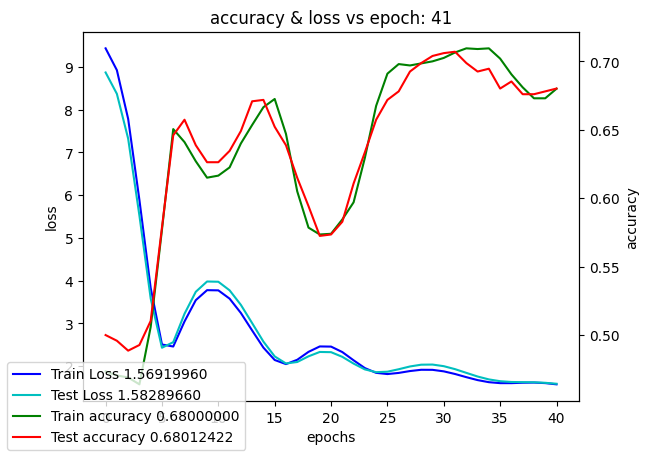

Training model color_cnn_single_kernel:   0%|          | 50/10000 [03:32<11:38:40,  4.21s/it]

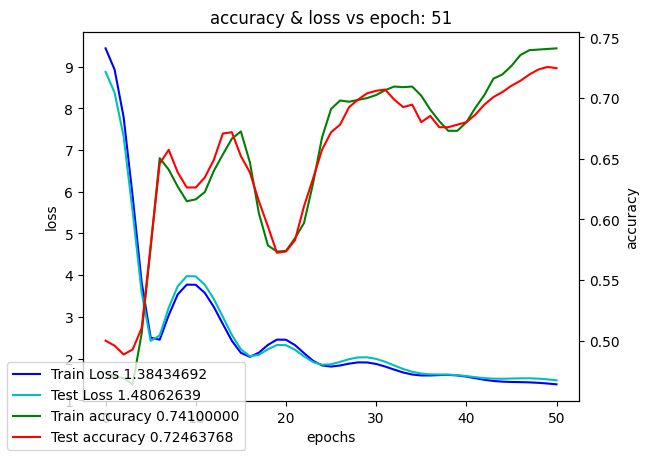

Training model color_cnn_single_kernel:   1%|          | 60/10000 [04:15<11:43:45,  4.25s/it]

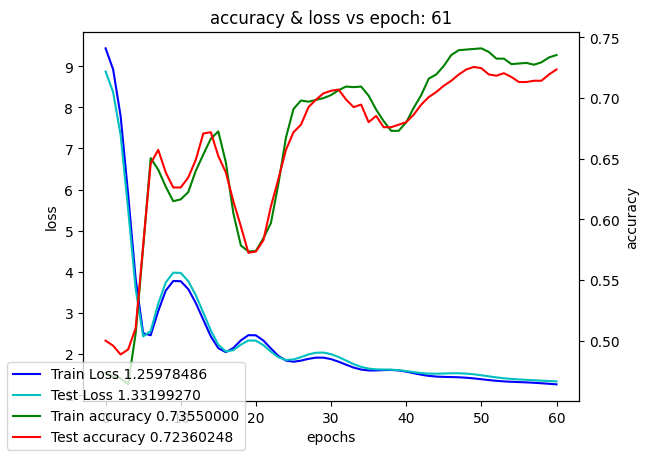

Training model color_cnn_single_kernel:   1%|          | 70/10000 [04:57<11:35:18,  4.20s/it]

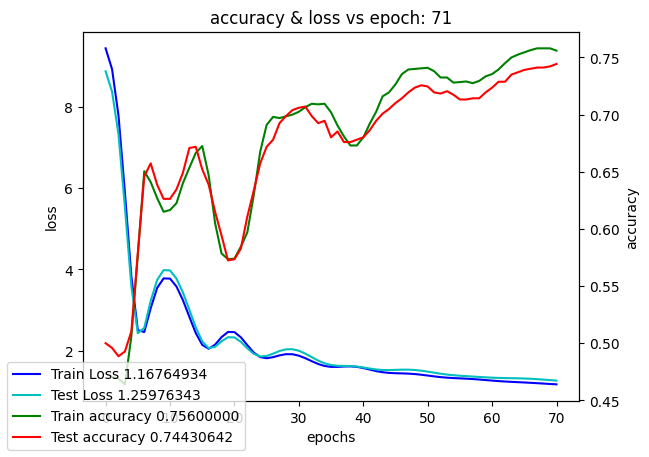

Training model color_cnn_single_kernel:   1%|          | 80/10000 [05:39<11:31:26,  4.18s/it]

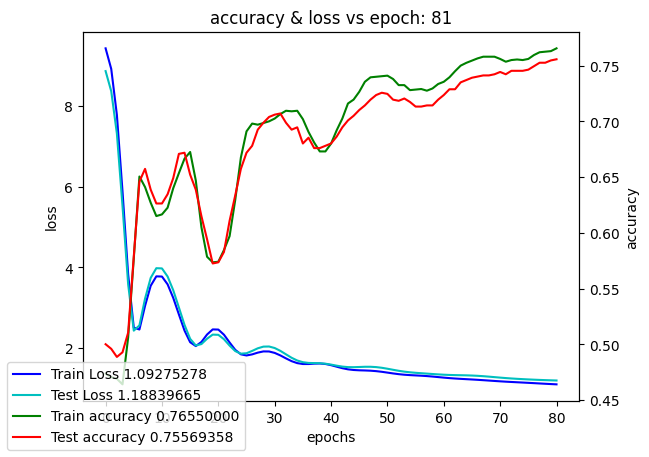

Training model color_cnn_single_kernel:   1%|          | 90/10000 [06:21<11:32:09,  4.19s/it]

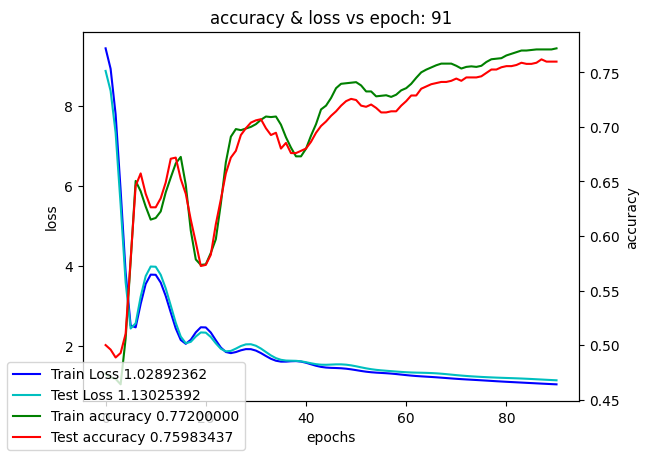

Training model color_cnn_single_kernel:   1%|          | 100/10000 [07:04<11:31:58,  4.19s/it]

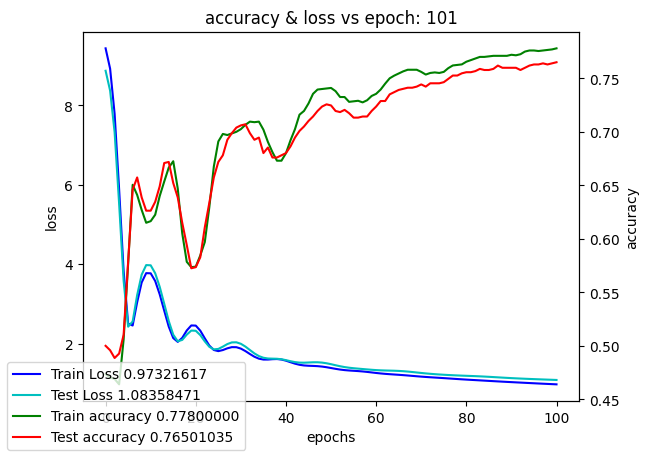

Training model color_cnn_single_kernel:   1%|          | 110/10000 [07:46<11:30:04,  4.19s/it]

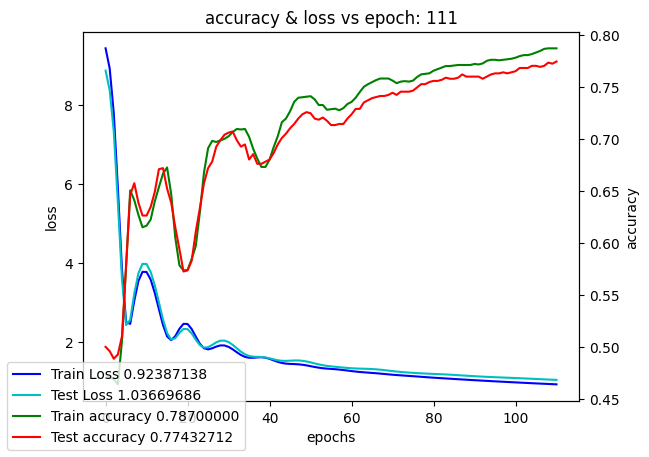

Training model color_cnn_single_kernel:   1%|          | 120/10000 [08:28<11:27:58,  4.18s/it]

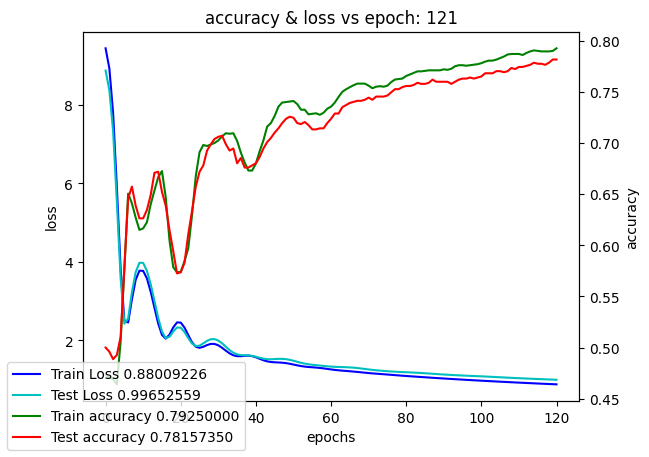

Training model color_cnn_single_kernel:   1%|▏         | 130/10000 [09:10<11:28:19,  4.18s/it]

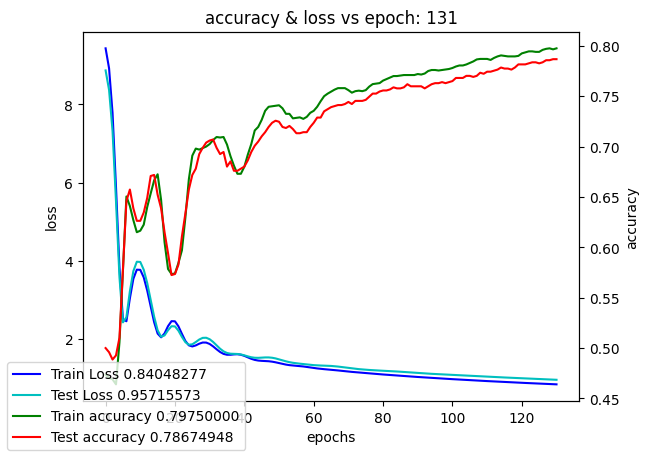

Training model color_cnn_single_kernel:   1%|▏         | 140/10000 [09:52<11:26:09,  4.18s/it]

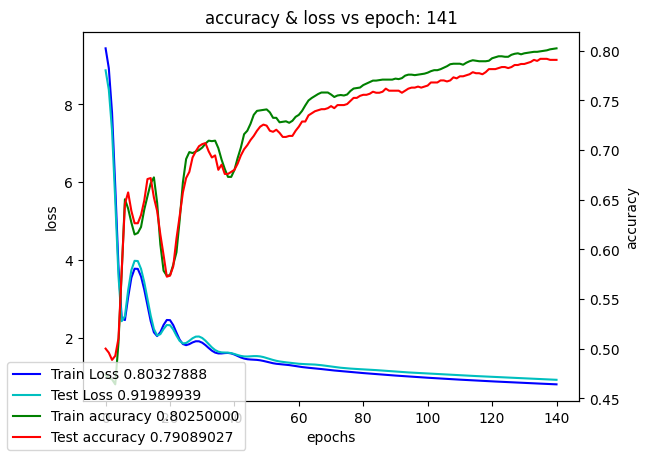

Training model color_cnn_single_kernel:   2%|▏         | 150/10000 [10:34<11:27:06,  4.19s/it]

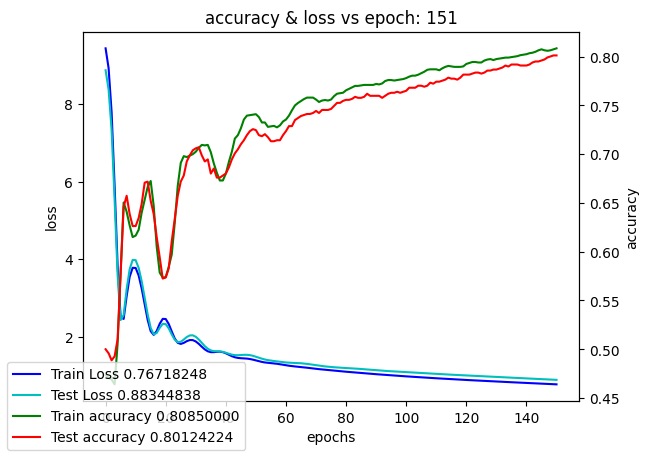

Training model color_cnn_single_kernel:   2%|▏         | 160/10000 [11:16<11:26:51,  4.19s/it]

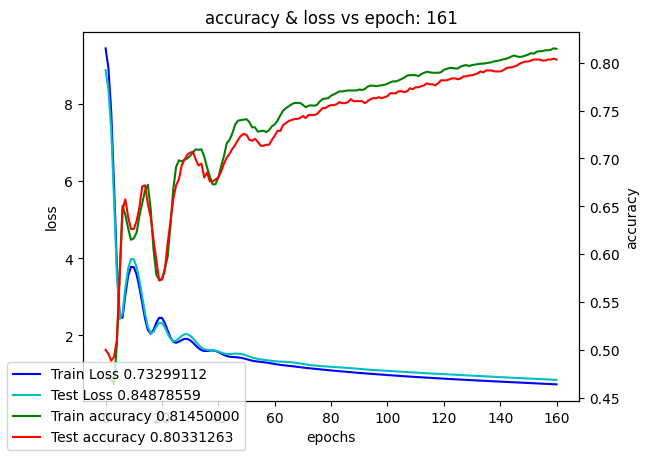

Training model color_cnn_single_kernel:   2%|▏         | 170/10000 [11:58<11:28:21,  4.20s/it]

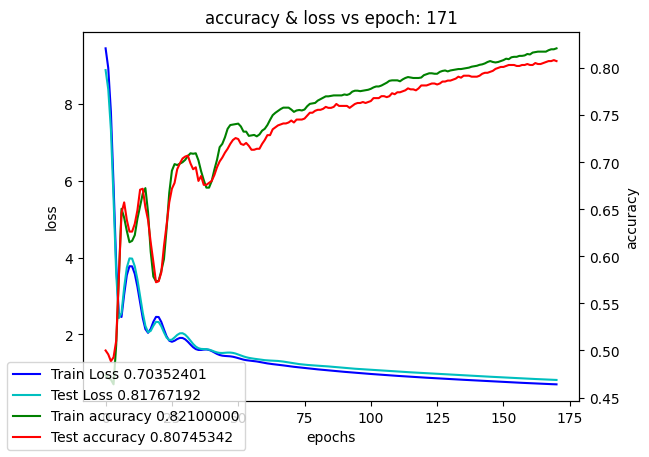

Training model color_cnn_single_kernel:   2%|▏         | 180/10000 [12:40<11:36:10,  4.25s/it]

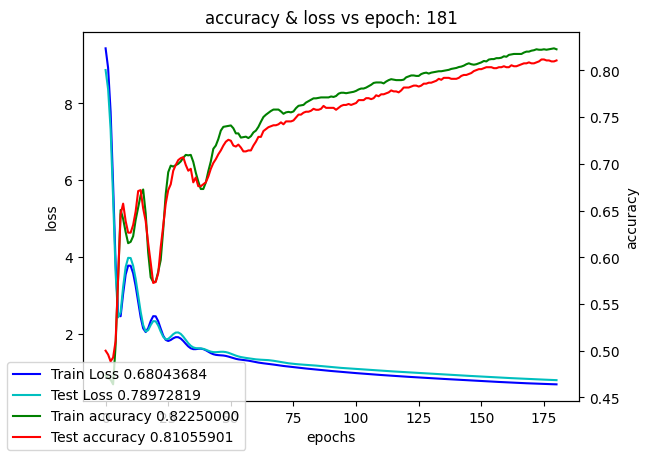

Training model color_cnn_single_kernel:   2%|▏         | 190/10000 [13:23<11:34:01,  4.24s/it]

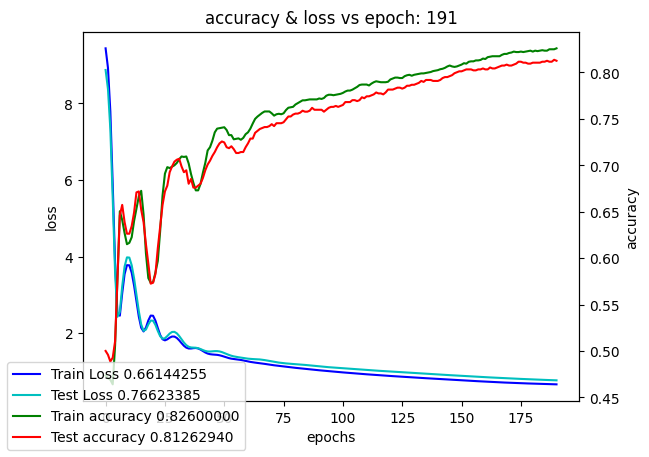

Training model color_cnn_single_kernel:   2%|▏         | 200/10000 [14:06<11:37:43,  4.27s/it]

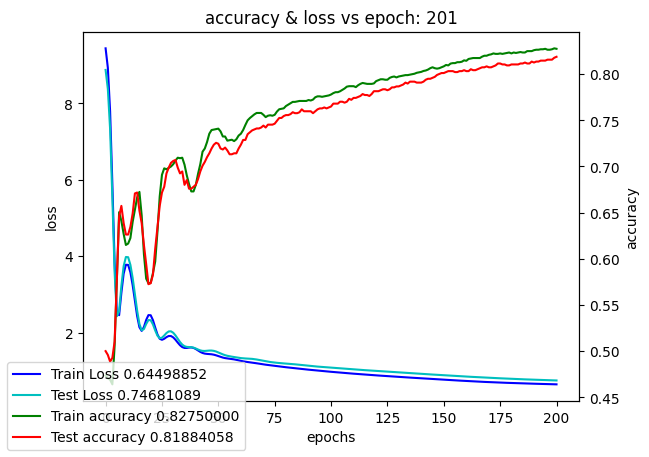

Training model color_cnn_single_kernel:   2%|▏         | 210/10000 [14:49<11:30:36,  4.23s/it]

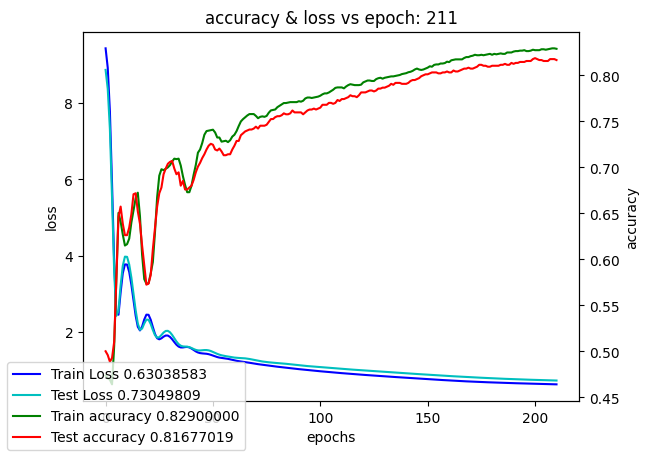

Training model color_cnn_single_kernel:   2%|▏         | 220/10000 [15:31<11:32:16,  4.25s/it]

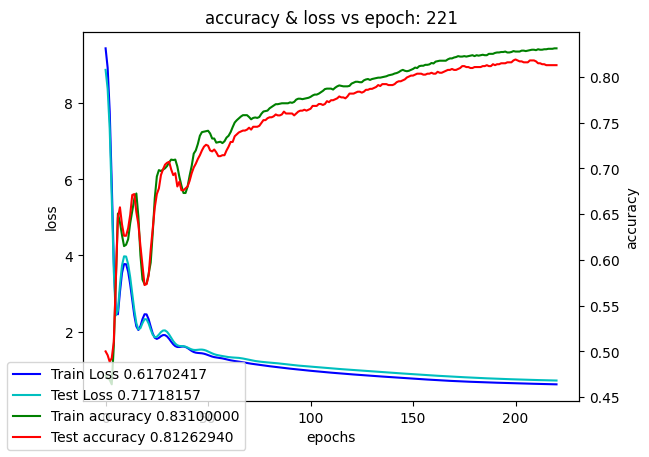

Training model color_cnn_single_kernel:   2%|▏         | 230/10000 [16:14<11:30:31,  4.24s/it]

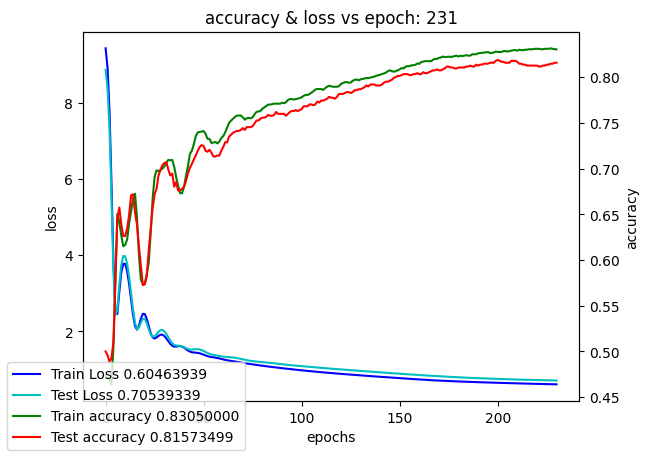

Training model color_cnn_single_kernel:   2%|▏         | 240/10000 [16:56<11:30:21,  4.24s/it]

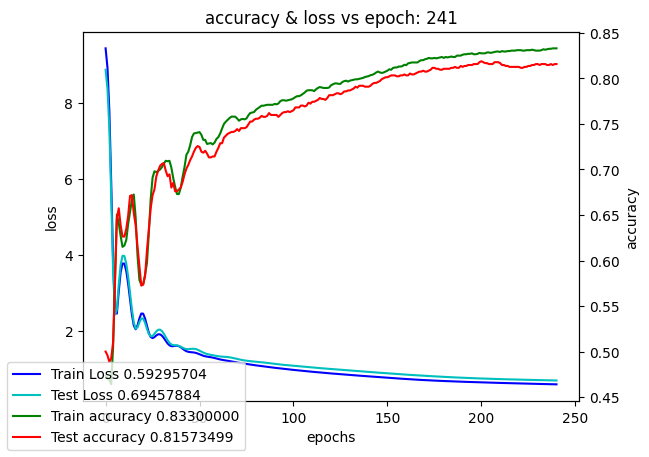

Training model color_cnn_single_kernel:   2%|▎         | 250/10000 [17:39<11:23:08,  4.20s/it]

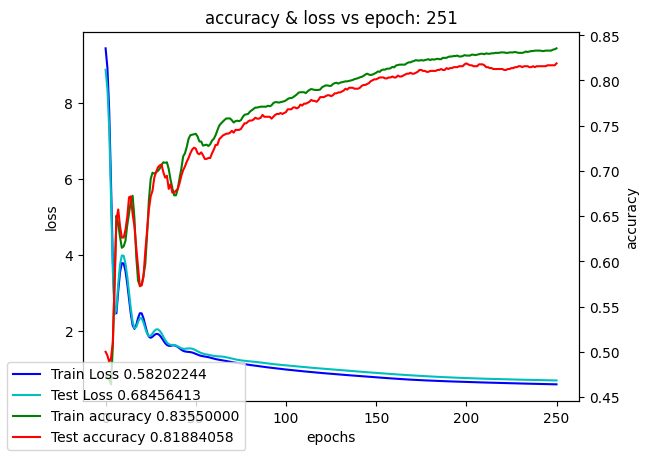

Training model color_cnn_single_kernel:   3%|▎         | 260/10000 [18:21<11:26:20,  4.23s/it]

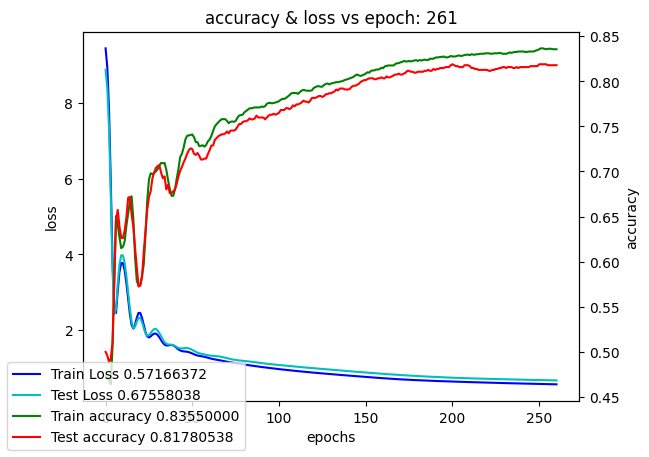

Training model color_cnn_single_kernel:   3%|▎         | 270/10000 [19:04<11:22:32,  4.21s/it]

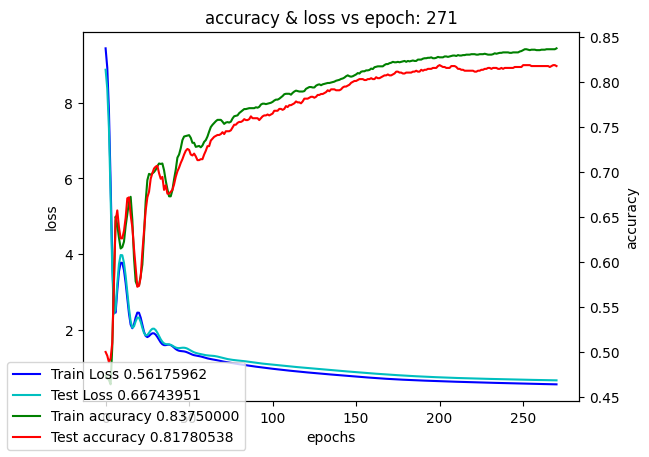

Training model color_cnn_single_kernel:   3%|▎         | 280/10000 [19:46<11:17:00,  4.18s/it]

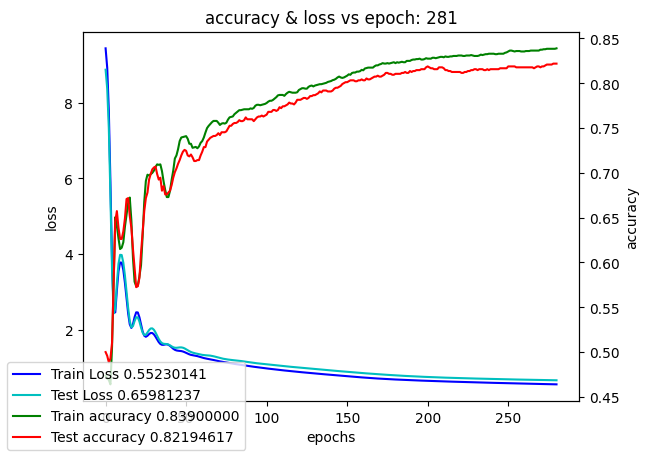

Training model color_cnn_single_kernel:   3%|▎         | 290/10000 [20:28<11:15:48,  4.18s/it]

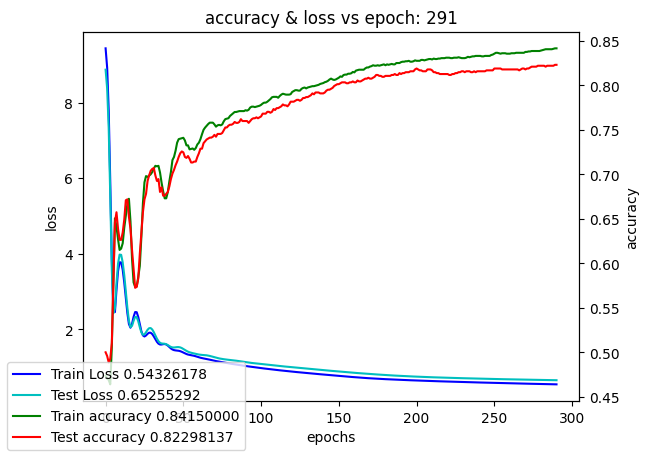

Training model color_cnn_single_kernel:   3%|▎         | 300/10000 [21:10<11:16:16,  4.18s/it]

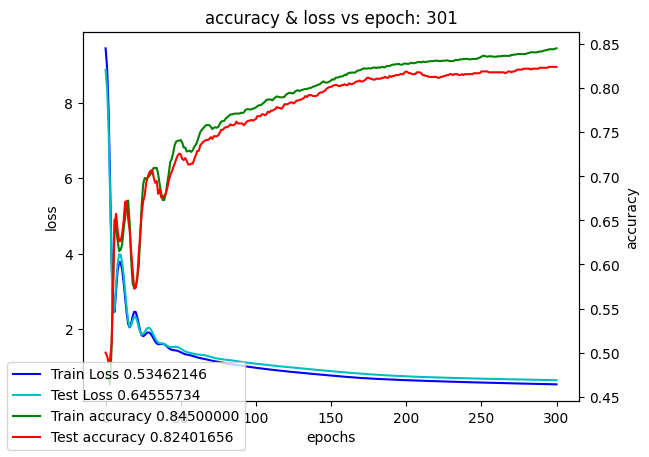

Training model color_cnn_single_kernel:   3%|▎         | 310/10000 [21:52<11:15:25,  4.18s/it]

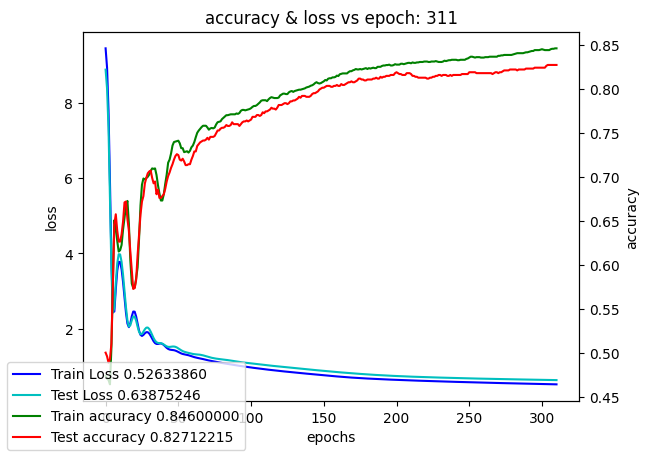

Training model color_cnn_single_kernel:   3%|▎         | 320/10000 [22:34<11:14:56,  4.18s/it]

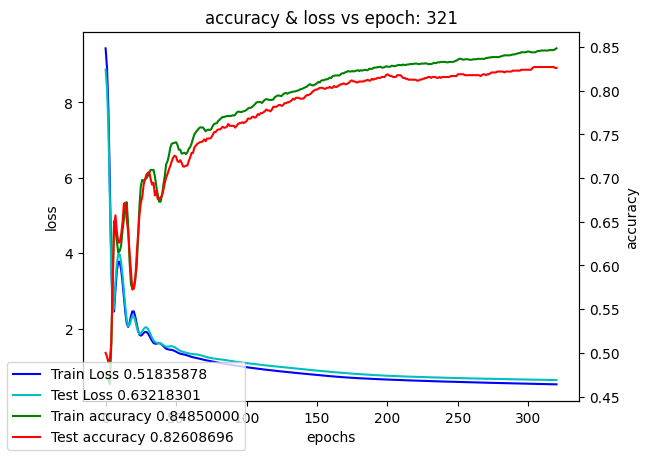

Training model color_cnn_single_kernel:   3%|▎         | 330/10000 [23:16<11:14:14,  4.18s/it]

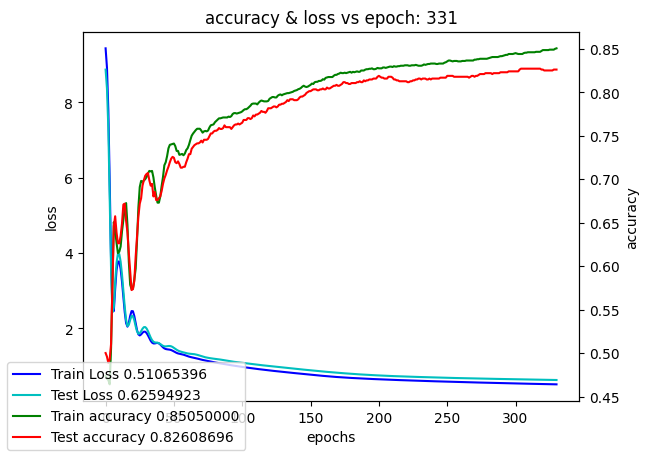

Training model color_cnn_single_kernel:   3%|▎         | 340/10000 [23:58<11:13:17,  4.18s/it]

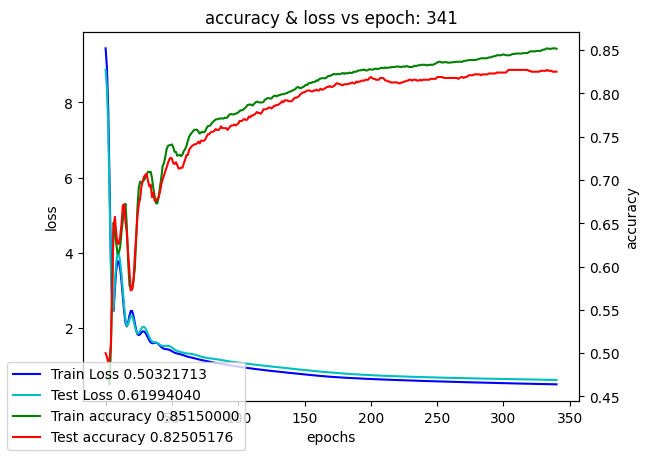

Training model color_cnn_single_kernel:   4%|▎         | 350/10000 [24:40<11:19:07,  4.22s/it]

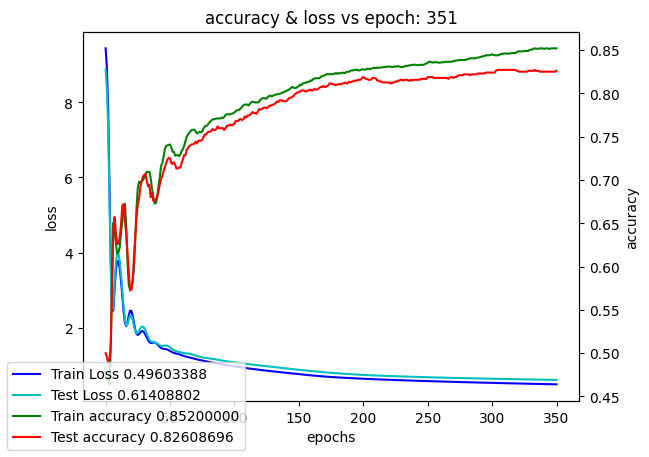

Training model color_cnn_single_kernel:   4%|▎         | 360/10000 [25:23<11:17:11,  4.21s/it]

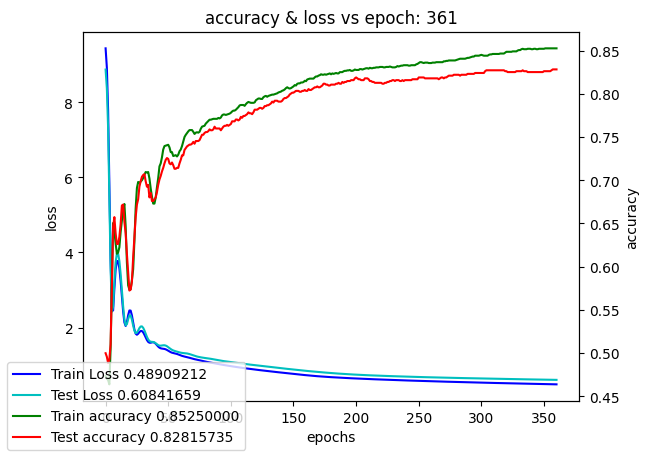

Training model color_cnn_single_kernel:   4%|▎         | 370/10000 [26:05<11:20:14,  4.24s/it]

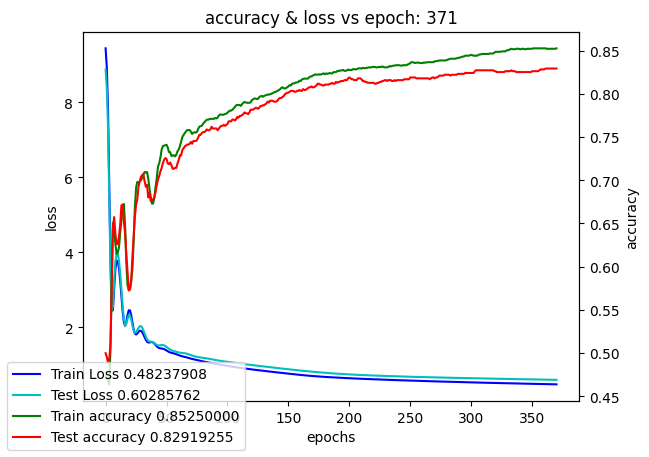

Training model color_cnn_single_kernel:   4%|▍         | 380/10000 [26:48<11:19:58,  4.24s/it]

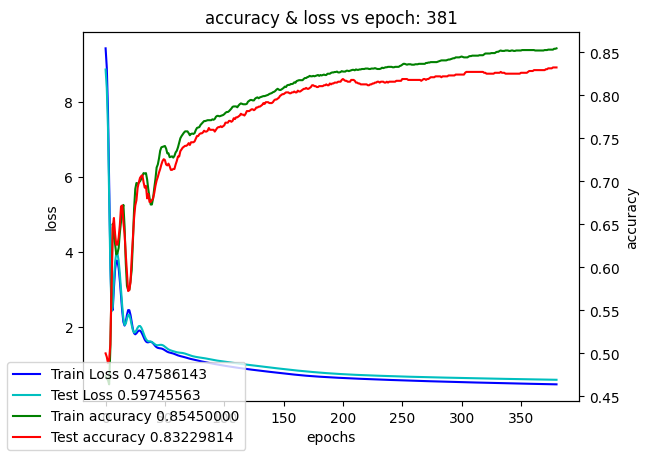

Training model color_cnn_single_kernel:   4%|▍         | 390/10000 [27:30<11:17:29,  4.23s/it]

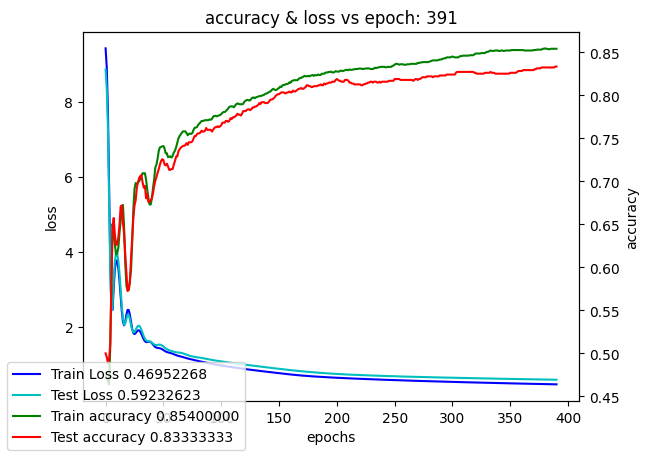

Training model color_cnn_single_kernel:   4%|▍         | 400/10000 [28:13<11:15:42,  4.22s/it]

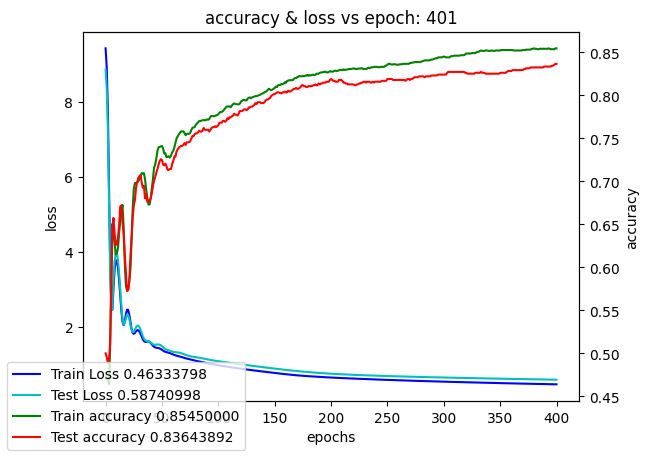

Training model color_cnn_single_kernel:   4%|▍         | 410/10000 [28:55<11:16:05,  4.23s/it]

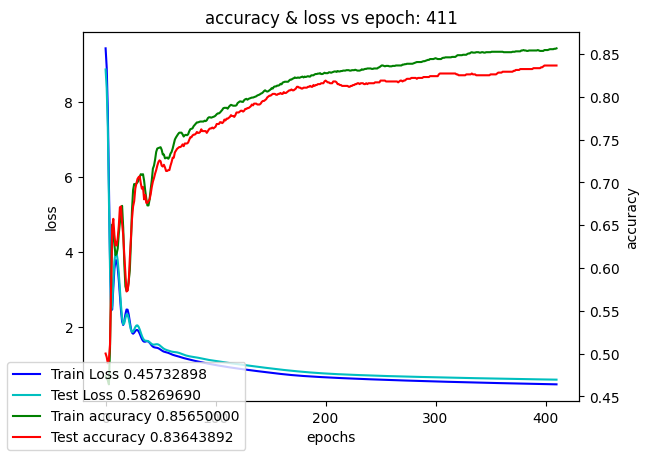

Training model color_cnn_single_kernel:   4%|▍         | 420/10000 [29:38<11:14:25,  4.22s/it]

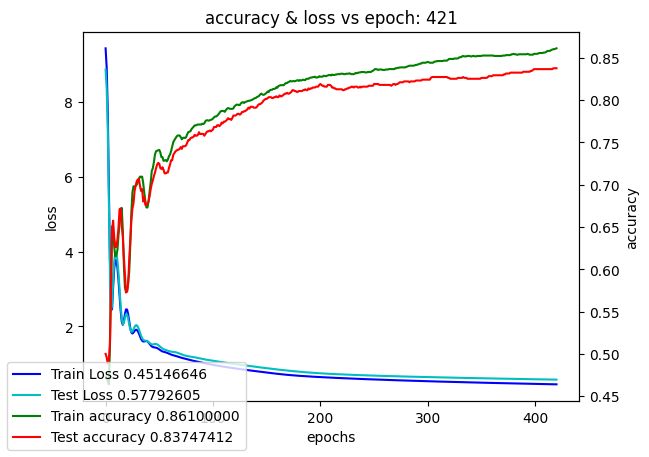

Training model color_cnn_single_kernel:   4%|▍         | 430/10000 [30:20<11:11:47,  4.21s/it]

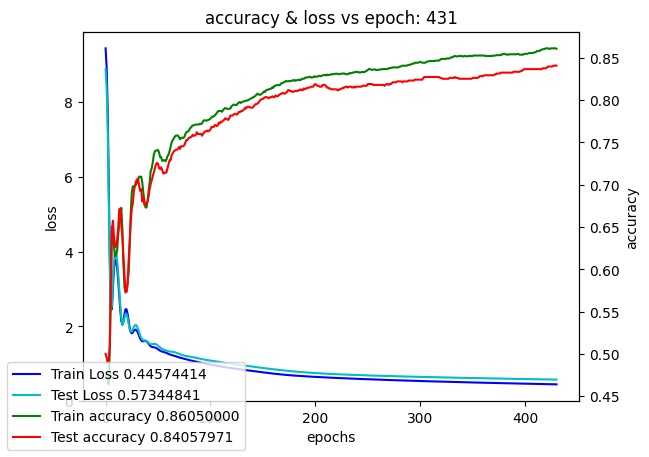

Training model color_cnn_single_kernel:   4%|▍         | 440/10000 [31:03<11:18:40,  4.26s/it]

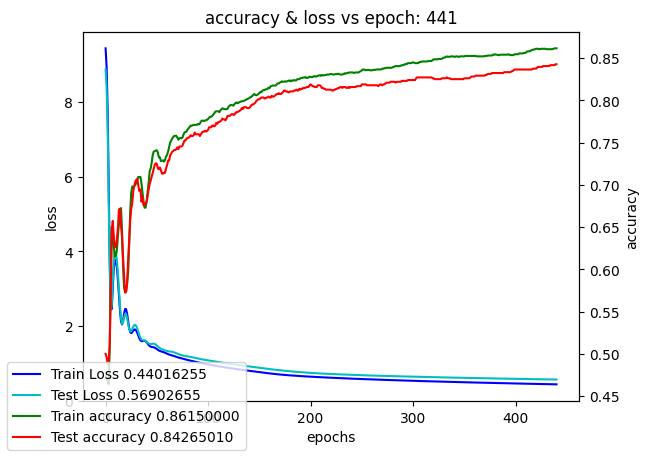

Training model color_cnn_single_kernel:   4%|▍         | 450/10000 [31:45<11:09:41,  4.21s/it]

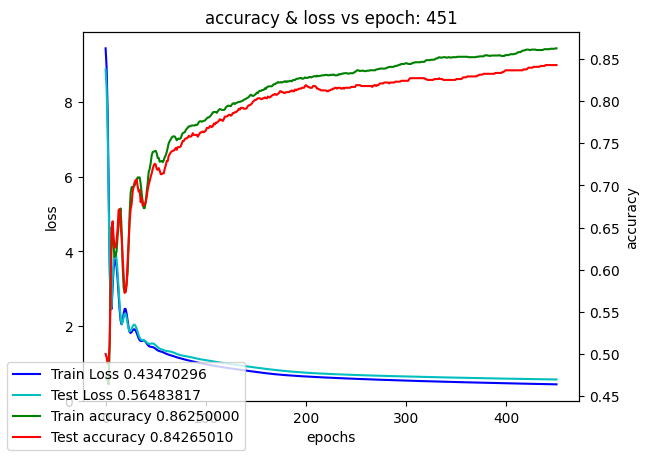

Training model color_cnn_single_kernel:   5%|▍         | 460/10000 [32:28<11:08:55,  4.21s/it]

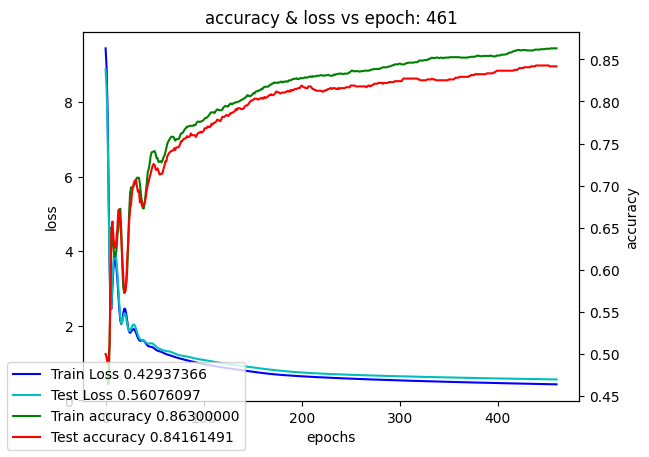

Training model color_cnn_single_kernel:   5%|▍         | 470/10000 [33:10<11:05:53,  4.19s/it]

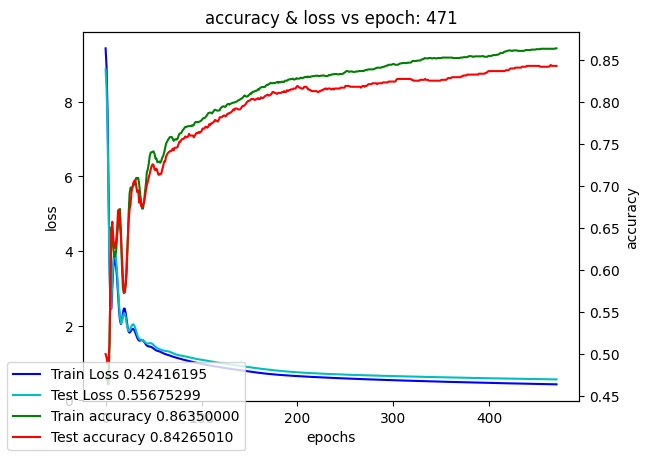

Training model color_cnn_single_kernel:   5%|▍         | 480/10000 [33:52<11:04:29,  4.19s/it]

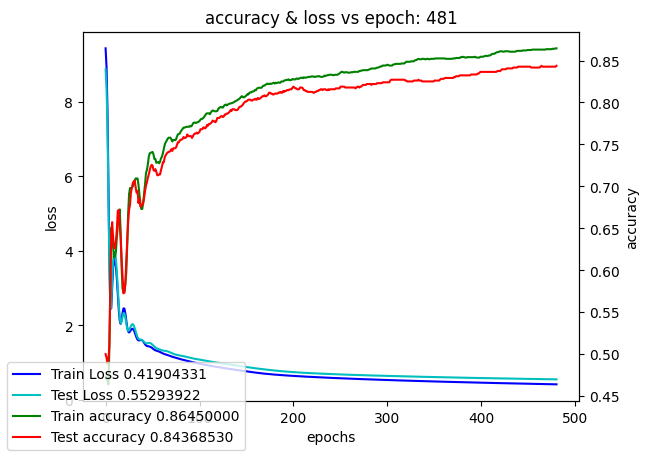

Training model color_cnn_single_kernel:   5%|▍         | 490/10000 [34:34<11:02:34,  4.18s/it]

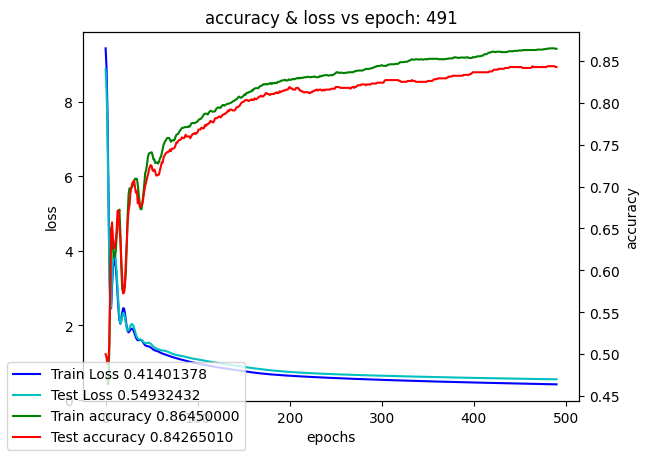

Training model color_cnn_single_kernel:   5%|▌         | 500/10000 [35:16<11:03:05,  4.19s/it]

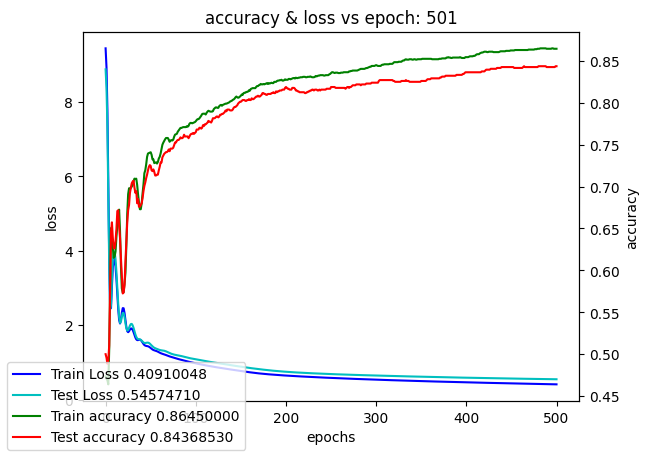

Training model color_cnn_single_kernel:   5%|▌         | 510/10000 [35:59<11:04:55,  4.20s/it]

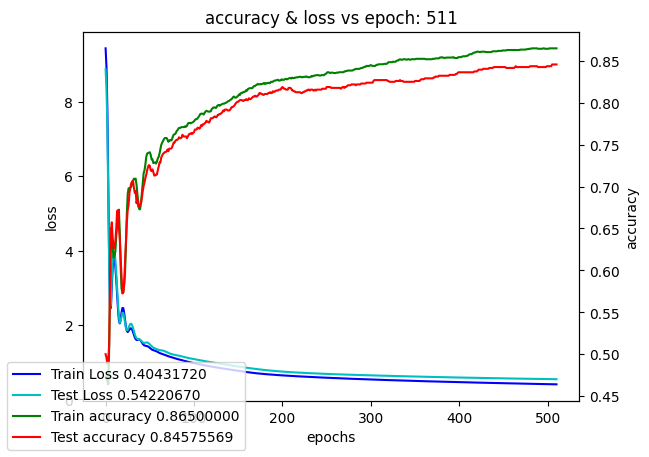

Training model color_cnn_single_kernel:   5%|▌         | 520/10000 [36:41<11:03:12,  4.20s/it]

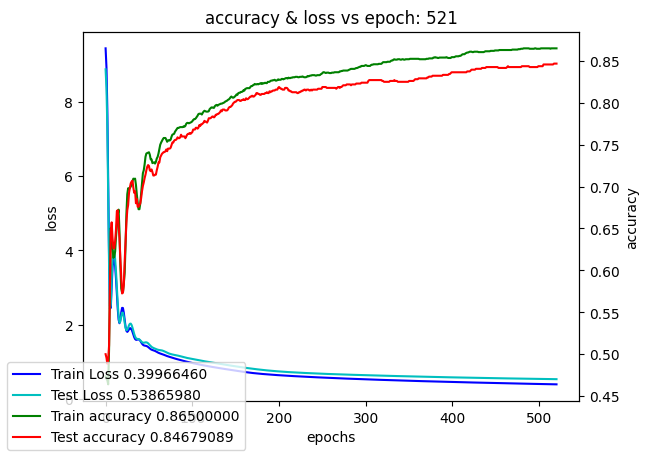

Training model color_cnn_single_kernel:   5%|▌         | 530/10000 [37:23<10:58:37,  4.17s/it]

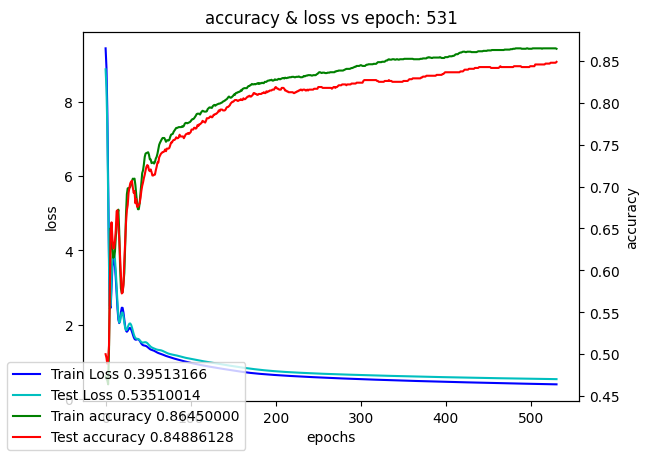

Training model color_cnn_single_kernel:   5%|▌         | 540/10000 [38:05<11:00:45,  4.19s/it]

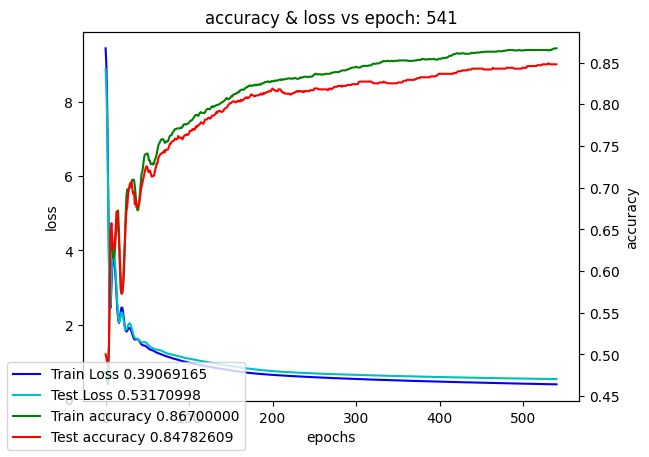

Training model color_cnn_single_kernel:   6%|▌         | 550/10000 [38:47<10:59:39,  4.19s/it]

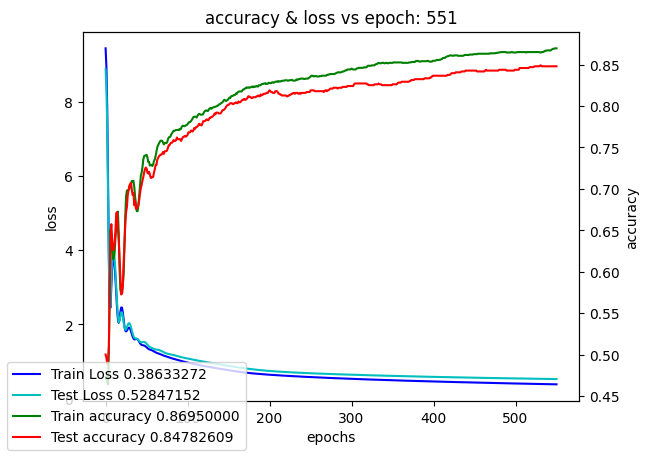

Training model color_cnn_single_kernel:   6%|▌         | 560/10000 [39:29<11:01:20,  4.20s/it]

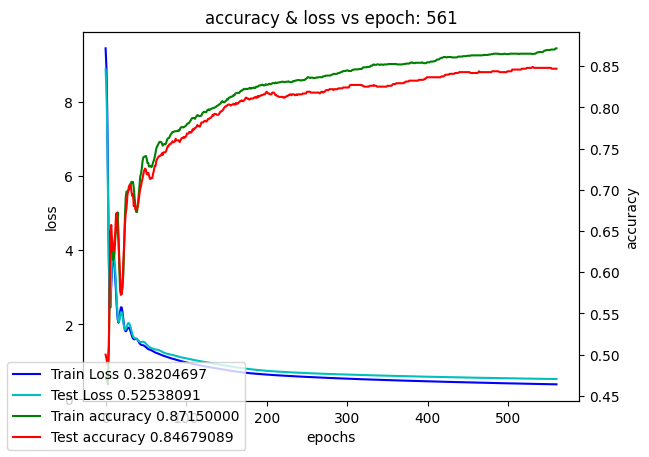

Training model color_cnn_single_kernel:   6%|▌         | 570/10000 [40:11<10:58:48,  4.19s/it]

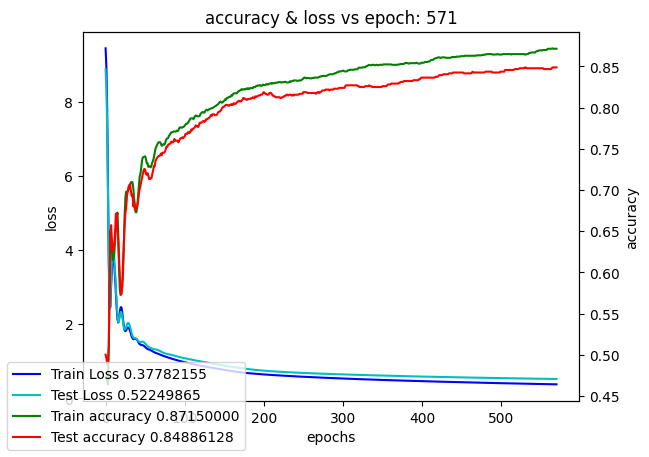

Training model color_cnn_single_kernel:   6%|▌         | 580/10000 [40:53<11:03:23,  4.23s/it]

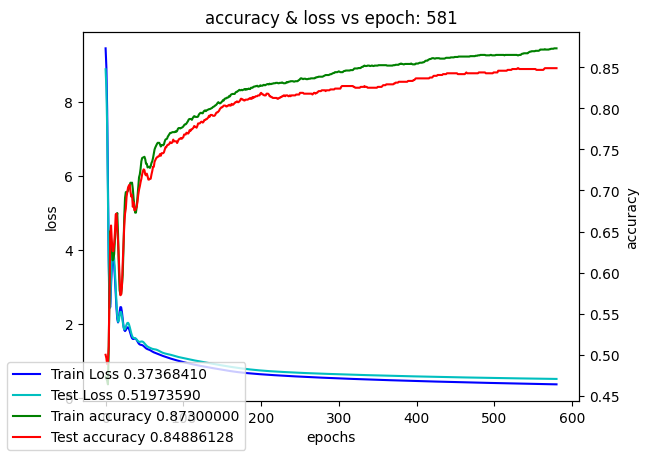

Training model color_cnn_single_kernel:   6%|▌         | 590/10000 [41:36<11:02:15,  4.22s/it]

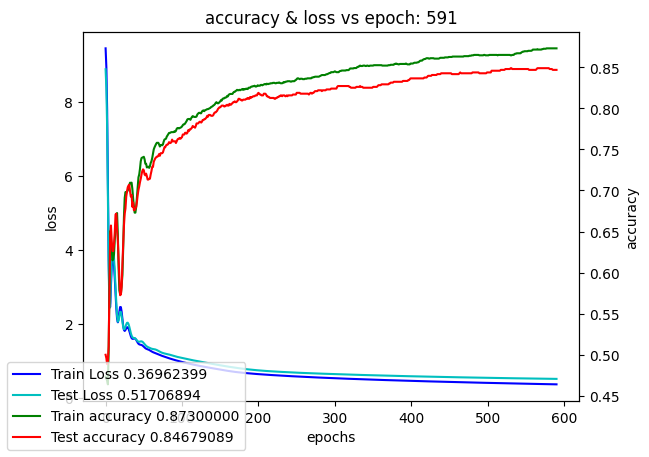

Training model color_cnn_single_kernel:   6%|▌         | 600/10000 [42:18<11:01:41,  4.22s/it]

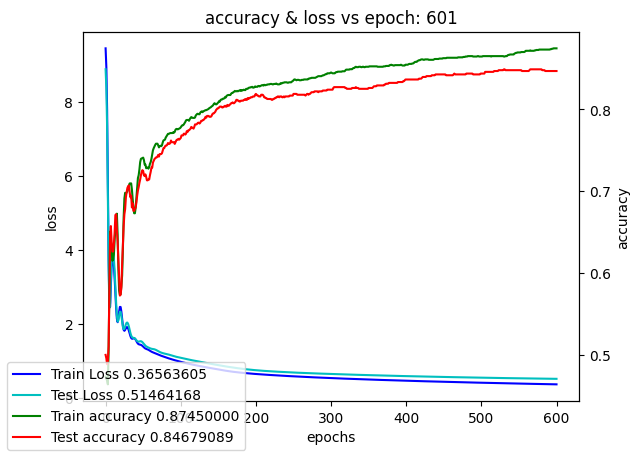

Training model color_cnn_single_kernel:   6%|▌         | 610/10000 [43:01<11:01:46,  4.23s/it]

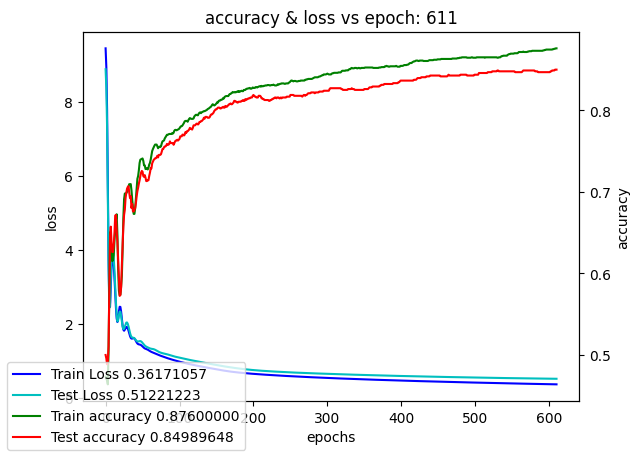

Training model color_cnn_single_kernel:   6%|▌         | 620/10000 [43:43<11:02:58,  4.24s/it]

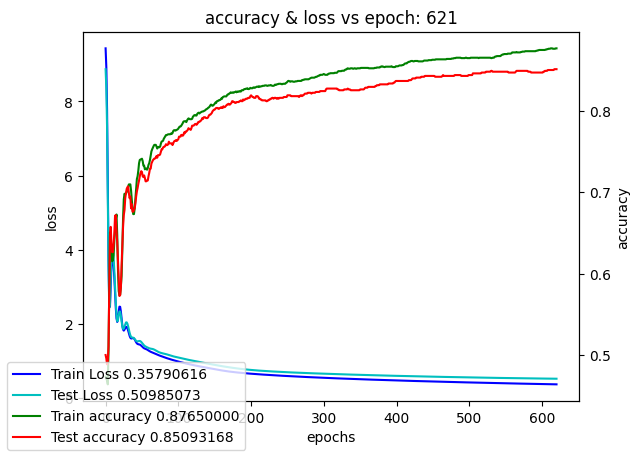

Training model color_cnn_single_kernel:   6%|▋         | 630/10000 [44:26<11:00:09,  4.23s/it]

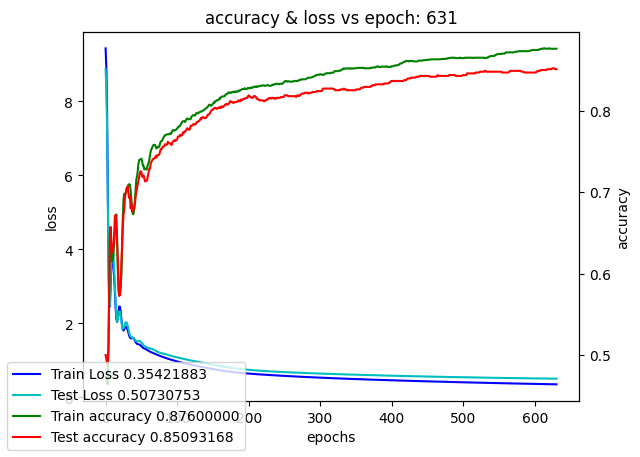

Training model color_cnn_single_kernel:   6%|▋         | 640/10000 [45:08<11:00:36,  4.23s/it]

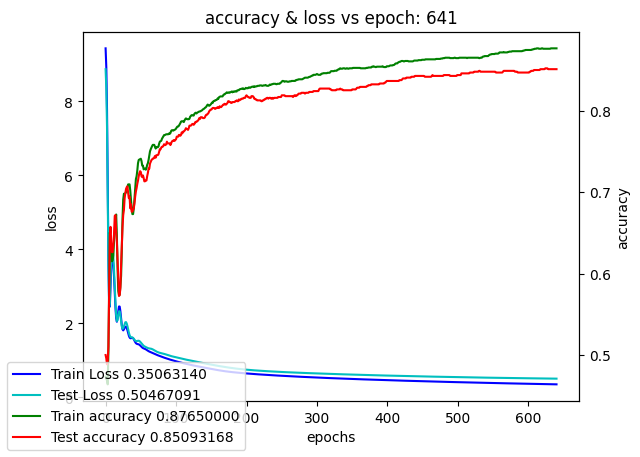

Training model color_cnn_single_kernel:   6%|▋         | 650/10000 [45:51<10:58:00,  4.22s/it]

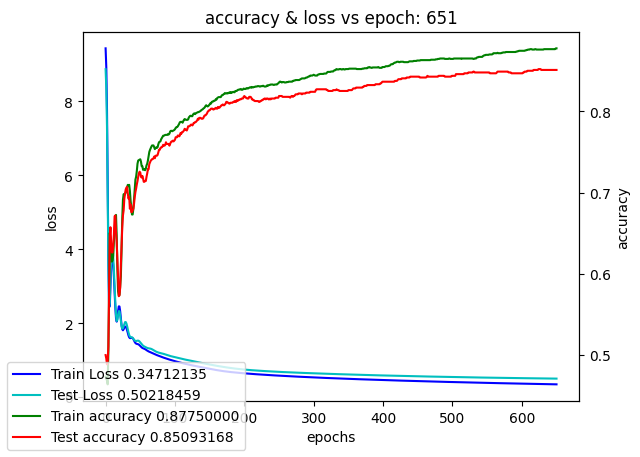

Training model color_cnn_single_kernel:   7%|▋         | 660/10000 [46:33<10:52:16,  4.19s/it]

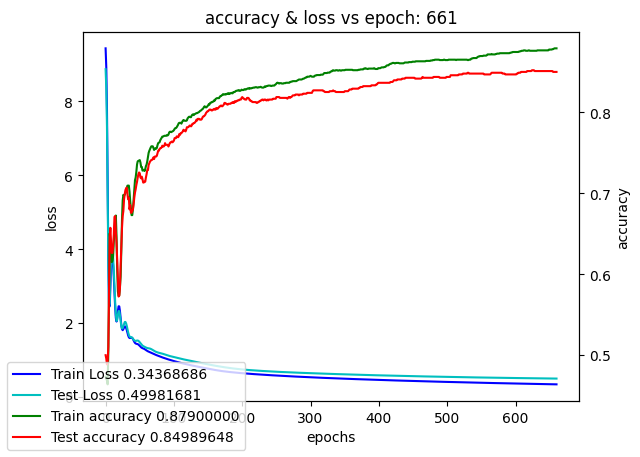

Training model color_cnn_single_kernel:   7%|▋         | 670/10000 [47:15<10:50:16,  4.18s/it]

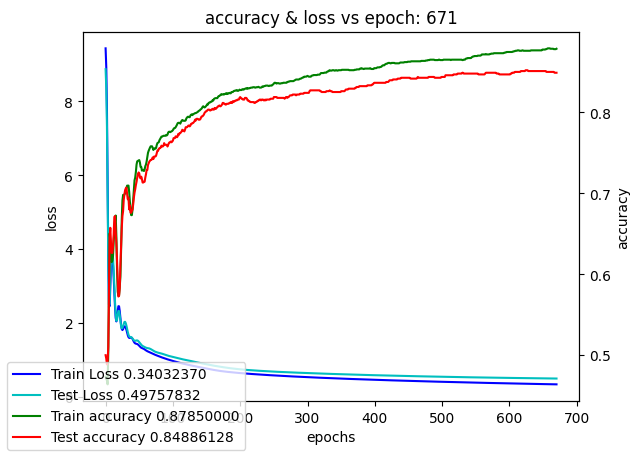

Training model color_cnn_single_kernel:   7%|▋         | 680/10000 [47:57<10:49:45,  4.18s/it]

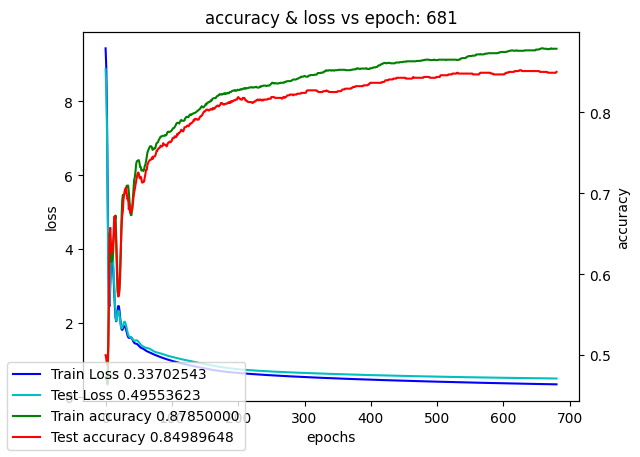

Training model color_cnn_single_kernel:   7%|▋         | 690/10000 [48:39<10:48:38,  4.18s/it]

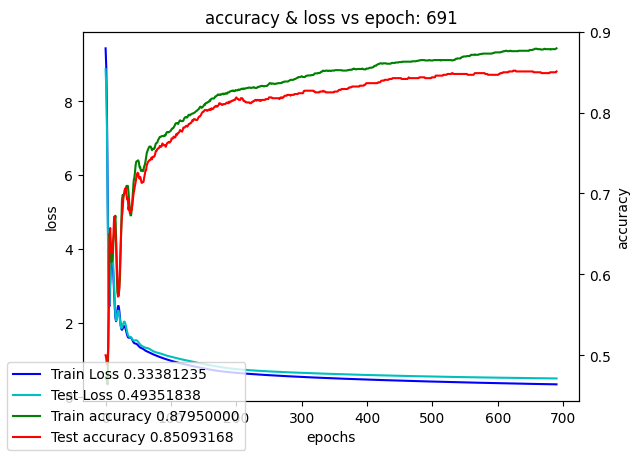

Training model color_cnn_single_kernel:   7%|▋         | 700/10000 [49:21<10:51:33,  4.20s/it]

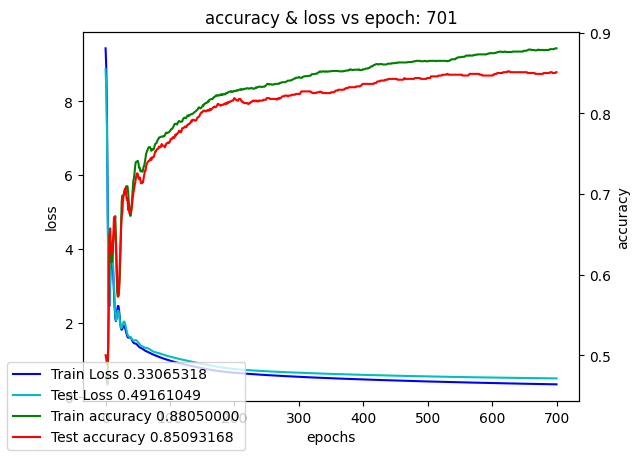

Training model color_cnn_single_kernel:   7%|▋         | 710/10000 [50:03<10:49:40,  4.20s/it]

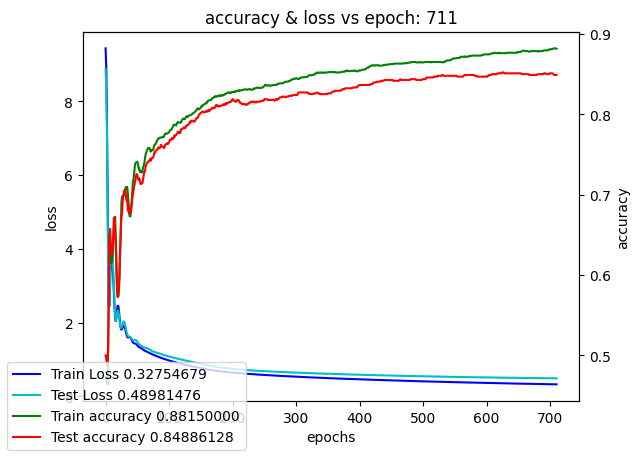

Training model color_cnn_single_kernel:   7%|▋         | 720/10000 [50:45<10:48:56,  4.20s/it]

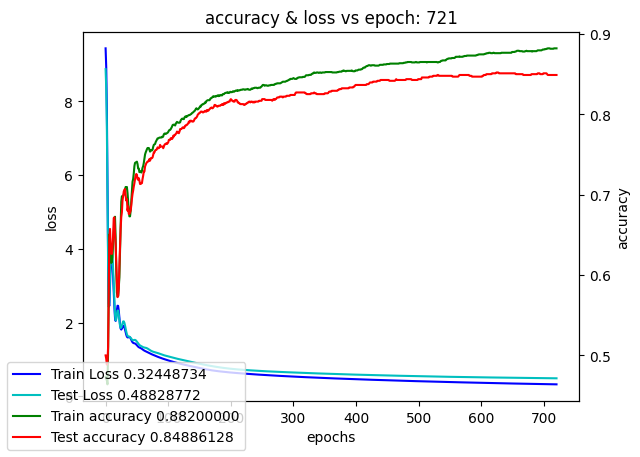

Training model color_cnn_single_kernel:   7%|▋         | 730/10000 [51:27<10:46:10,  4.18s/it]

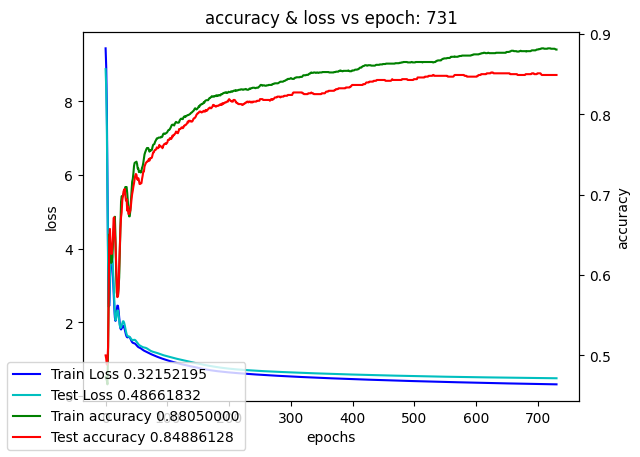

Training model color_cnn_single_kernel:   7%|▋         | 740/10000 [52:09<10:45:55,  4.19s/it]

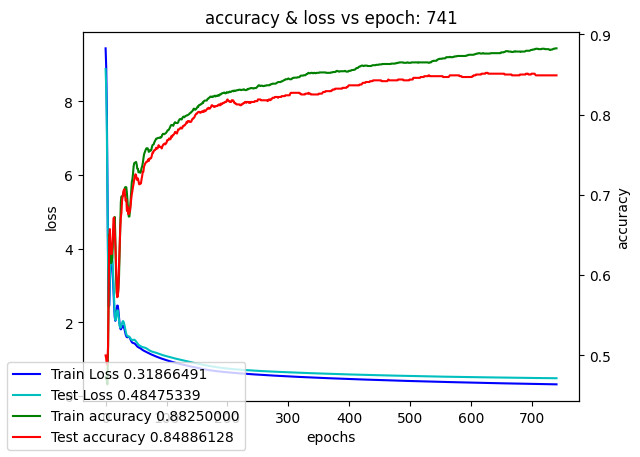

Training model color_cnn_single_kernel:   8%|▊         | 750/10000 [52:51<10:44:24,  4.18s/it]

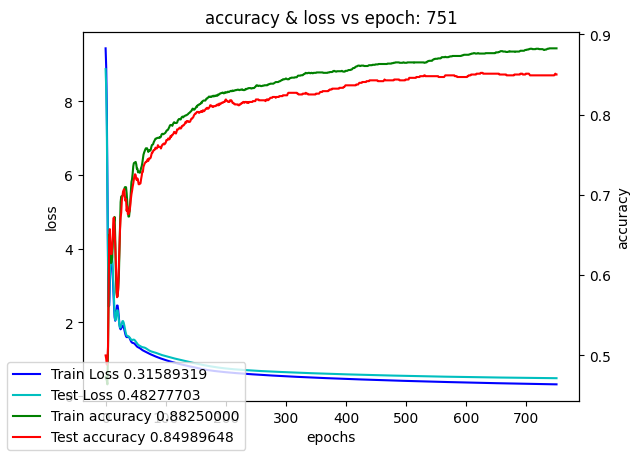

Training model color_cnn_single_kernel:   8%|▊         | 760/10000 [53:33<10:47:17,  4.20s/it]

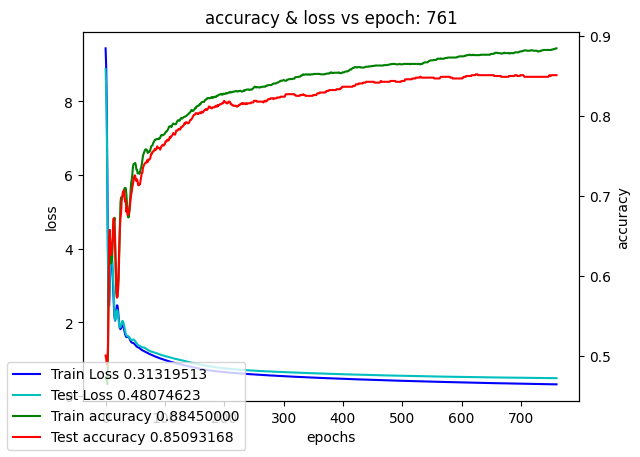

Training model color_cnn_single_kernel:   8%|▊         | 770/10000 [54:16<10:47:14,  4.21s/it]

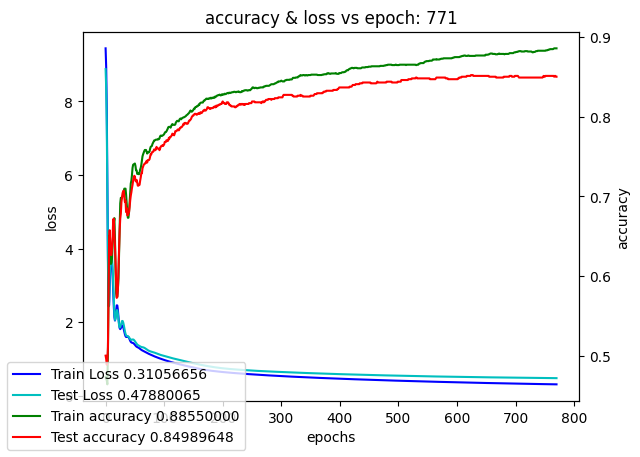

Training model color_cnn_single_kernel:   8%|▊         | 780/10000 [54:58<10:49:11,  4.22s/it]

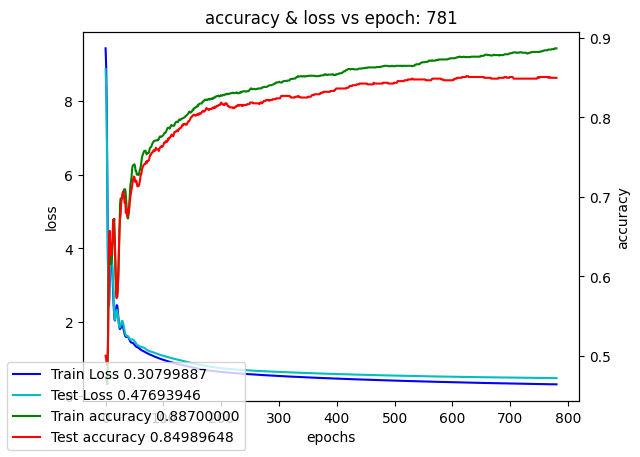

Training model color_cnn_single_kernel:   8%|▊         | 790/10000 [55:40<10:46:18,  4.21s/it]

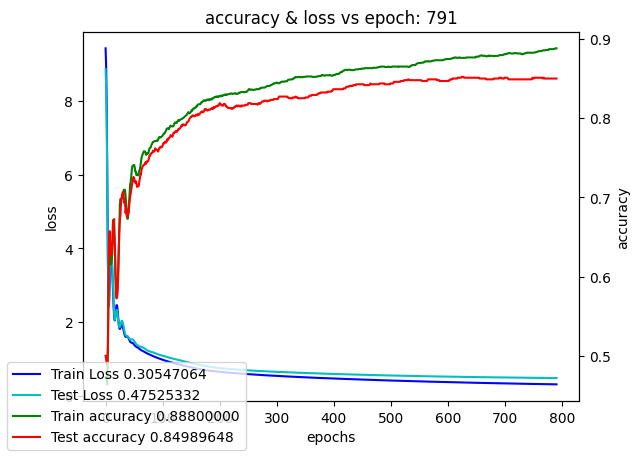

Training model color_cnn_single_kernel:   8%|▊         | 800/10000 [56:23<10:48:30,  4.23s/it]

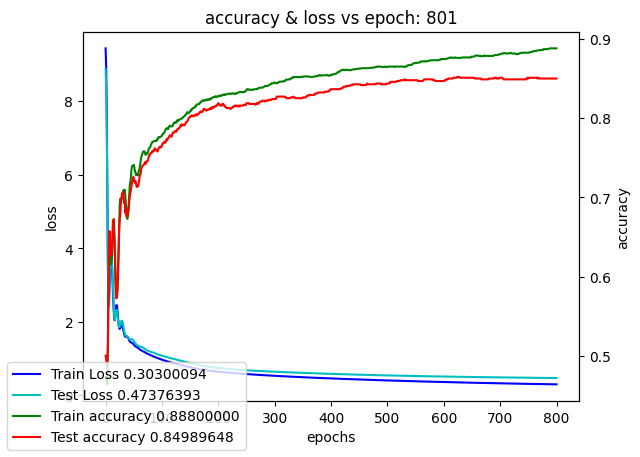

Training model color_cnn_single_kernel:   8%|▊         | 810/10000 [57:05<10:47:37,  4.23s/it]

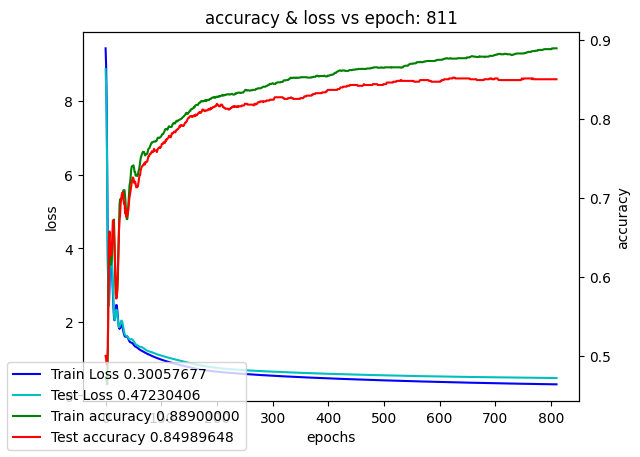

Training model color_cnn_single_kernel:   8%|▊         | 820/10000 [57:48<10:48:49,  4.24s/it]

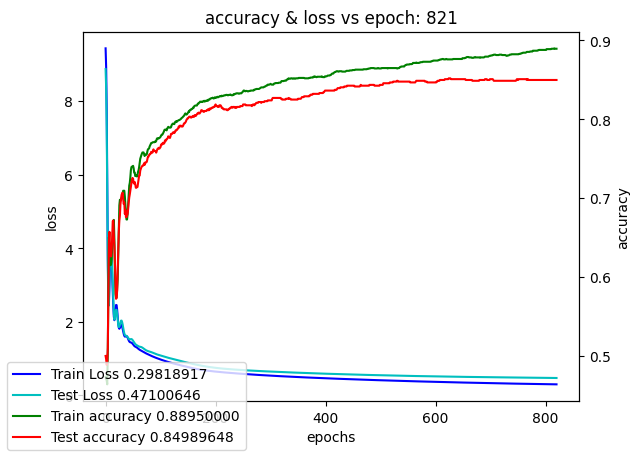

Training model color_cnn_single_kernel:   8%|▊         | 830/10000 [58:30<10:44:57,  4.22s/it]

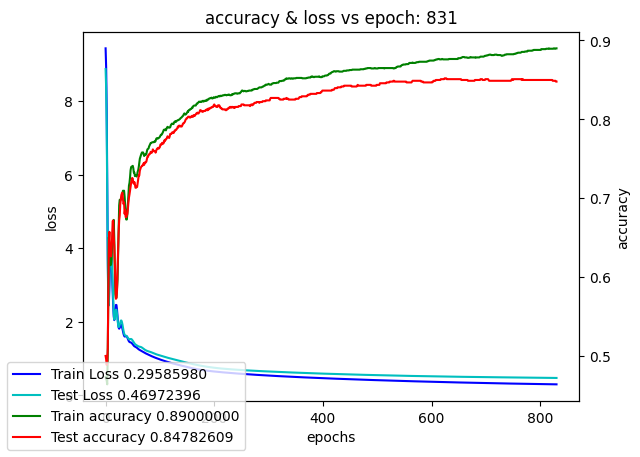

Training model color_cnn_single_kernel:   8%|▊         | 840/10000 [59:13<10:42:34,  4.21s/it]

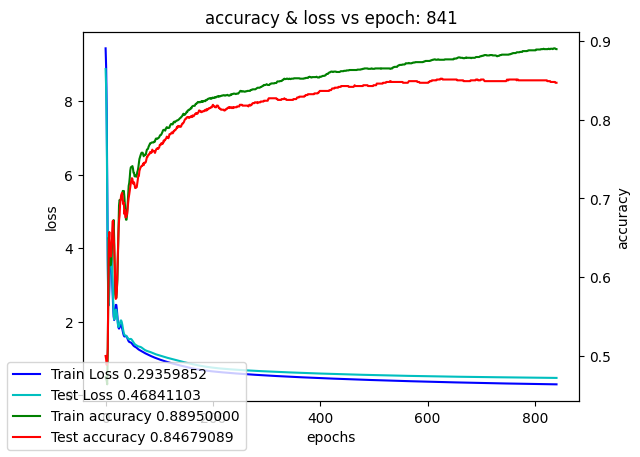

Training model color_cnn_single_kernel:   8%|▊         | 850/10000 [59:55<10:43:10,  4.22s/it]

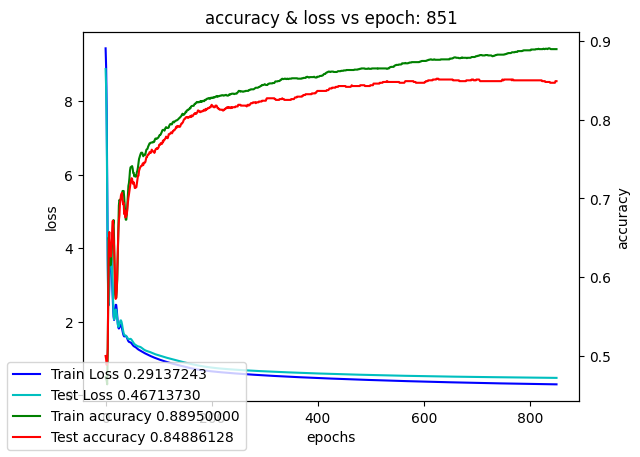

Training model color_cnn_single_kernel:   9%|▊         | 860/10000 [1:00:37<10:41:32,  4.21s/it]

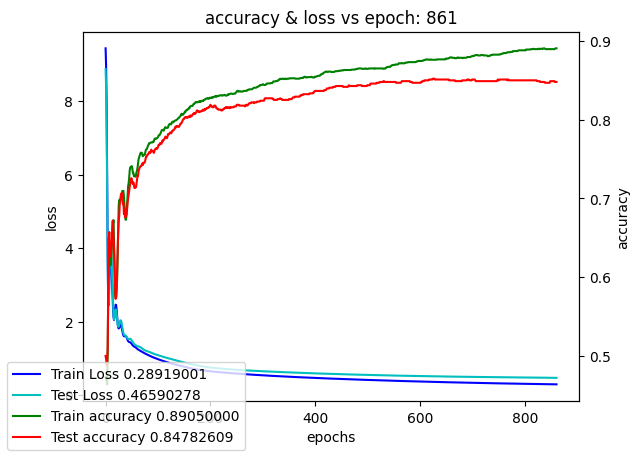

Training model color_cnn_single_kernel:   9%|▊         | 870/10000 [1:01:19<10:39:46,  4.20s/it]

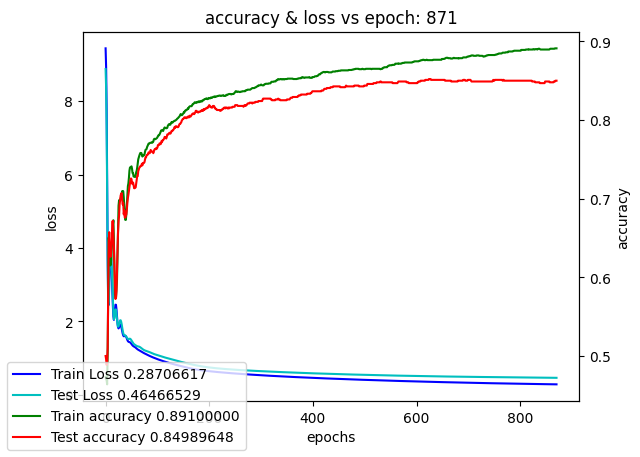

Training model color_cnn_single_kernel:   9%|▉         | 880/10000 [1:02:02<10:35:54,  4.18s/it]

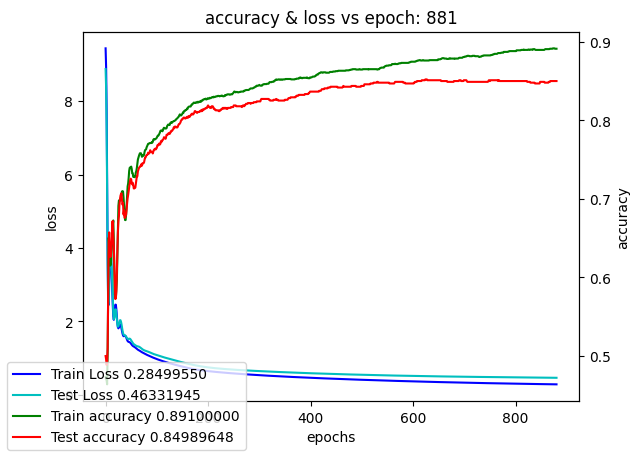

Training model color_cnn_single_kernel:   9%|▉         | 890/10000 [1:02:44<10:35:23,  4.18s/it]

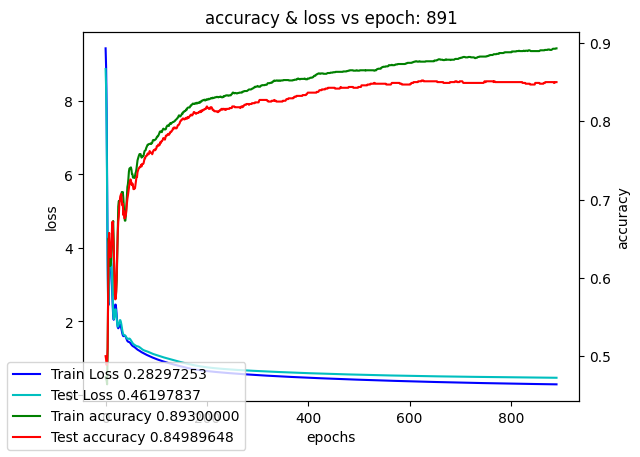

Training model color_cnn_single_kernel:   9%|▉         | 900/10000 [1:03:26<10:36:27,  4.20s/it]

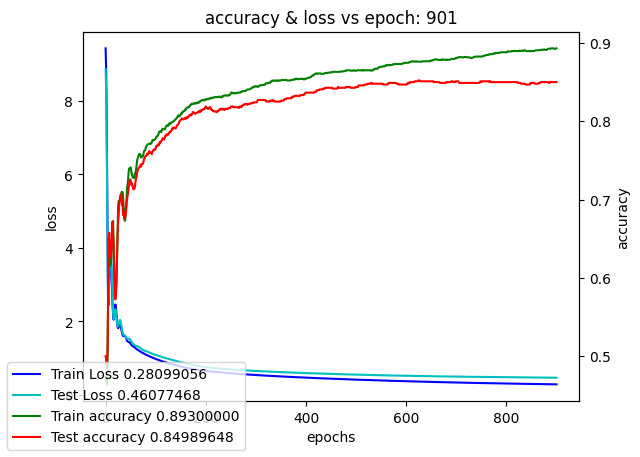

Training model color_cnn_single_kernel:   9%|▉         | 910/10000 [1:04:08<10:36:36,  4.20s/it]

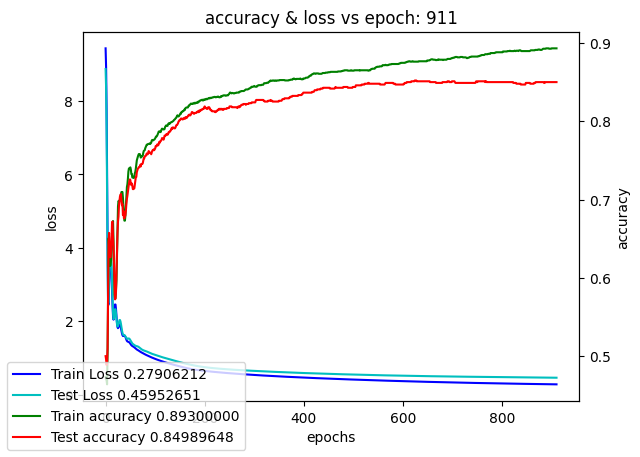

Training model color_cnn_single_kernel:   9%|▉         | 920/10000 [1:04:50<10:35:36,  4.20s/it]

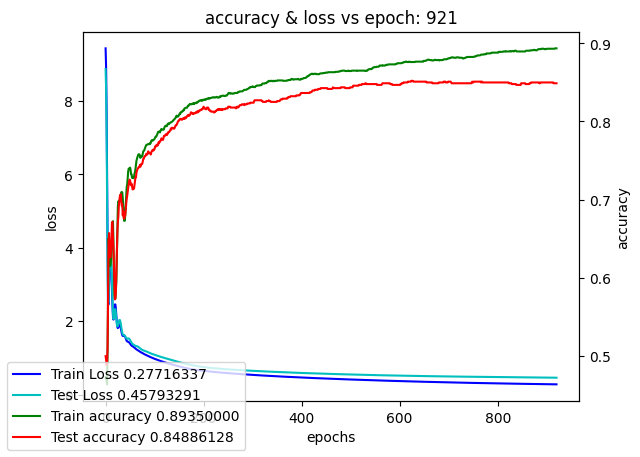

Training model color_cnn_single_kernel:   9%|▉         | 930/10000 [1:05:32<10:33:32,  4.19s/it]

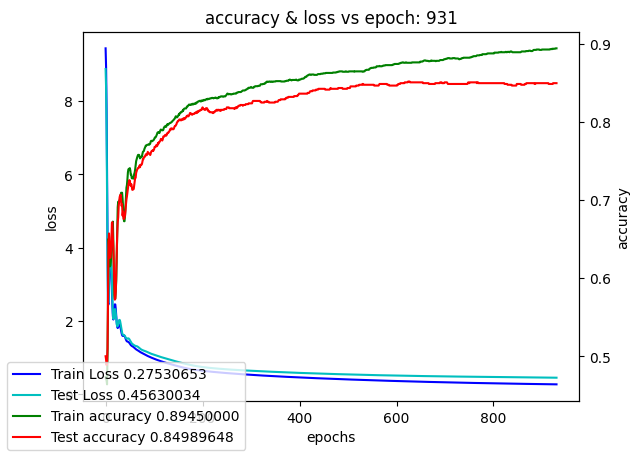

Training model color_cnn_single_kernel:   9%|▉         | 940/10000 [1:06:14<10:31:59,  4.19s/it]

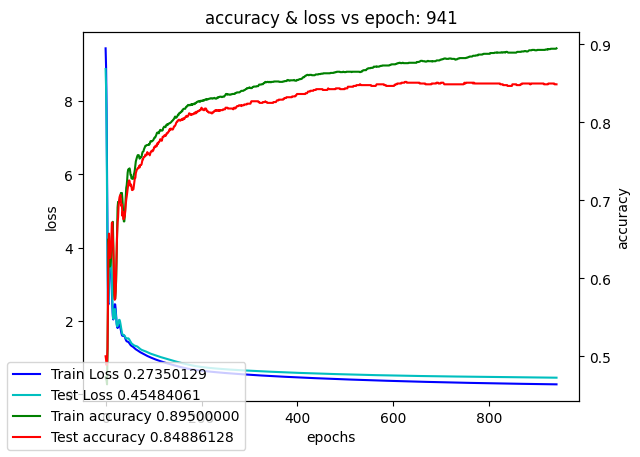

Training model color_cnn_single_kernel:  10%|▉         | 950/10000 [1:06:56<10:31:54,  4.19s/it]

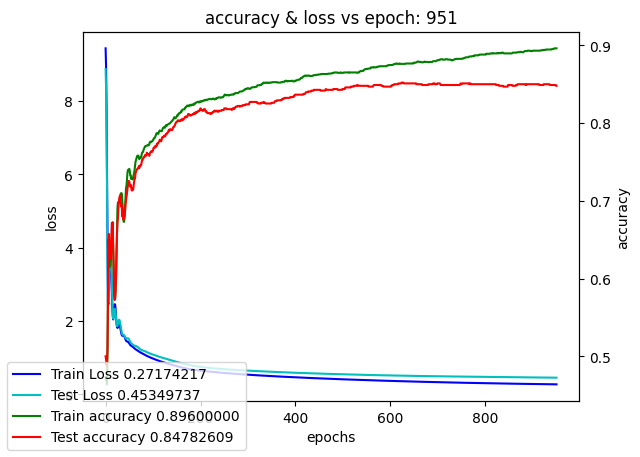

Training model color_cnn_single_kernel:  10%|▉         | 960/10000 [1:07:38<10:34:42,  4.21s/it]

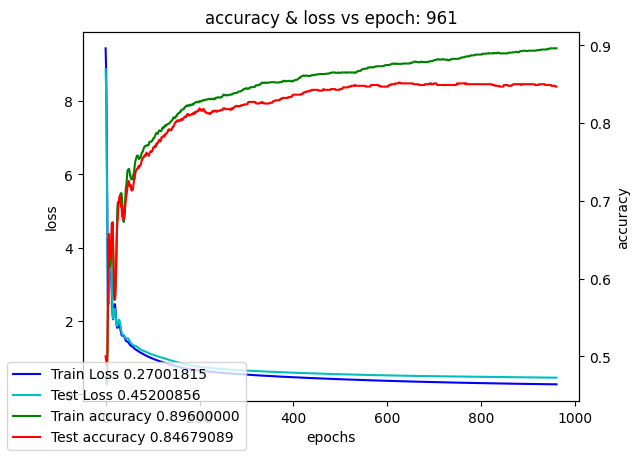

Training model color_cnn_single_kernel:  10%|▉         | 970/10000 [1:08:21<10:35:06,  4.22s/it]

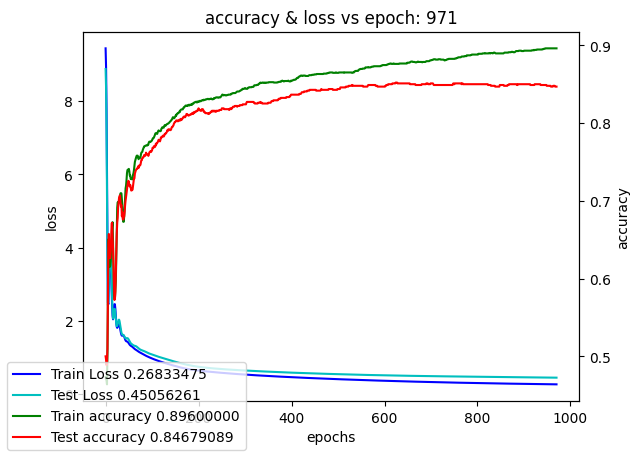

Training model color_cnn_single_kernel:  10%|▉         | 980/10000 [1:09:03<10:36:46,  4.24s/it]

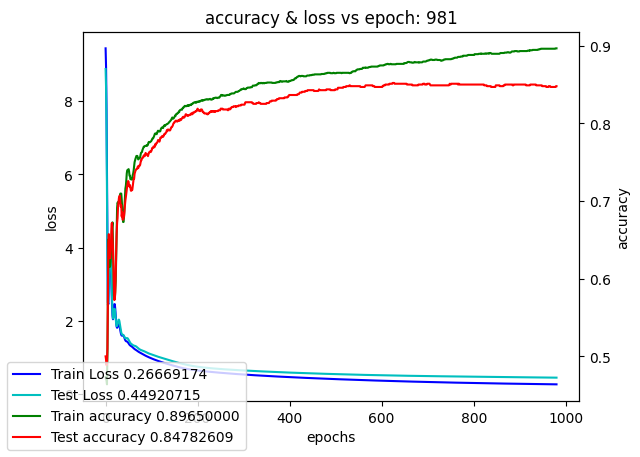

Training model color_cnn_single_kernel:  10%|▉         | 990/10000 [1:09:46<10:34:03,  4.22s/it]

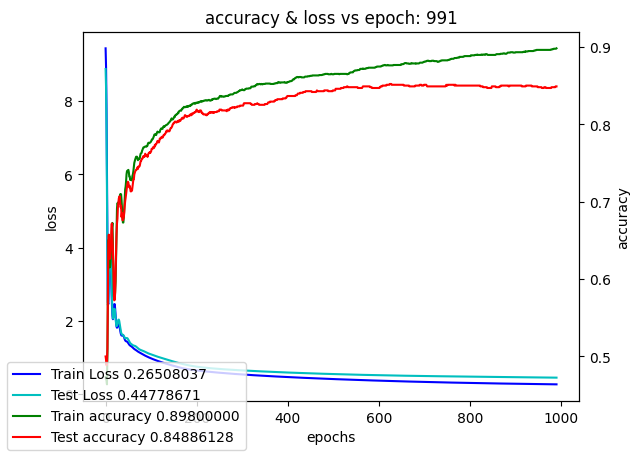

Training model color_cnn_single_kernel:  10%|█         | 1000/10000 [1:10:28<10:32:39,  4.22s/it]

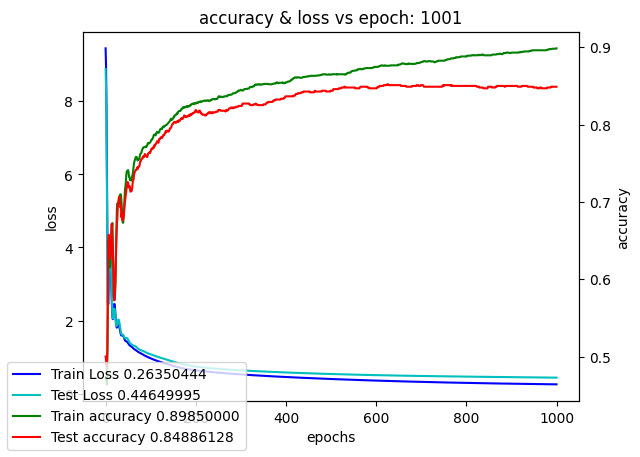

Training model color_cnn_single_kernel:  10%|█         | 1010/10000 [1:11:11<10:33:50,  4.23s/it]

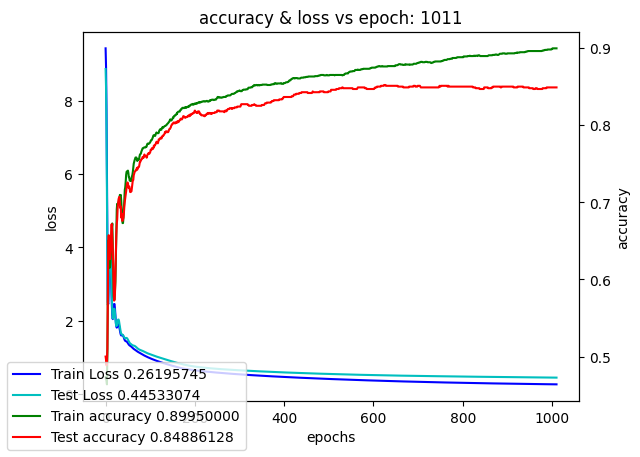

Training model color_cnn_single_kernel:  10%|█         | 1020/10000 [1:11:53<10:31:58,  4.22s/it]

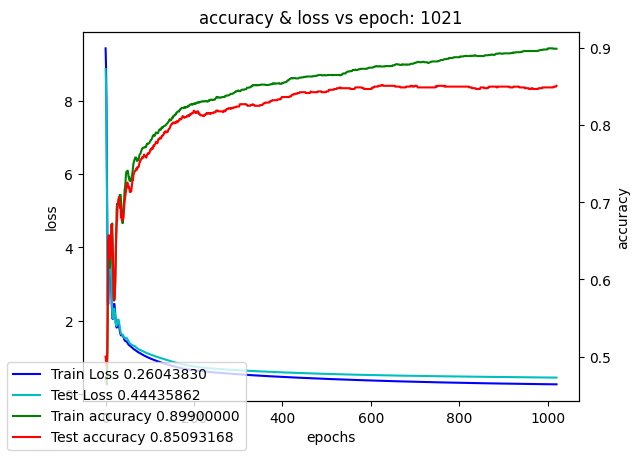

Training model color_cnn_single_kernel:  10%|█         | 1030/10000 [1:12:36<10:35:06,  4.25s/it]

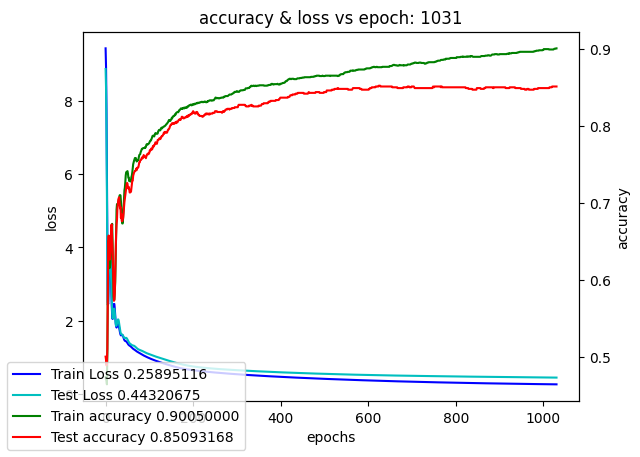

Training model color_cnn_single_kernel:  10%|█         | 1040/10000 [1:13:18<10:30:56,  4.23s/it]

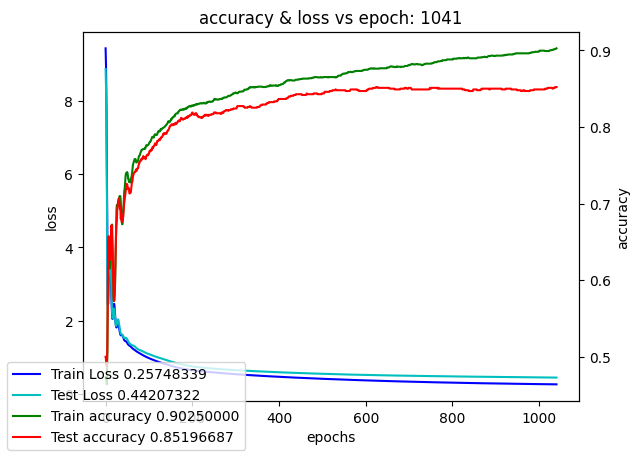

Training model color_cnn_single_kernel:  10%|█         | 1050/10000 [1:14:01<10:28:33,  4.21s/it]

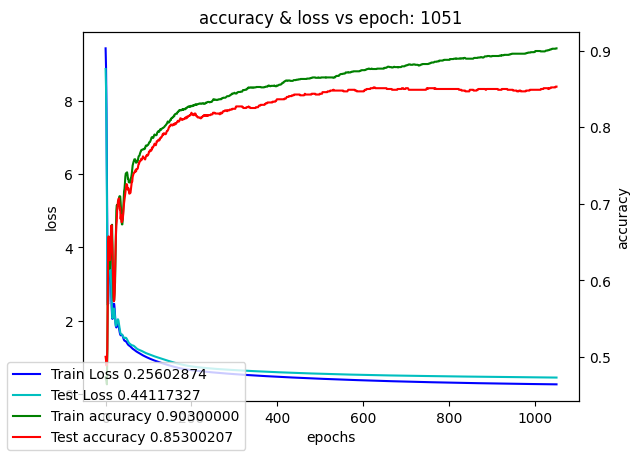

Training model color_cnn_single_kernel:  11%|█         | 1060/10000 [1:14:43<10:29:17,  4.22s/it]

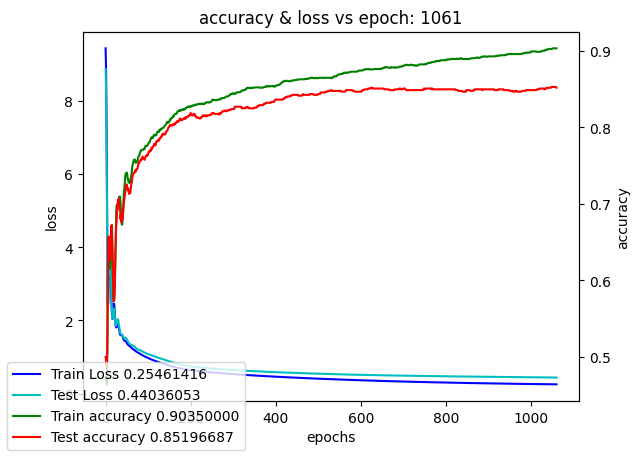

Training model color_cnn_single_kernel:  11%|█         | 1070/10000 [1:15:25<10:24:32,  4.20s/it]

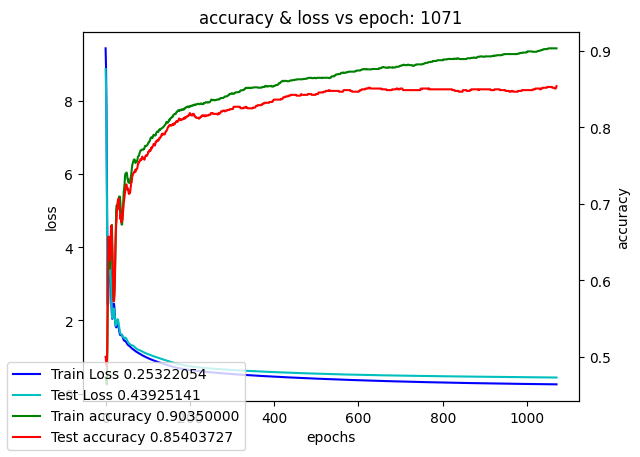

Training model color_cnn_single_kernel:  11%|█         | 1080/10000 [1:16:08<10:29:34,  4.23s/it]

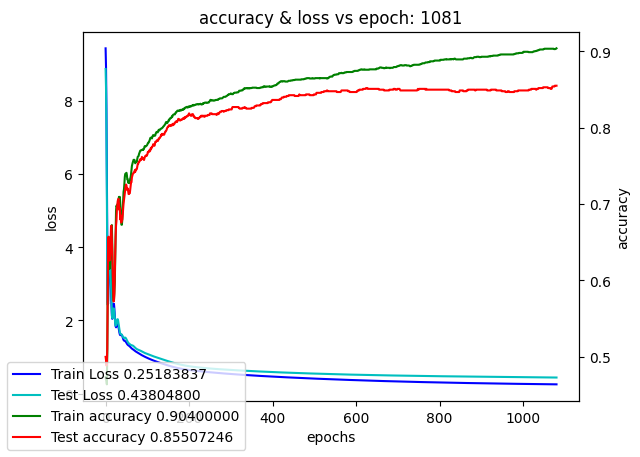

Training model color_cnn_single_kernel:  11%|█         | 1090/10000 [1:16:50<10:22:57,  4.19s/it]

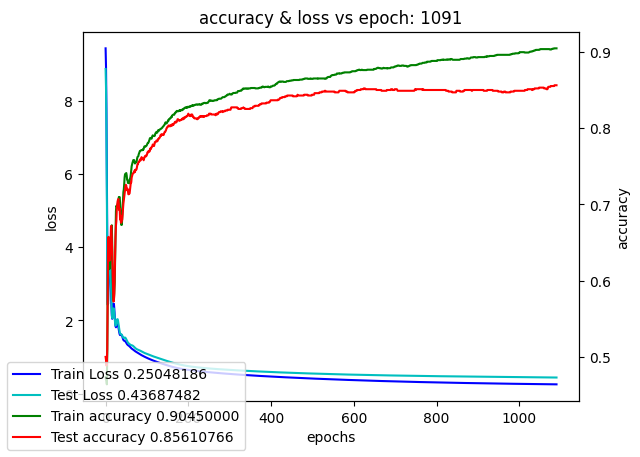

Training model color_cnn_single_kernel:  11%|█         | 1100/10000 [1:17:32<10:23:35,  4.20s/it]

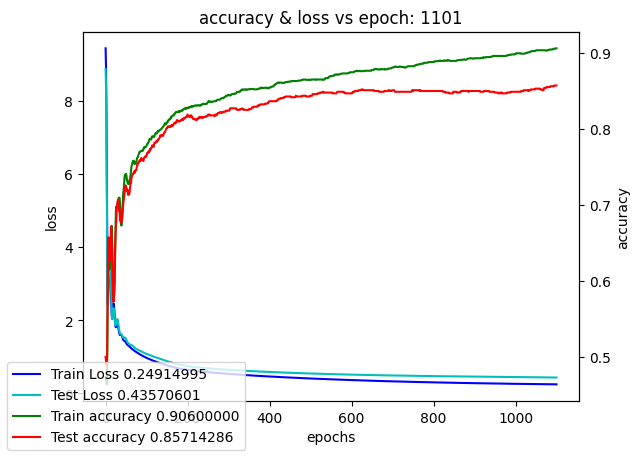

Training model color_cnn_single_kernel:  11%|█         | 1110/10000 [1:18:15<10:21:03,  4.19s/it]

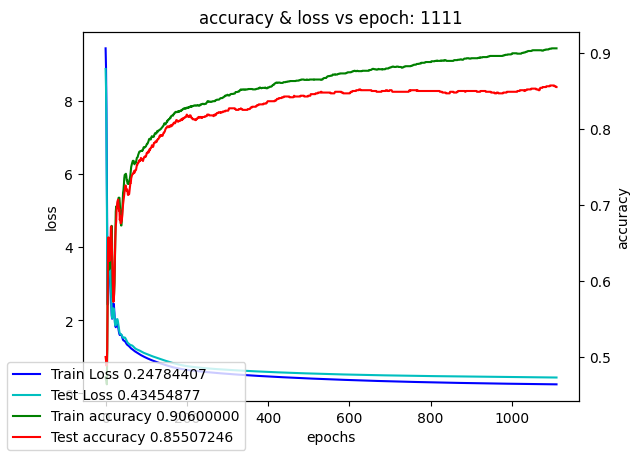

Training model color_cnn_single_kernel:  11%|█         | 1120/10000 [1:18:57<10:21:08,  4.20s/it]

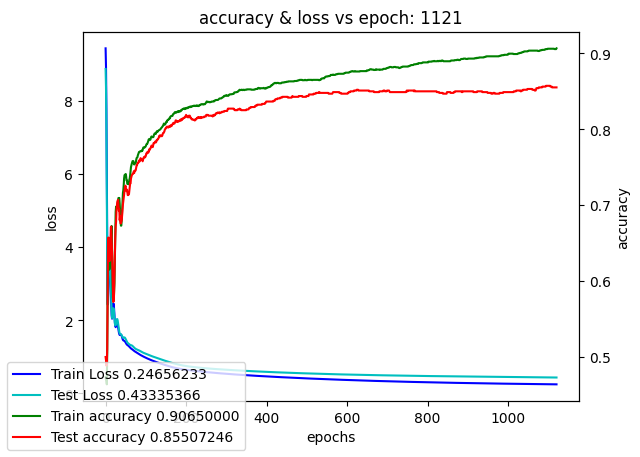

Training model color_cnn_single_kernel:  11%|█▏        | 1130/10000 [1:19:39<10:18:39,  4.18s/it]

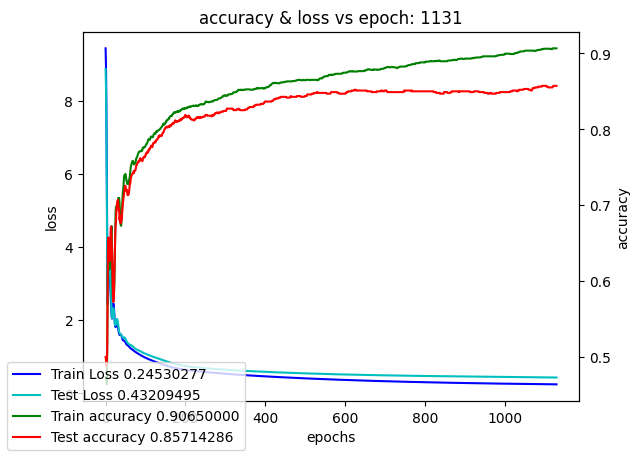

Training model color_cnn_single_kernel:  11%|█▏        | 1140/10000 [1:20:21<10:23:30,  4.22s/it]

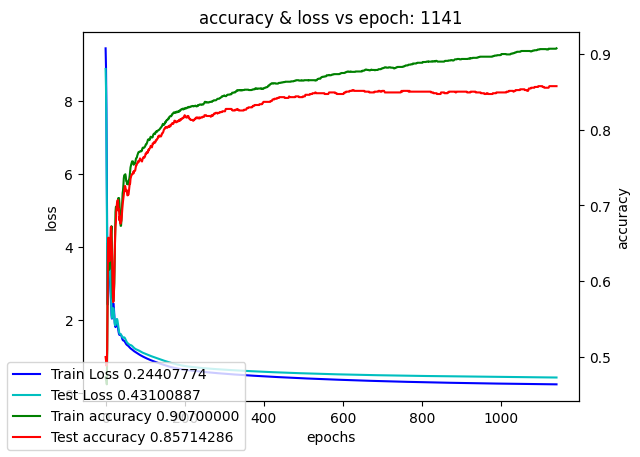

Training model color_cnn_single_kernel:  12%|█▏        | 1150/10000 [1:21:03<10:17:25,  4.19s/it]

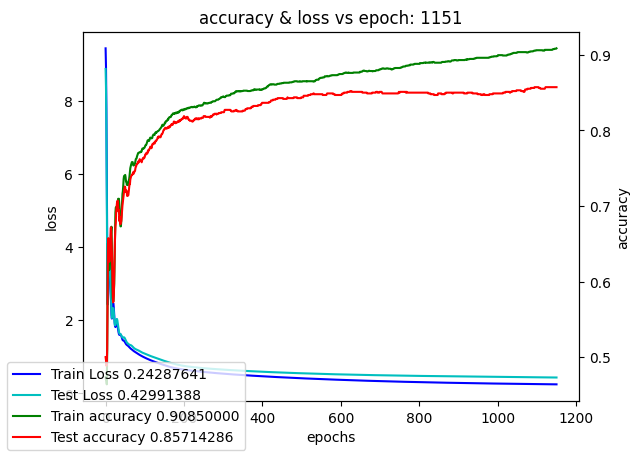

Training model color_cnn_single_kernel:  12%|█▏        | 1160/10000 [1:21:45<10:15:50,  4.18s/it]

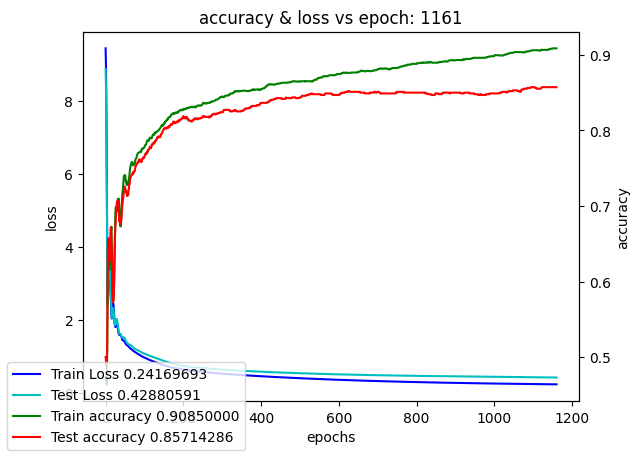

Training model color_cnn_single_kernel:  12%|█▏        | 1170/10000 [1:22:28<10:27:12,  4.26s/it]

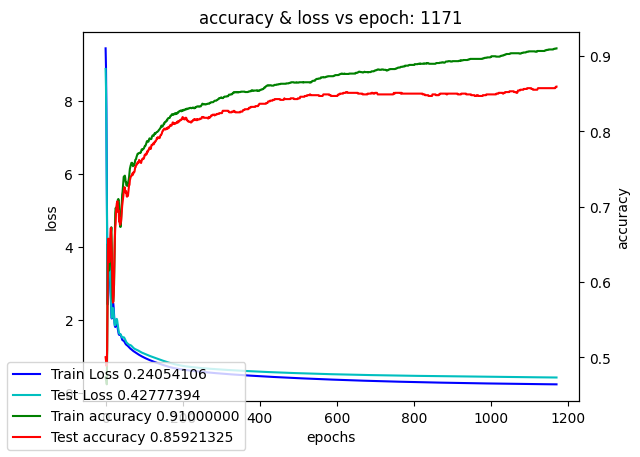

Training model color_cnn_single_kernel:  12%|█▏        | 1180/10000 [1:23:10<10:24:35,  4.25s/it]

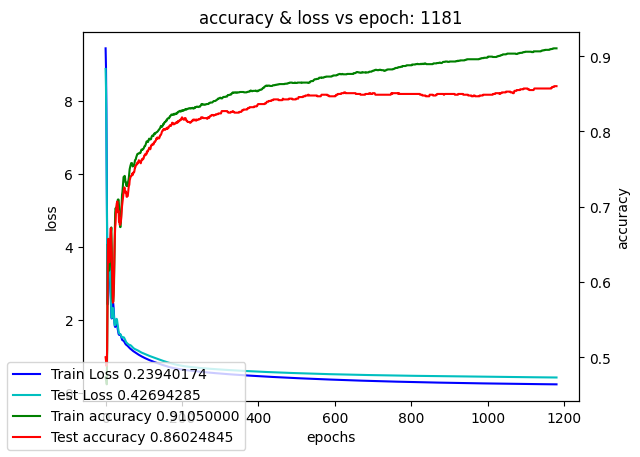

Training model color_cnn_single_kernel:  12%|█▏        | 1190/10000 [1:23:53<10:27:35,  4.27s/it]

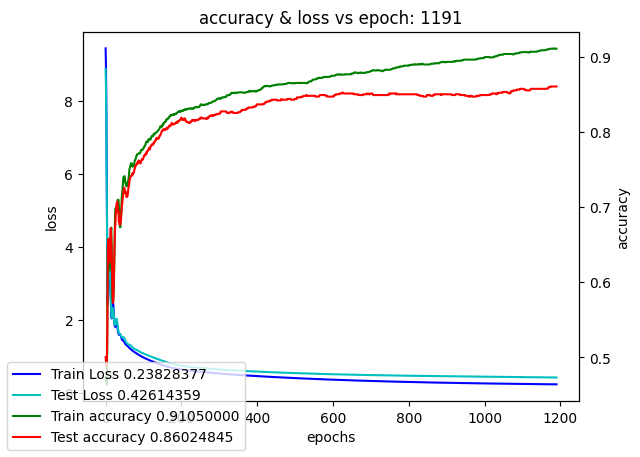

Training model color_cnn_single_kernel:  12%|█▏        | 1200/10000 [1:24:36<10:17:51,  4.21s/it]

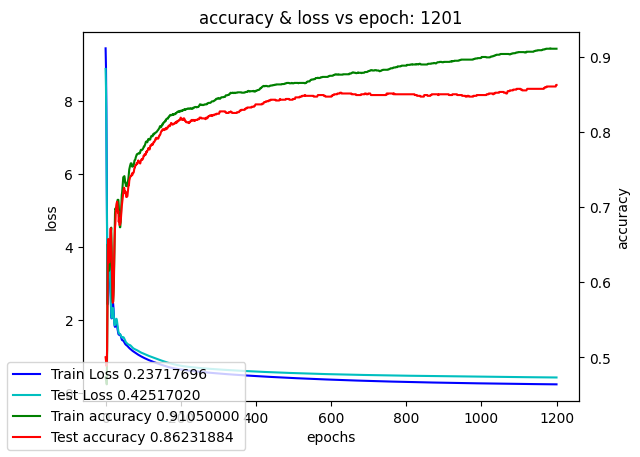

Training model color_cnn_single_kernel:  12%|█▏        | 1210/10000 [1:25:18<10:17:55,  4.22s/it]

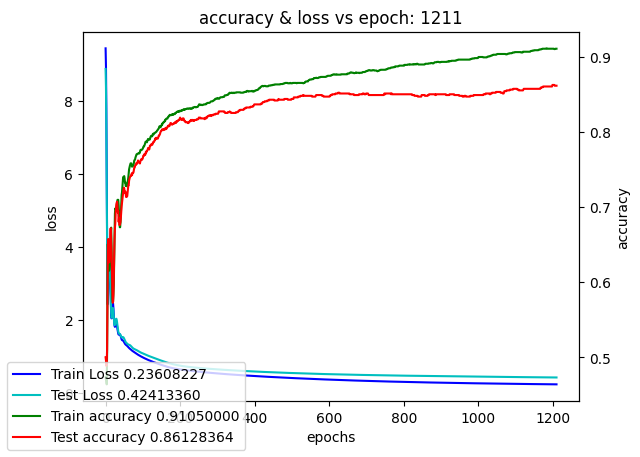

Training model color_cnn_single_kernel:  12%|█▏        | 1220/10000 [1:26:00<10:15:35,  4.21s/it]

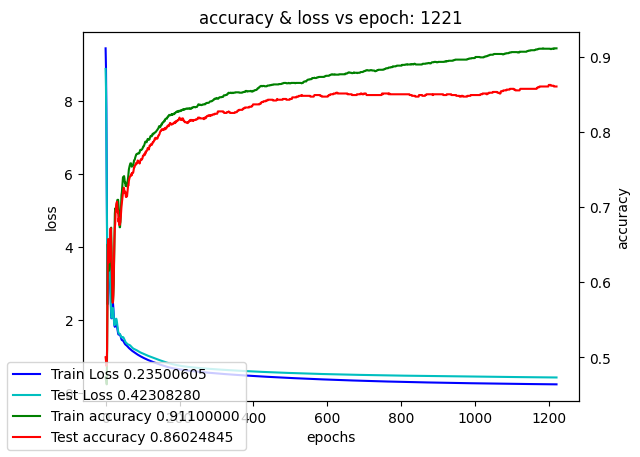

Training model color_cnn_single_kernel:  12%|█▏        | 1230/10000 [1:26:43<10:19:48,  4.24s/it]

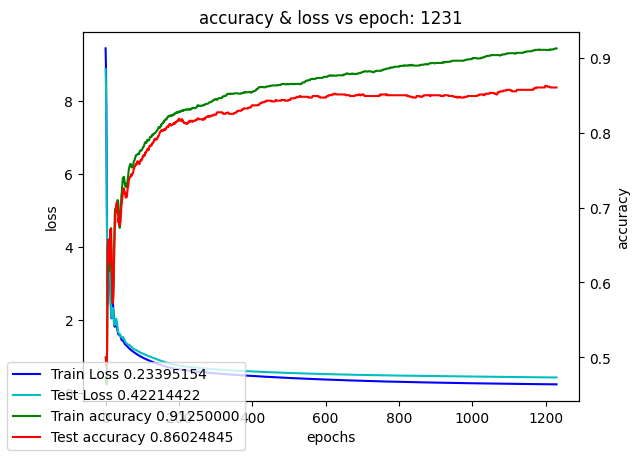

Training model color_cnn_single_kernel:  12%|█▏        | 1240/10000 [1:27:25<10:15:53,  4.22s/it]

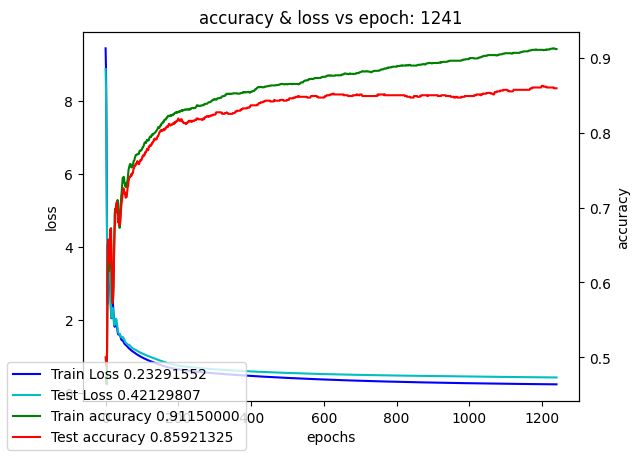

Training model color_cnn_single_kernel:  12%|█▎        | 1250/10000 [1:28:08<10:14:33,  4.21s/it]

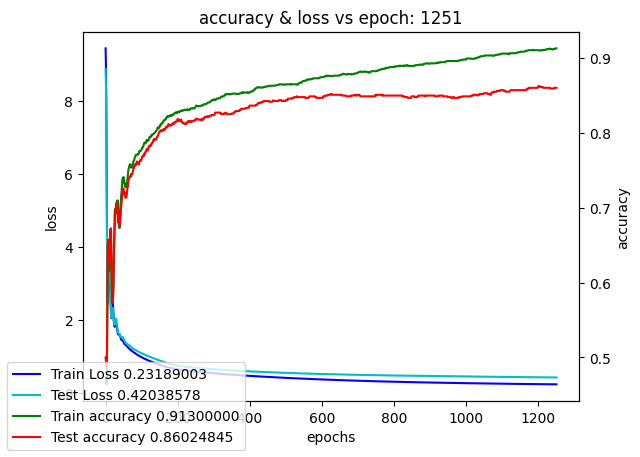

Training model color_cnn_single_kernel:  13%|█▎        | 1260/10000 [1:28:50<10:12:57,  4.21s/it]

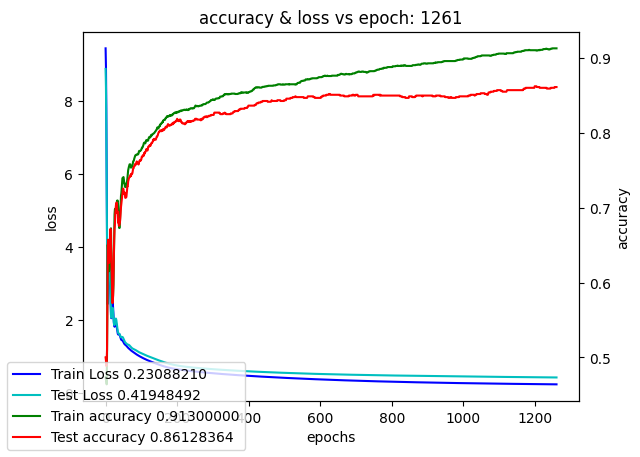

Training model color_cnn_single_kernel:  13%|█▎        | 1270/10000 [1:29:32<10:10:12,  4.19s/it]

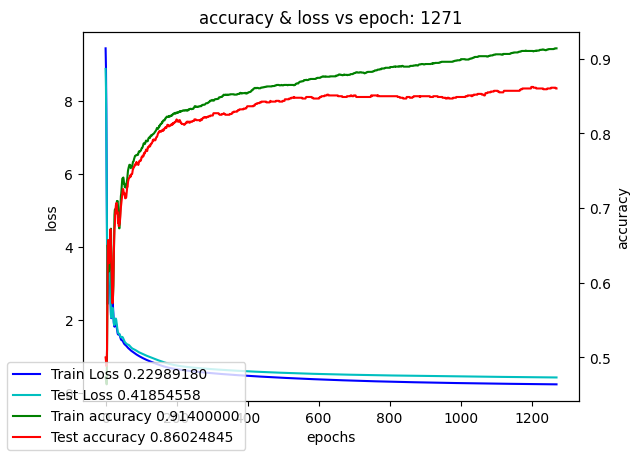

Training model color_cnn_single_kernel:  13%|█▎        | 1280/10000 [1:30:14<10:07:07,  4.18s/it]

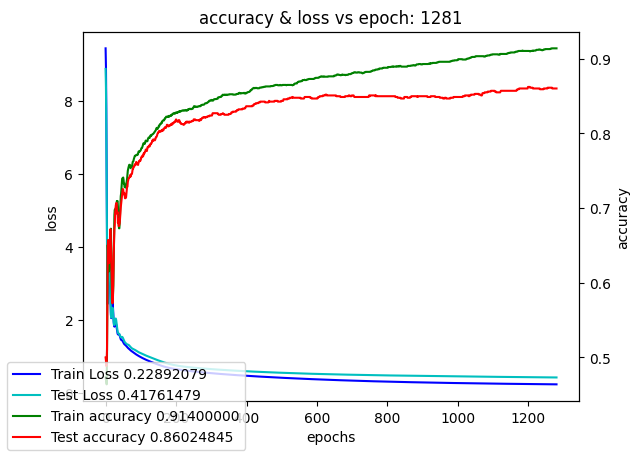

Training model color_cnn_single_kernel:  13%|█▎        | 1290/10000 [1:30:56<10:08:29,  4.19s/it]

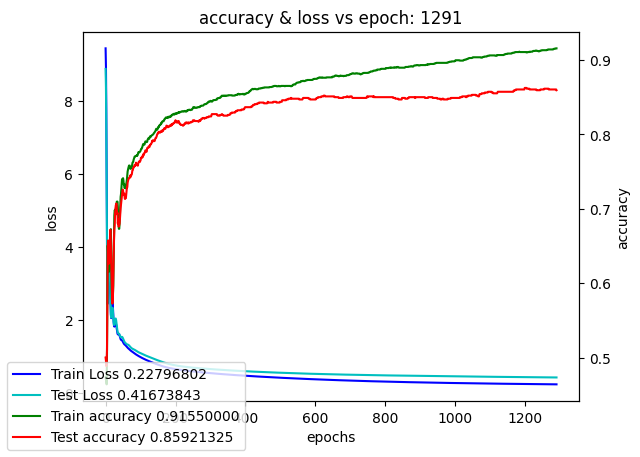

Training model color_cnn_single_kernel:  13%|█▎        | 1300/10000 [1:31:38<10:06:51,  4.19s/it]

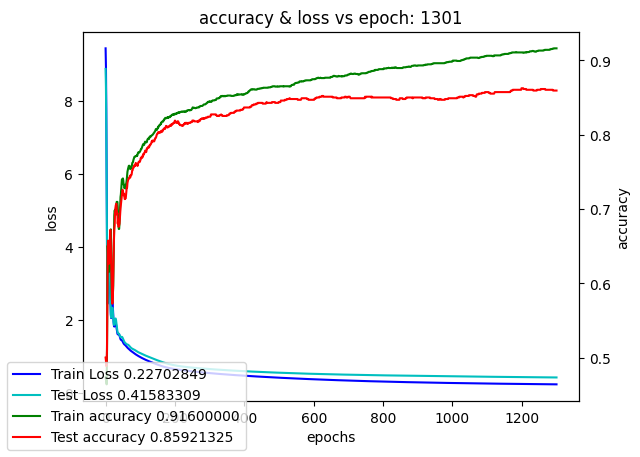

Training model color_cnn_single_kernel:  13%|█▎        | 1310/10000 [1:32:20<10:05:10,  4.18s/it]

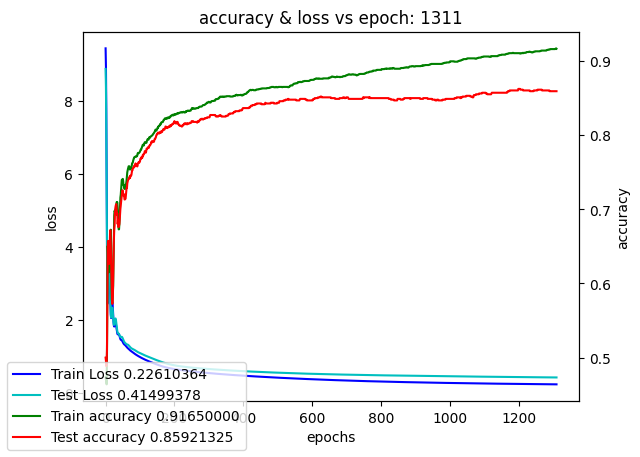

Training model color_cnn_single_kernel:  13%|█▎        | 1320/10000 [1:33:02<10:07:31,  4.20s/it]

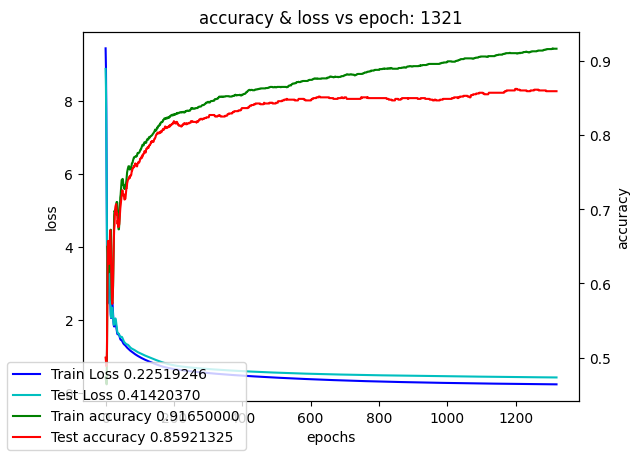

Training model color_cnn_single_kernel:  13%|█▎        | 1330/10000 [1:33:45<10:05:19,  4.19s/it]

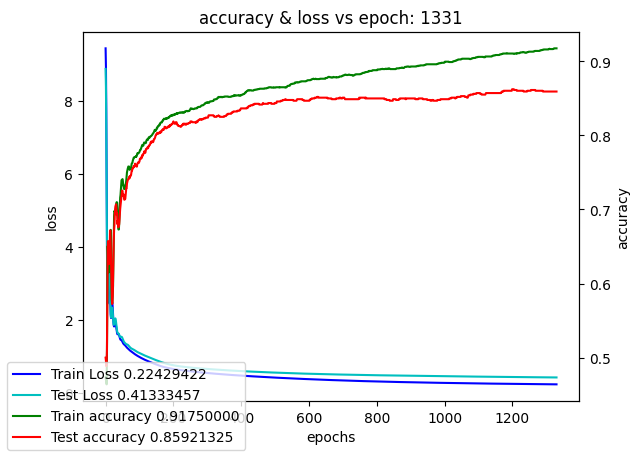

Training model color_cnn_single_kernel:  13%|█▎        | 1340/10000 [1:34:27<10:04:58,  4.19s/it]

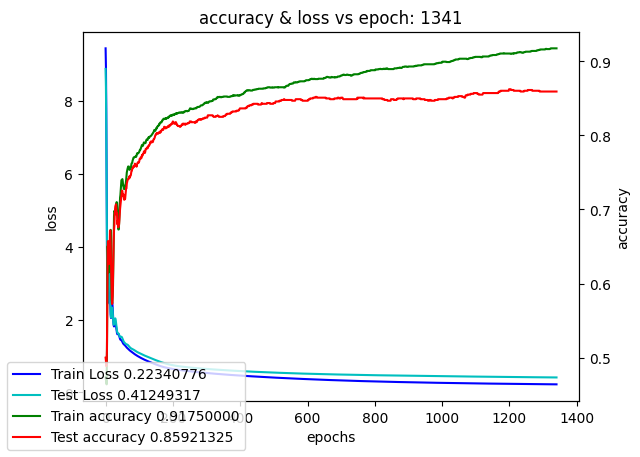

Training model color_cnn_single_kernel:  14%|█▎        | 1350/10000 [1:35:09<10:06:25,  4.21s/it]

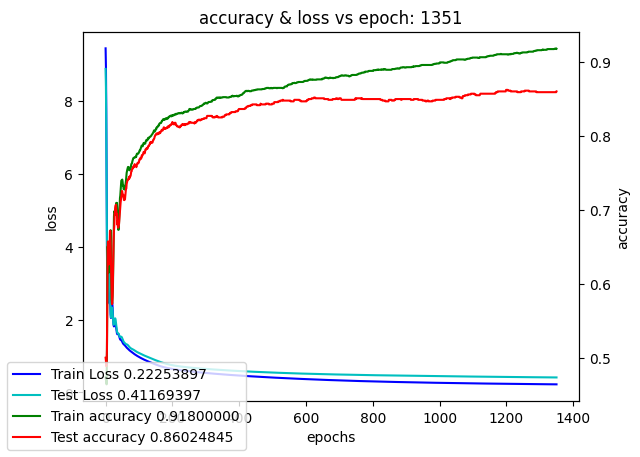

Training model color_cnn_single_kernel:  14%|█▎        | 1360/10000 [1:35:51<10:02:58,  4.19s/it]

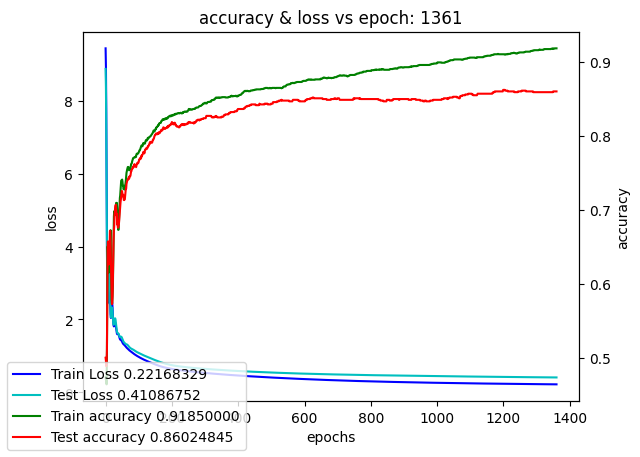

Training model color_cnn_single_kernel:  14%|█▎        | 1370/10000 [1:36:34<10:06:50,  4.22s/it]

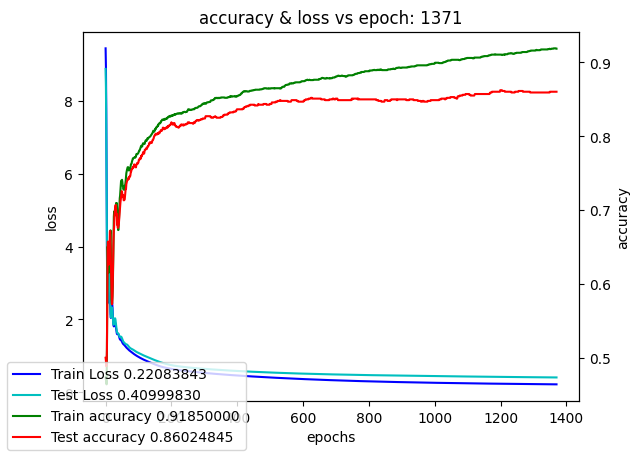

Training model color_cnn_single_kernel:  14%|█▍        | 1380/10000 [1:37:16<10:07:07,  4.23s/it]

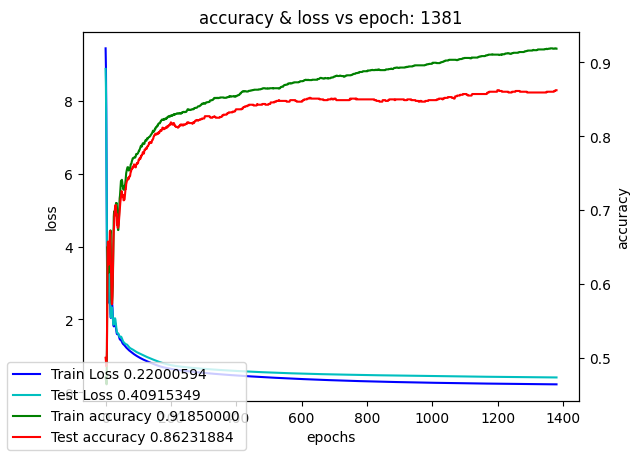

Training model color_cnn_single_kernel:  14%|█▍        | 1390/10000 [1:37:58<10:05:14,  4.22s/it]

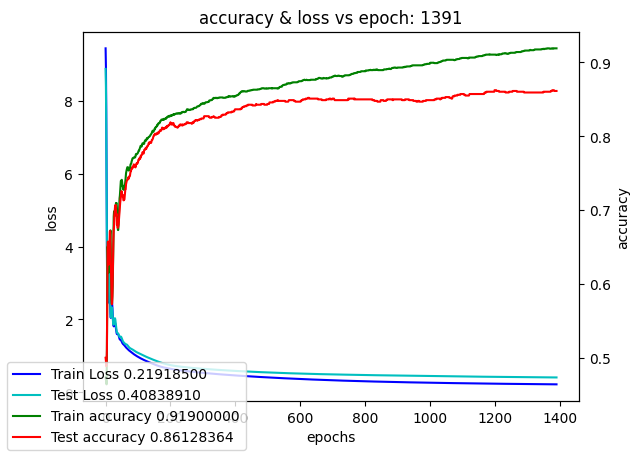

Training model color_cnn_single_kernel:  14%|█▍        | 1400/10000 [1:38:41<10:07:30,  4.24s/it]

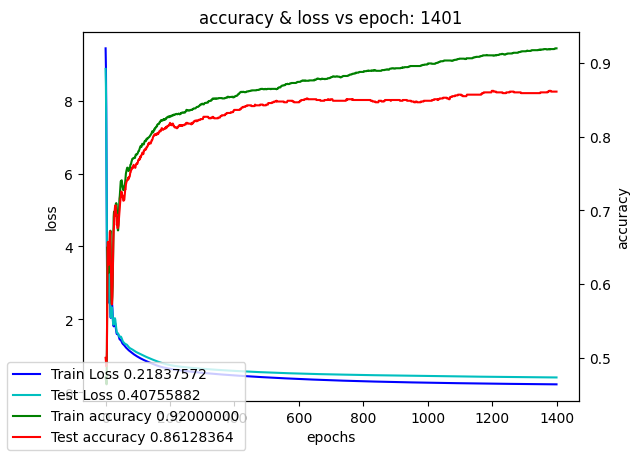

Training model color_cnn_single_kernel:  14%|█▍        | 1410/10000 [1:39:23<10:05:20,  4.23s/it]

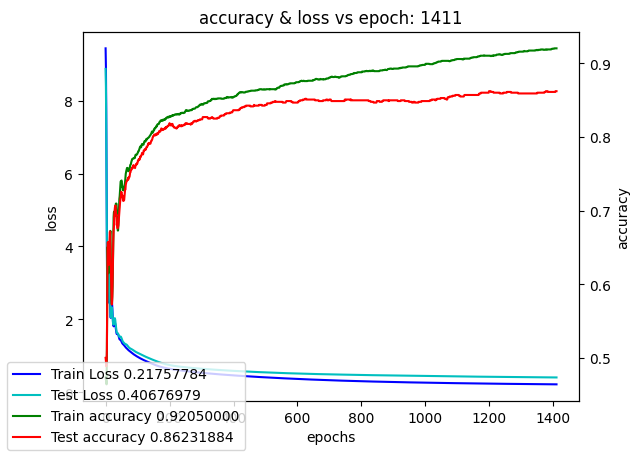

Training model color_cnn_single_kernel:  14%|█▍        | 1420/10000 [1:40:06<10:06:13,  4.24s/it]

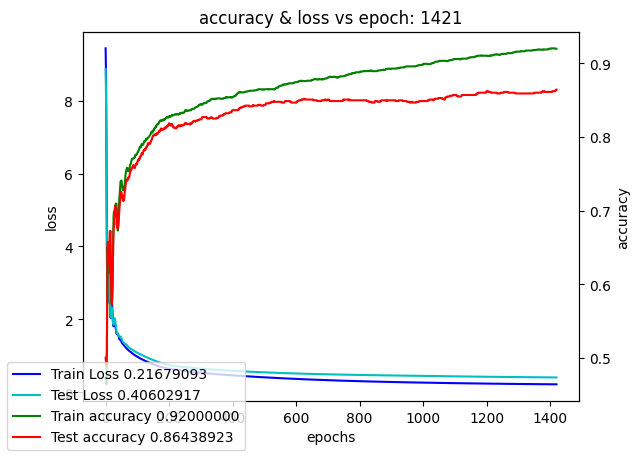

Training model color_cnn_single_kernel:  14%|█▍        | 1430/10000 [1:40:48<10:07:48,  4.26s/it]

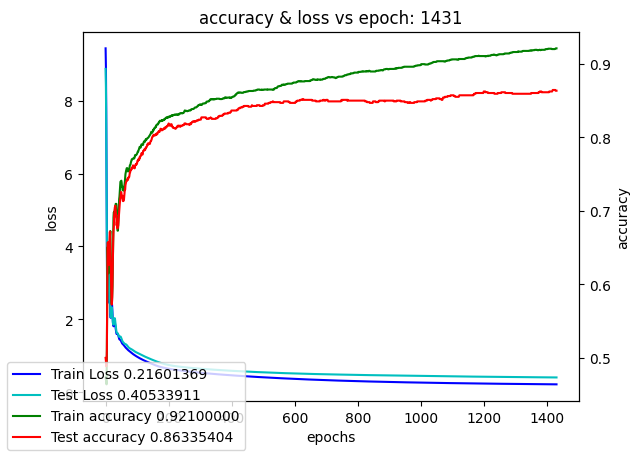

Training model color_cnn_single_kernel:  14%|█▍        | 1440/10000 [1:41:31<9:59:43,  4.20s/it] 

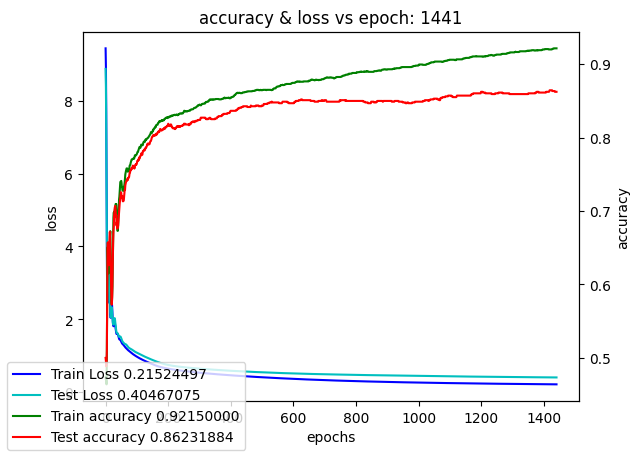

Training model color_cnn_single_kernel:  14%|█▍        | 1450/10000 [1:42:13<10:00:20,  4.21s/it]

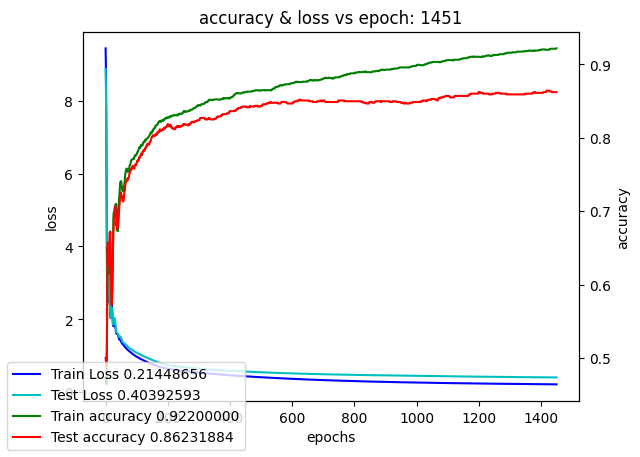

Training model color_cnn_single_kernel:  15%|█▍        | 1460/10000 [1:42:55<9:55:49,  4.19s/it]

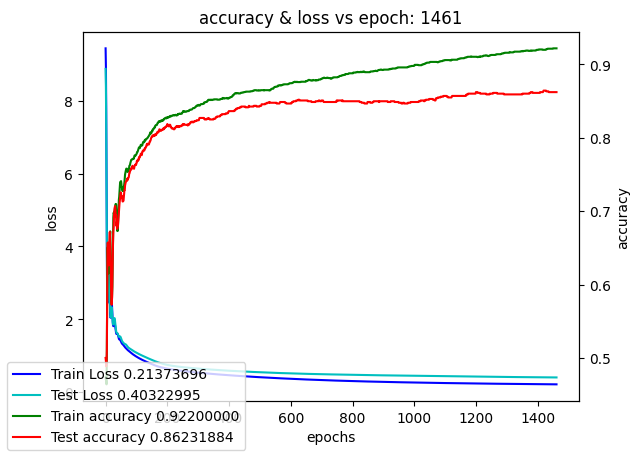

Training model color_cnn_single_kernel:  15%|█▍        | 1470/10000 [1:43:37<9:52:21,  4.17s/it]

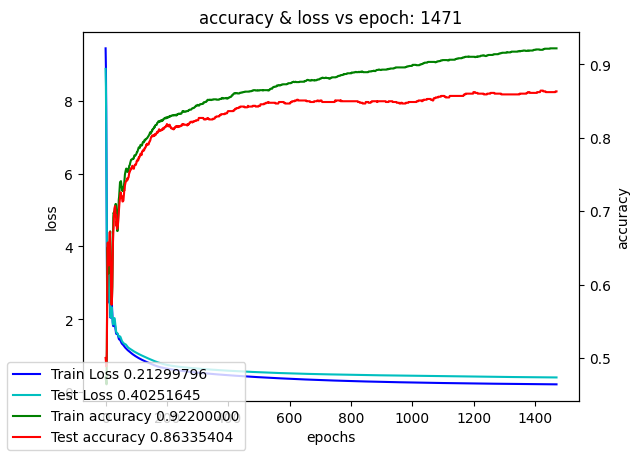

Training model color_cnn_single_kernel:  15%|█▍        | 1480/10000 [1:44:19<9:51:41,  4.17s/it]

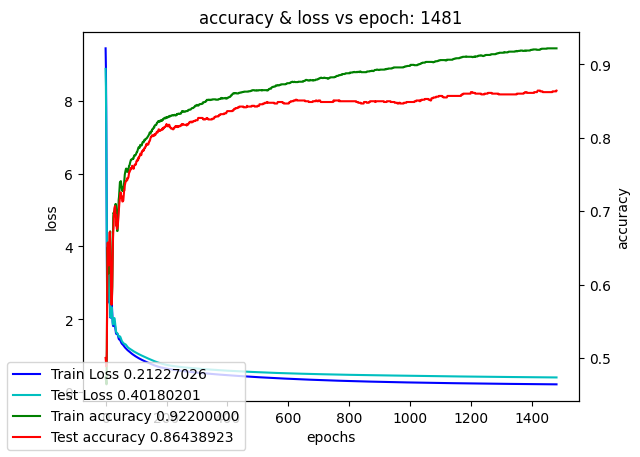

Training model color_cnn_single_kernel:  15%|█▍        | 1490/10000 [1:45:01<9:53:13,  4.18s/it]

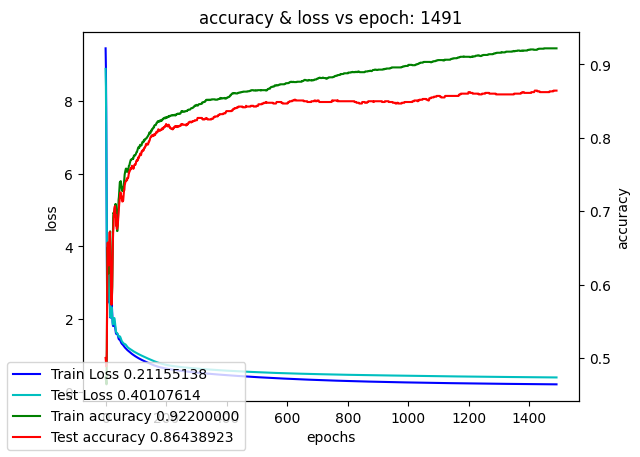

Training model color_cnn_single_kernel:  15%|█▌        | 1500/10000 [1:45:43<9:52:06,  4.18s/it]

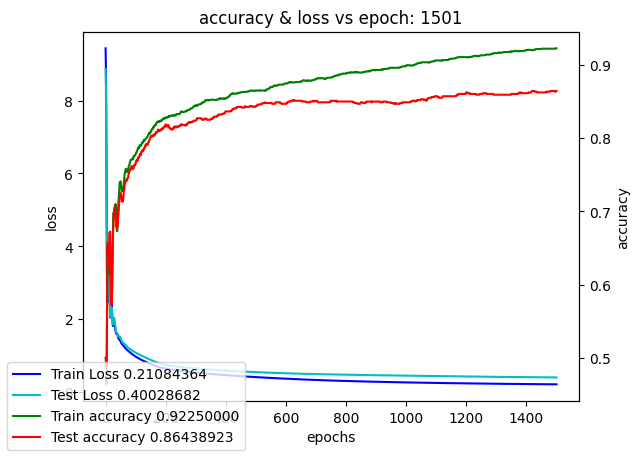

Training model color_cnn_single_kernel:  15%|█▌        | 1510/10000 [1:46:25<9:54:02,  4.20s/it]

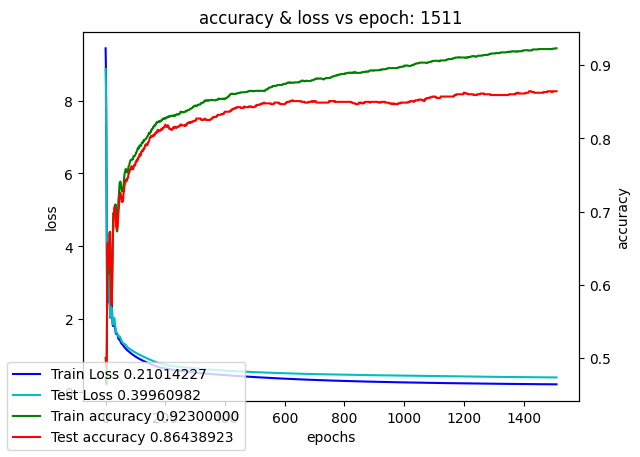

Training model color_cnn_single_kernel:  15%|█▌        | 1520/10000 [1:47:07<9:51:20,  4.18s/it]

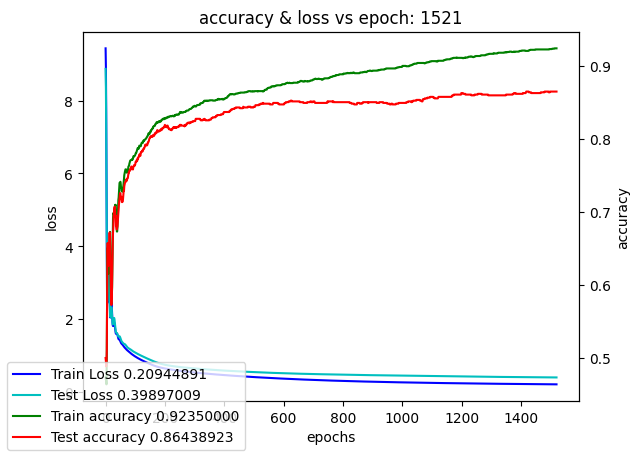

Training model color_cnn_single_kernel:  15%|█▌        | 1530/10000 [1:47:50<9:55:49,  4.22s/it]

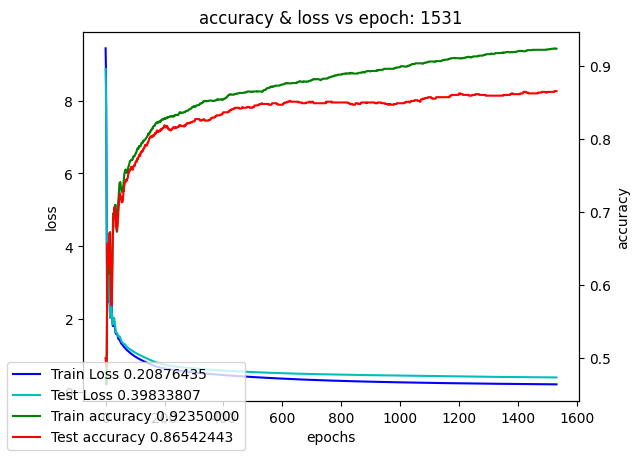

Training model color_cnn_single_kernel:  15%|█▌        | 1540/10000 [1:48:32<9:53:12,  4.21s/it]

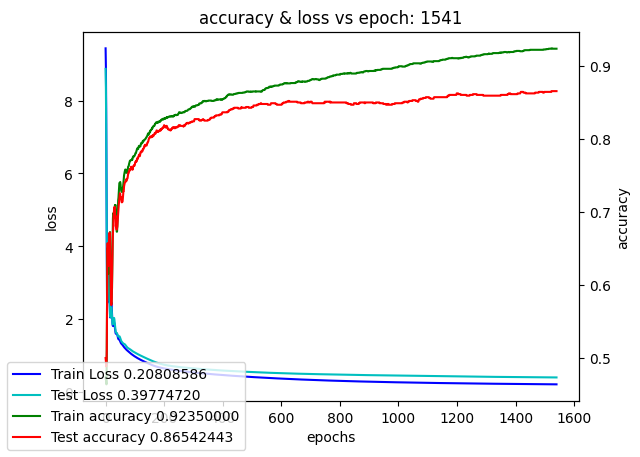

Training model color_cnn_single_kernel:  16%|█▌        | 1550/10000 [1:49:14<9:52:59,  4.21s/it]

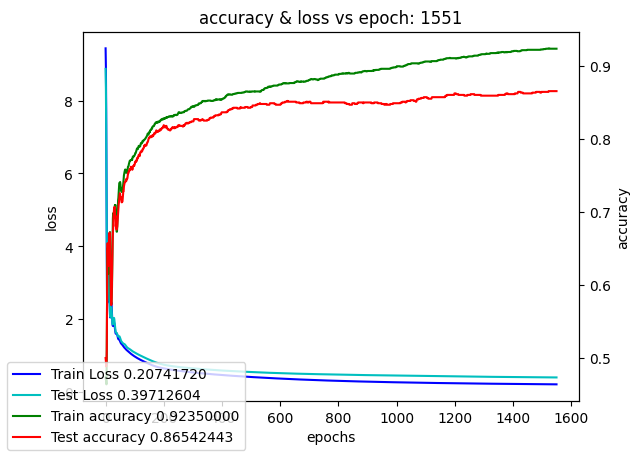

Training model color_cnn_single_kernel:  16%|█▌        | 1560/10000 [1:49:56<9:50:18,  4.20s/it]

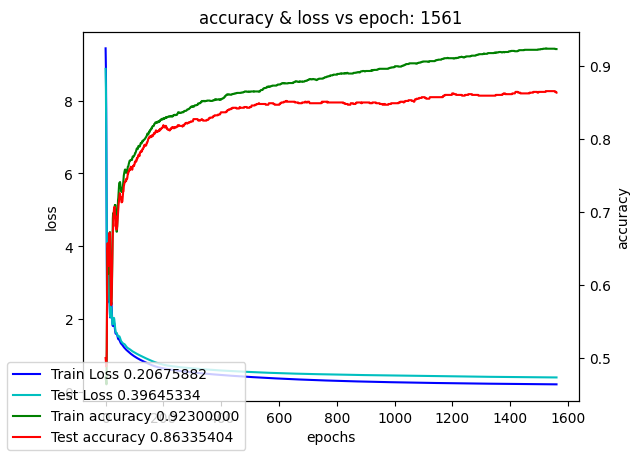

Training model color_cnn_single_kernel:  16%|█▌        | 1570/10000 [1:50:39<9:57:24,  4.25s/it]

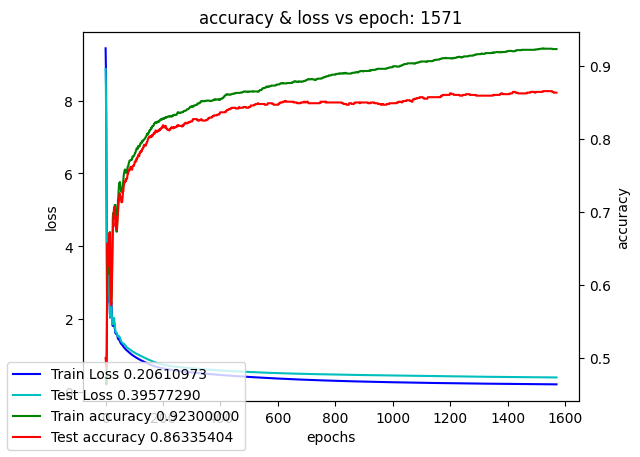

Training model color_cnn_single_kernel:  16%|█▌        | 1580/10000 [1:51:21<9:56:17,  4.25s/it]

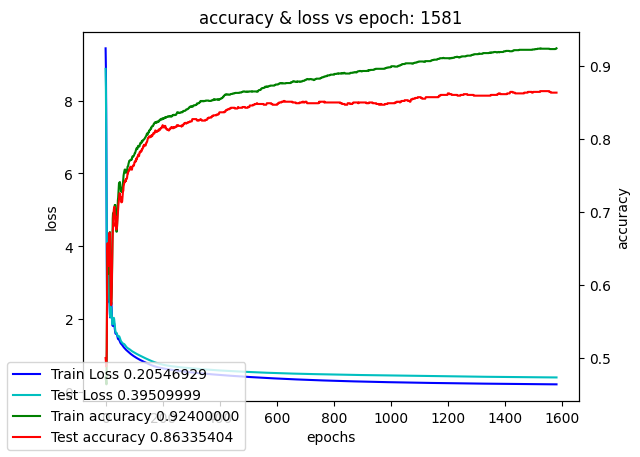

Training model color_cnn_single_kernel:  16%|█▌        | 1590/10000 [1:52:04<9:57:33,  4.26s/it]

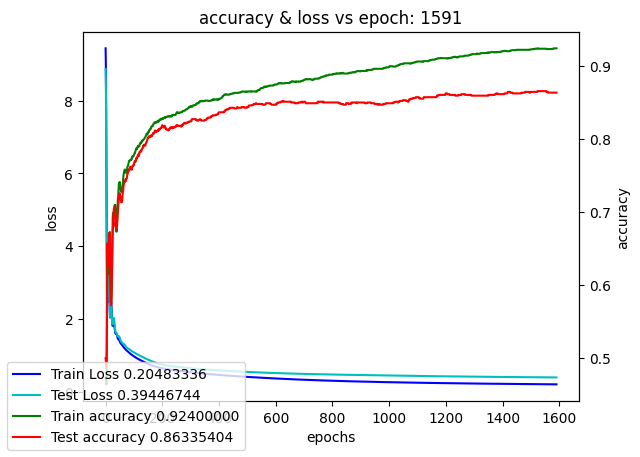

Training model color_cnn_single_kernel:  16%|█▌        | 1600/10000 [1:52:47<9:56:53,  4.26s/it]

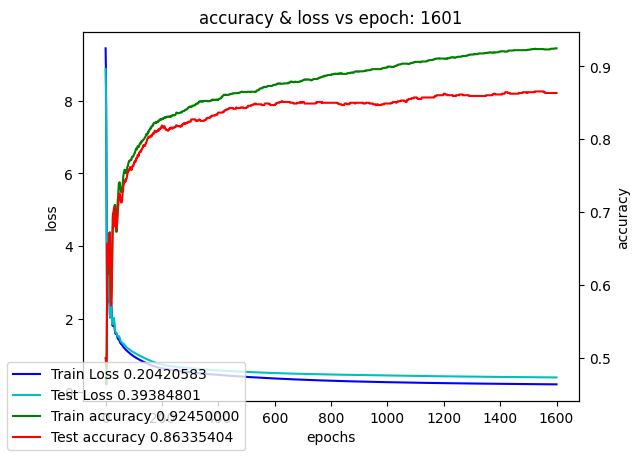

Training model color_cnn_single_kernel:  16%|█▌        | 1610/10000 [1:53:29<9:51:56,  4.23s/it]

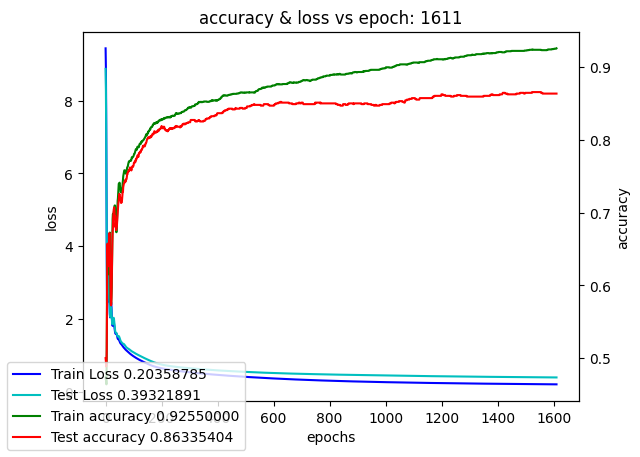

Training model color_cnn_single_kernel:  16%|█▌        | 1620/10000 [1:54:12<9:51:14,  4.23s/it]

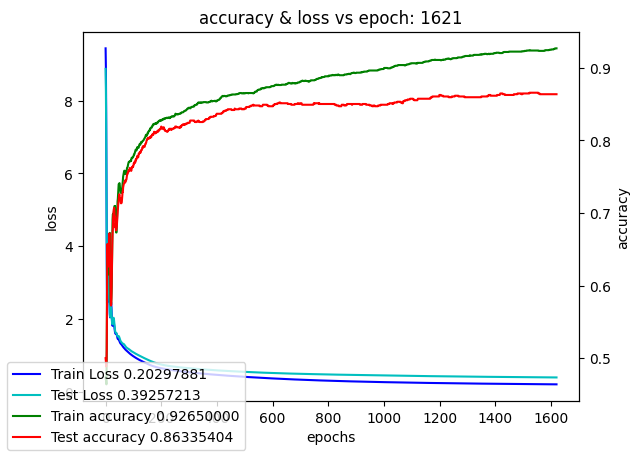

Training model color_cnn_single_kernel:  16%|█▋        | 1630/10000 [1:54:54<9:46:42,  4.21s/it]

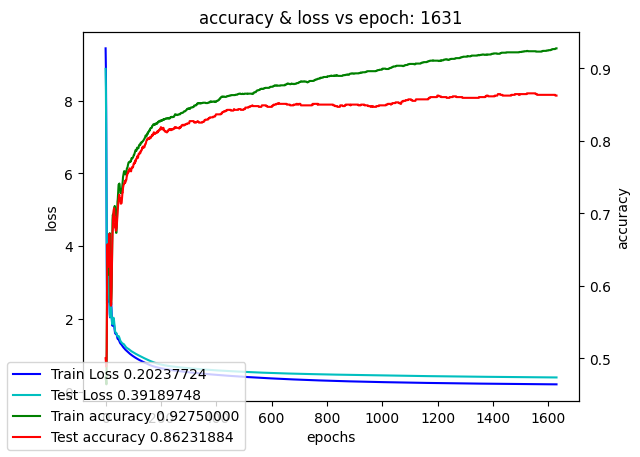

Training model color_cnn_single_kernel:  16%|█▋        | 1640/10000 [1:55:37<9:46:02,  4.21s/it]

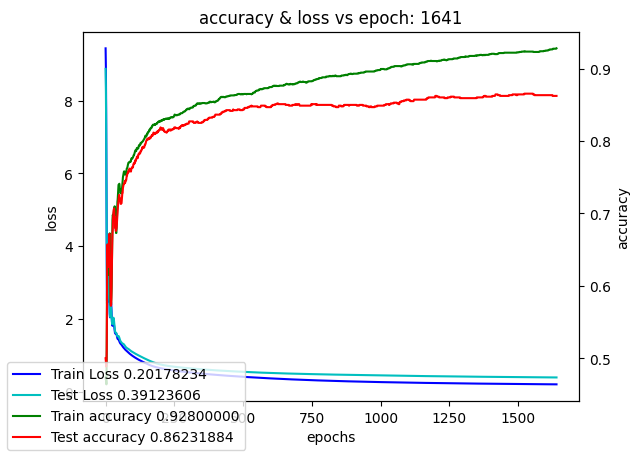

Training model color_cnn_single_kernel:  16%|█▋        | 1650/10000 [1:56:19<9:45:28,  4.21s/it]

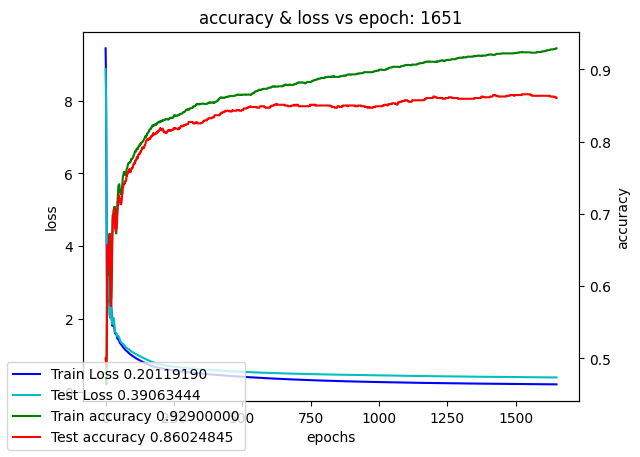

Training model color_cnn_single_kernel:  17%|█▋        | 1660/10000 [1:57:01<9:43:29,  4.20s/it]

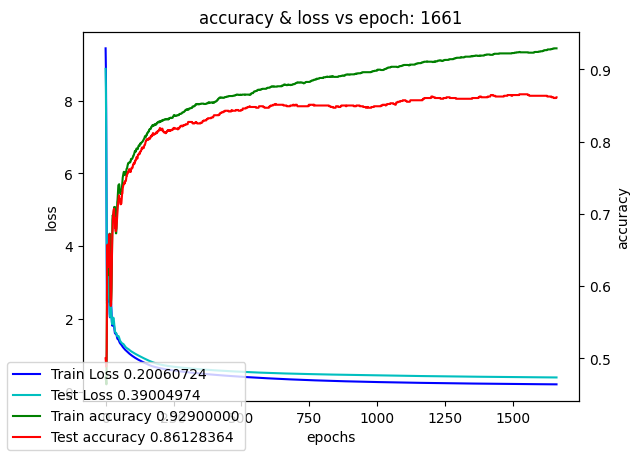

Training model color_cnn_single_kernel:  17%|█▋        | 1670/10000 [1:57:43<9:40:40,  4.18s/it]

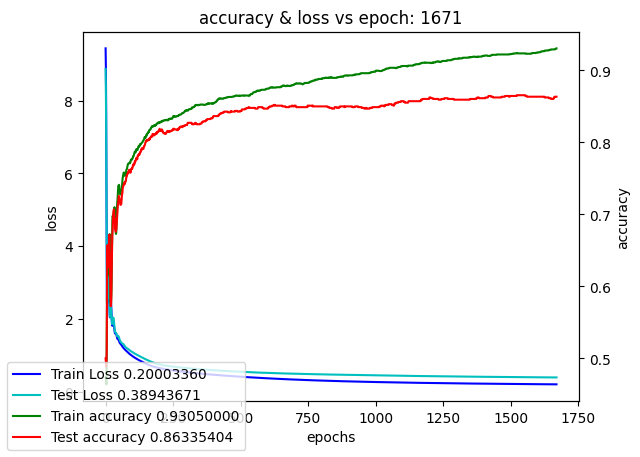

Training model color_cnn_single_kernel:  17%|█▋        | 1680/10000 [1:58:25<9:45:13,  4.22s/it]

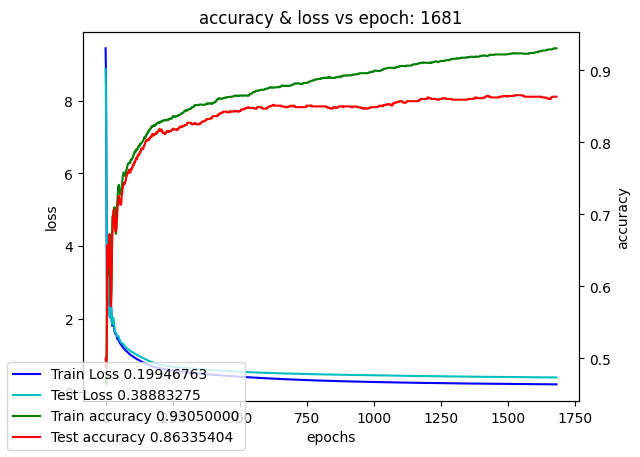

Training model color_cnn_single_kernel:  17%|█▋        | 1690/10000 [1:59:08<9:39:23,  4.18s/it]

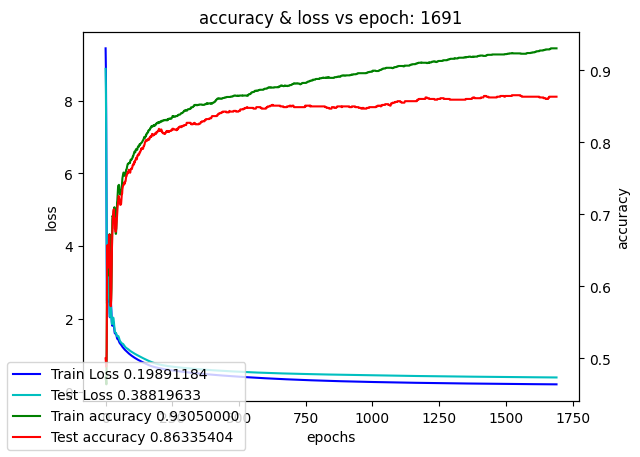

Training model color_cnn_single_kernel:  17%|█▋        | 1700/10000 [1:59:50<9:47:06,  4.24s/it]

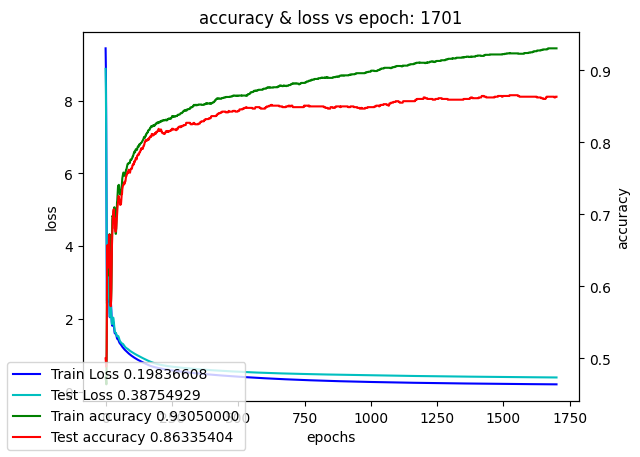

Training model color_cnn_single_kernel:  17%|█▋        | 1710/10000 [2:00:33<9:41:12,  4.21s/it]

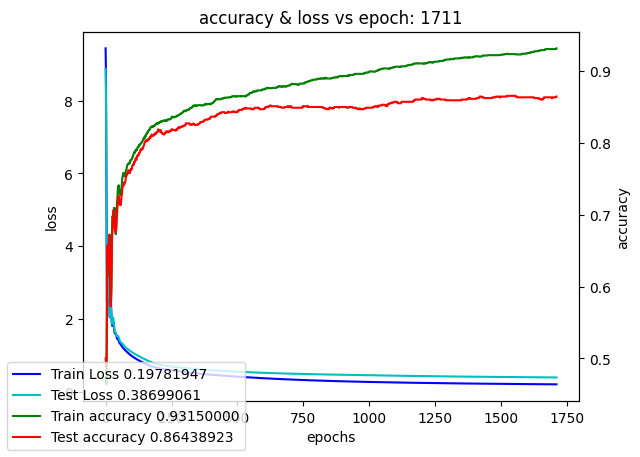

Training model color_cnn_single_kernel:  17%|█▋        | 1720/10000 [2:01:15<9:37:35,  4.19s/it]

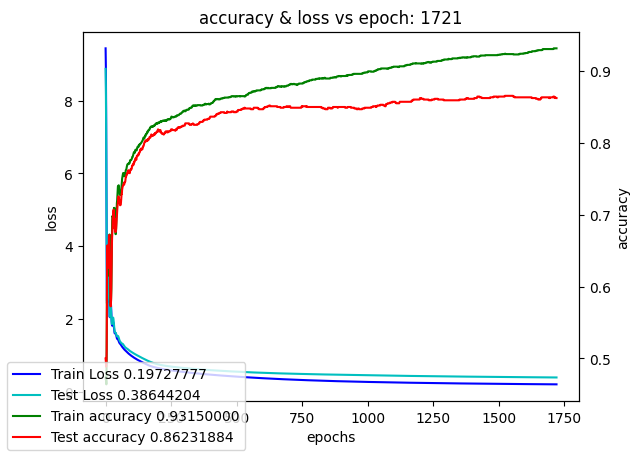

Training model color_cnn_single_kernel:  17%|█▋        | 1730/10000 [2:01:57<9:38:35,  4.20s/it]

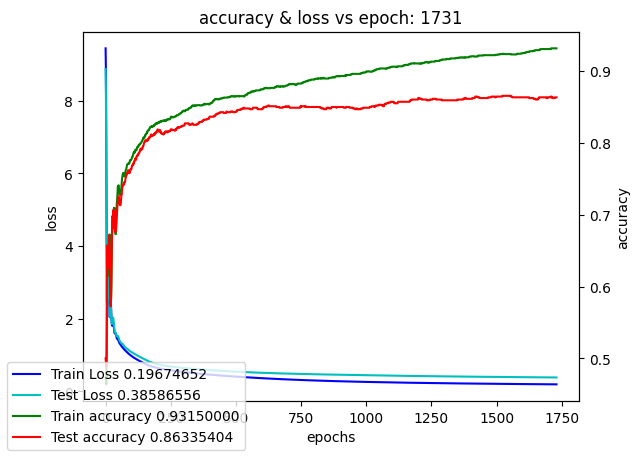

Training model color_cnn_single_kernel:  17%|█▋        | 1740/10000 [2:02:39<9:38:30,  4.20s/it]

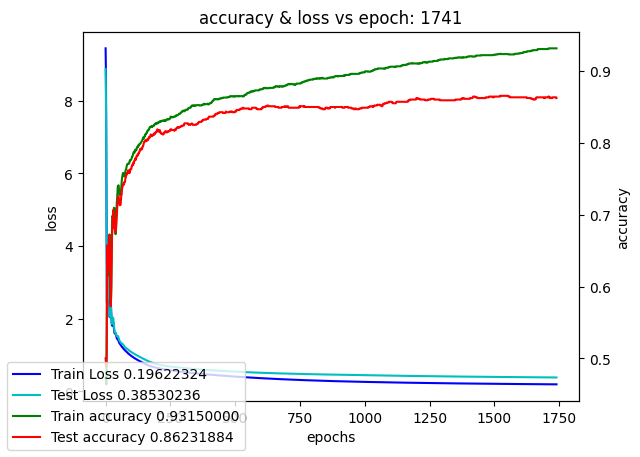

Training model color_cnn_single_kernel:  18%|█▊        | 1750/10000 [2:03:21<9:36:31,  4.19s/it]

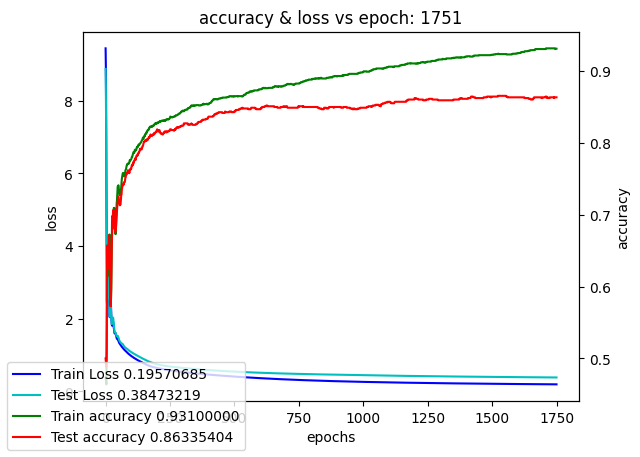

Training model color_cnn_single_kernel:  18%|█▊        | 1760/10000 [2:04:04<9:41:09,  4.23s/it]

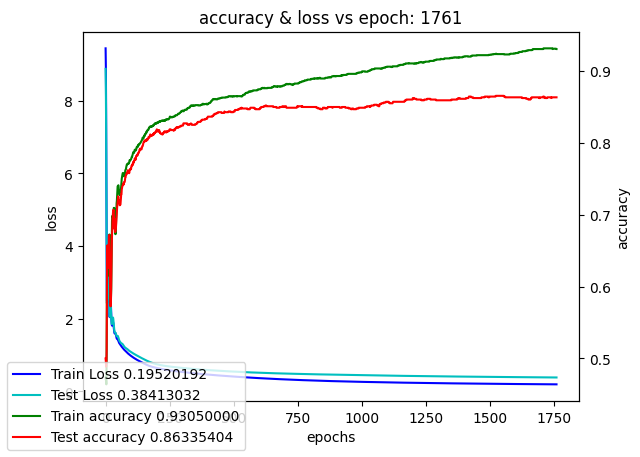

Training model color_cnn_single_kernel:  18%|█▊        | 1770/10000 [2:04:46<9:41:58,  4.24s/it]

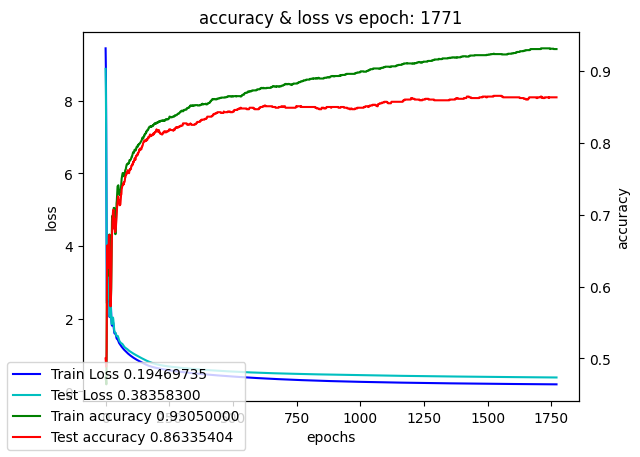

Training model color_cnn_single_kernel:  18%|█▊        | 1780/10000 [2:05:29<9:38:58,  4.23s/it]

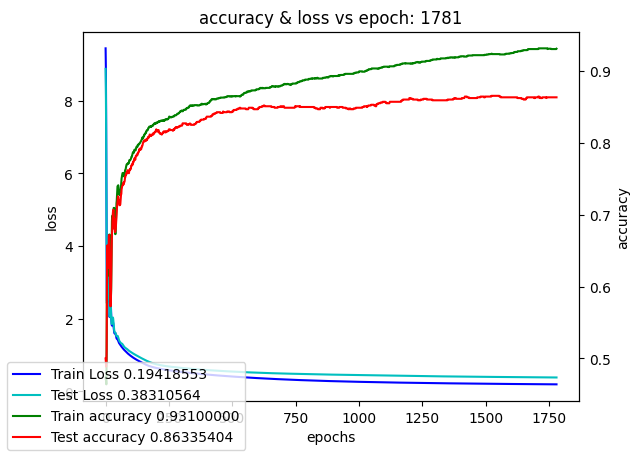

Training model color_cnn_single_kernel:  18%|█▊        | 1790/10000 [2:06:11<9:39:26,  4.23s/it]

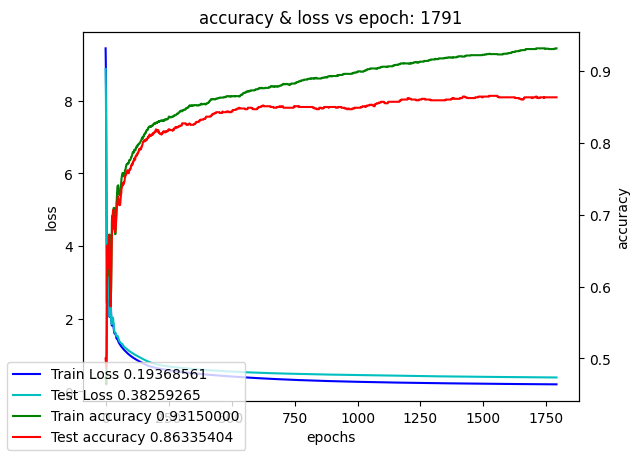

Training model color_cnn_single_kernel:  18%|█▊        | 1800/10000 [2:06:54<9:41:02,  4.25s/it]

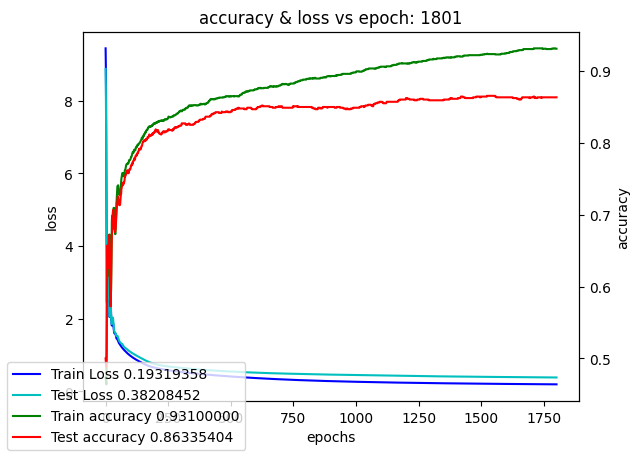

Training model color_cnn_single_kernel:  18%|█▊        | 1810/10000 [2:07:37<9:42:00,  4.26s/it]

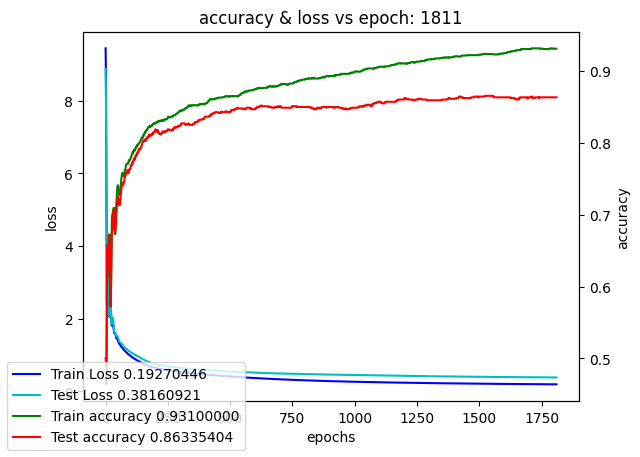

Training model color_cnn_single_kernel:  18%|█▊        | 1820/10000 [2:08:20<9:38:23,  4.24s/it]

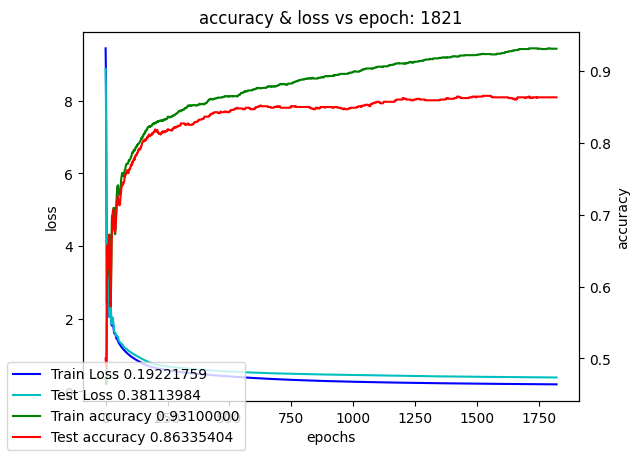

Training model color_cnn_single_kernel:  18%|█▊        | 1830/10000 [2:09:02<9:41:39,  4.27s/it]

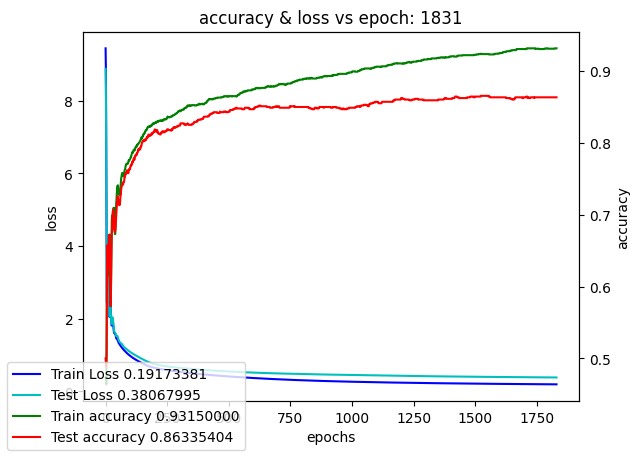

Training model color_cnn_single_kernel:  18%|█▊        | 1840/10000 [2:09:45<9:34:26,  4.22s/it]

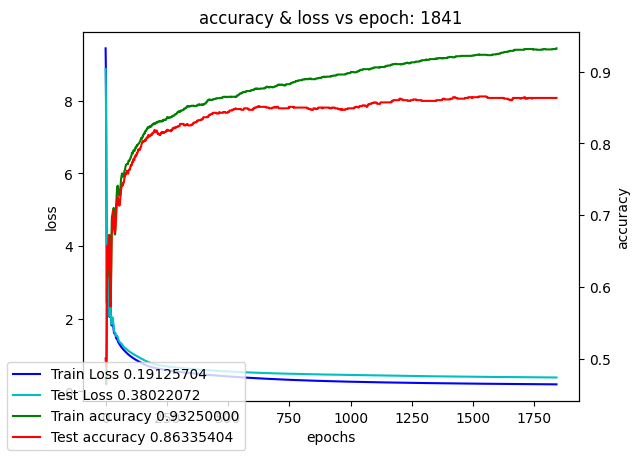

Training model color_cnn_single_kernel:  18%|█▊        | 1850/10000 [2:10:27<9:29:17,  4.19s/it]

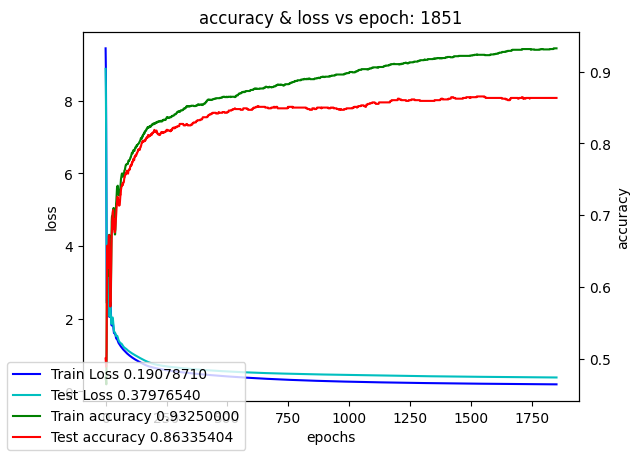

Training model color_cnn_single_kernel:  19%|█▊        | 1860/10000 [2:11:09<9:29:38,  4.20s/it]

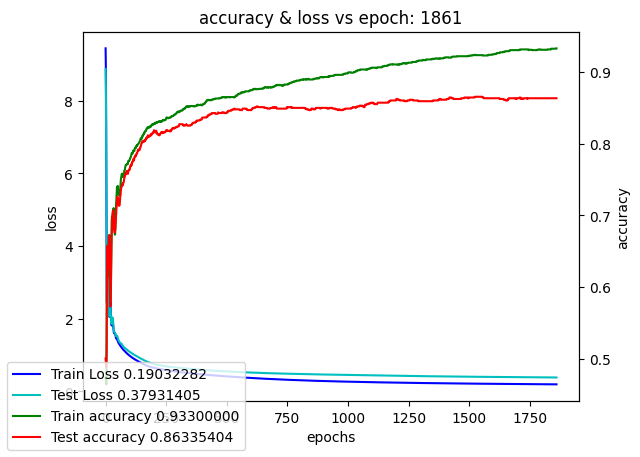

Training model color_cnn_single_kernel:  19%|█▊        | 1870/10000 [2:11:52<9:26:21,  4.18s/it]

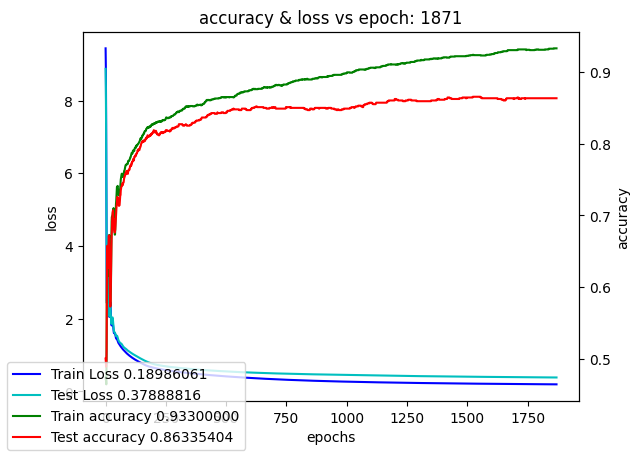

Training model color_cnn_single_kernel:  19%|█▉        | 1880/10000 [2:12:34<9:26:50,  4.19s/it]

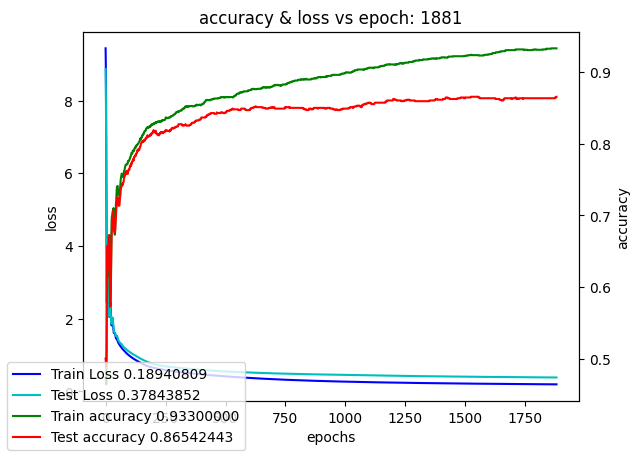

Training model color_cnn_single_kernel:  19%|█▉        | 1890/10000 [2:13:16<9:27:32,  4.20s/it]

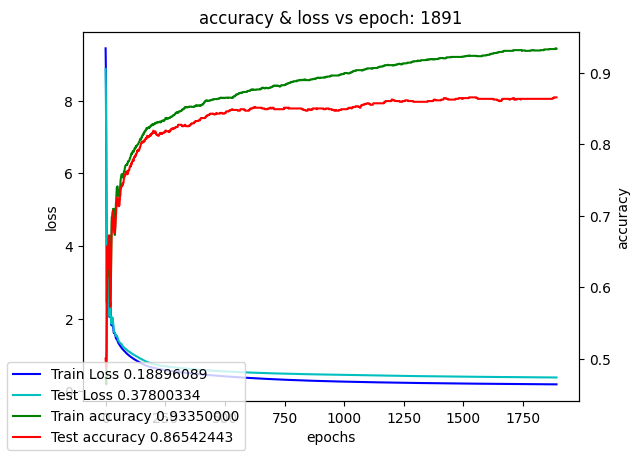

Training model color_cnn_single_kernel:  19%|█▉        | 1900/10000 [2:13:58<9:25:56,  4.19s/it]

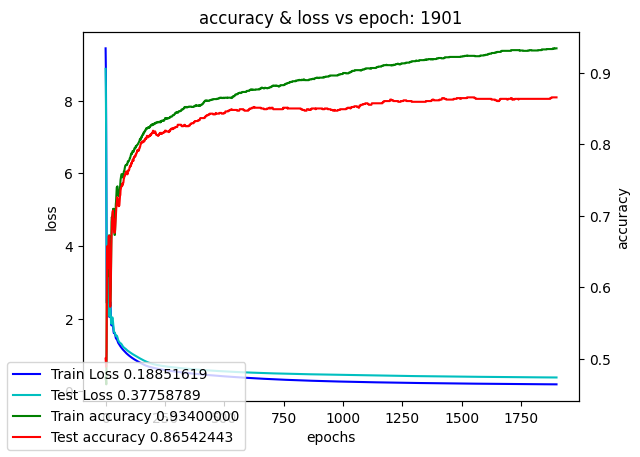

Training model color_cnn_single_kernel:  19%|█▉        | 1910/10000 [2:14:40<9:25:53,  4.20s/it]

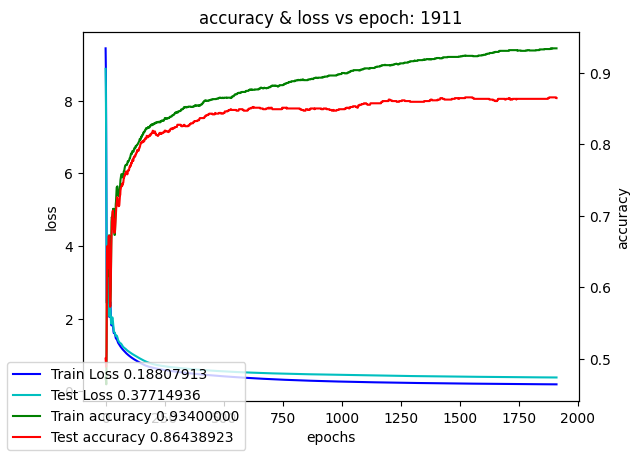

Training model color_cnn_single_kernel:  19%|█▉        | 1920/10000 [2:15:22<9:24:16,  4.19s/it]

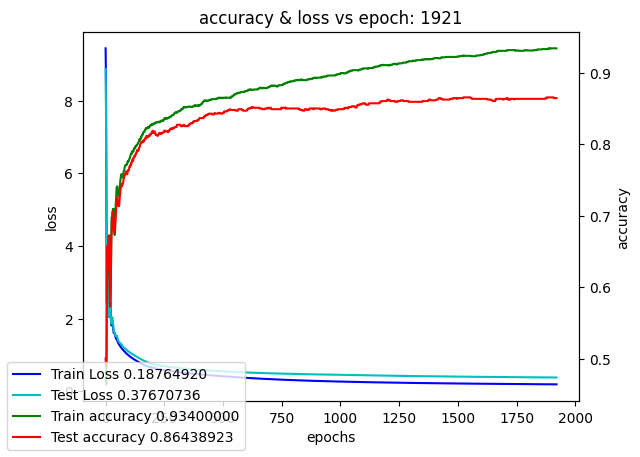

Training model color_cnn_single_kernel:  19%|█▉        | 1930/10000 [2:16:04<9:23:56,  4.19s/it]

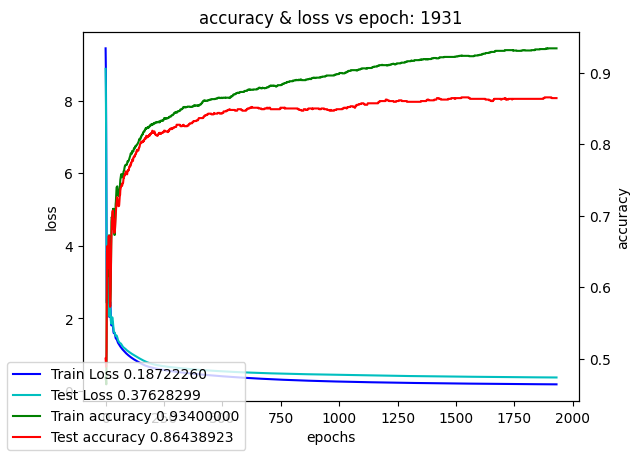

Training model color_cnn_single_kernel:  19%|█▉        | 1940/10000 [2:16:46<9:22:17,  4.19s/it]

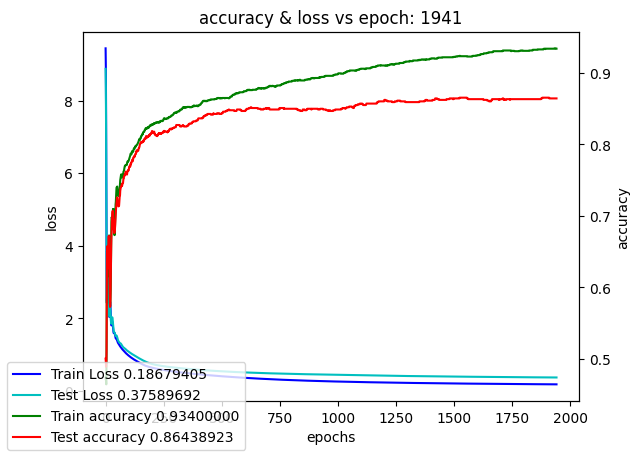

Training model color_cnn_single_kernel:  20%|█▉        | 1950/10000 [2:17:28<9:23:00,  4.20s/it]

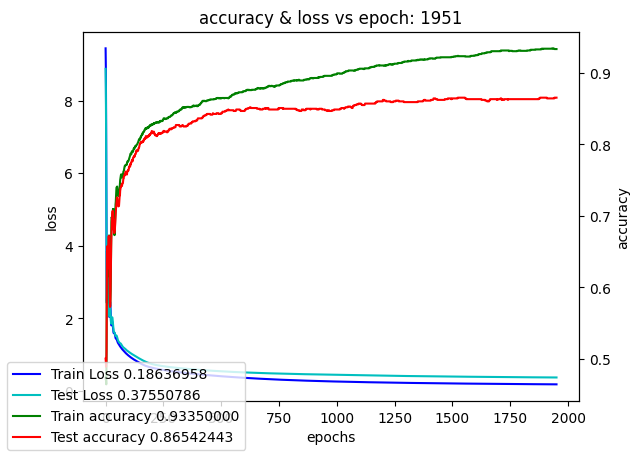

Training model color_cnn_single_kernel:  20%|█▉        | 1960/10000 [2:18:11<9:24:48,  4.22s/it]

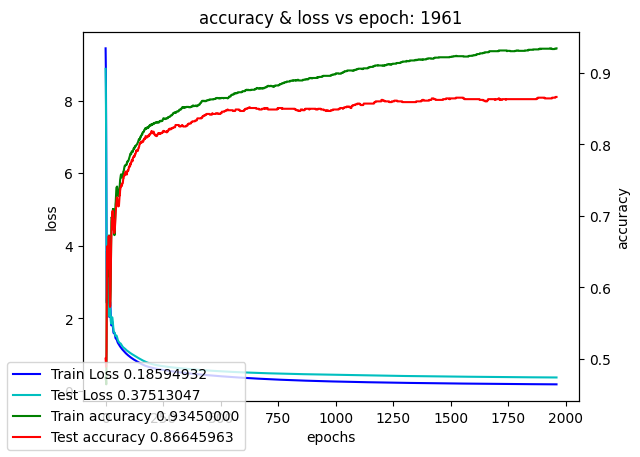

Training model color_cnn_single_kernel:  20%|█▉        | 1970/10000 [2:18:53<9:25:48,  4.23s/it]

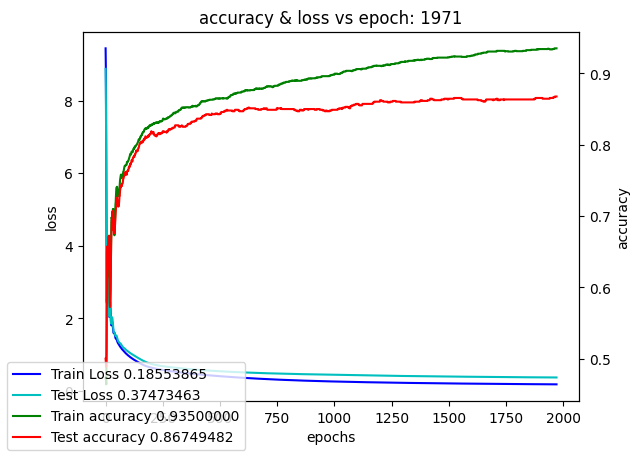

Training model color_cnn_single_kernel:  20%|█▉        | 1980/10000 [2:19:36<9:23:20,  4.21s/it]

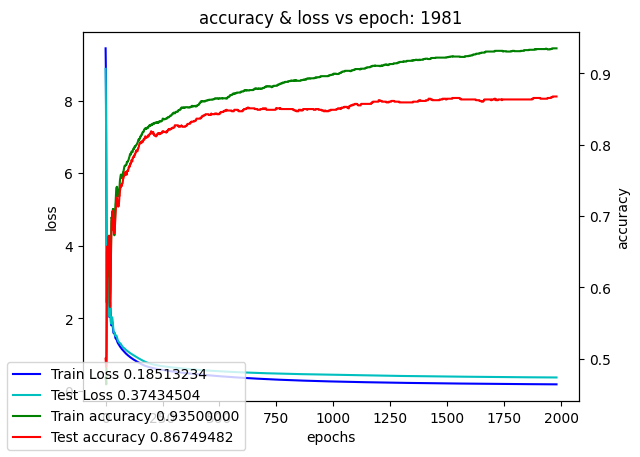

Training model color_cnn_single_kernel:  20%|█▉        | 1990/10000 [2:20:18<9:23:48,  4.22s/it]

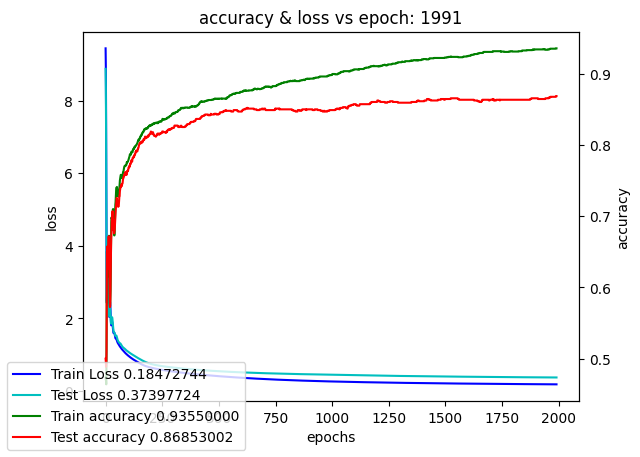

Training model color_cnn_single_kernel:  20%|██        | 2000/10000 [2:21:01<9:23:22,  4.23s/it]

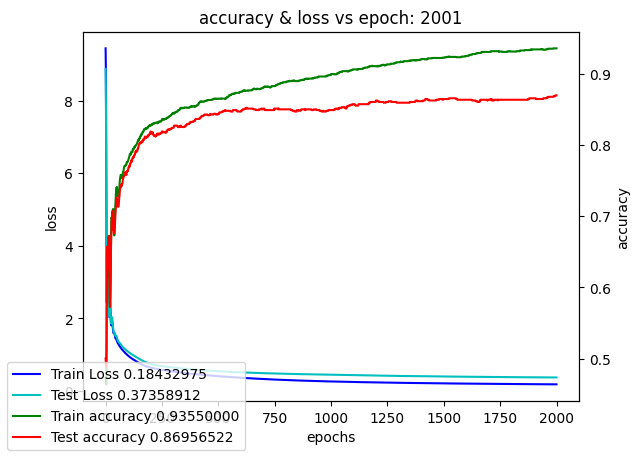

Training model color_cnn_single_kernel:  20%|██        | 2010/10000 [2:21:43<9:22:25,  4.22s/it]

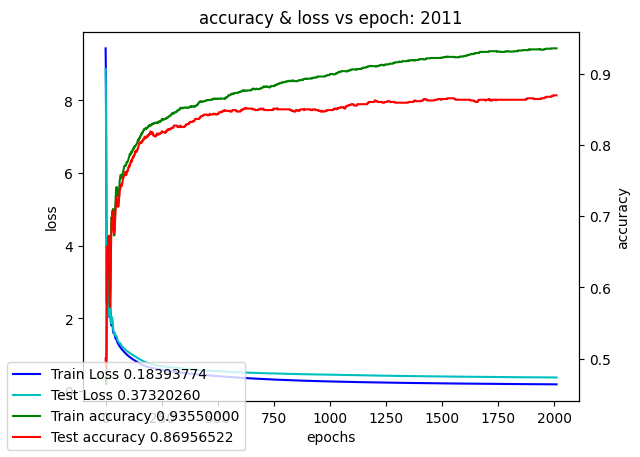

Training model color_cnn_single_kernel:  20%|██        | 2020/10000 [2:22:26<9:27:40,  4.27s/it]

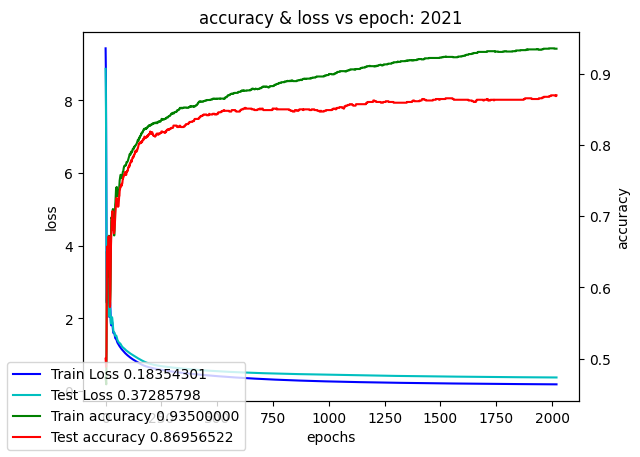

Training model color_cnn_single_kernel:  20%|██        | 2030/10000 [2:23:08<9:20:11,  4.22s/it]

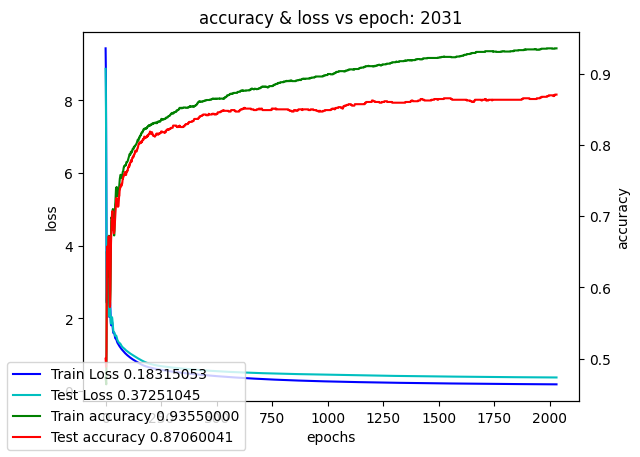

Training model color_cnn_single_kernel:  20%|██        | 2040/10000 [2:23:51<9:26:04,  4.27s/it]

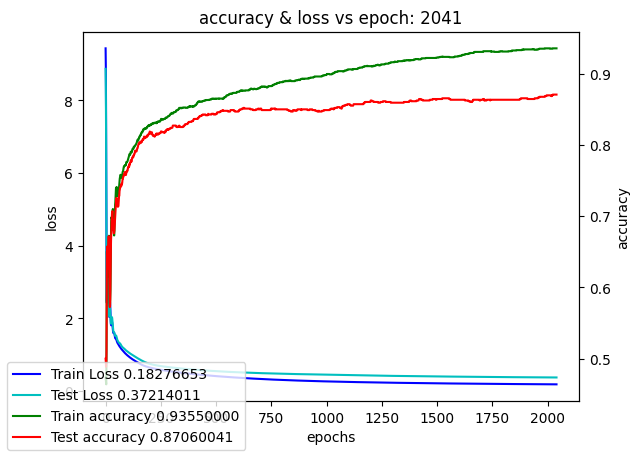

Training model color_cnn_single_kernel:  20%|██        | 2050/10000 [2:24:34<9:17:39,  4.21s/it]

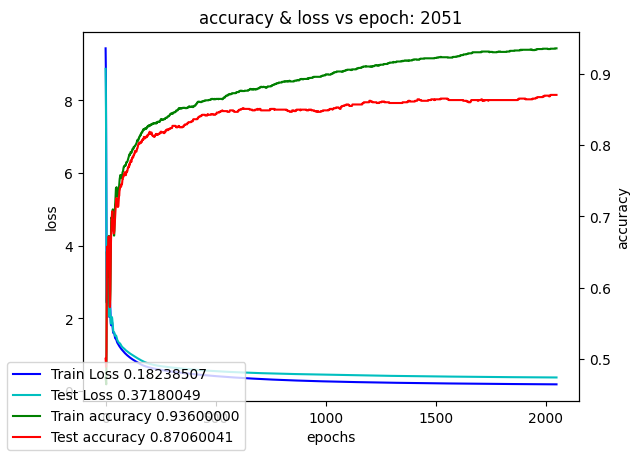

Training model color_cnn_single_kernel:  21%|██        | 2060/10000 [2:25:16<9:13:03,  4.18s/it]

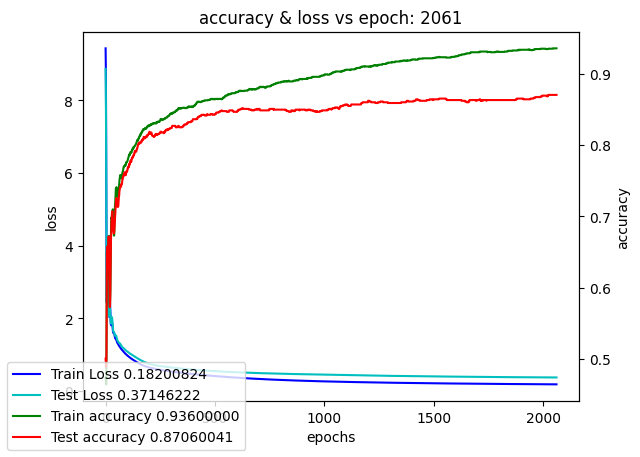

Training model color_cnn_single_kernel:  21%|██        | 2070/10000 [2:25:58<9:14:27,  4.20s/it]

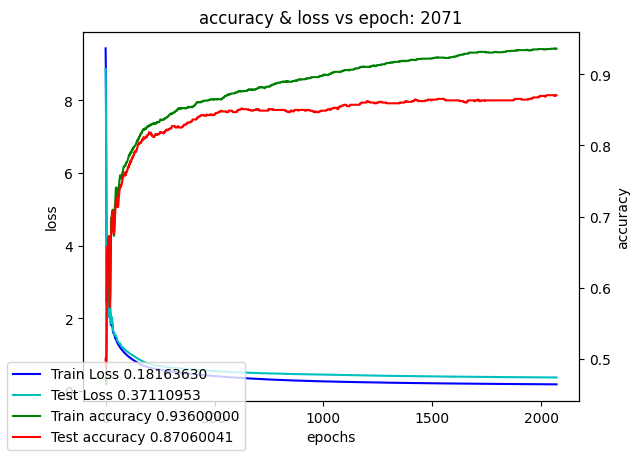

Training model color_cnn_single_kernel:  21%|██        | 2080/10000 [2:26:40<9:12:54,  4.19s/it]

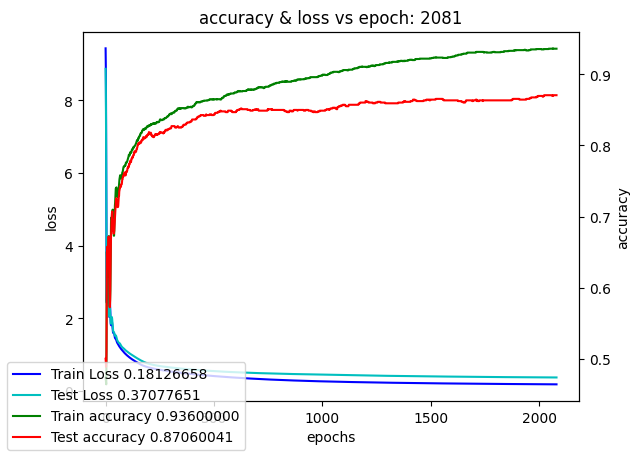

Training model color_cnn_single_kernel:  21%|██        | 2090/10000 [2:27:22<9:12:39,  4.19s/it]

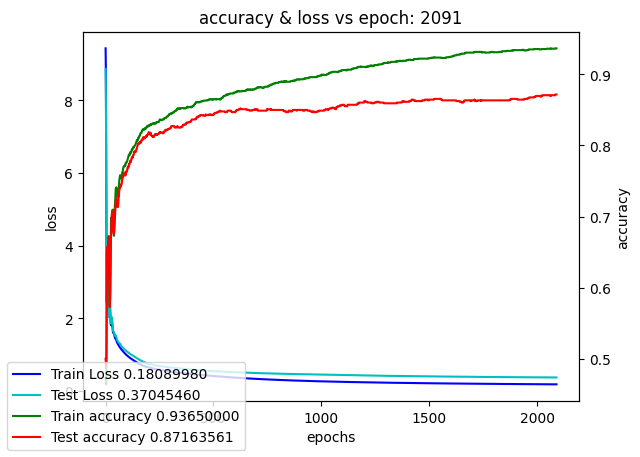

Training model color_cnn_single_kernel:  21%|██        | 2100/10000 [2:28:04<9:15:04,  4.22s/it]

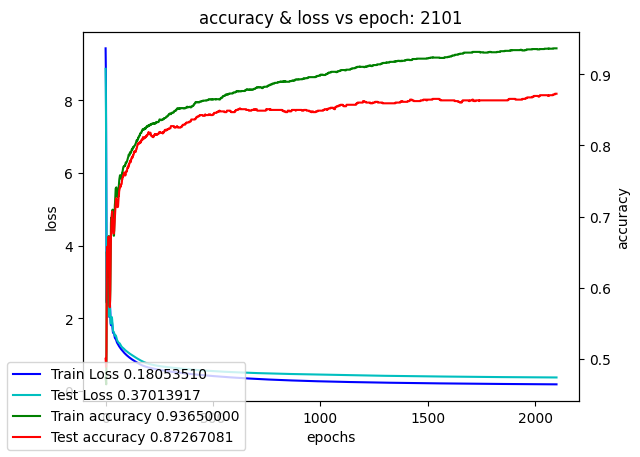

Training model color_cnn_single_kernel:  21%|██        | 2110/10000 [2:28:46<9:11:26,  4.19s/it]

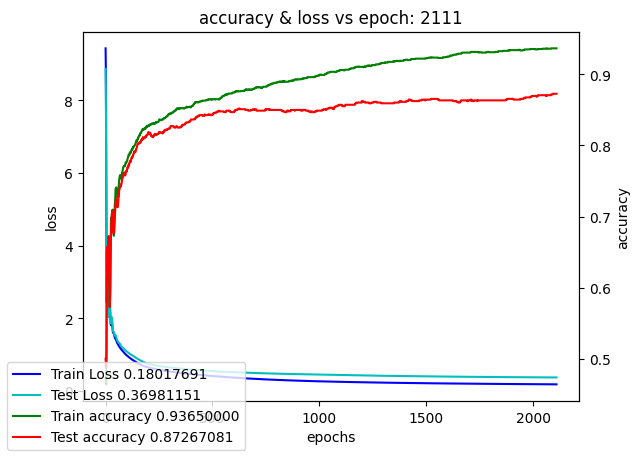

Training model color_cnn_single_kernel:  21%|██        | 2120/10000 [2:29:28<9:08:15,  4.17s/it]

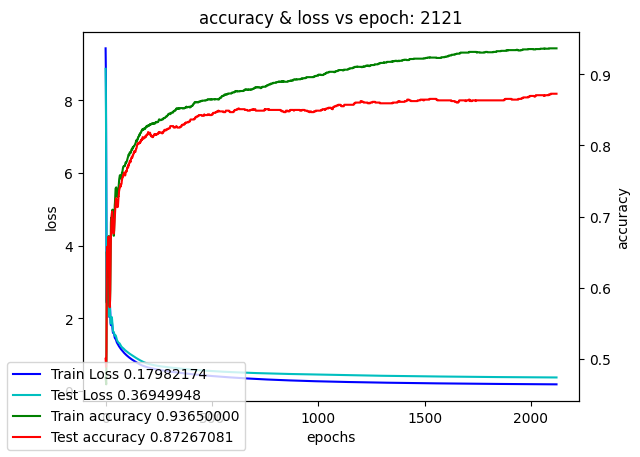

Training model color_cnn_single_kernel:  21%|██▏       | 2130/10000 [2:30:11<9:16:26,  4.24s/it]

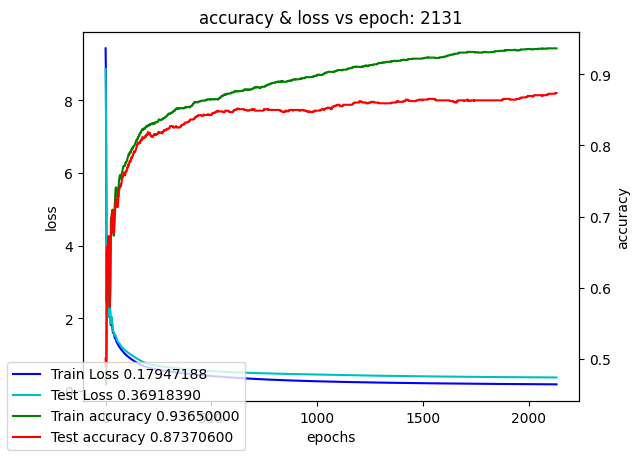

Training model color_cnn_single_kernel:  21%|██▏       | 2140/10000 [2:30:54<9:19:32,  4.27s/it]

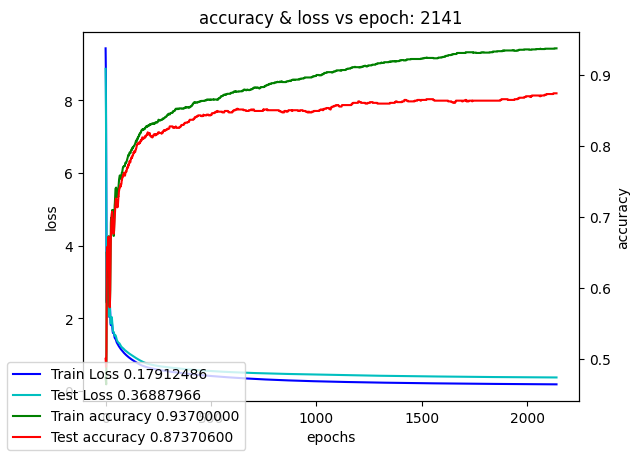

Training model color_cnn_single_kernel:  22%|██▏       | 2150/10000 [2:31:37<9:20:48,  4.29s/it]

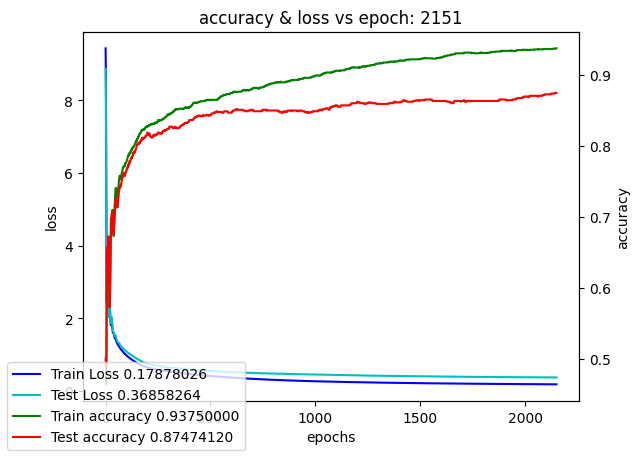

Training model color_cnn_single_kernel:  22%|██▏       | 2160/10000 [2:32:19<9:12:00,  4.22s/it]

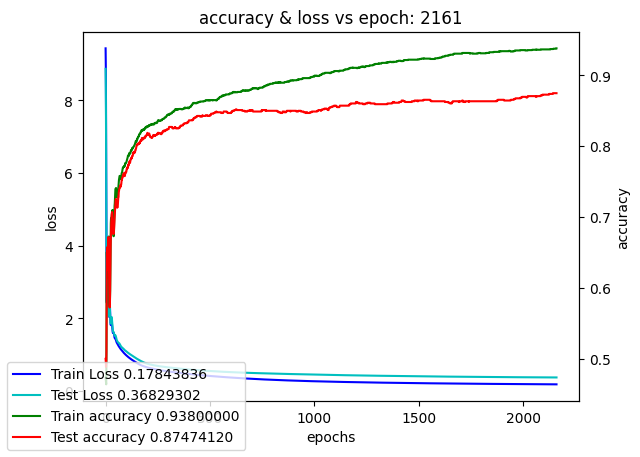

Training model color_cnn_single_kernel:  22%|██▏       | 2170/10000 [2:33:02<9:14:37,  4.25s/it]

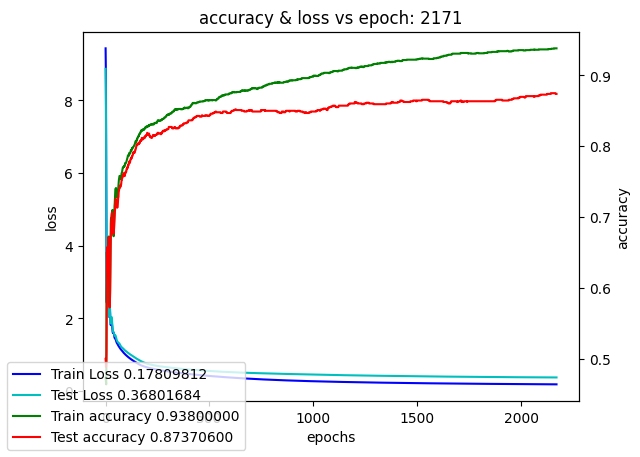

Training model color_cnn_single_kernel:  22%|██▏       | 2180/10000 [2:33:45<9:13:21,  4.25s/it]

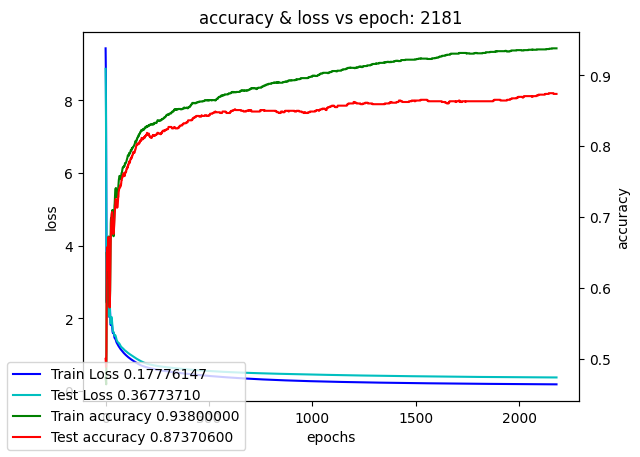

Training model color_cnn_single_kernel:  22%|██▏       | 2190/10000 [2:34:27<9:08:50,  4.22s/it]

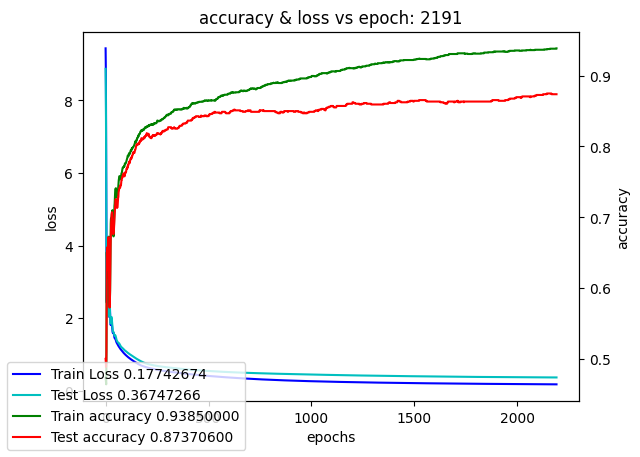

Training model color_cnn_single_kernel:  22%|██▏       | 2200/10000 [2:35:10<9:10:30,  4.23s/it]

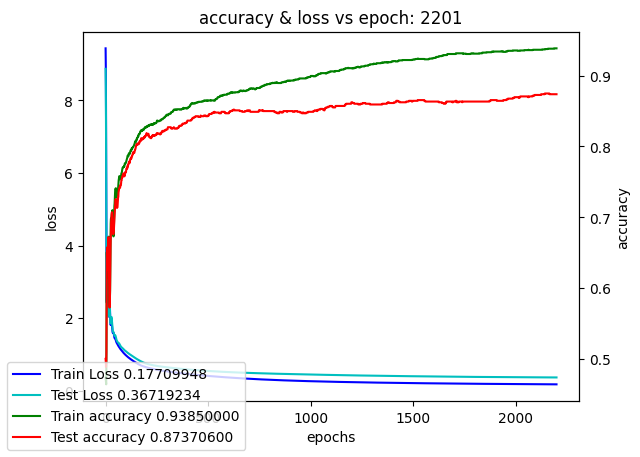

Training model color_cnn_single_kernel:  22%|██▏       | 2210/10000 [2:35:52<9:12:06,  4.25s/it]

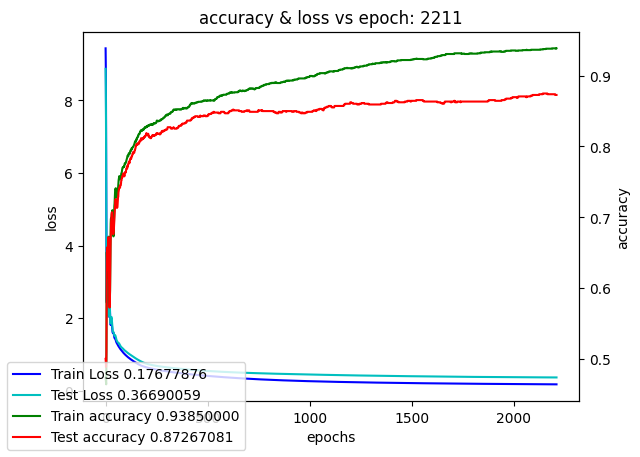

Training model color_cnn_single_kernel:  22%|██▏       | 2220/10000 [2:36:35<9:07:17,  4.22s/it]

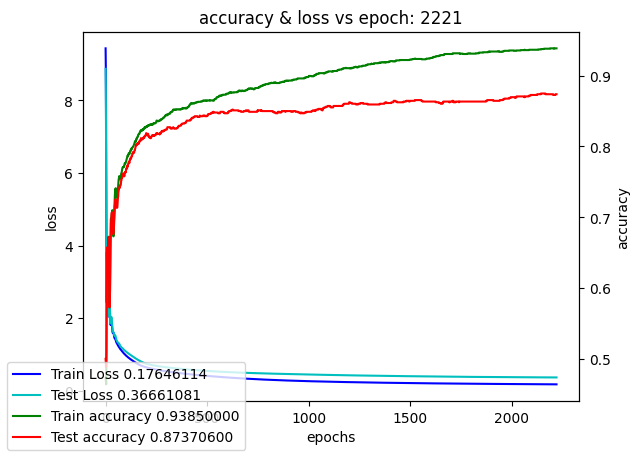

Training model color_cnn_single_kernel:  22%|██▏       | 2230/10000 [2:37:17<9:06:24,  4.22s/it]

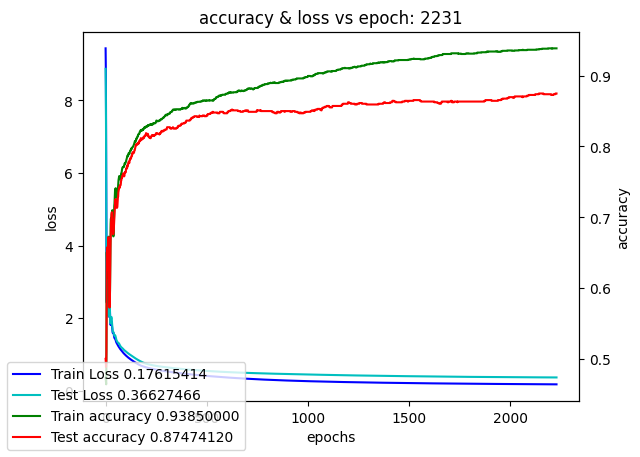

Training model color_cnn_single_kernel:  22%|██▏       | 2240/10000 [2:38:00<9:07:57,  4.24s/it]

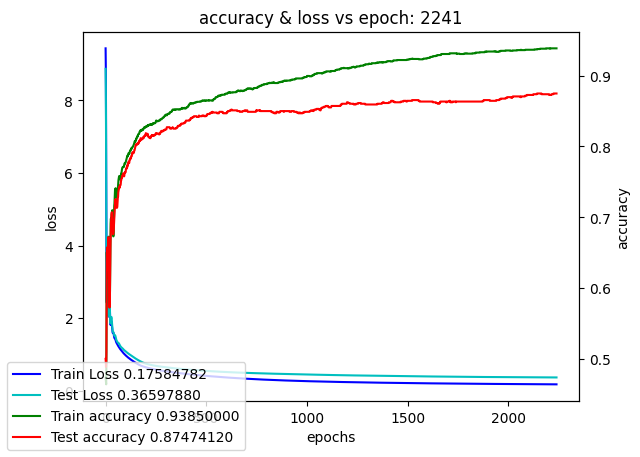

Training model color_cnn_single_kernel:  22%|██▎       | 2250/10000 [2:38:42<9:03:58,  4.21s/it]

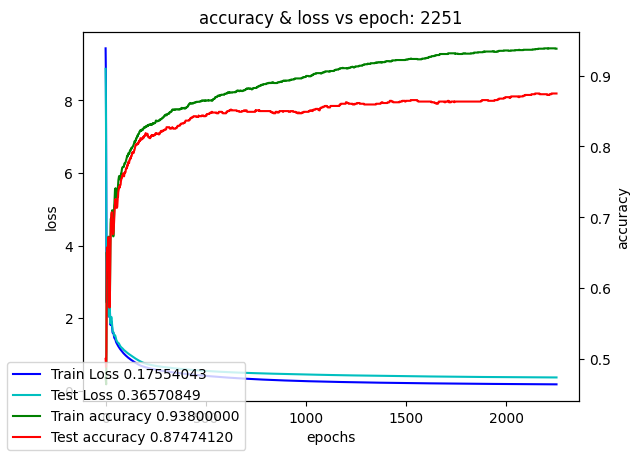

Training model color_cnn_single_kernel:  23%|██▎       | 2260/10000 [2:39:24<8:59:06,  4.18s/it]

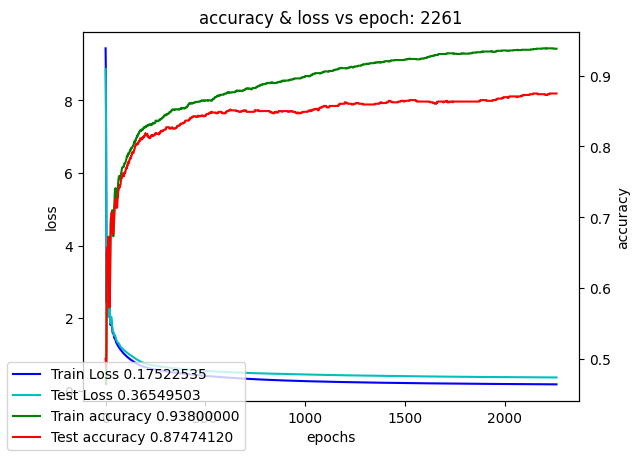

Training model color_cnn_single_kernel:  23%|██▎       | 2270/10000 [2:40:06<9:00:12,  4.19s/it]

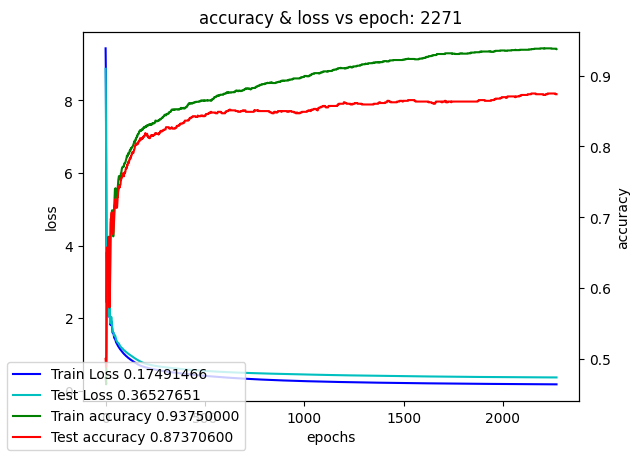

Training model color_cnn_single_kernel:  23%|██▎       | 2280/10000 [2:40:48<8:59:07,  4.19s/it]

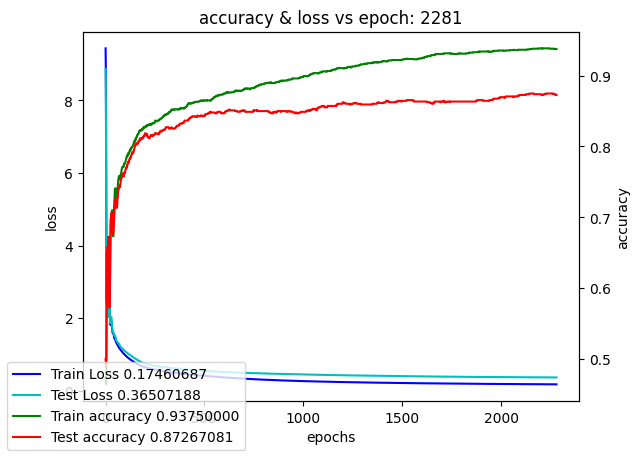

Training model color_cnn_single_kernel:  23%|██▎       | 2290/10000 [2:41:30<9:00:01,  4.20s/it]

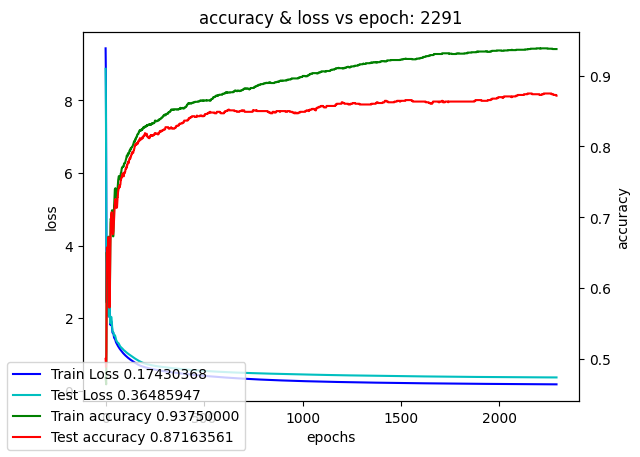

Training model color_cnn_single_kernel:  23%|██▎       | 2300/10000 [2:42:13<9:00:01,  4.21s/it]

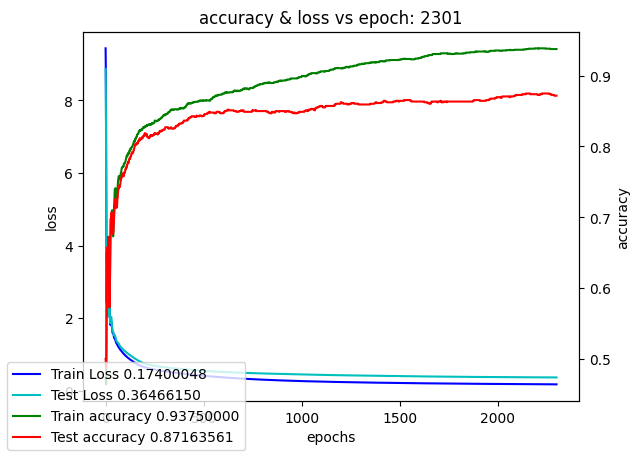

Training model color_cnn_single_kernel:  23%|██▎       | 2310/10000 [2:42:55<8:59:50,  4.21s/it]

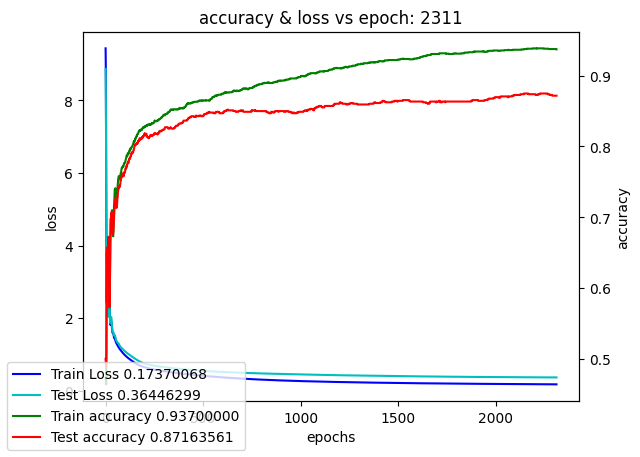

Training model color_cnn_single_kernel:  23%|██▎       | 2320/10000 [2:43:37<8:58:42,  4.21s/it]

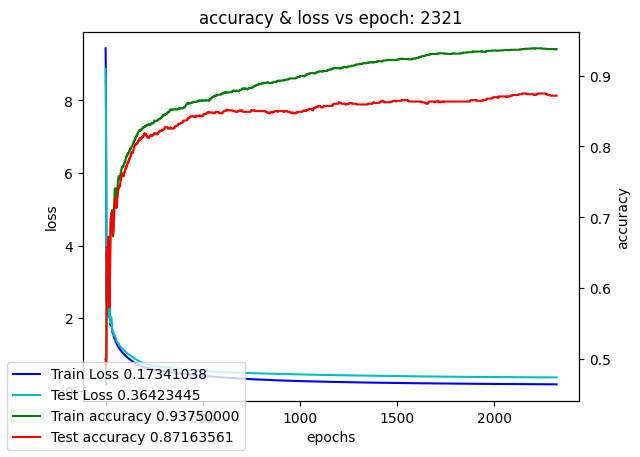

Training model color_cnn_single_kernel:  23%|██▎       | 2330/10000 [2:44:19<8:57:55,  4.21s/it]

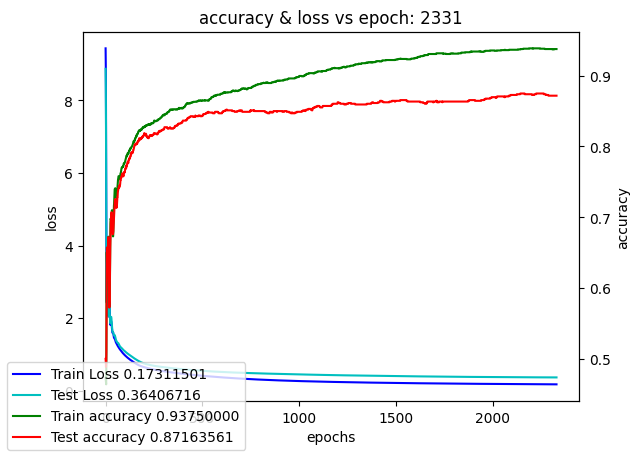

Training model color_cnn_single_kernel:  23%|██▎       | 2340/10000 [2:45:02<8:55:20,  4.19s/it]

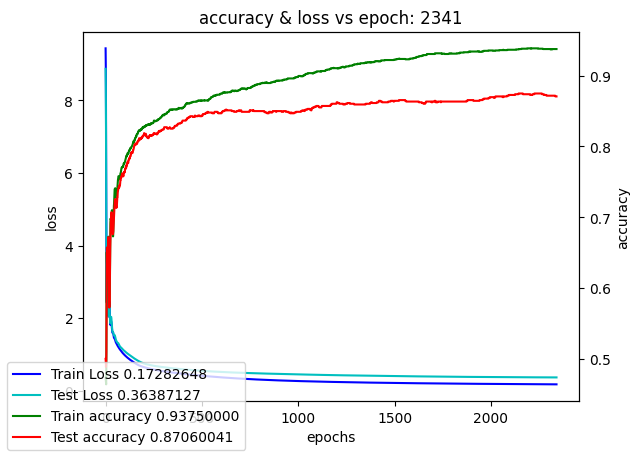

Training model color_cnn_single_kernel:  24%|██▎       | 2350/10000 [2:45:44<8:56:18,  4.21s/it]

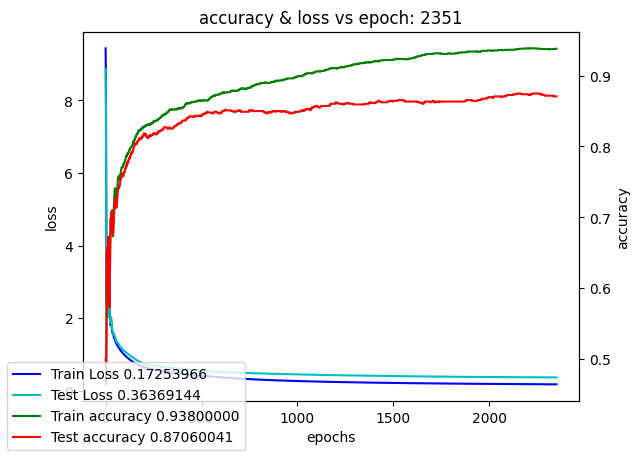

Training model color_cnn_single_kernel:  24%|██▎       | 2360/10000 [2:46:26<8:57:23,  4.22s/it]

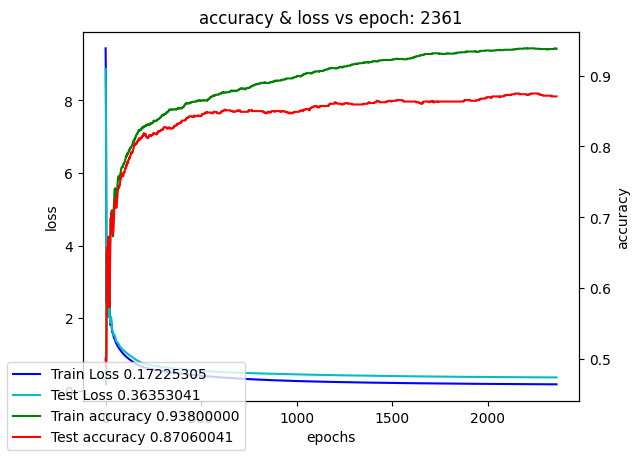

Training model color_cnn_single_kernel:  24%|██▎       | 2370/10000 [2:47:09<8:59:42,  4.24s/it]

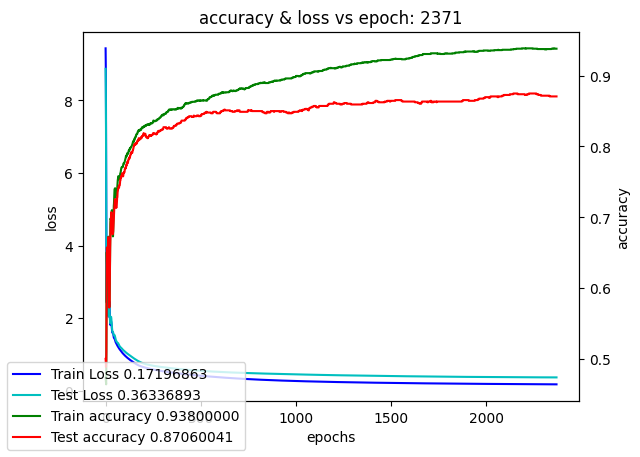

Training model color_cnn_single_kernel:  24%|██▍       | 2380/10000 [2:47:51<8:56:55,  4.23s/it]

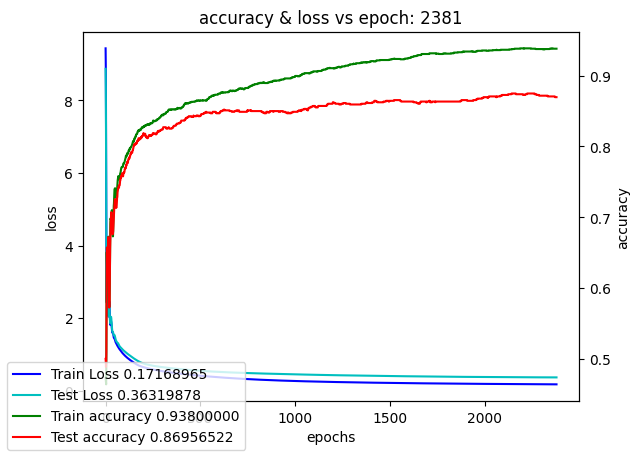

Training model color_cnn_single_kernel:  24%|██▍       | 2390/10000 [2:48:34<8:57:38,  4.24s/it]

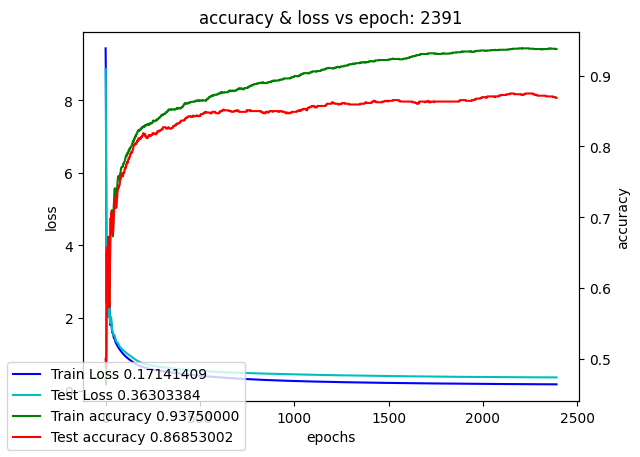

Training model color_cnn_single_kernel:  24%|██▍       | 2400/10000 [2:49:16<8:56:22,  4.23s/it]

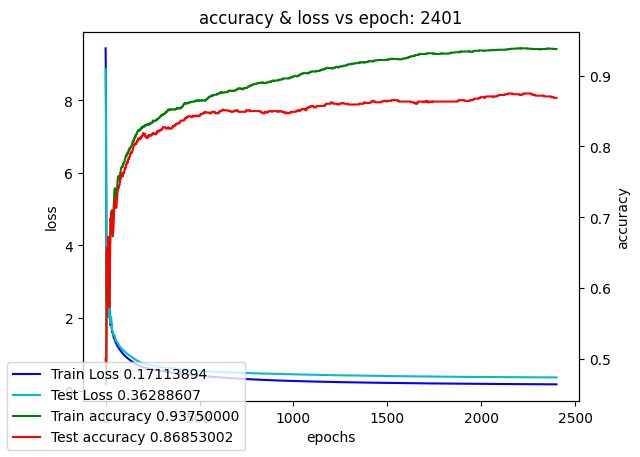

Training model color_cnn_single_kernel:  24%|██▍       | 2410/10000 [2:49:59<8:55:15,  4.23s/it]

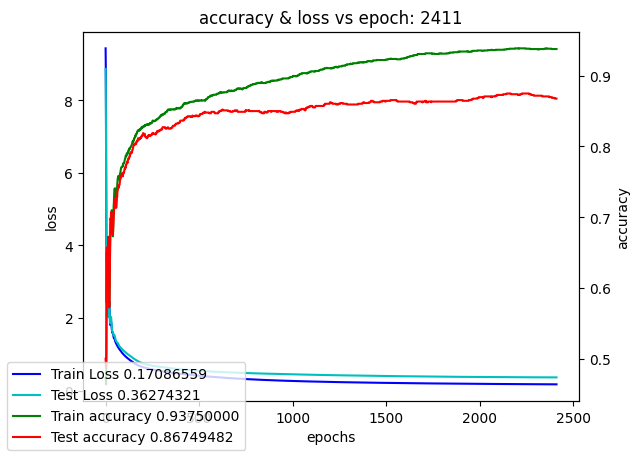

Training model color_cnn_single_kernel:  24%|██▍       | 2420/10000 [2:50:41<8:53:42,  4.22s/it]

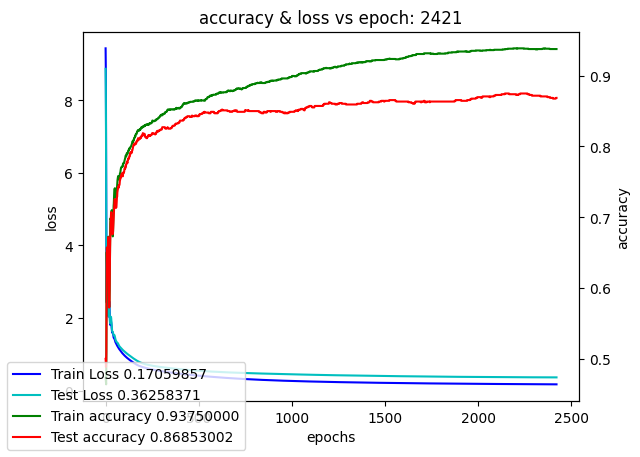

Training model color_cnn_single_kernel:  24%|██▍       | 2430/10000 [2:51:24<8:50:26,  4.20s/it]

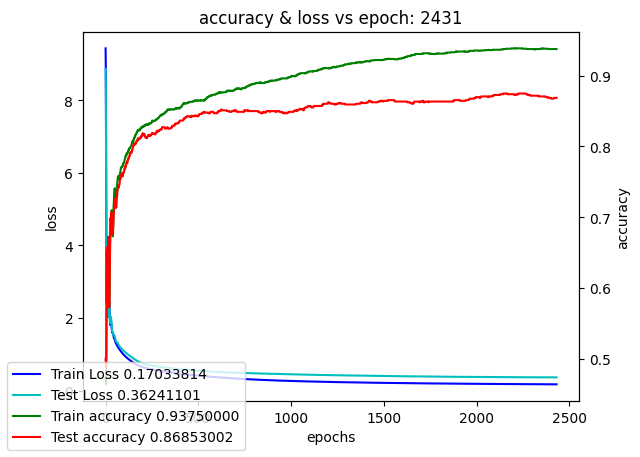

Training model color_cnn_single_kernel:  24%|██▍       | 2440/10000 [2:52:06<8:52:12,  4.22s/it]

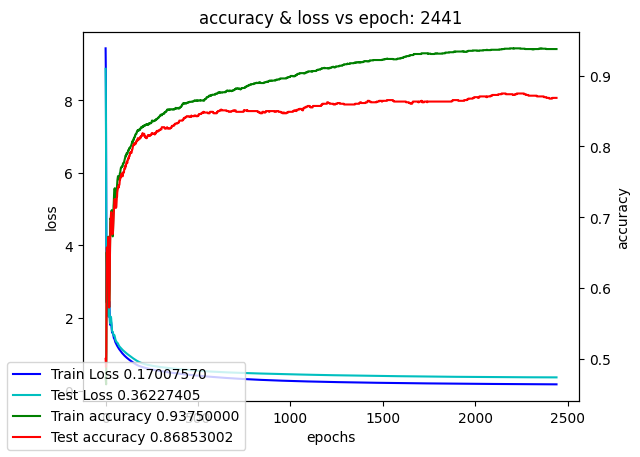

Training model color_cnn_single_kernel:  24%|██▍       | 2450/10000 [2:52:48<8:51:17,  4.22s/it]

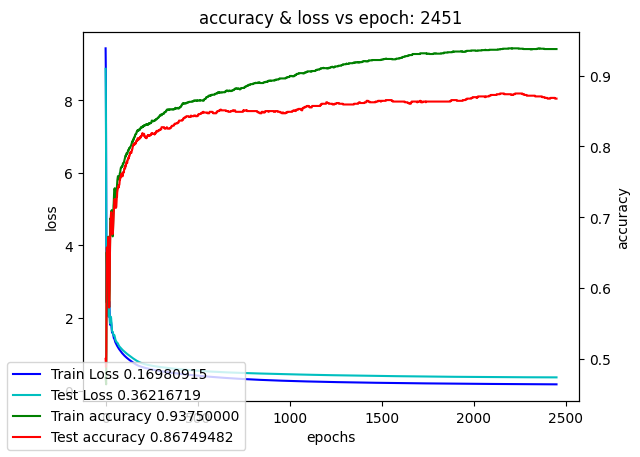

Training model color_cnn_single_kernel:  25%|██▍       | 2460/10000 [2:53:31<8:48:43,  4.21s/it]

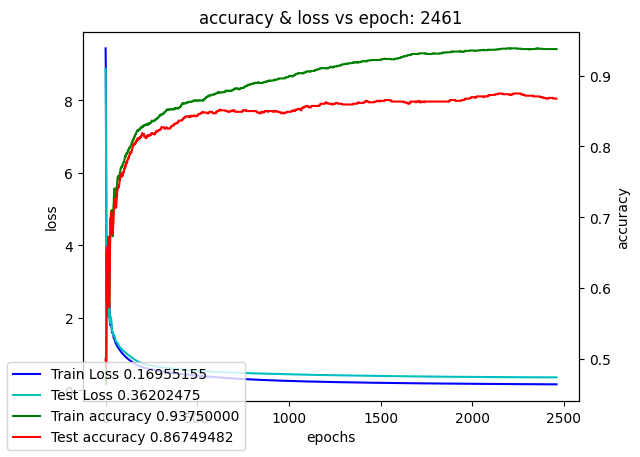

Training model color_cnn_single_kernel:  25%|██▍       | 2470/10000 [2:54:13<8:45:49,  4.19s/it]

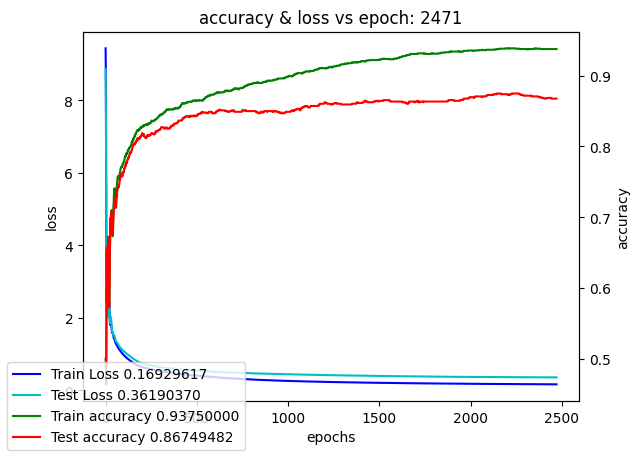

Training model color_cnn_single_kernel:  25%|██▍       | 2480/10000 [2:54:55<8:46:10,  4.20s/it]

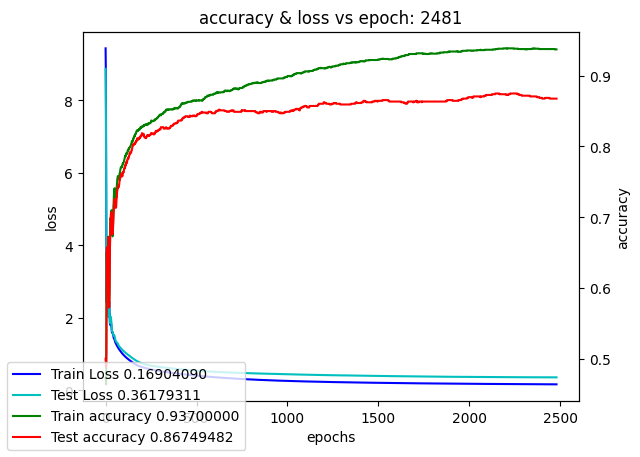

Training model color_cnn_single_kernel:  25%|██▍       | 2490/10000 [2:55:37<8:45:24,  4.20s/it]

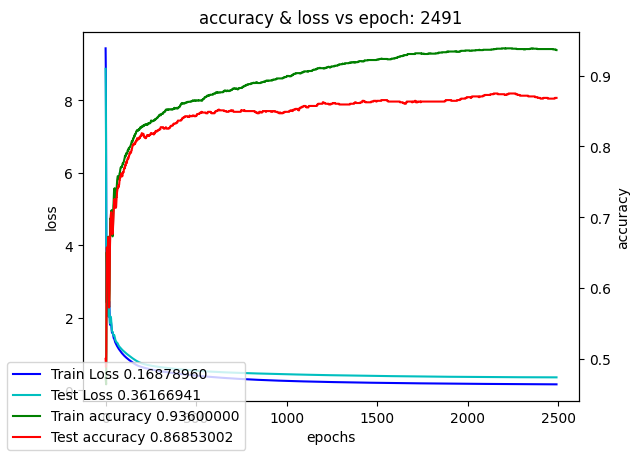

Training model color_cnn_single_kernel:  25%|██▌       | 2500/10000 [2:56:19<8:44:27,  4.20s/it]

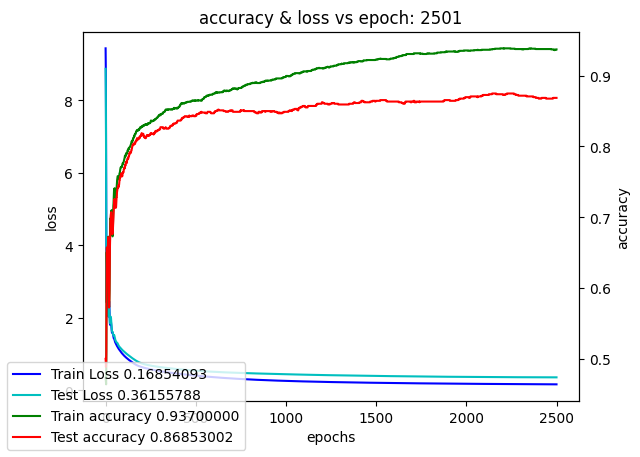

Training model color_cnn_single_kernel:  25%|██▌       | 2510/10000 [2:57:02<8:43:21,  4.19s/it]

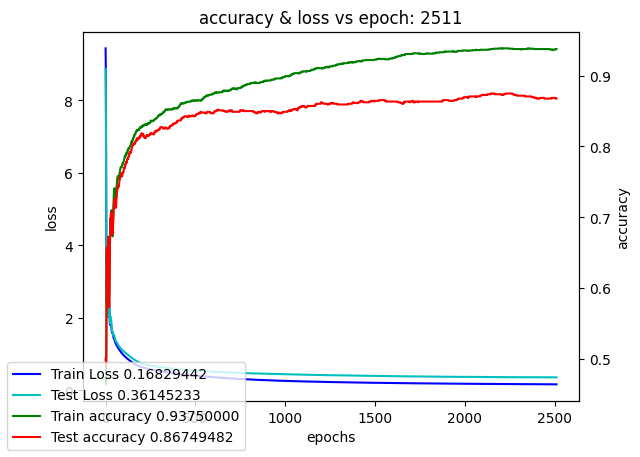

Training model color_cnn_single_kernel:  25%|██▌       | 2520/10000 [2:57:44<8:44:02,  4.20s/it]

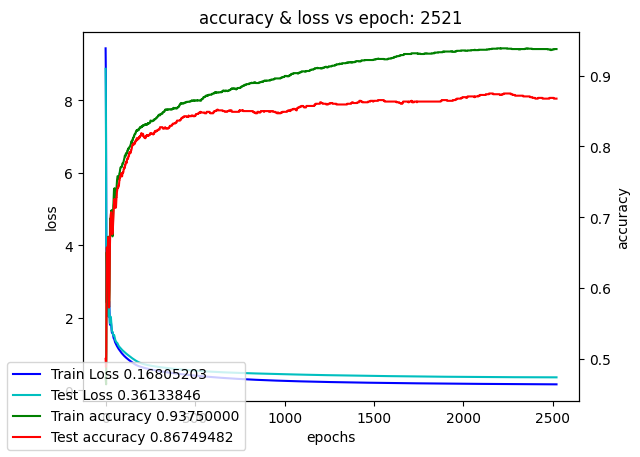

Training model color_cnn_single_kernel:  25%|██▌       | 2530/10000 [2:58:26<8:41:38,  4.19s/it]

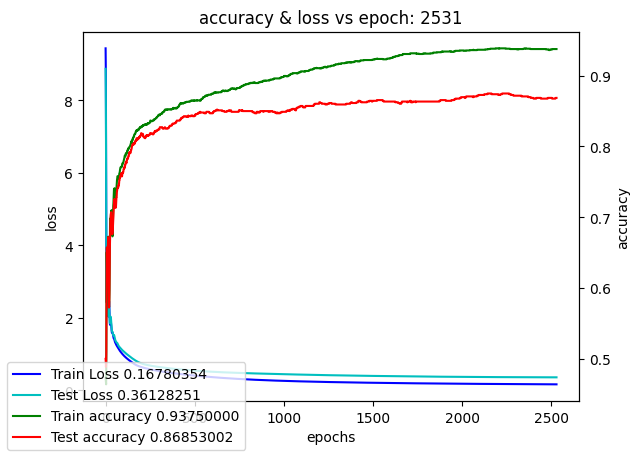

Training model color_cnn_single_kernel:  25%|██▌       | 2540/10000 [2:59:08<8:40:29,  4.19s/it]

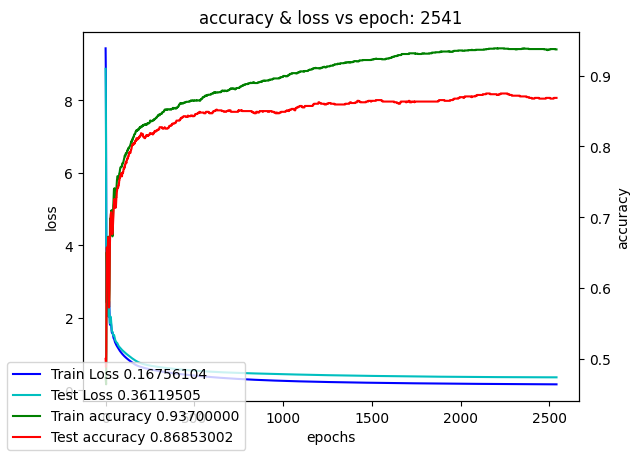

Training model color_cnn_single_kernel:  26%|██▌       | 2550/10000 [2:59:50<8:38:17,  4.17s/it]

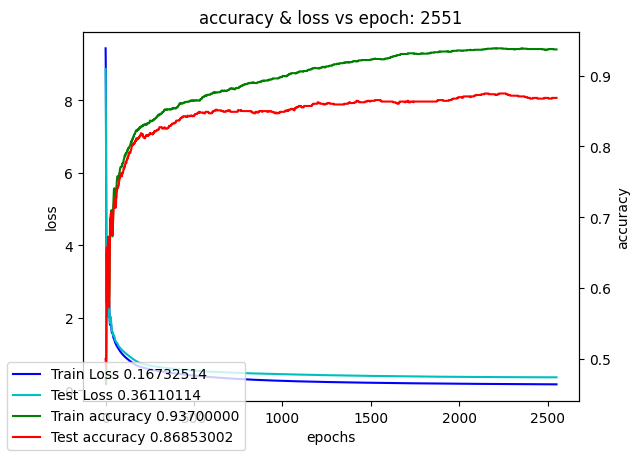

Training model color_cnn_single_kernel:  26%|██▌       | 2560/10000 [3:00:32<8:40:35,  4.20s/it]

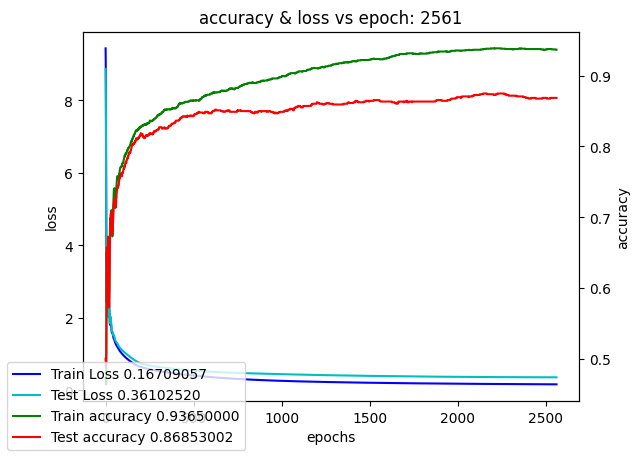

Training model color_cnn_single_kernel:  26%|██▌       | 2570/10000 [3:01:14<8:40:27,  4.20s/it]

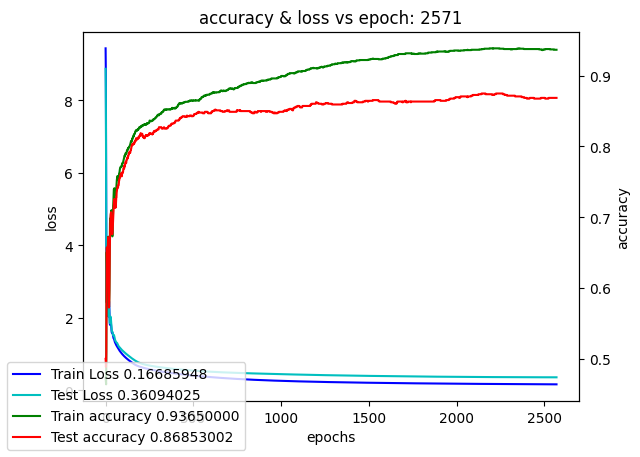

Training model color_cnn_single_kernel:  26%|██▌       | 2580/10000 [3:01:56<8:41:06,  4.21s/it]

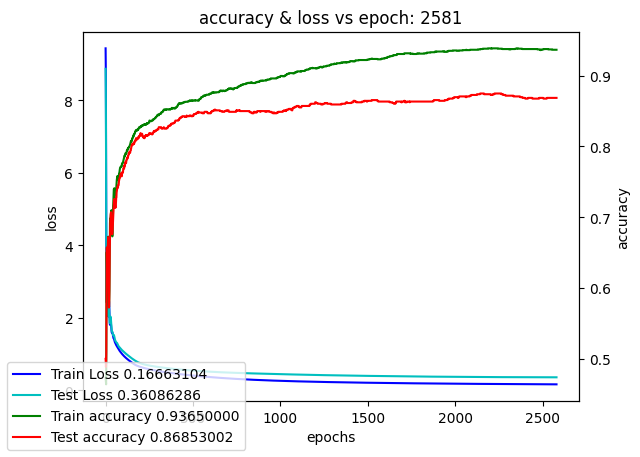

Training model color_cnn_single_kernel:  26%|██▌       | 2590/10000 [3:02:39<8:41:43,  4.22s/it]

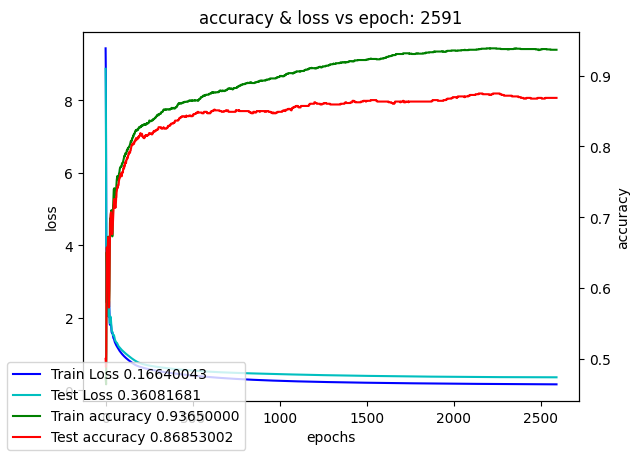

Training model color_cnn_single_kernel:  26%|██▌       | 2600/10000 [3:03:21<8:40:31,  4.22s/it]

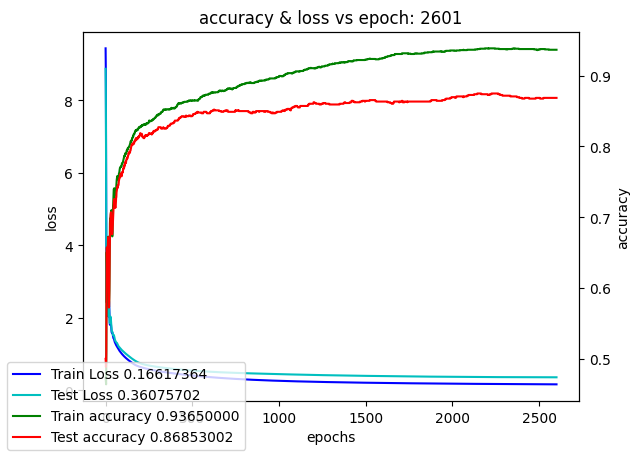

Training model color_cnn_single_kernel:  26%|██▌       | 2610/10000 [3:04:04<8:41:05,  4.23s/it]

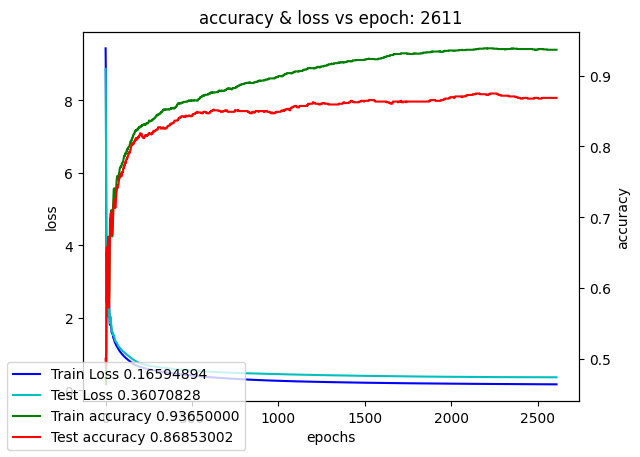

Training model color_cnn_single_kernel:  26%|██▌       | 2620/10000 [3:04:46<8:38:41,  4.22s/it]

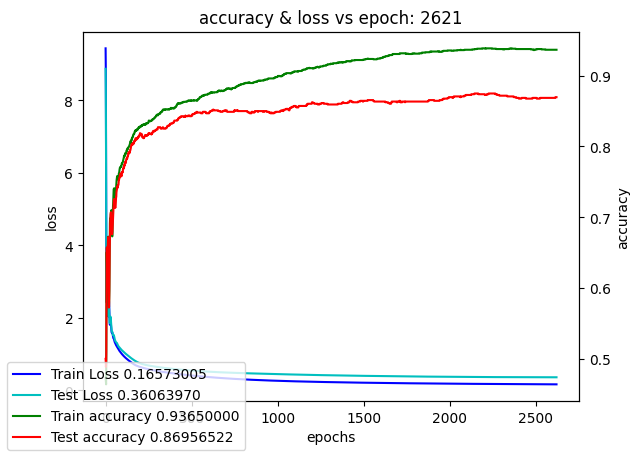

Training model color_cnn_single_kernel:  26%|██▋       | 2630/10000 [3:05:29<8:38:34,  4.22s/it]

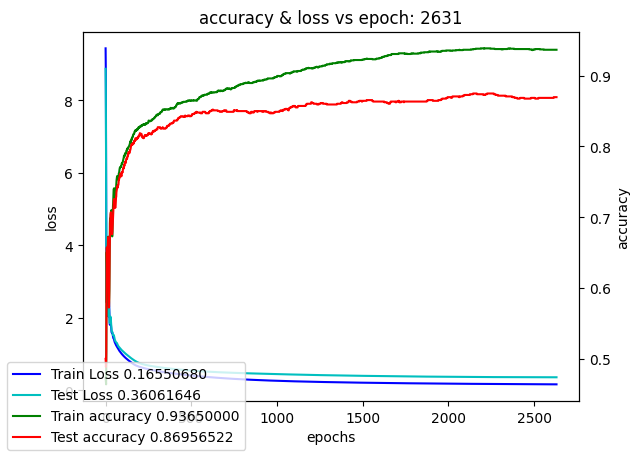

Training model color_cnn_single_kernel:  26%|██▋       | 2640/10000 [3:06:11<8:38:38,  4.23s/it]

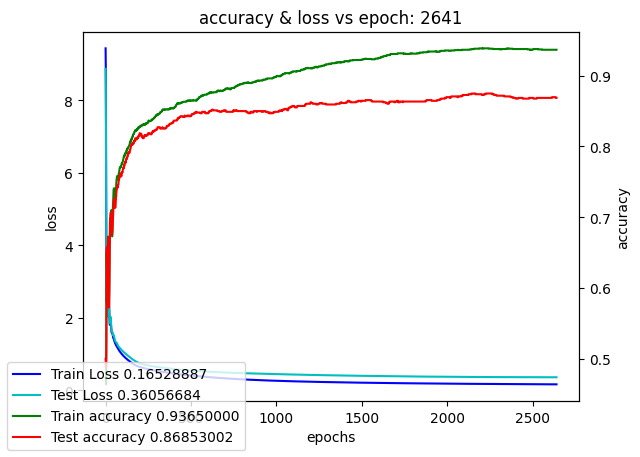

Training model color_cnn_single_kernel:  26%|██▋       | 2650/10000 [3:06:53<8:36:58,  4.22s/it]

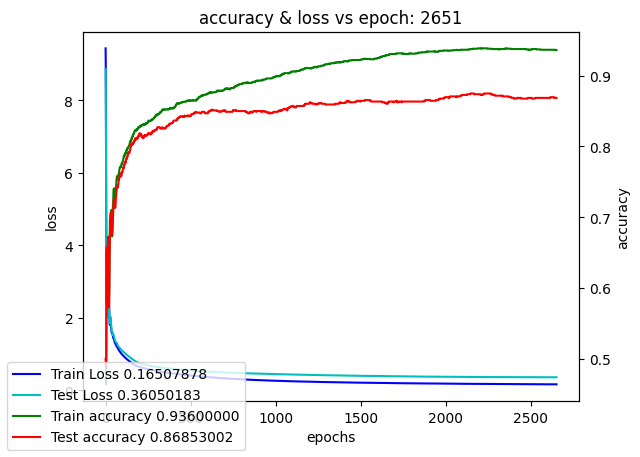

Training model color_cnn_single_kernel:  27%|██▋       | 2660/10000 [3:07:36<8:34:52,  4.21s/it]

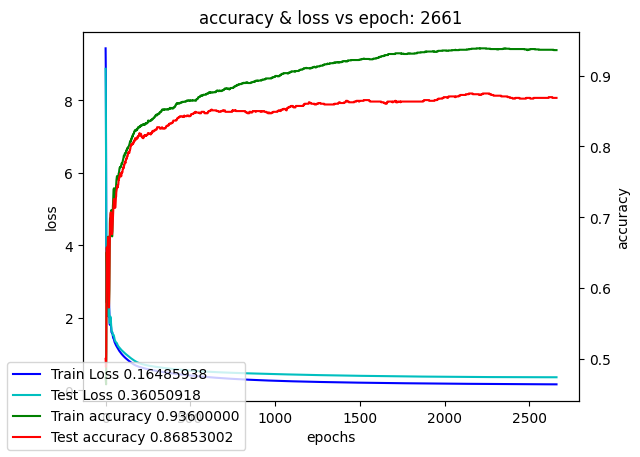

Training model color_cnn_single_kernel:  27%|██▋       | 2670/10000 [3:08:18<8:33:17,  4.20s/it]

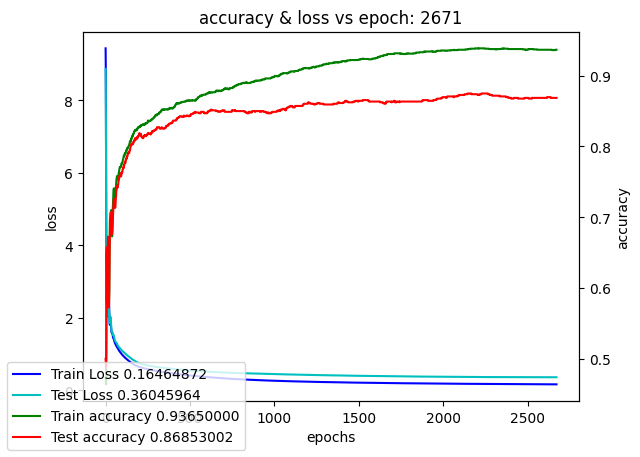

Training model color_cnn_single_kernel:  27%|██▋       | 2680/10000 [3:09:00<8:31:08,  4.19s/it]

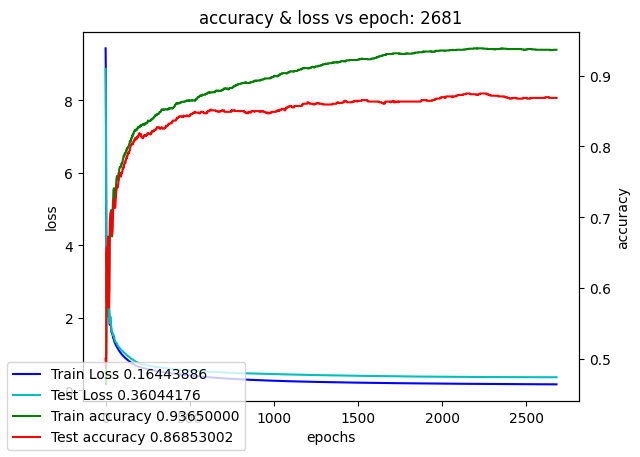

Training model color_cnn_single_kernel:  27%|██▋       | 2690/10000 [3:09:42<8:29:40,  4.18s/it]

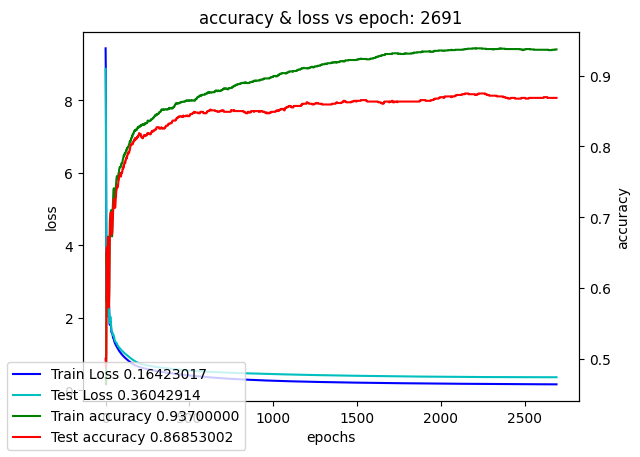

Training model color_cnn_single_kernel:  27%|██▋       | 2700/10000 [3:10:24<8:30:23,  4.19s/it]

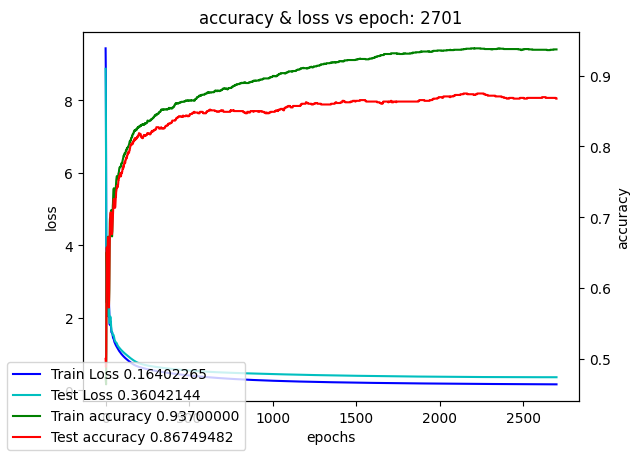

Training model color_cnn_single_kernel:  27%|██▋       | 2710/10000 [3:11:07<8:28:44,  4.19s/it]

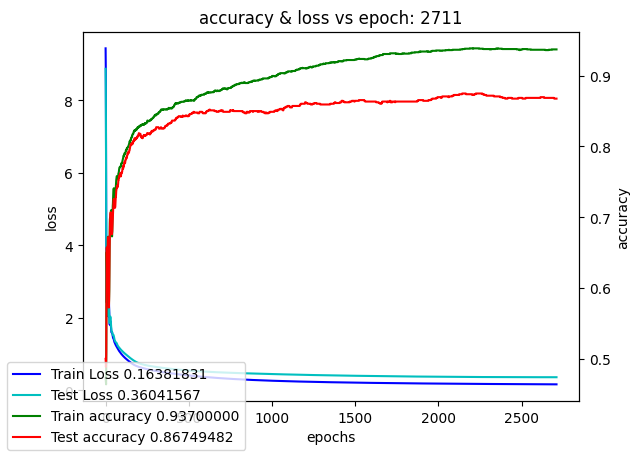

Training model color_cnn_single_kernel:  27%|██▋       | 2720/10000 [3:11:49<8:27:02,  4.18s/it]

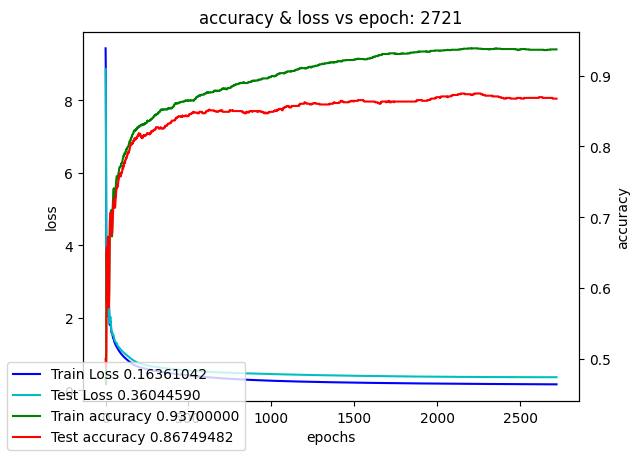

Training model color_cnn_single_kernel:  27%|██▋       | 2730/10000 [3:12:31<8:27:36,  4.19s/it]

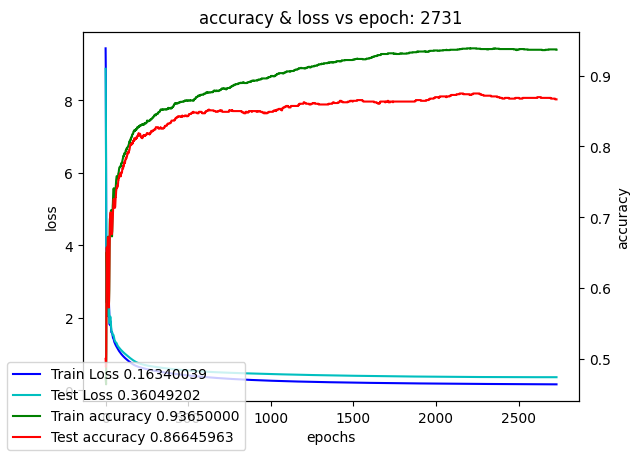

Training model color_cnn_single_kernel:  27%|██▋       | 2740/10000 [3:13:13<8:27:56,  4.20s/it]

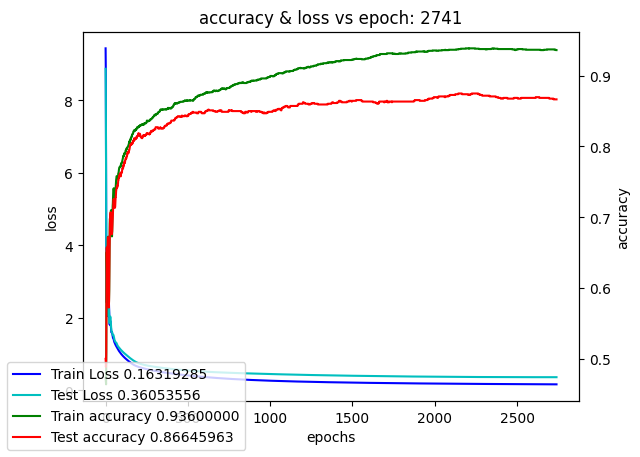

Training model color_cnn_single_kernel:  28%|██▊       | 2750/10000 [3:13:55<8:25:02,  4.18s/it]

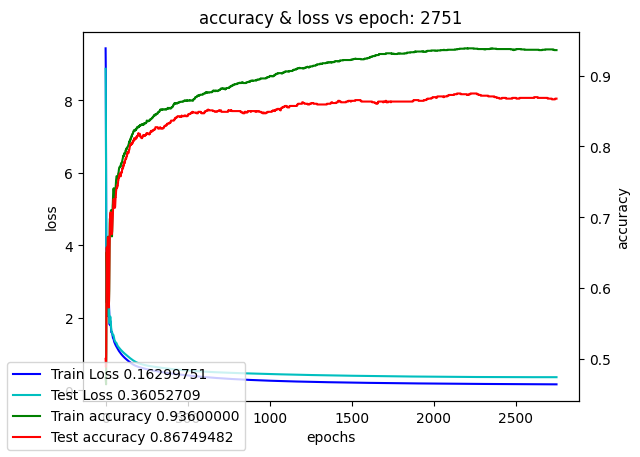

Training model color_cnn_single_kernel:  28%|██▊       | 2760/10000 [3:14:37<8:28:24,  4.21s/it]

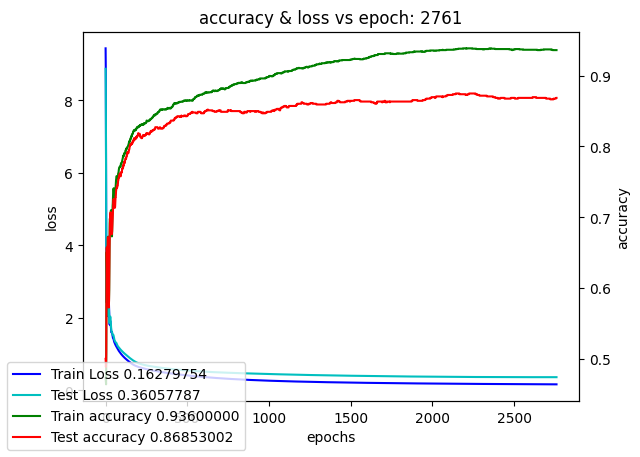

Training model color_cnn_single_kernel:  28%|██▊       | 2770/10000 [3:15:20<8:28:59,  4.22s/it]

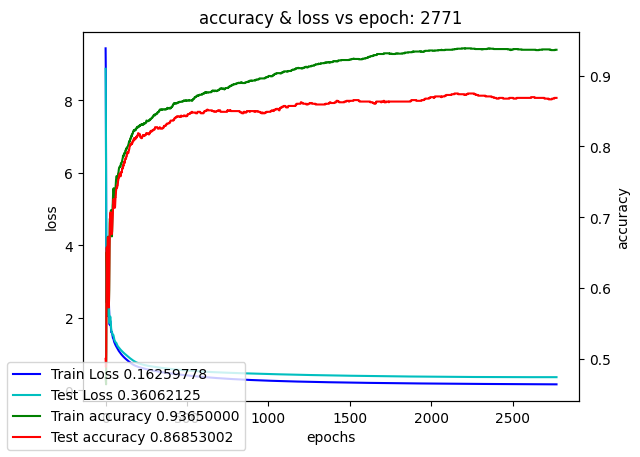

Training model color_cnn_single_kernel:  28%|██▊       | 2780/10000 [3:16:02<8:26:35,  4.21s/it]

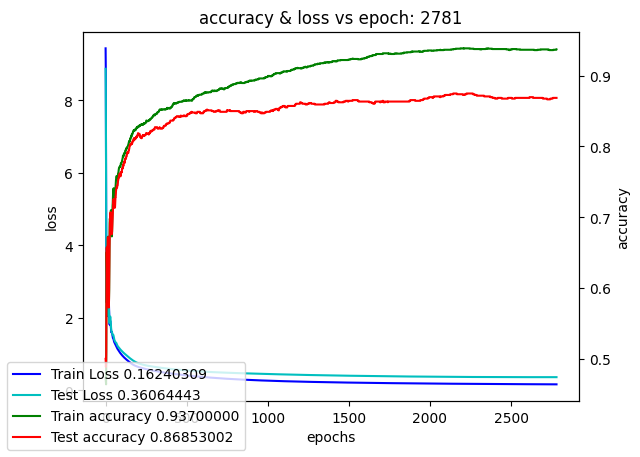

Training model color_cnn_single_kernel:  28%|██▊       | 2790/10000 [3:16:44<8:26:57,  4.22s/it]

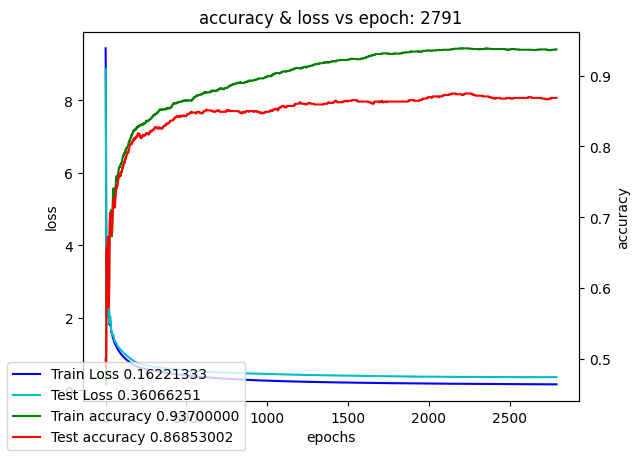

Training model color_cnn_single_kernel:  28%|██▊       | 2800/10000 [3:17:27<8:27:05,  4.23s/it]

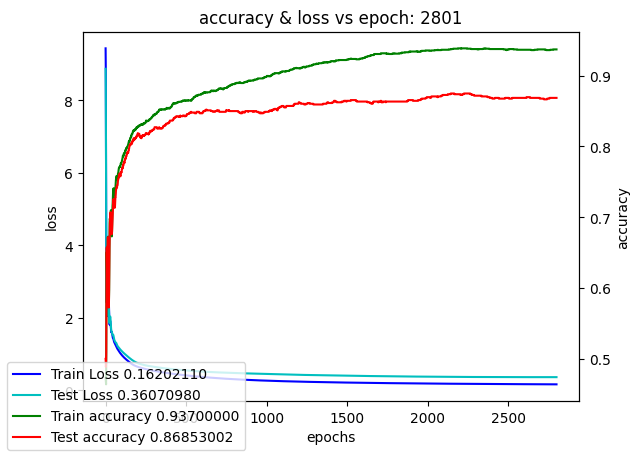

Training model color_cnn_single_kernel:  28%|██▊       | 2810/10000 [3:18:09<8:26:29,  4.23s/it]

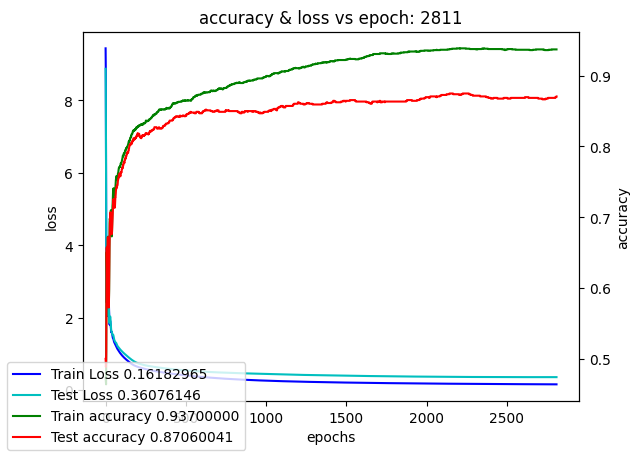

Training model color_cnn_single_kernel:  28%|██▊       | 2820/10000 [3:18:52<8:24:21,  4.21s/it]

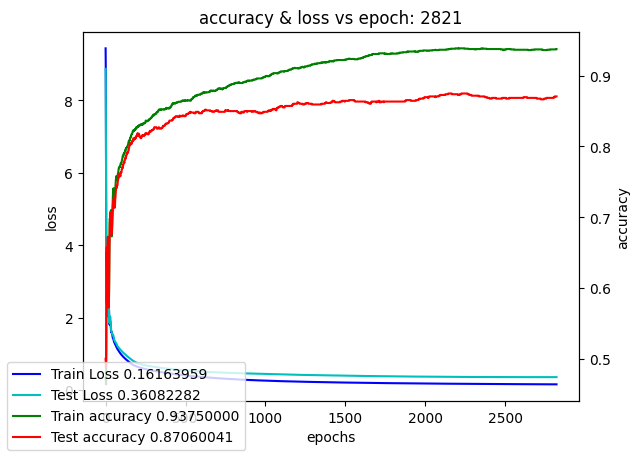

Training model color_cnn_single_kernel:  28%|██▊       | 2830/10000 [3:19:34<8:25:18,  4.23s/it]

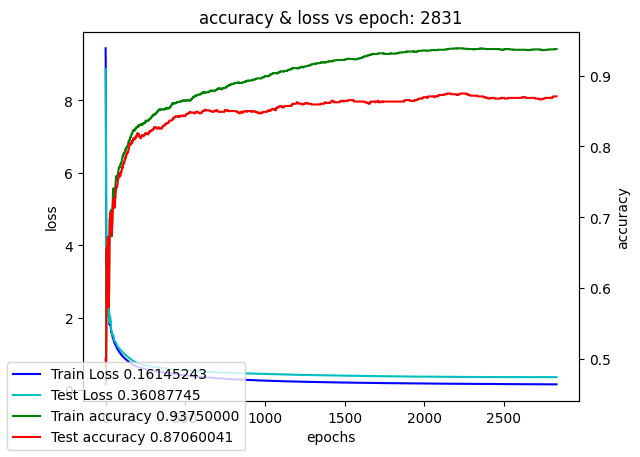

Training model color_cnn_single_kernel:  28%|██▊       | 2840/10000 [3:20:16<8:24:19,  4.23s/it]

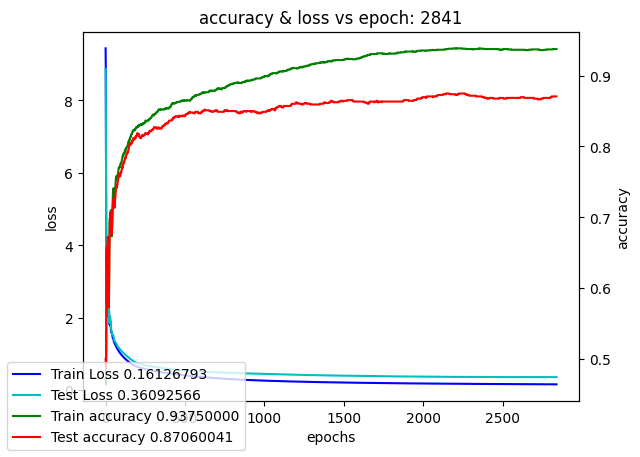

Training model color_cnn_single_kernel:  28%|██▊       | 2850/10000 [3:20:59<8:24:56,  4.24s/it]

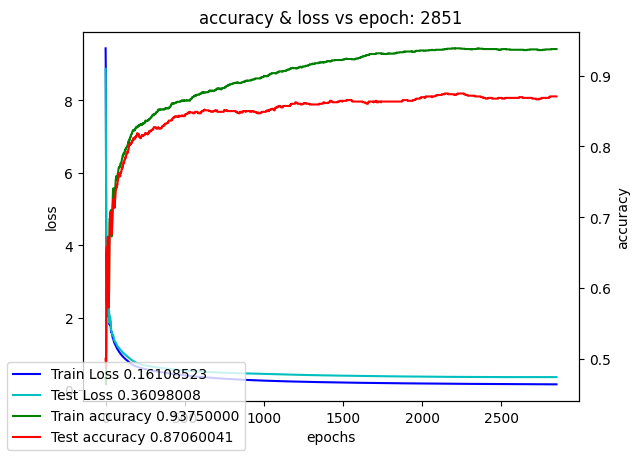

Training model color_cnn_single_kernel:  29%|██▊       | 2860/10000 [3:21:41<8:20:28,  4.21s/it]

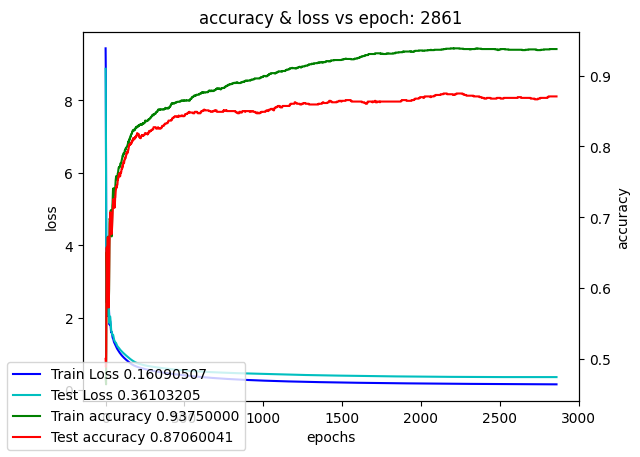

Training model color_cnn_single_kernel:  29%|██▊       | 2870/10000 [3:22:24<8:23:28,  4.24s/it]

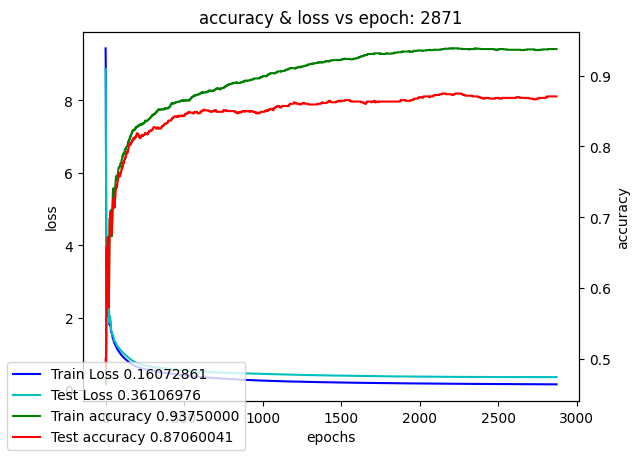

Training model color_cnn_single_kernel:  29%|██▉       | 2880/10000 [3:23:06<8:26:09,  4.27s/it]

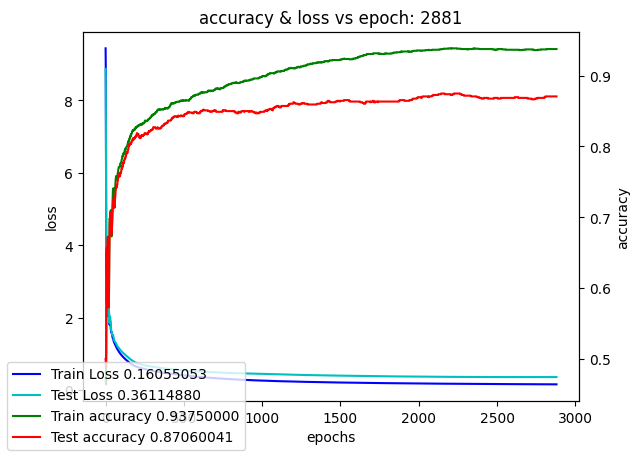

Training model color_cnn_single_kernel:  29%|██▉       | 2890/10000 [3:23:49<8:20:03,  4.22s/it]

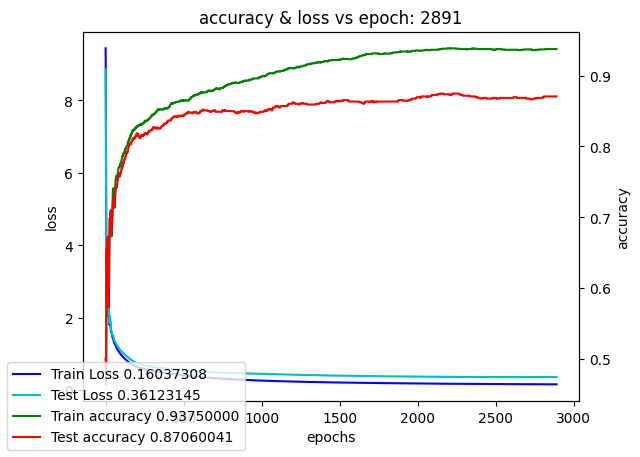

Training model color_cnn_single_kernel:  29%|██▉       | 2900/10000 [3:24:31<8:18:25,  4.21s/it]

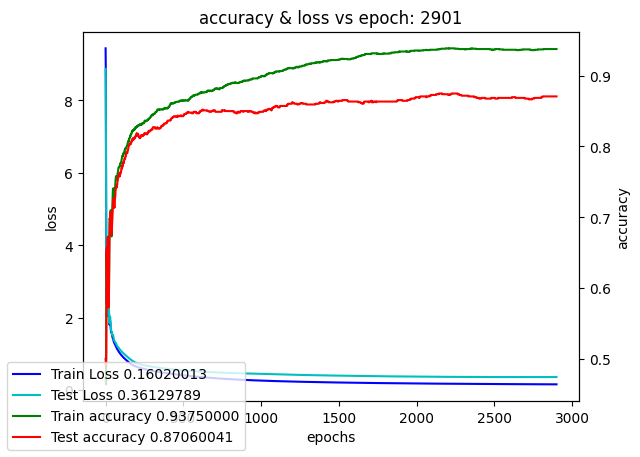

Training model color_cnn_single_kernel:  29%|██▉       | 2910/10000 [3:25:13<8:15:57,  4.20s/it]

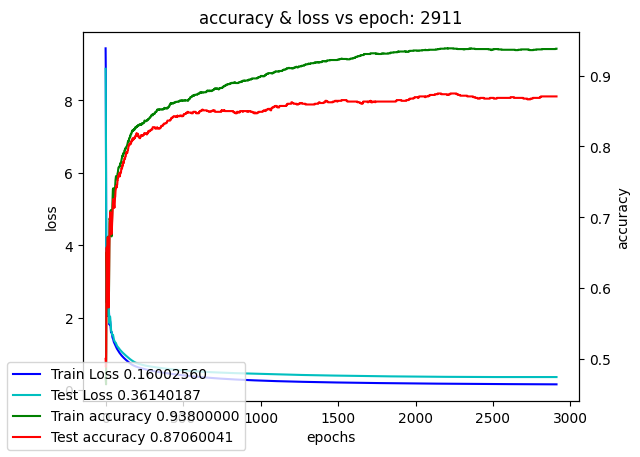

Training model color_cnn_single_kernel:  29%|██▉       | 2920/10000 [3:25:55<8:15:03,  4.20s/it]

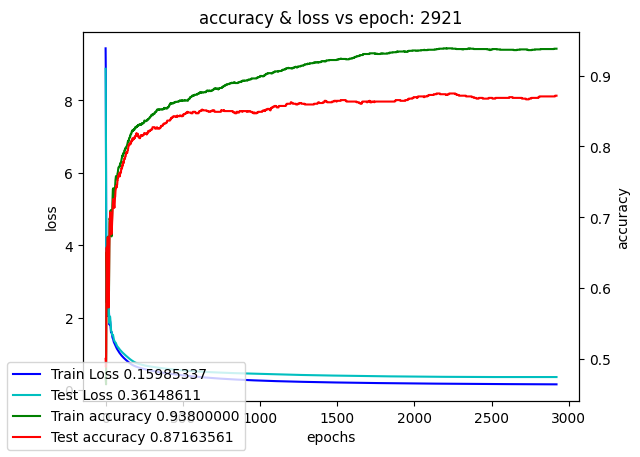

Training model color_cnn_single_kernel:  29%|██▉       | 2930/10000 [3:26:37<8:15:39,  4.21s/it]

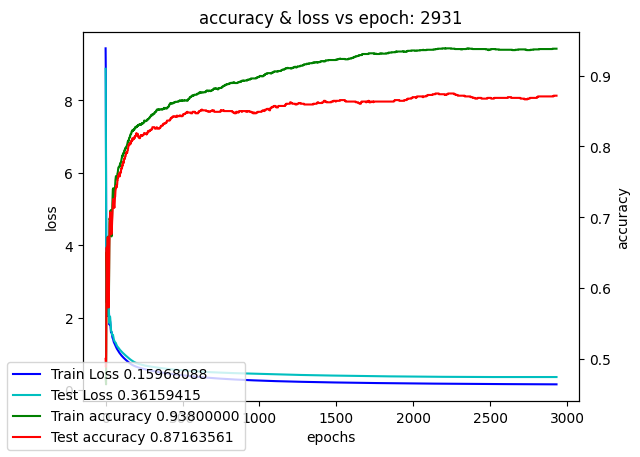

Training model color_cnn_single_kernel:  29%|██▉       | 2940/10000 [3:27:20<8:11:50,  4.18s/it]

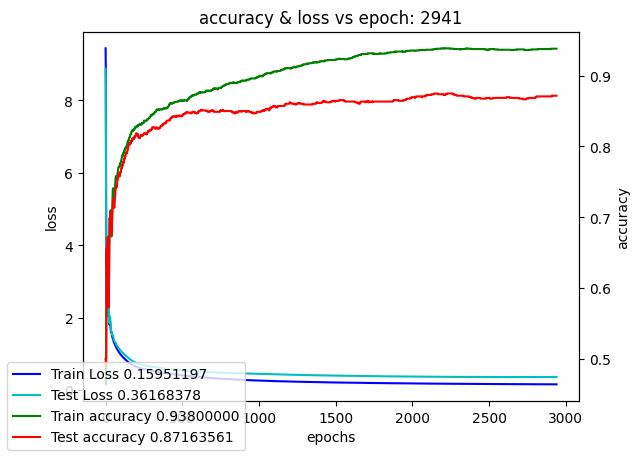

Training model color_cnn_single_kernel:  30%|██▉       | 2950/10000 [3:28:02<8:13:41,  4.20s/it]

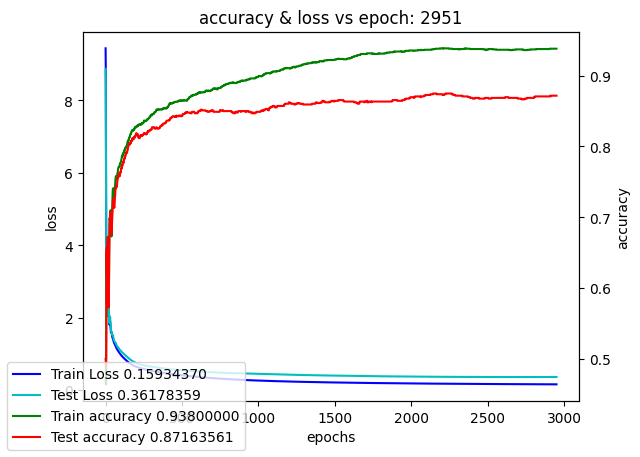

Training model color_cnn_single_kernel:  30%|██▉       | 2960/10000 [3:28:44<8:11:51,  4.19s/it]

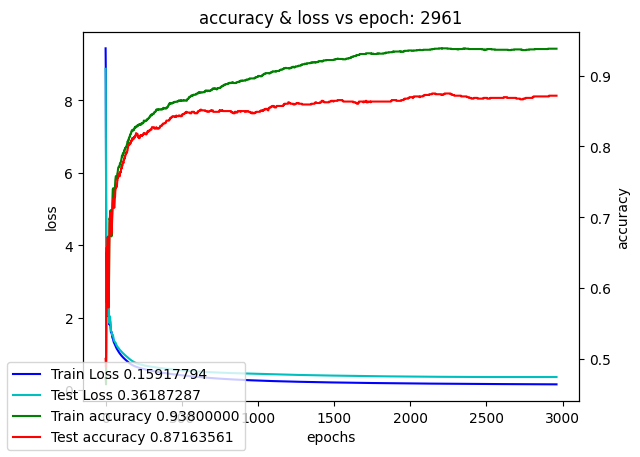

Training model color_cnn_single_kernel:  30%|██▉       | 2970/10000 [3:29:26<8:12:14,  4.20s/it]

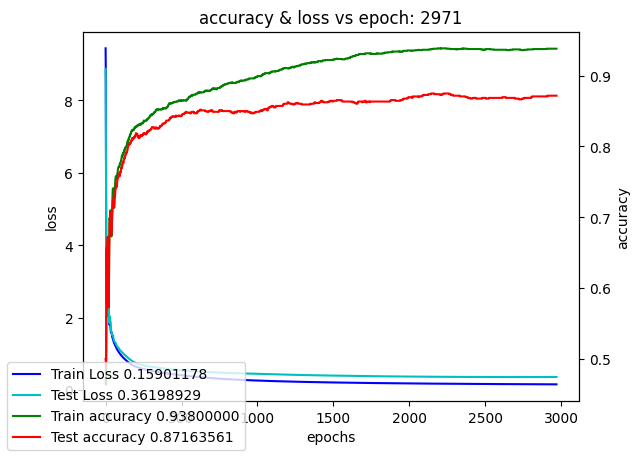

Training model color_cnn_single_kernel:  30%|██▉       | 2980/10000 [3:30:08<8:11:52,  4.20s/it]

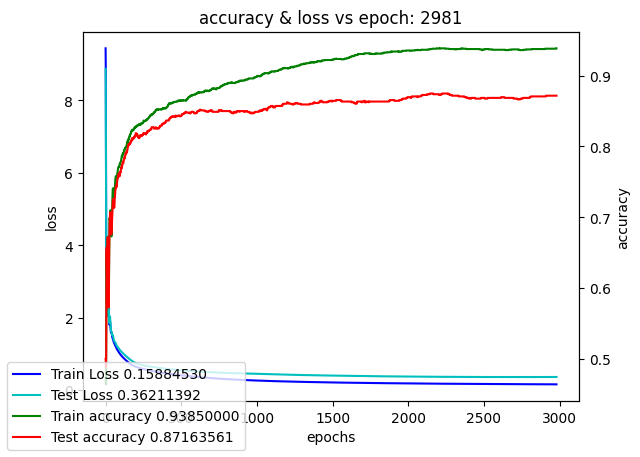

Training model color_cnn_single_kernel:  30%|██▉       | 2990/10000 [3:30:50<8:13:03,  4.22s/it]

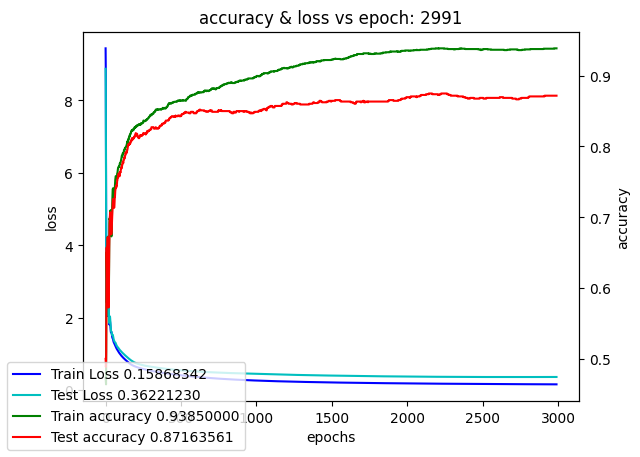

Training model color_cnn_single_kernel:  30%|███       | 3000/10000 [3:31:33<8:14:50,  4.24s/it]

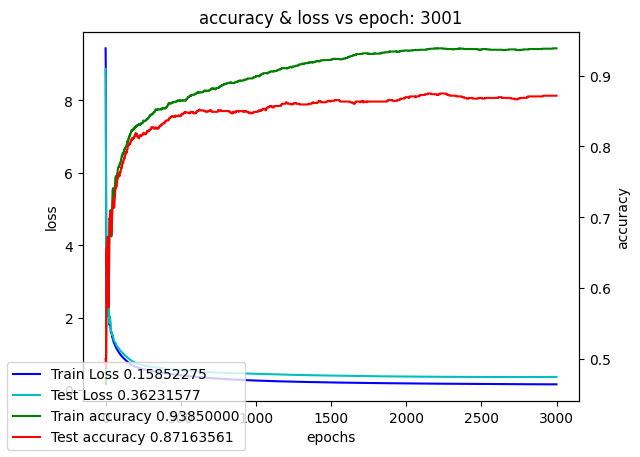

Training model color_cnn_single_kernel:  30%|███       | 3010/10000 [3:32:15<8:10:18,  4.21s/it]

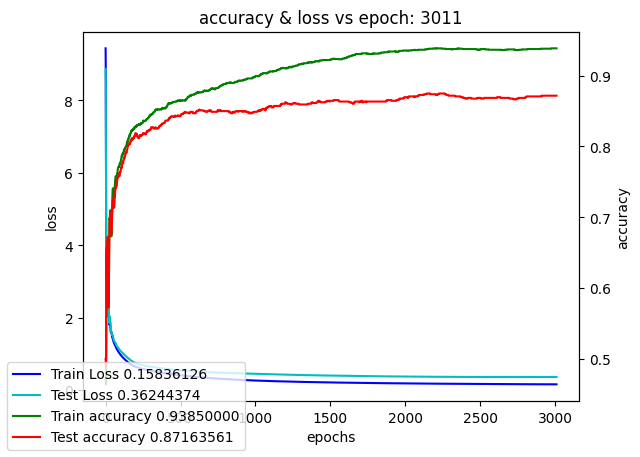

Training model color_cnn_single_kernel:  30%|███       | 3020/10000 [3:32:58<8:14:10,  4.25s/it]

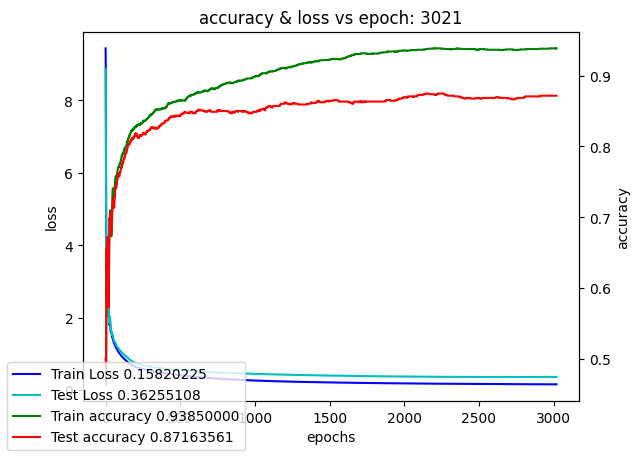

Training model color_cnn_single_kernel:  30%|███       | 3030/10000 [3:33:40<8:13:29,  4.25s/it]

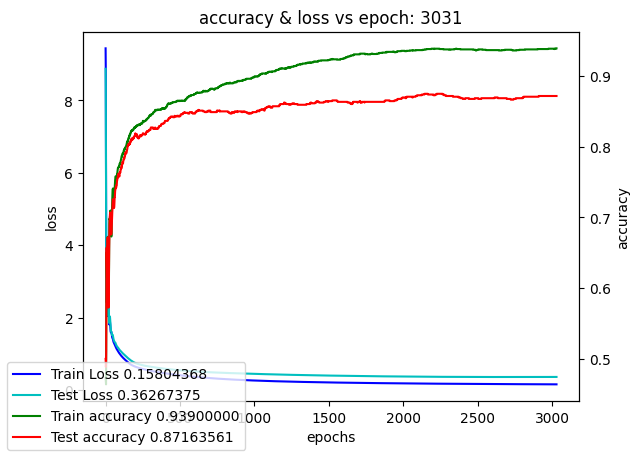

Training model color_cnn_single_kernel:  30%|███       | 3040/10000 [3:34:23<8:11:07,  4.23s/it]

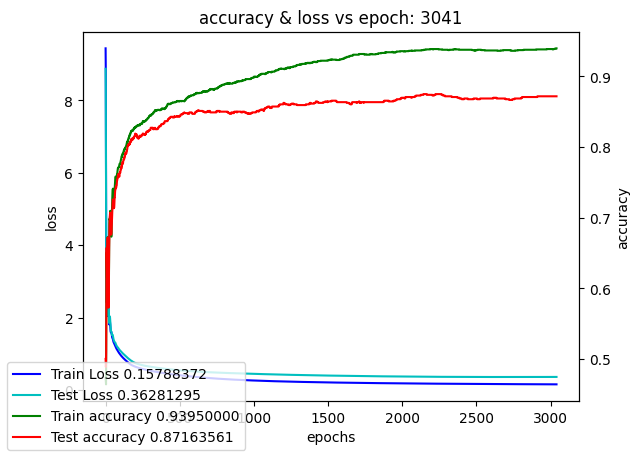

Training model color_cnn_single_kernel:  30%|███       | 3050/10000 [3:35:05<8:09:41,  4.23s/it]

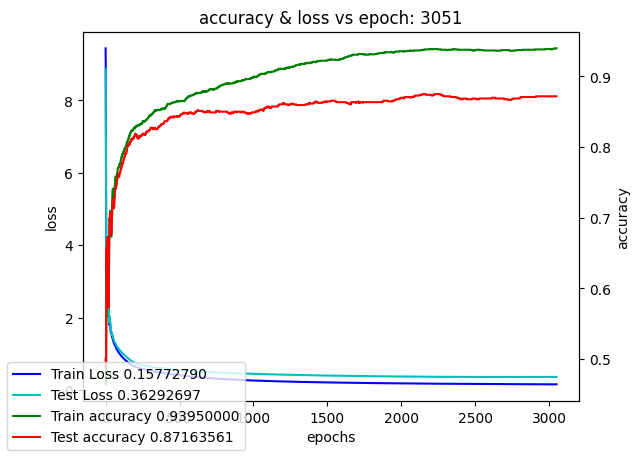

Training model color_cnn_single_kernel:  31%|███       | 3060/10000 [3:35:48<8:06:17,  4.20s/it]

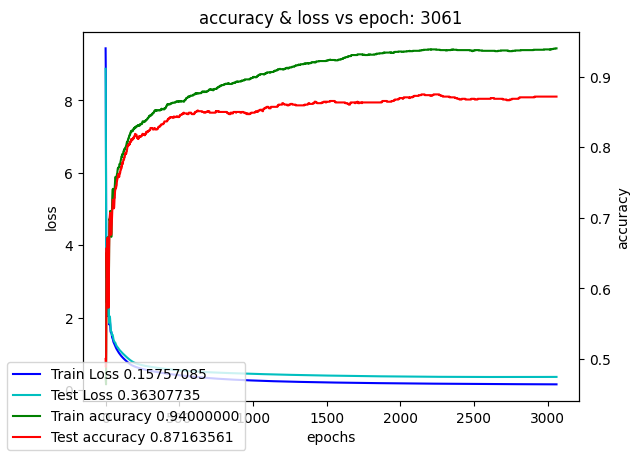

Training model color_cnn_single_kernel:  31%|███       | 3070/10000 [3:36:30<8:06:15,  4.21s/it]

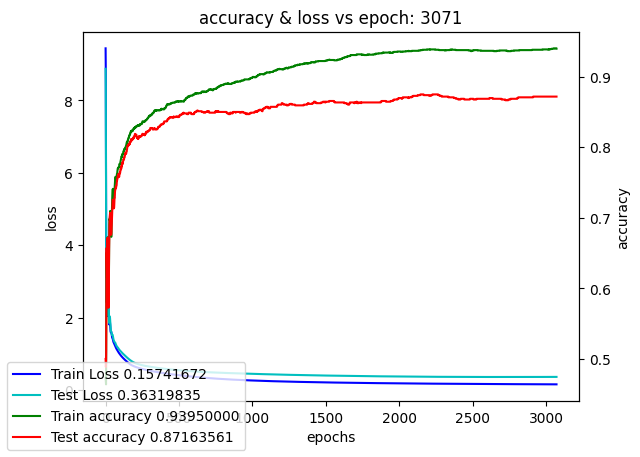

Training model color_cnn_single_kernel:  31%|███       | 3080/10000 [3:37:12<8:06:10,  4.22s/it]

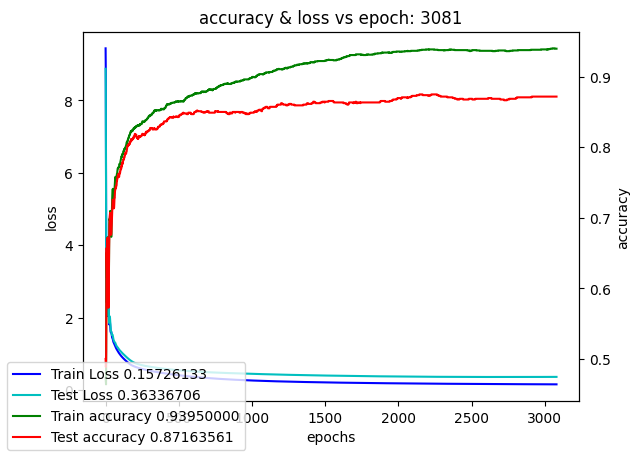

Training model color_cnn_single_kernel:  31%|███       | 3090/10000 [3:37:55<8:06:41,  4.23s/it]

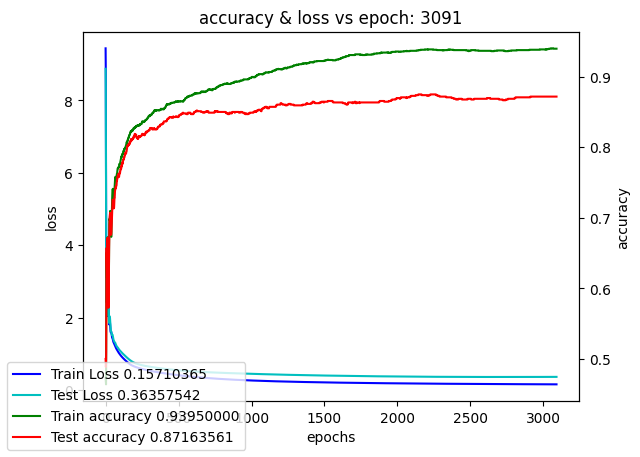

Training model color_cnn_single_kernel:  31%|███       | 3100/10000 [3:38:37<8:02:51,  4.20s/it]

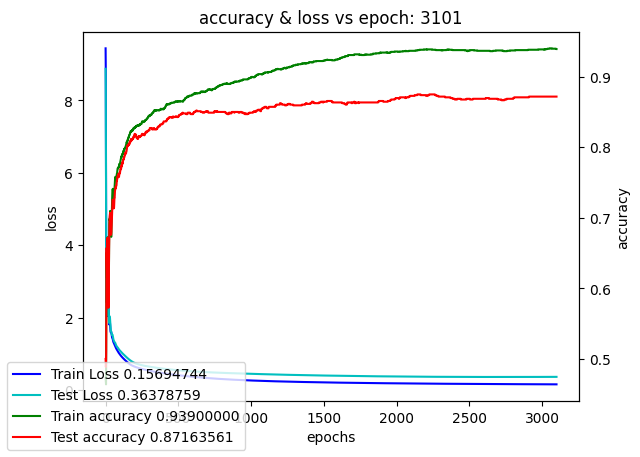

Training model color_cnn_single_kernel:  31%|███       | 3110/10000 [3:39:19<8:00:22,  4.18s/it]

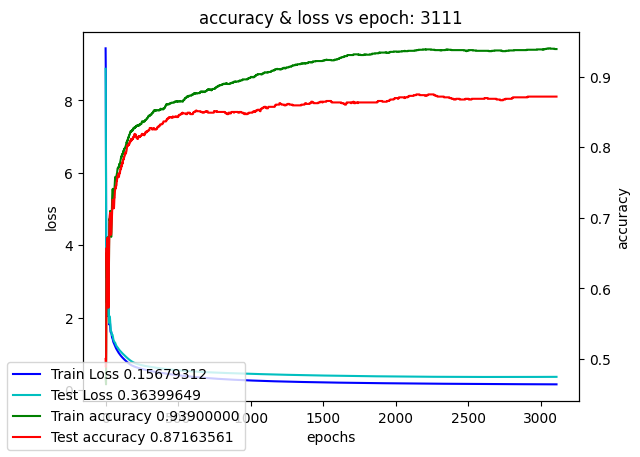

Training model color_cnn_single_kernel:  31%|███       | 3120/10000 [3:40:01<8:01:05,  4.20s/it]

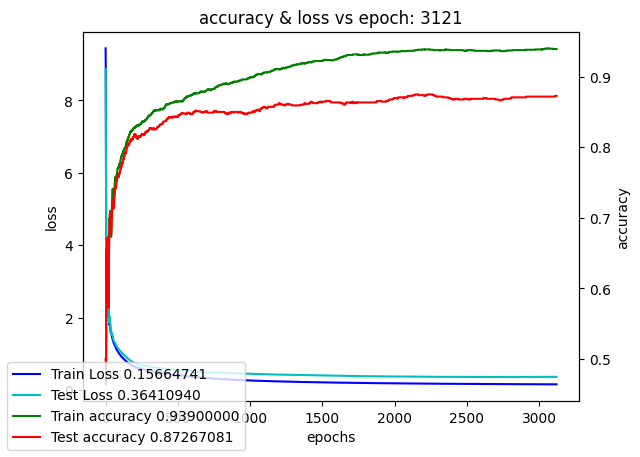

Training model color_cnn_single_kernel:  31%|███▏      | 3130/10000 [3:40:43<7:58:39,  4.18s/it]

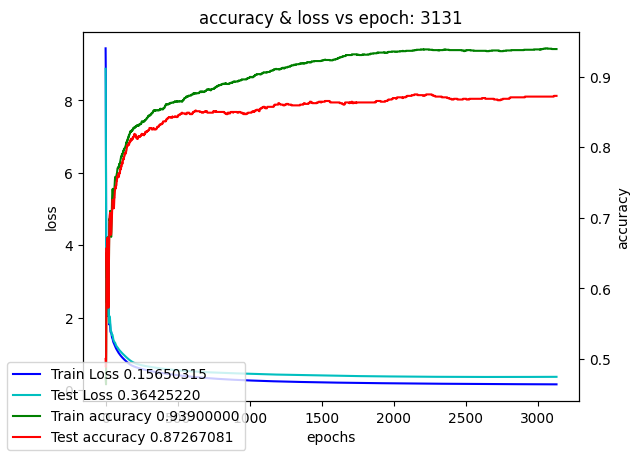

Training model color_cnn_single_kernel:  31%|███▏      | 3140/10000 [3:41:25<7:59:22,  4.19s/it]

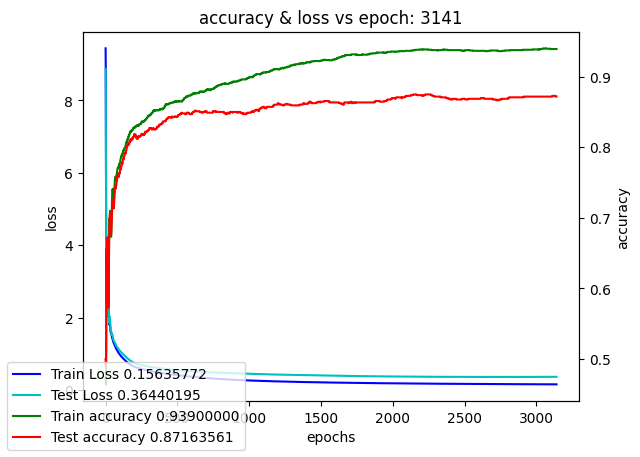

Training model color_cnn_single_kernel:  32%|███▏      | 3150/10000 [3:42:07<7:58:55,  4.19s/it]

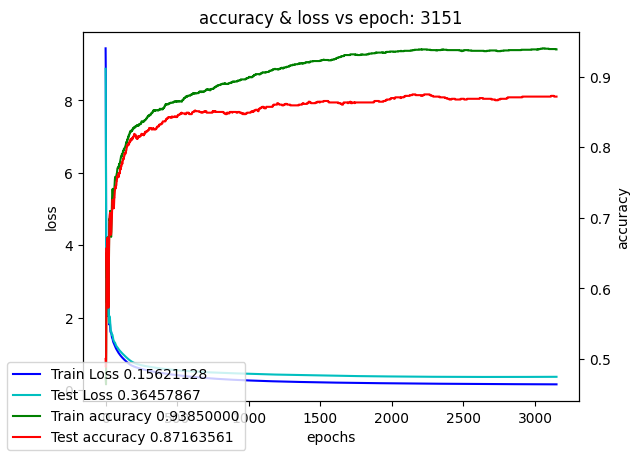

Training model color_cnn_single_kernel:  32%|███▏      | 3160/10000 [3:42:50<7:59:05,  4.20s/it]

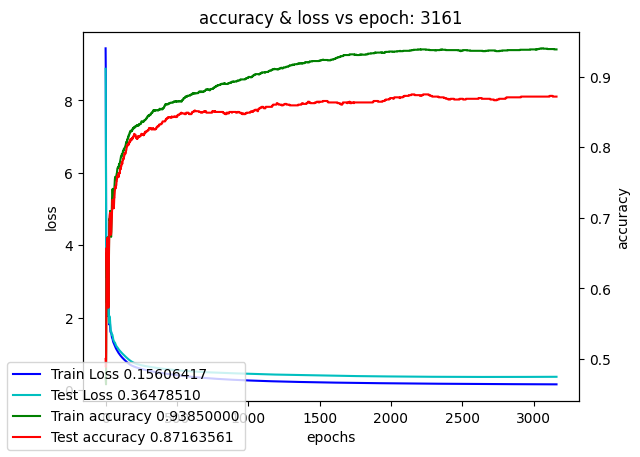

Training model color_cnn_single_kernel:  32%|███▏      | 3170/10000 [3:43:32<7:58:07,  4.20s/it]

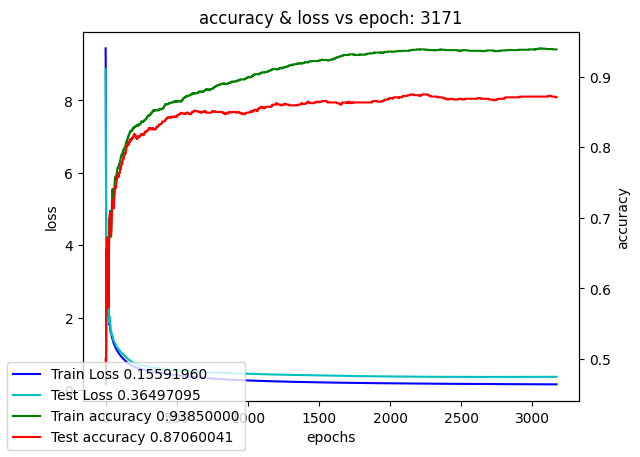

Training model color_cnn_single_kernel:  32%|███▏      | 3180/10000 [3:44:14<7:56:28,  4.19s/it]

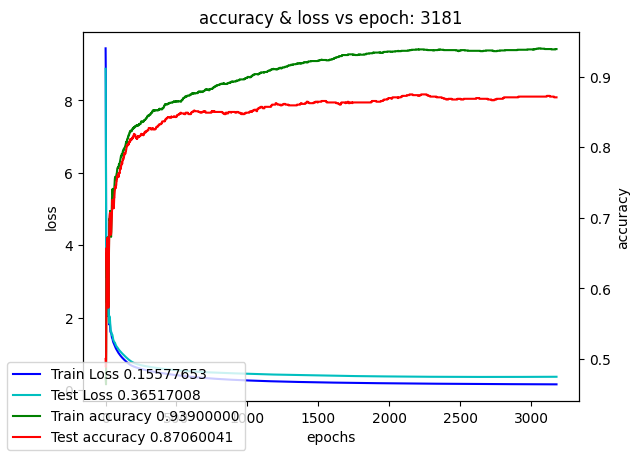

Training model color_cnn_single_kernel:  32%|███▏      | 3190/10000 [3:44:56<7:57:23,  4.21s/it]

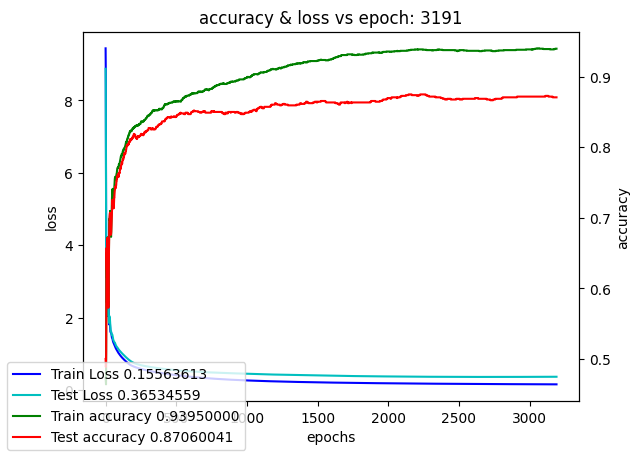

Training model color_cnn_single_kernel:  32%|███▏      | 3200/10000 [3:45:38<7:58:38,  4.22s/it]

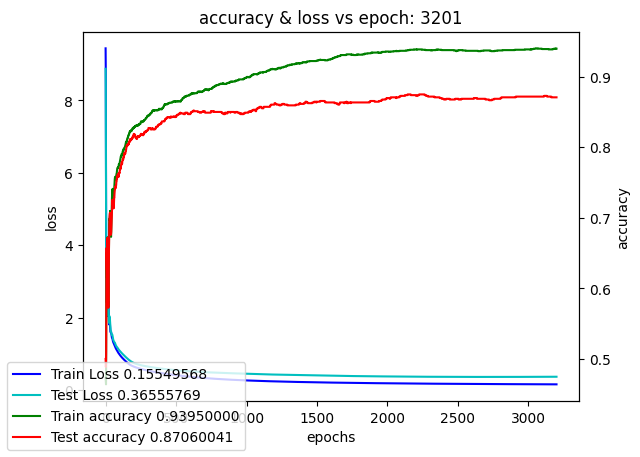

Training model color_cnn_single_kernel:  32%|███▏      | 3210/10000 [3:46:21<7:58:26,  4.23s/it]

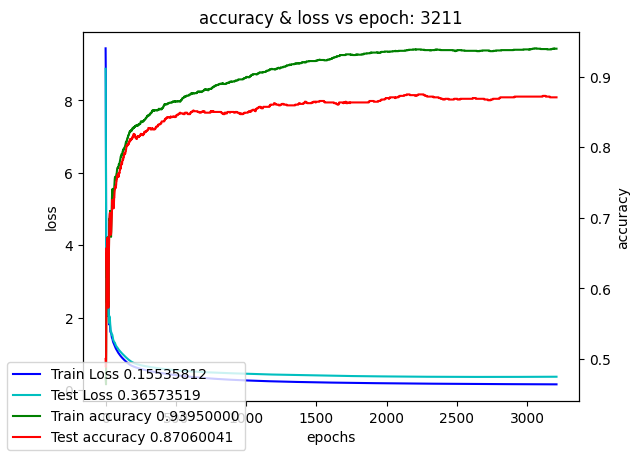

Training model color_cnn_single_kernel:  32%|███▏      | 3220/10000 [3:47:03<7:57:48,  4.23s/it]

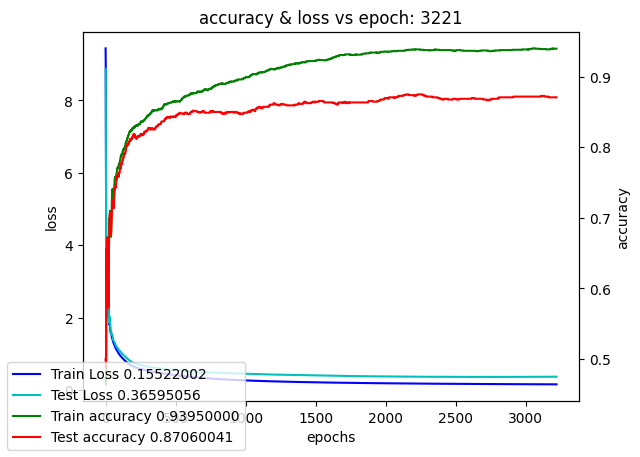

Training model color_cnn_single_kernel:  32%|███▏      | 3230/10000 [3:47:46<7:56:42,  4.22s/it]

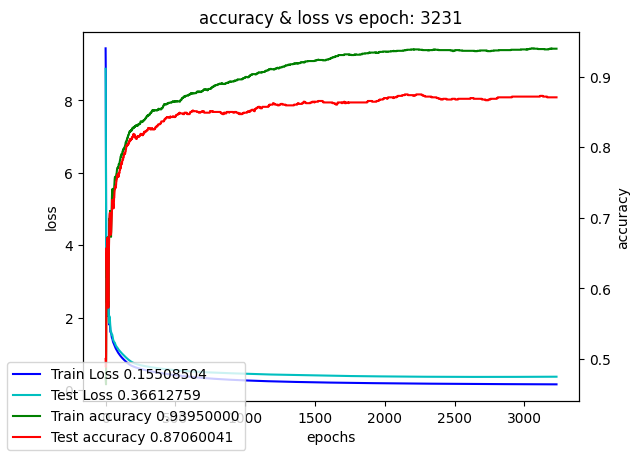

Training model color_cnn_single_kernel:  32%|███▏      | 3240/10000 [3:48:28<7:57:46,  4.24s/it]

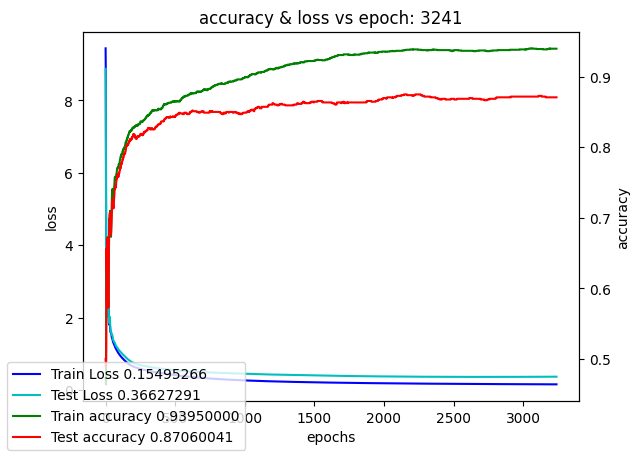

Training model color_cnn_single_kernel:  32%|███▎      | 3250/10000 [3:49:11<7:55:28,  4.23s/it]

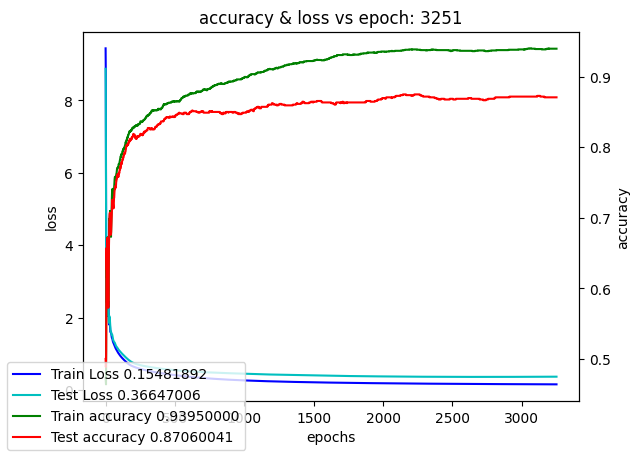

Training model color_cnn_single_kernel:  33%|███▎      | 3260/10000 [3:49:53<7:53:40,  4.22s/it]

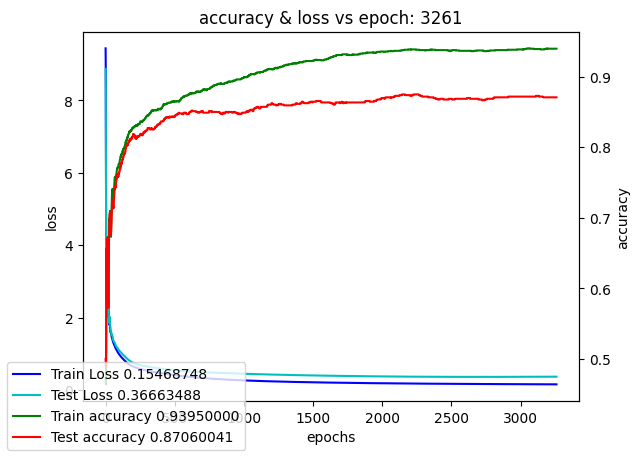

Training model color_cnn_single_kernel:  33%|███▎      | 3270/10000 [3:50:36<7:52:40,  4.21s/it]

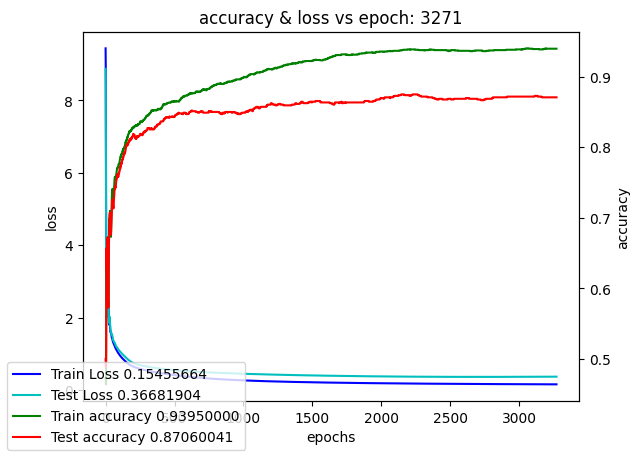

Training model color_cnn_single_kernel:  33%|███▎      | 3280/10000 [3:51:18<7:52:33,  4.22s/it]

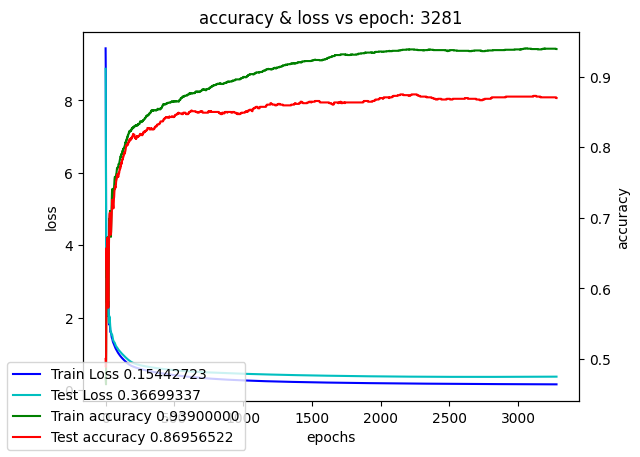

Training model color_cnn_single_kernel:  33%|███▎      | 3290/10000 [3:52:01<7:51:58,  4.22s/it]

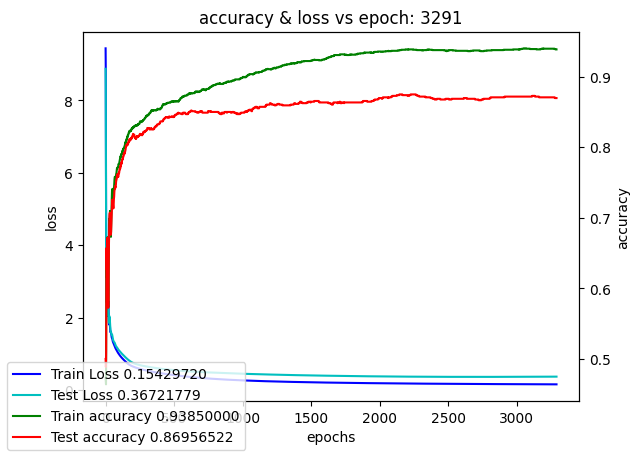

Training model color_cnn_single_kernel:  33%|███▎      | 3300/10000 [3:52:43<7:49:07,  4.20s/it]

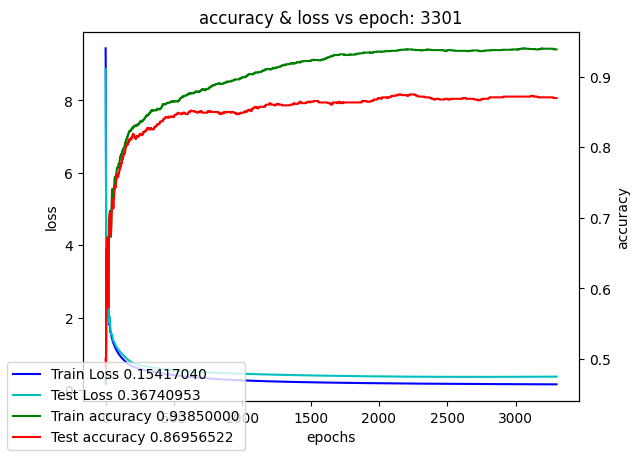

Training model color_cnn_single_kernel:  33%|███▎      | 3310/10000 [3:53:25<7:48:10,  4.20s/it]

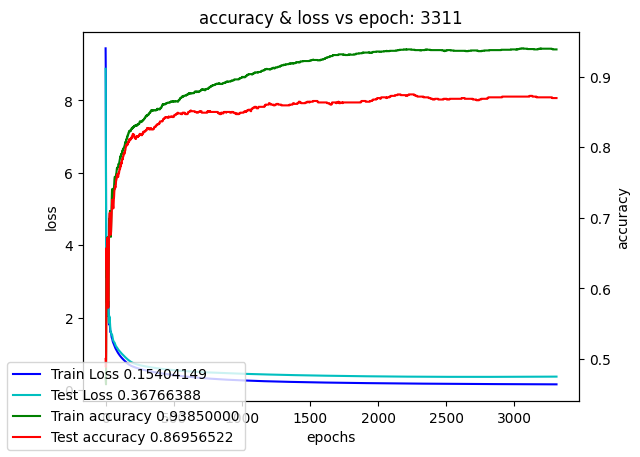

Training model color_cnn_single_kernel:  33%|███▎      | 3320/10000 [3:54:07<7:48:02,  4.20s/it]

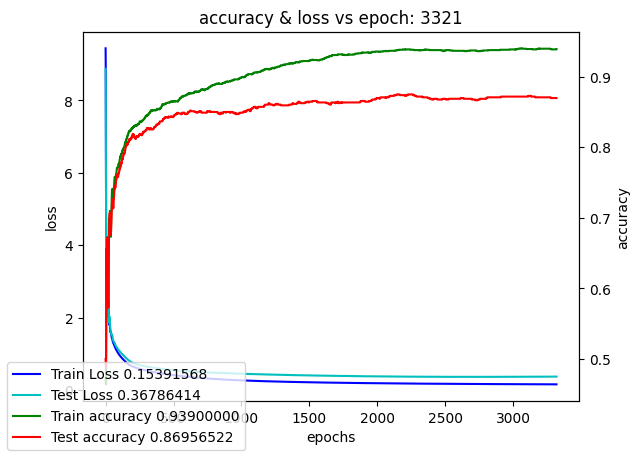

Training model color_cnn_single_kernel:  33%|███▎      | 3330/10000 [3:54:50<7:49:21,  4.22s/it]

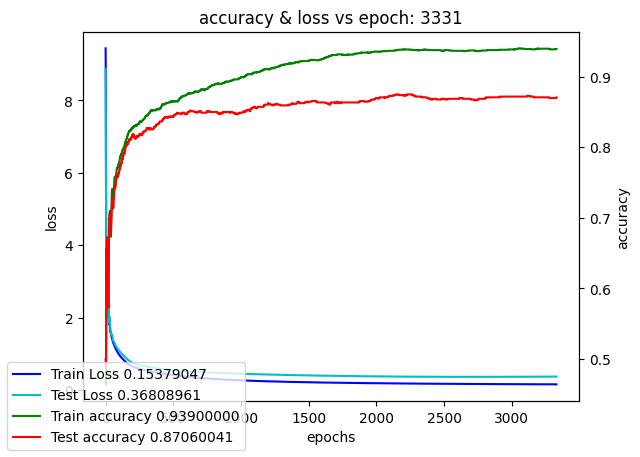

Training model color_cnn_single_kernel:  33%|███▎      | 3340/10000 [3:55:32<7:47:00,  4.21s/it]

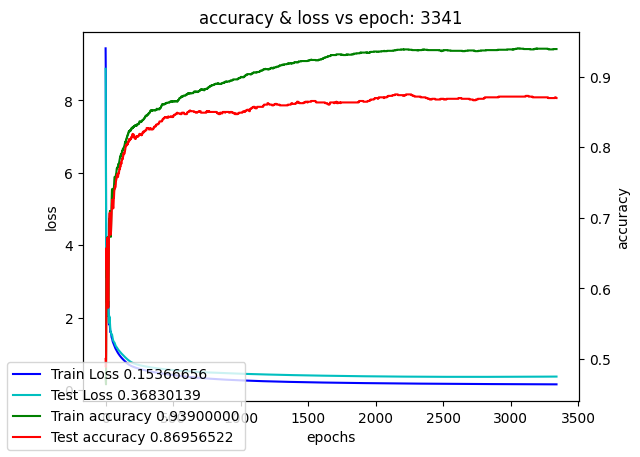

Training model color_cnn_single_kernel:  34%|███▎      | 3350/10000 [3:56:14<7:46:28,  4.21s/it]

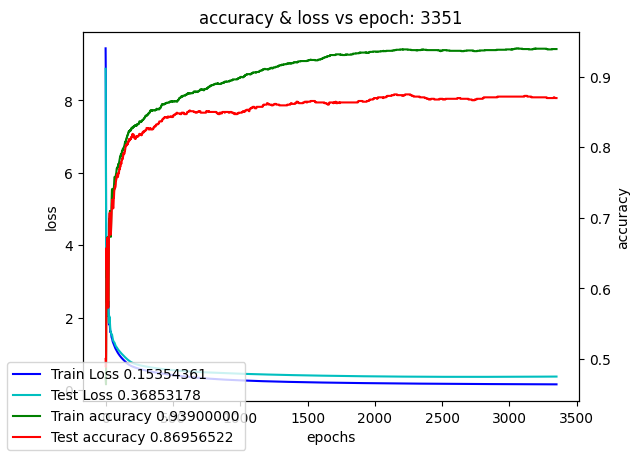

Training model color_cnn_single_kernel:  34%|███▎      | 3360/10000 [3:56:56<7:43:11,  4.19s/it]

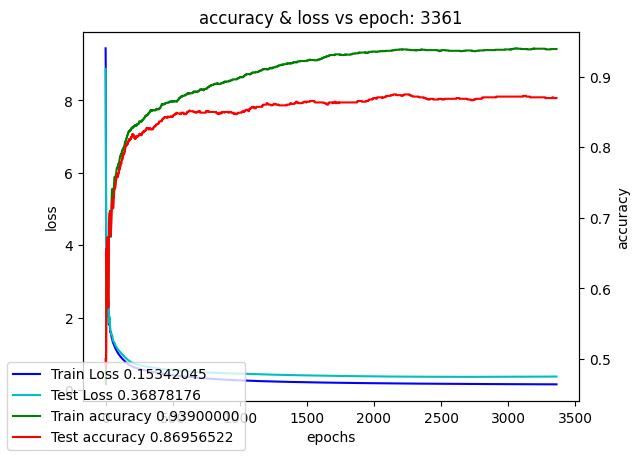

Training model color_cnn_single_kernel:  34%|███▎      | 3370/10000 [3:57:38<7:43:03,  4.19s/it]

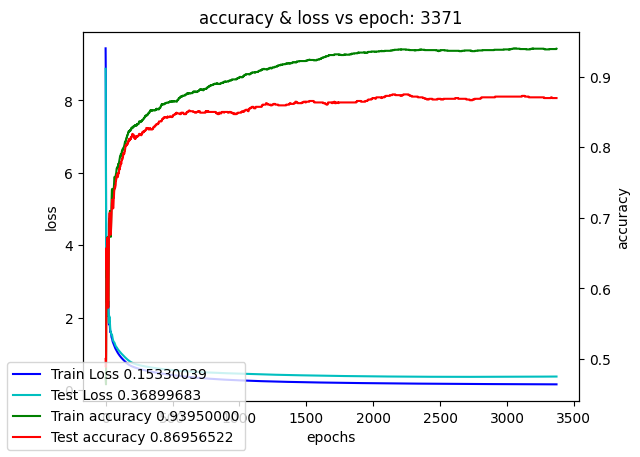

Training model color_cnn_single_kernel:  34%|███▍      | 3380/10000 [3:58:20<7:42:33,  4.19s/it]

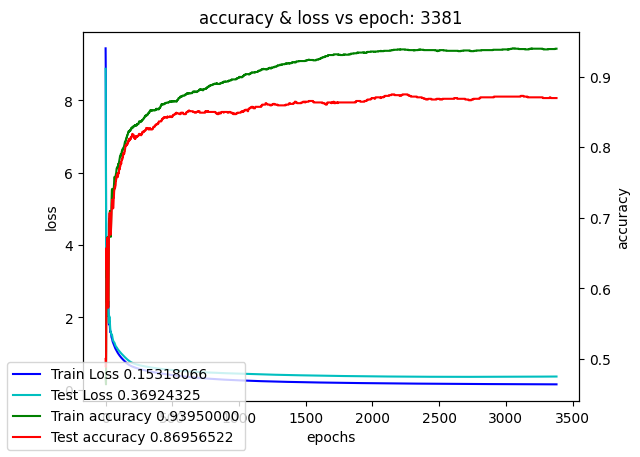

Training model color_cnn_single_kernel:  34%|███▍      | 3390/10000 [3:59:03<7:44:03,  4.21s/it]

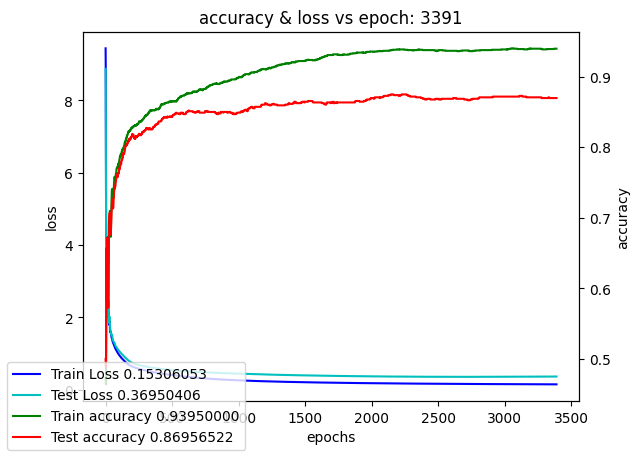

Training model color_cnn_single_kernel:  34%|███▍      | 3400/10000 [3:59:45<7:42:15,  4.20s/it]

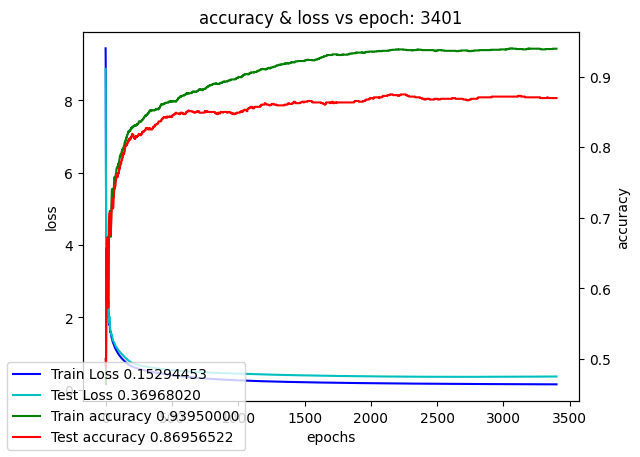

Training model color_cnn_single_kernel:  34%|███▍      | 3410/10000 [4:00:28<7:44:40,  4.23s/it]

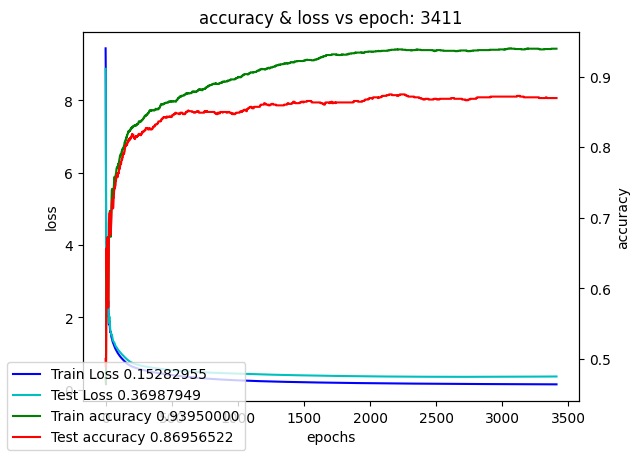

Training model color_cnn_single_kernel:  34%|███▍      | 3420/10000 [4:01:10<7:46:22,  4.25s/it]

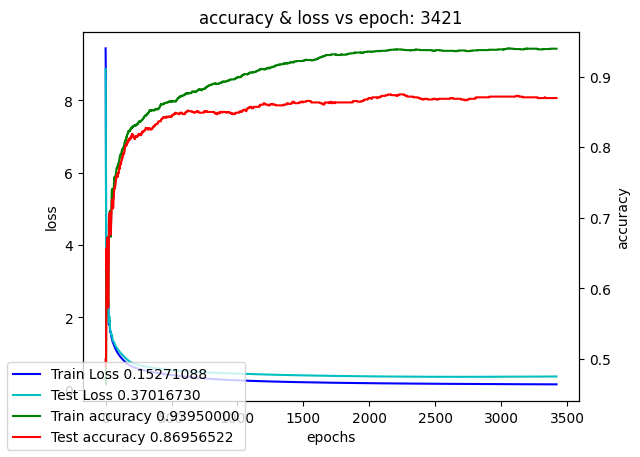

Training model color_cnn_single_kernel:  34%|███▍      | 3430/10000 [4:01:53<7:42:18,  4.22s/it]

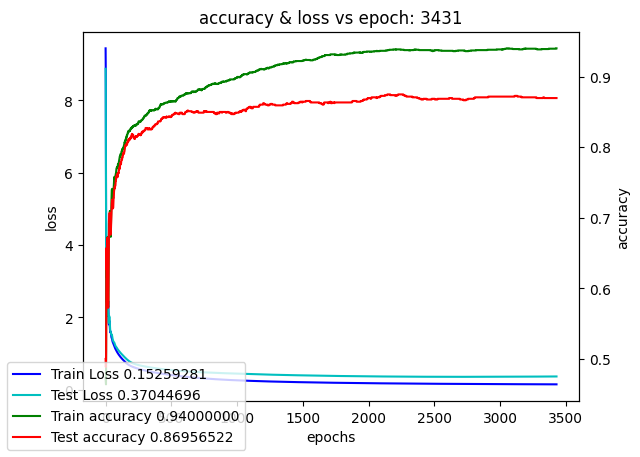

Training model color_cnn_single_kernel:  34%|███▍      | 3440/10000 [4:02:35<7:42:57,  4.23s/it]

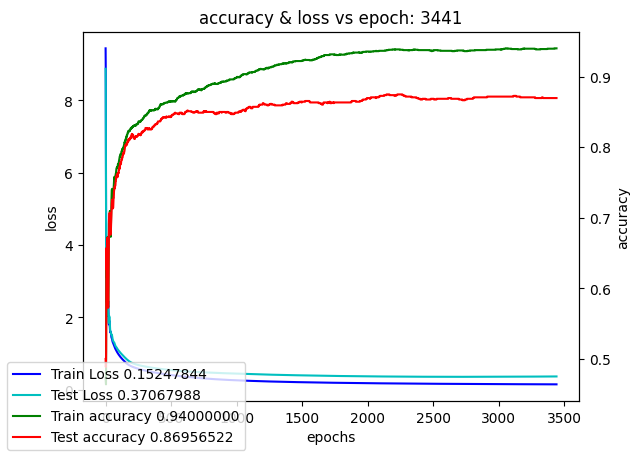

Training model color_cnn_single_kernel:  34%|███▍      | 3450/10000 [4:03:18<7:41:27,  4.23s/it]

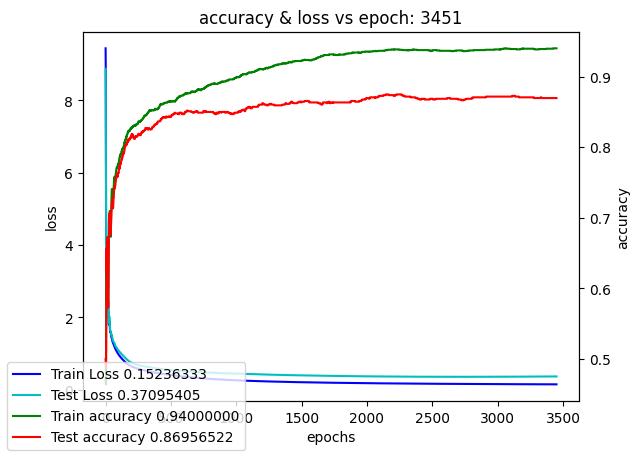

Training model color_cnn_single_kernel:  35%|███▍      | 3460/10000 [4:04:00<7:40:28,  4.22s/it]

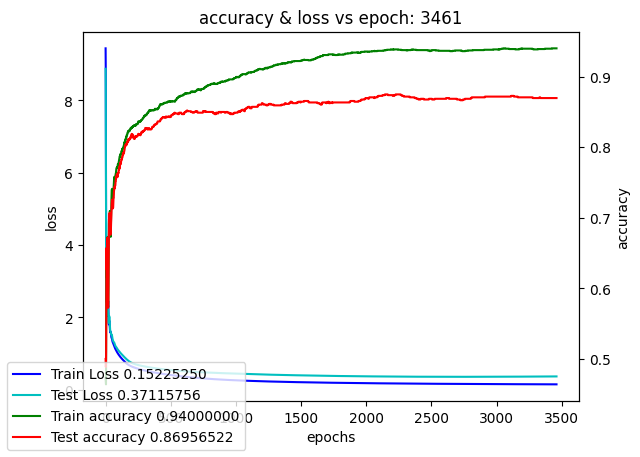

Training model color_cnn_single_kernel:  35%|███▍      | 3470/10000 [4:04:43<7:41:02,  4.24s/it]

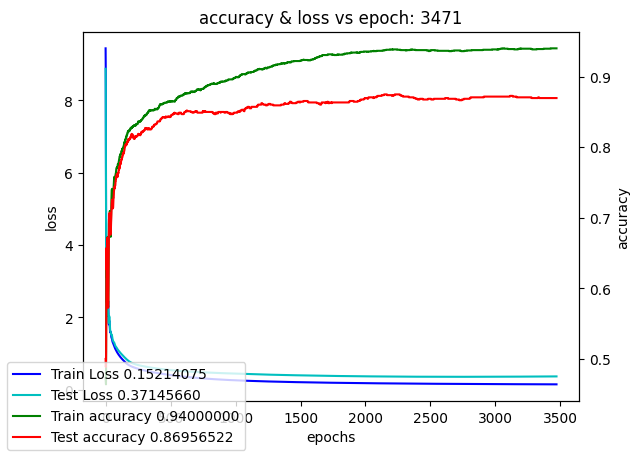

Training model color_cnn_single_kernel:  35%|███▍      | 3480/10000 [4:05:25<7:38:21,  4.22s/it]

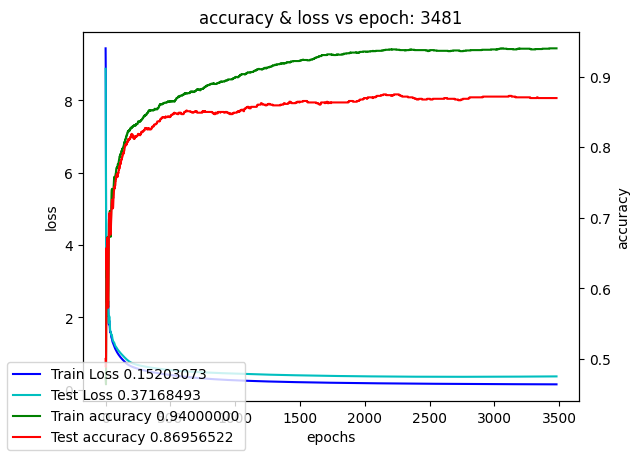

Training model color_cnn_single_kernel:  35%|███▍      | 3490/10000 [4:06:07<7:37:55,  4.22s/it]

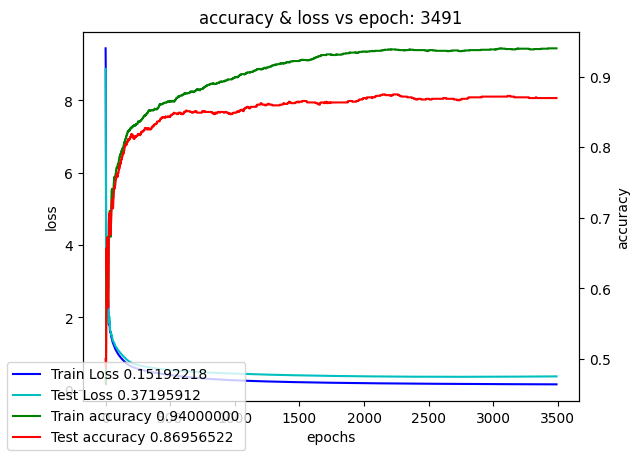

Training model color_cnn_single_kernel:  35%|███▌      | 3500/10000 [4:06:50<7:35:43,  4.21s/it]

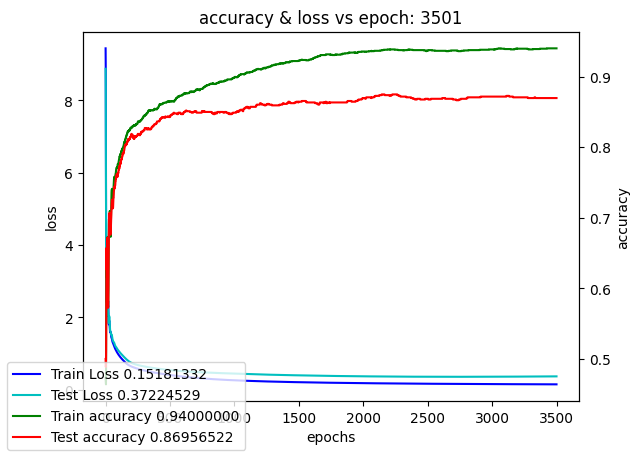

Training model color_cnn_single_kernel:  35%|███▌      | 3510/10000 [4:07:32<7:35:17,  4.21s/it]

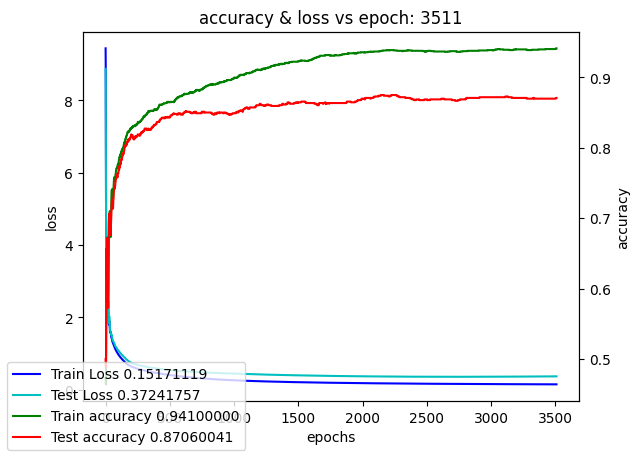

Training model color_cnn_single_kernel:  35%|███▌      | 3520/10000 [4:08:14<7:33:49,  4.20s/it]

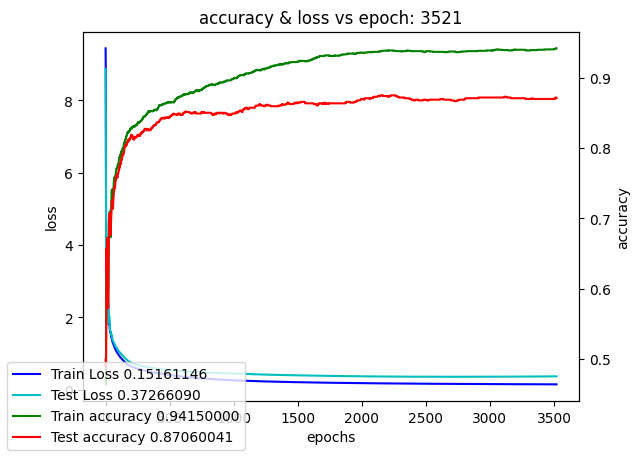

Training model color_cnn_single_kernel:  35%|███▌      | 3530/10000 [4:08:56<7:31:46,  4.19s/it]

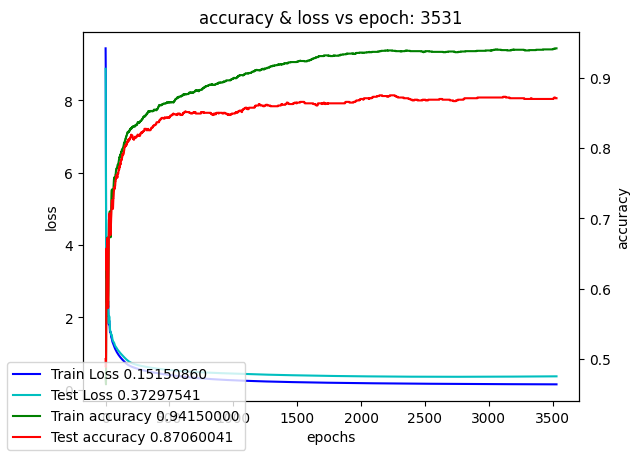

Training model color_cnn_single_kernel:  35%|███▌      | 3540/10000 [4:09:39<7:32:58,  4.21s/it]

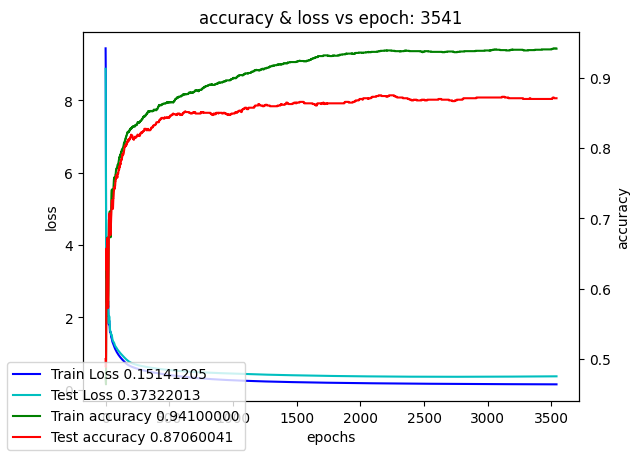

Training model color_cnn_single_kernel:  36%|███▌      | 3550/10000 [4:10:21<7:32:21,  4.21s/it]

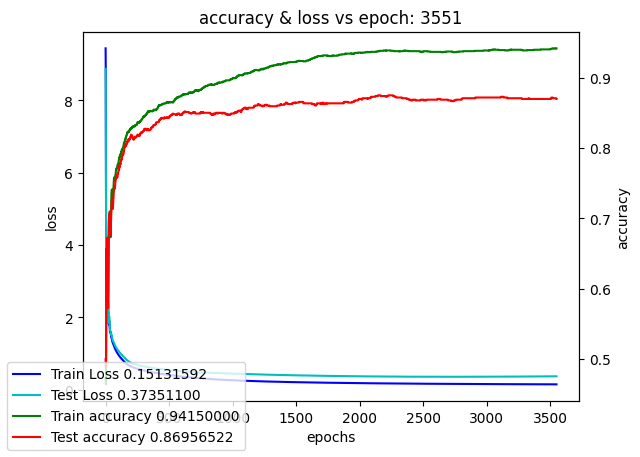

Training model color_cnn_single_kernel:  36%|███▌      | 3560/10000 [4:11:03<7:29:44,  4.19s/it]

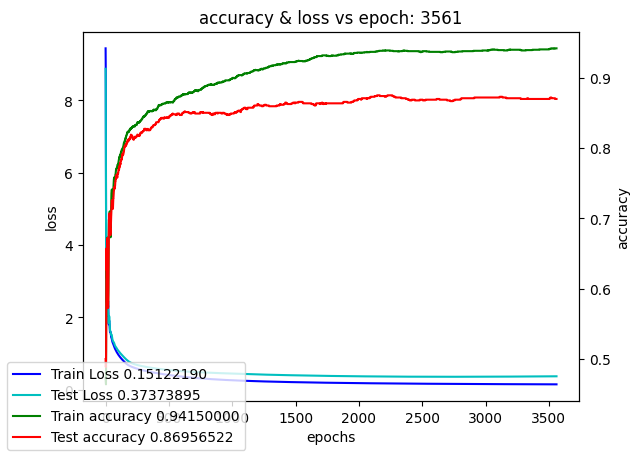

Training model color_cnn_single_kernel:  36%|███▌      | 3570/10000 [4:11:45<7:28:45,  4.19s/it]

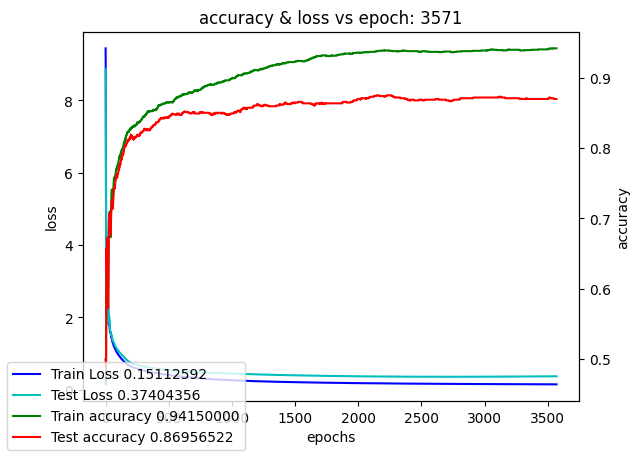

Training model color_cnn_single_kernel:  36%|███▌      | 3580/10000 [4:12:27<7:30:51,  4.21s/it]

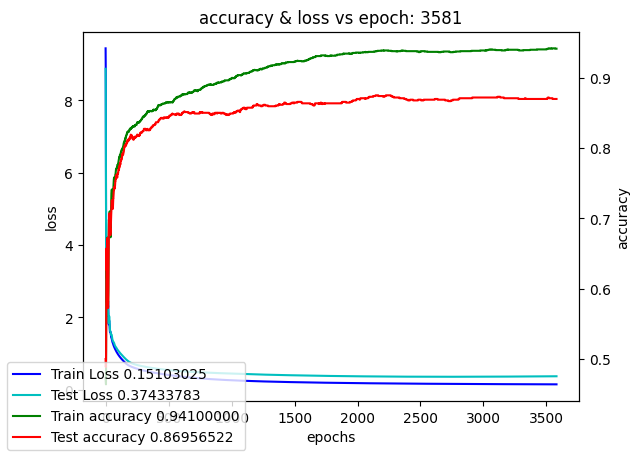

Training model color_cnn_single_kernel:  36%|███▌      | 3590/10000 [4:13:09<7:28:24,  4.20s/it]

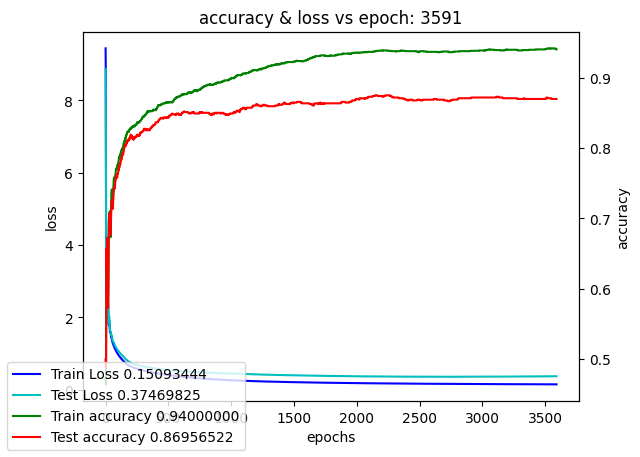

Training model color_cnn_single_kernel:  36%|███▌      | 3600/10000 [4:13:51<7:28:00,  4.20s/it]

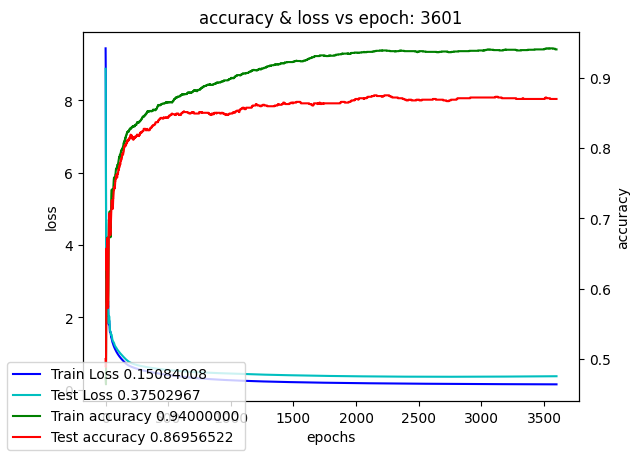

Training model color_cnn_single_kernel:  36%|███▌      | 3610/10000 [4:14:34<7:28:26,  4.21s/it]

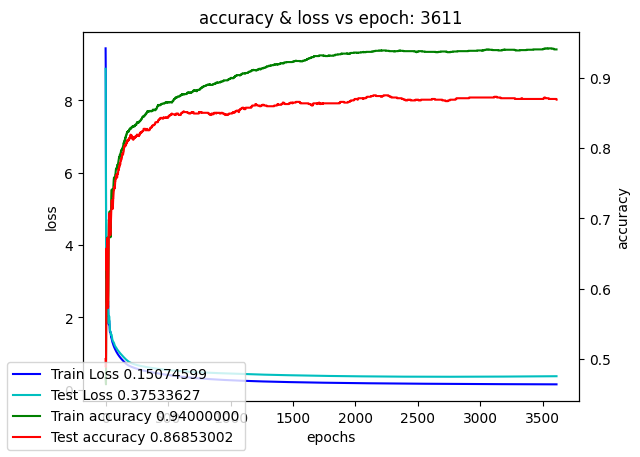

Training model color_cnn_single_kernel:  36%|███▌      | 3620/10000 [4:15:16<7:30:32,  4.24s/it]

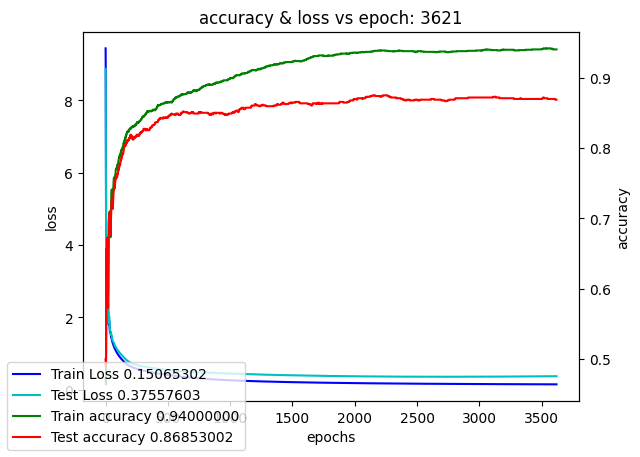

Training model color_cnn_single_kernel:  36%|███▋      | 3630/10000 [4:15:59<7:31:00,  4.25s/it]

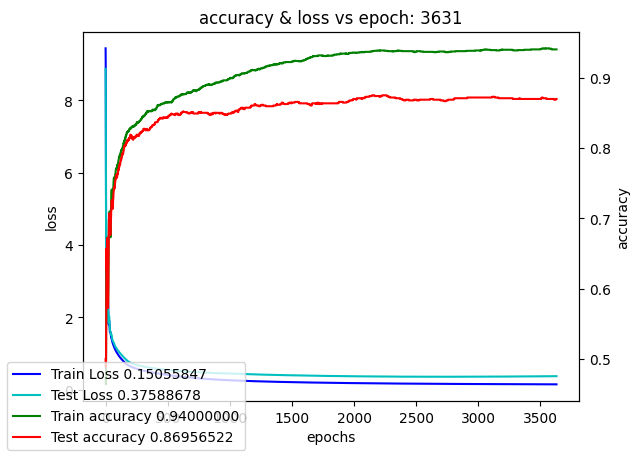

Training model color_cnn_single_kernel:  36%|███▋      | 3640/10000 [4:16:42<7:28:14,  4.23s/it]

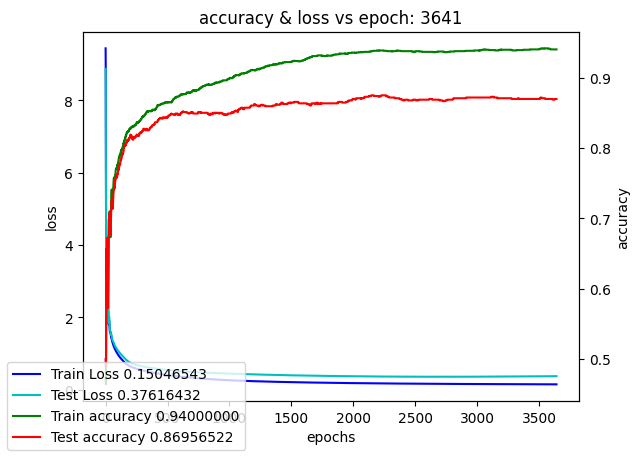

Training model color_cnn_single_kernel:  36%|███▋      | 3650/10000 [4:17:24<7:27:12,  4.23s/it]

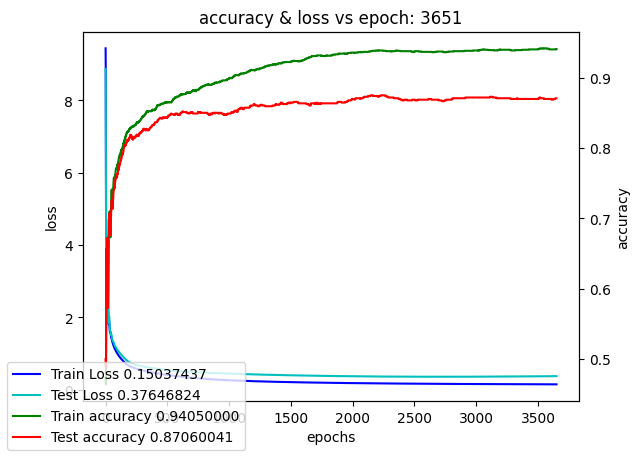

Training model color_cnn_single_kernel:  37%|███▋      | 3660/10000 [4:18:06<7:25:00,  4.21s/it]

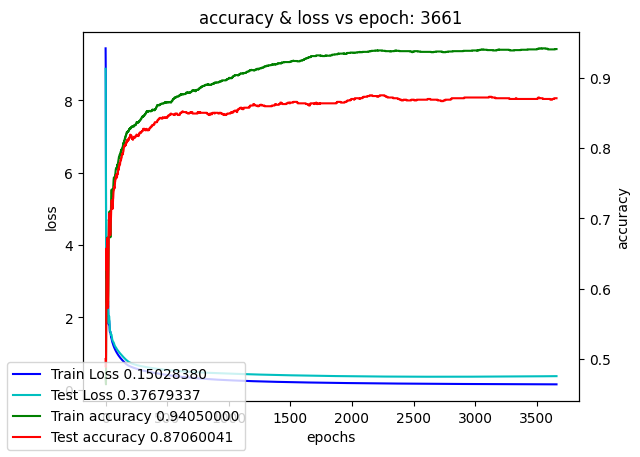

Training model color_cnn_single_kernel:  37%|███▋      | 3670/10000 [4:18:49<7:24:47,  4.22s/it]

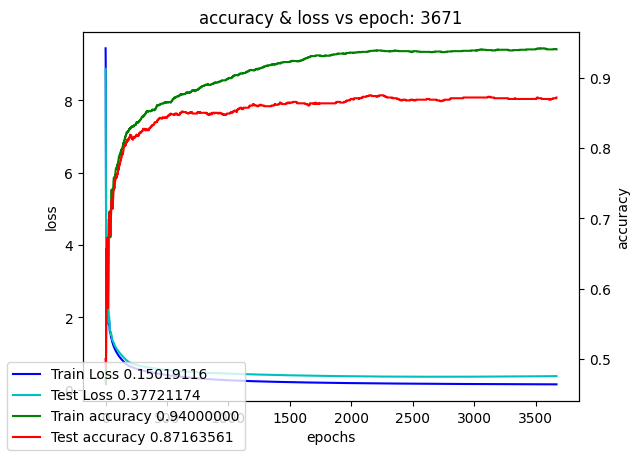

Training model color_cnn_single_kernel:  37%|███▋      | 3680/10000 [4:19:31<7:26:50,  4.24s/it]

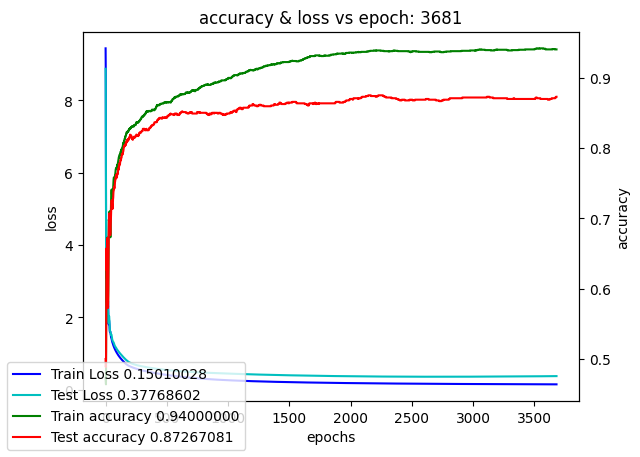

Training model color_cnn_single_kernel:  37%|███▋      | 3690/10000 [4:20:14<7:22:02,  4.20s/it]

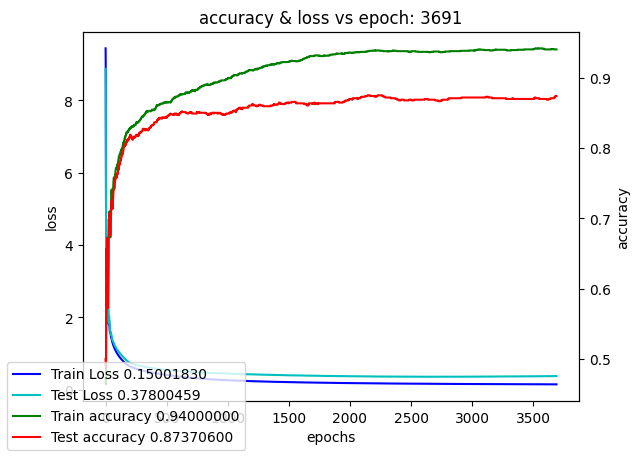

Training model color_cnn_single_kernel:  37%|███▋      | 3700/10000 [4:20:56<7:24:43,  4.24s/it]

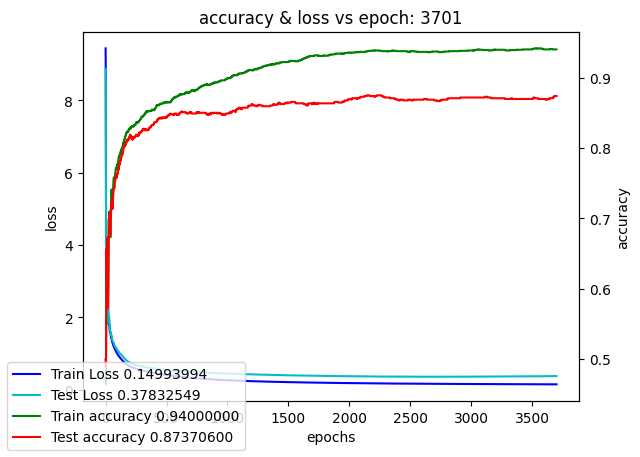

Training model color_cnn_single_kernel:  37%|███▋      | 3710/10000 [4:21:39<7:22:35,  4.22s/it]

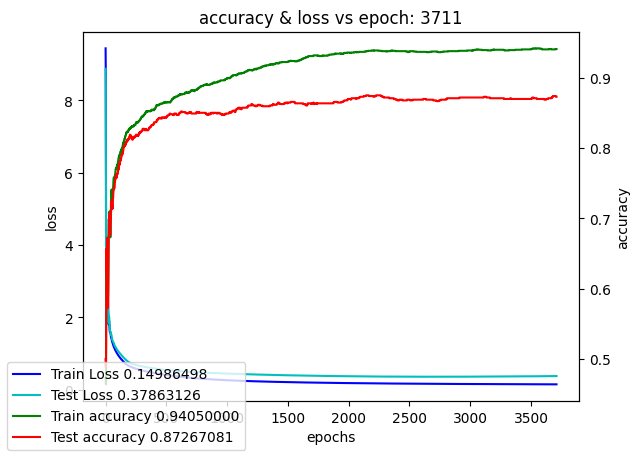

Training model color_cnn_single_kernel:  37%|███▋      | 3720/10000 [4:22:21<7:19:44,  4.20s/it]

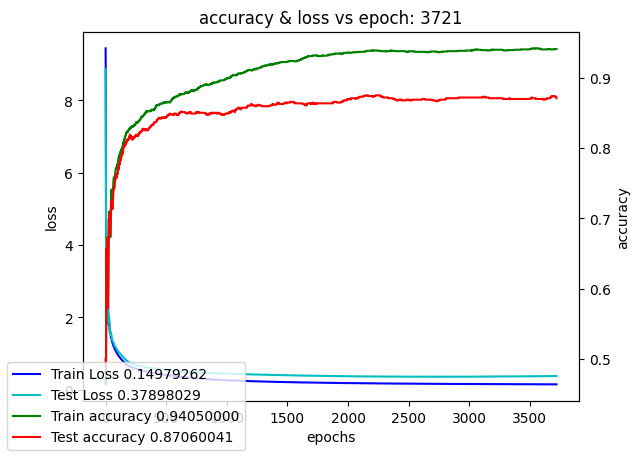

Training model color_cnn_single_kernel:  37%|███▋      | 3730/10000 [4:23:03<7:18:30,  4.20s/it]

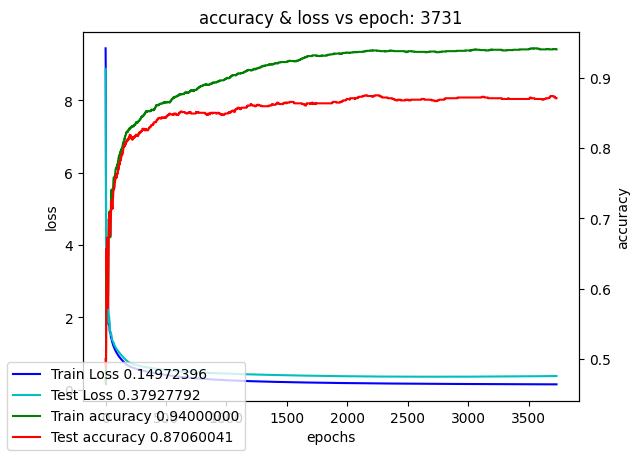

Training model color_cnn_single_kernel:  37%|███▋      | 3740/10000 [4:23:45<7:19:06,  4.21s/it]

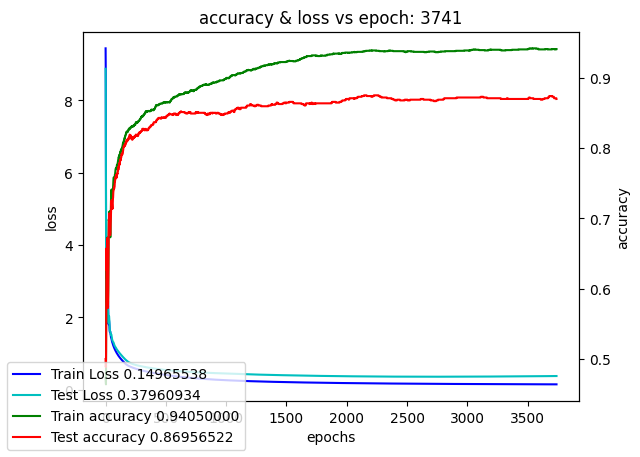

Training model color_cnn_single_kernel:  38%|███▊      | 3750/10000 [4:24:27<7:16:50,  4.19s/it]

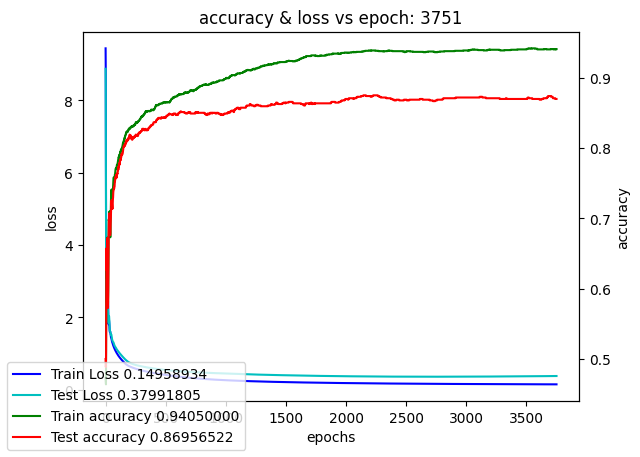

Training model color_cnn_single_kernel:  38%|███▊      | 3760/10000 [4:25:10<7:17:30,  4.21s/it]

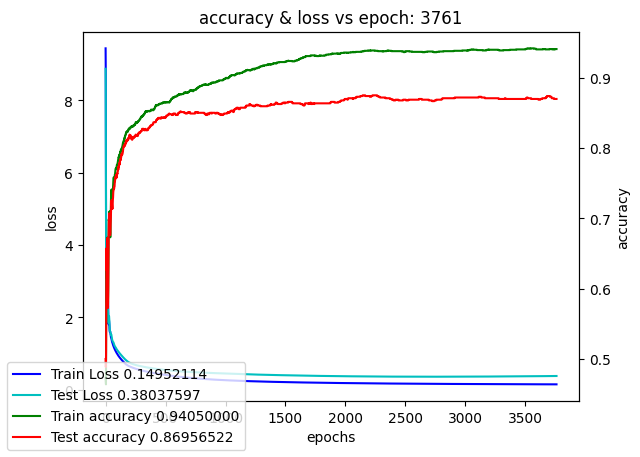

Training model color_cnn_single_kernel:  38%|███▊      | 3770/10000 [4:25:52<7:16:49,  4.21s/it]

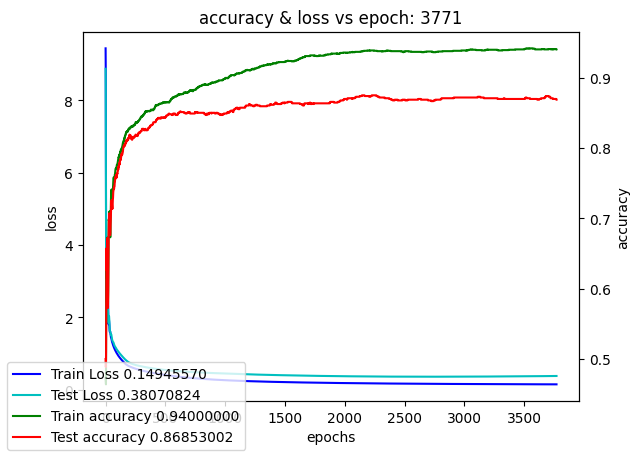

Training model color_cnn_single_kernel:  38%|███▊      | 3780/10000 [4:26:34<7:15:46,  4.20s/it]

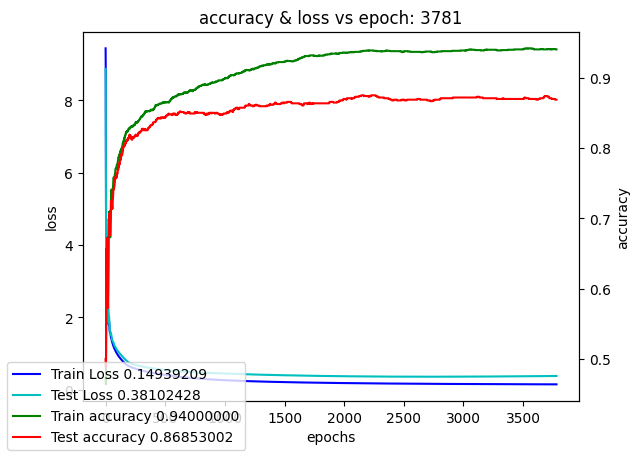

Training model color_cnn_single_kernel:  38%|███▊      | 3790/10000 [4:27:16<7:15:48,  4.21s/it]

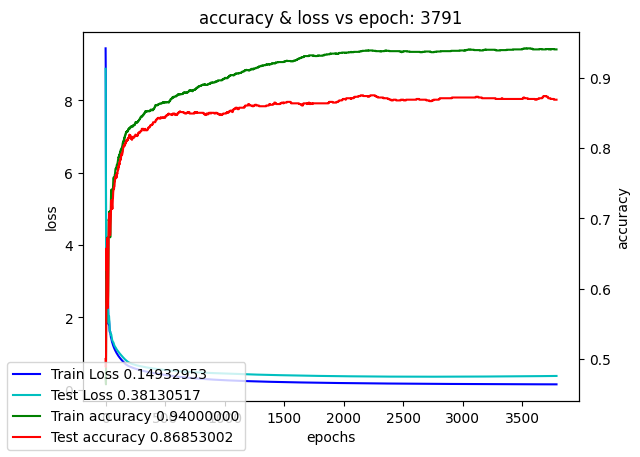

Training model color_cnn_single_kernel:  38%|███▊      | 3800/10000 [4:27:59<7:15:28,  4.21s/it]

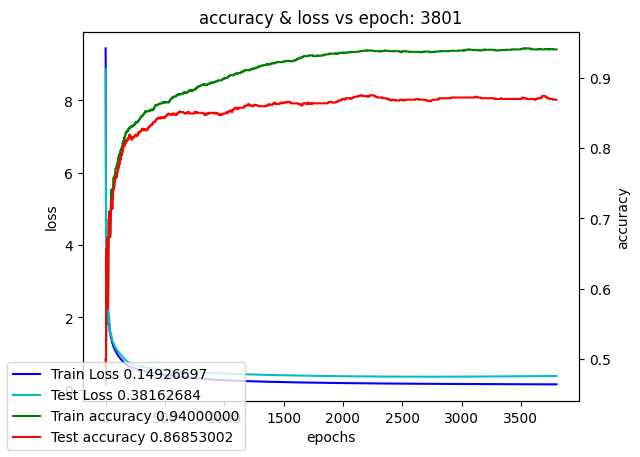

Training model color_cnn_single_kernel:  38%|███▊      | 3810/10000 [4:28:41<7:13:10,  4.20s/it]

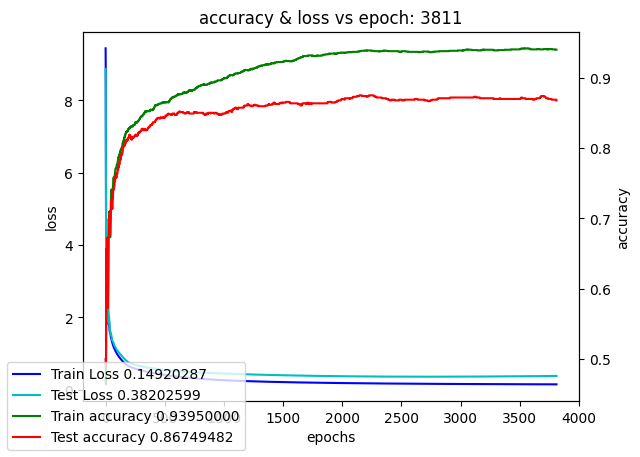

Training model color_cnn_single_kernel:  38%|███▊      | 3820/10000 [4:29:23<7:13:05,  4.20s/it]

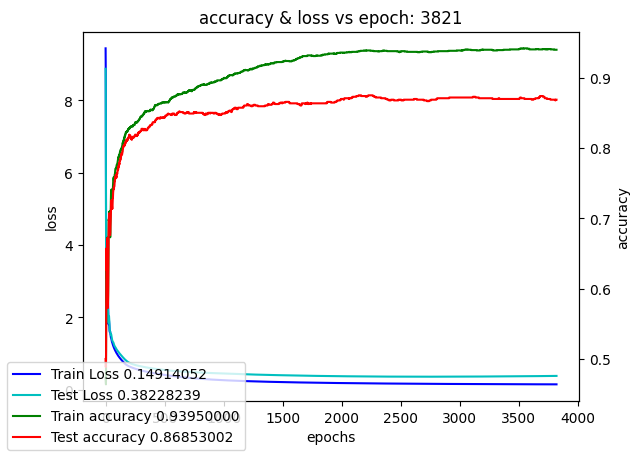

Training model color_cnn_single_kernel:  38%|███▊      | 3830/10000 [4:30:06<7:14:20,  4.22s/it]

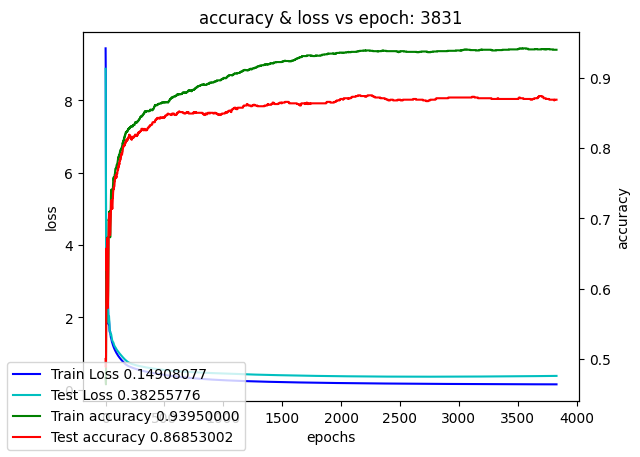

Training model color_cnn_single_kernel:  38%|███▊      | 3840/10000 [4:30:48<7:15:53,  4.25s/it]

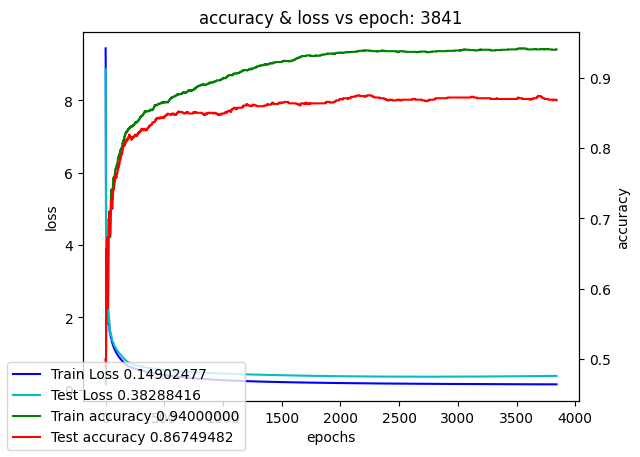

Training model color_cnn_single_kernel:  38%|███▊      | 3850/10000 [4:31:31<7:16:01,  4.25s/it]

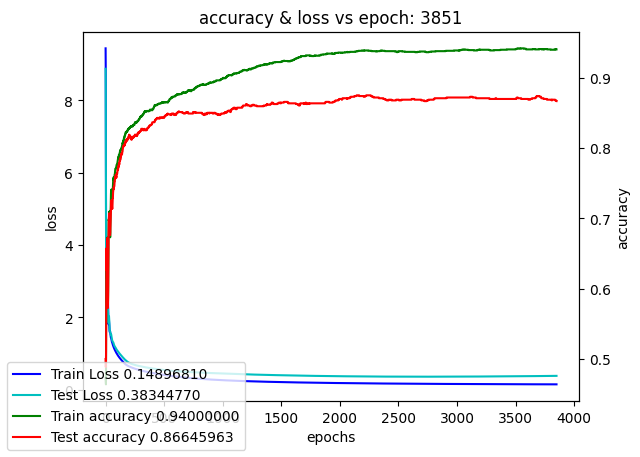

Training model color_cnn_single_kernel:  39%|███▊      | 3860/10000 [4:32:14<7:13:44,  4.24s/it]

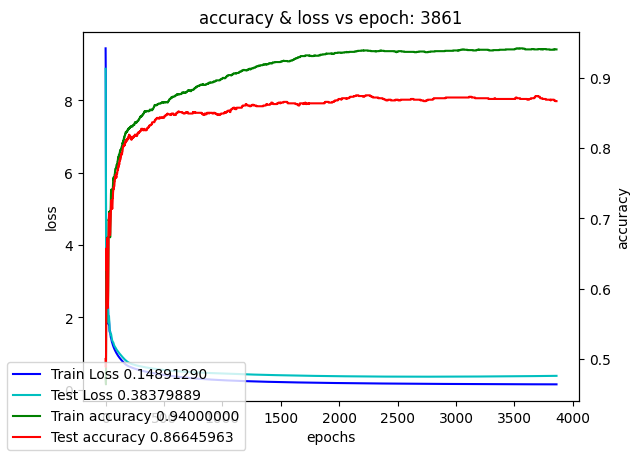

Training model color_cnn_single_kernel:  39%|███▊      | 3870/10000 [4:32:56<7:14:39,  4.25s/it]

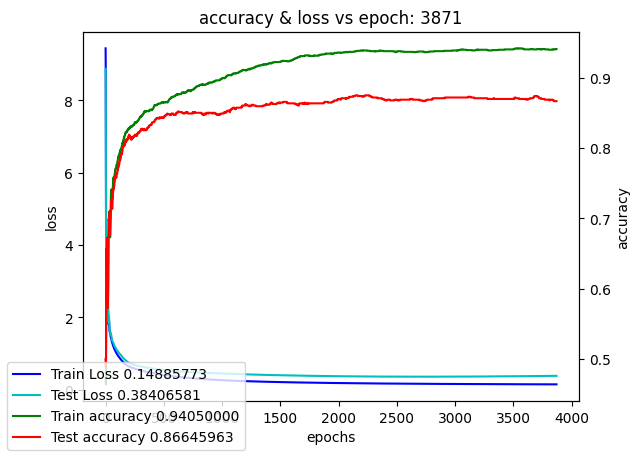

Training model color_cnn_single_kernel:  39%|███▉      | 3880/10000 [4:33:39<7:10:30,  4.22s/it]

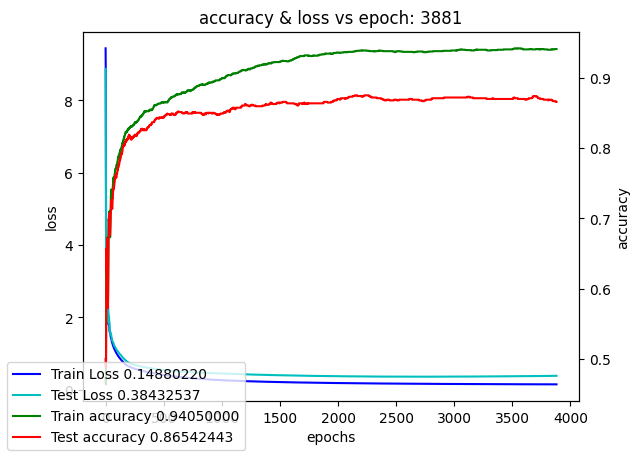

Training model color_cnn_single_kernel:  39%|███▉      | 3890/10000 [4:34:22<7:13:23,  4.26s/it]

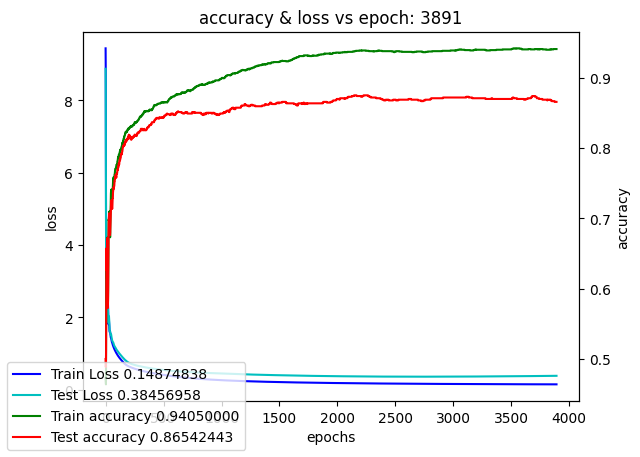

Training model color_cnn_single_kernel:  39%|███▉      | 3900/10000 [4:35:04<7:08:23,  4.21s/it]

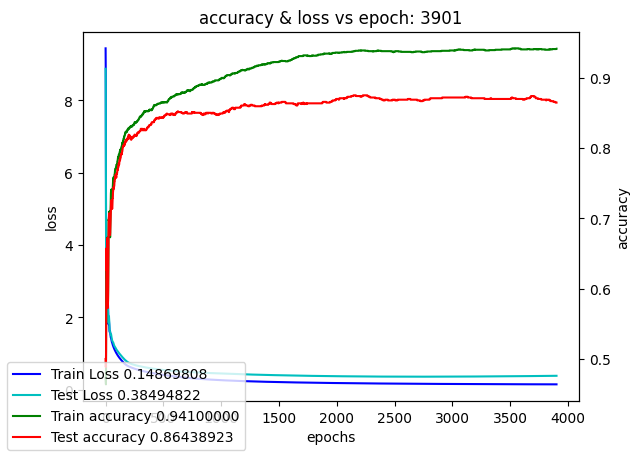

Training model color_cnn_single_kernel:  39%|███▉      | 3910/10000 [4:35:47<7:10:27,  4.24s/it]

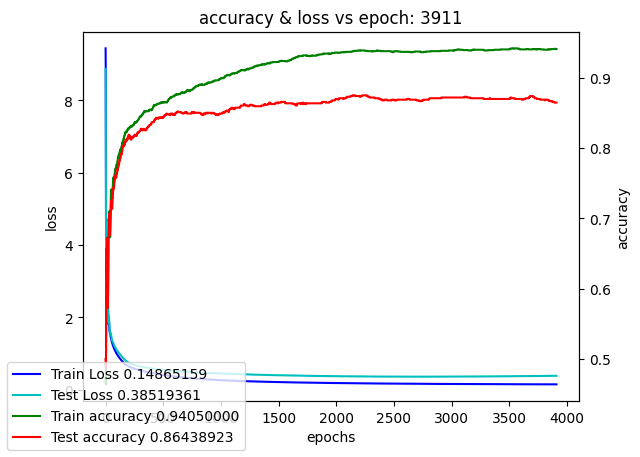

Training model color_cnn_single_kernel:  39%|███▉      | 3920/10000 [4:36:29<7:07:37,  4.22s/it]

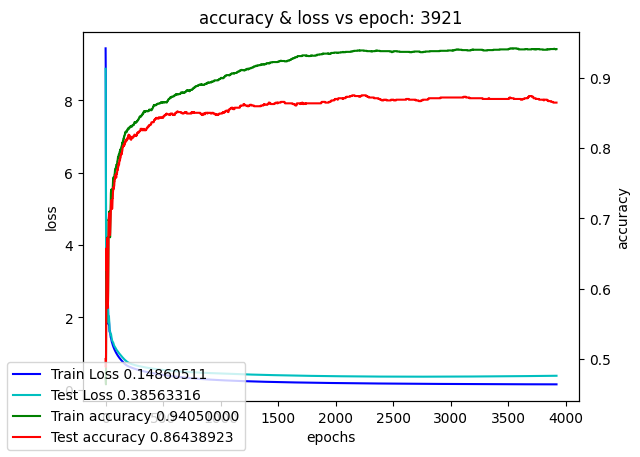

Training model color_cnn_single_kernel:  39%|███▉      | 3930/10000 [4:37:11<7:06:05,  4.21s/it]

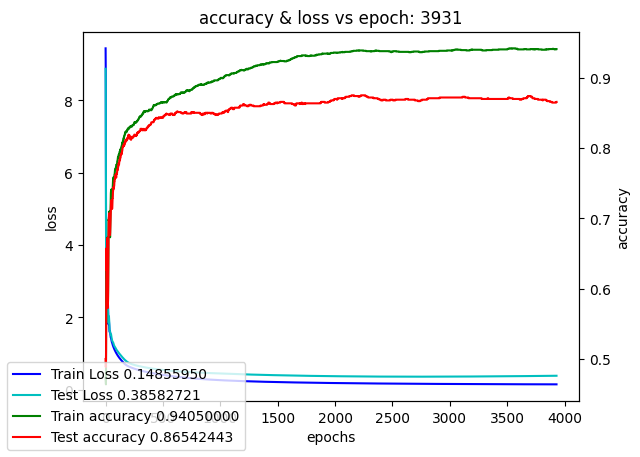

Training model color_cnn_single_kernel:  39%|███▉      | 3940/10000 [4:37:54<7:04:34,  4.20s/it]

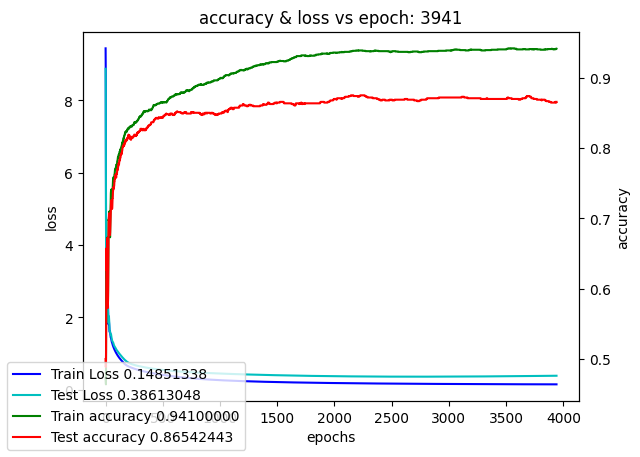

Training model color_cnn_single_kernel:  40%|███▉      | 3950/10000 [4:38:36<7:04:05,  4.21s/it]

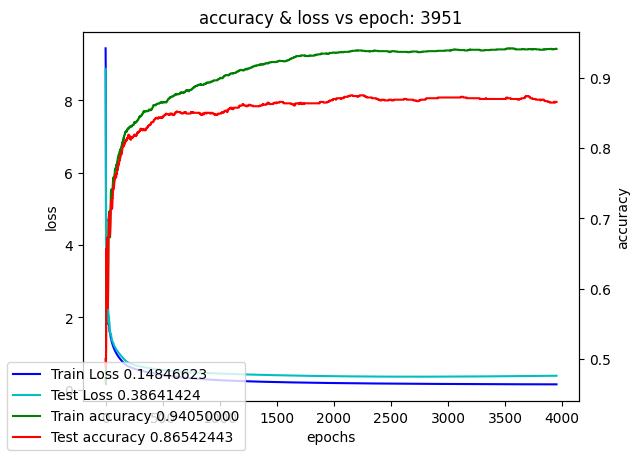

Training model color_cnn_single_kernel:  40%|███▉      | 3960/10000 [4:39:18<7:00:43,  4.18s/it]

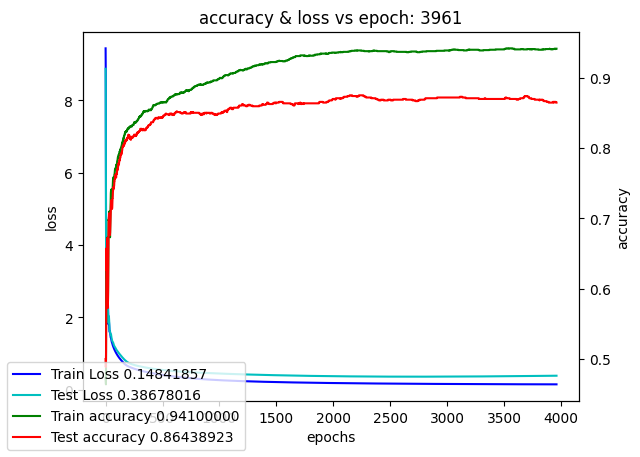

Training model color_cnn_single_kernel:  40%|███▉      | 3970/10000 [4:40:00<7:01:08,  4.19s/it]

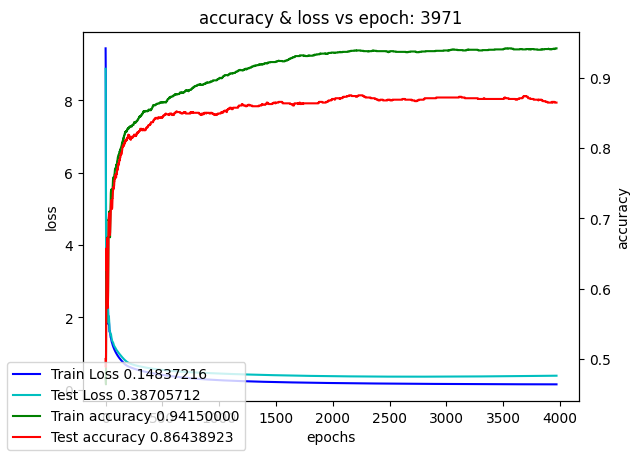

Training model color_cnn_single_kernel:  40%|███▉      | 3980/10000 [4:40:42<7:04:07,  4.23s/it]

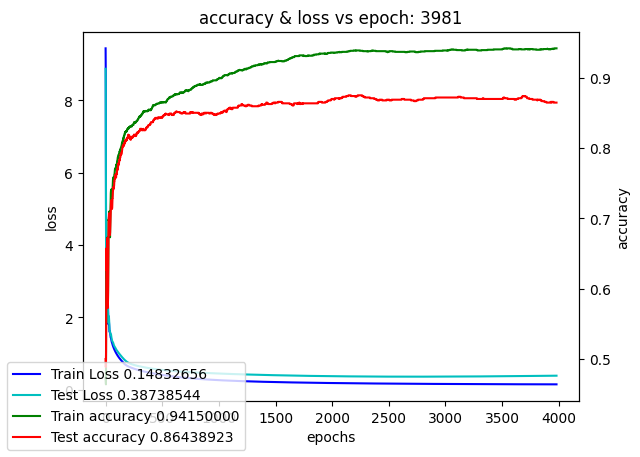

Training model color_cnn_single_kernel:  40%|███▉      | 3990/10000 [4:41:25<7:01:50,  4.21s/it]

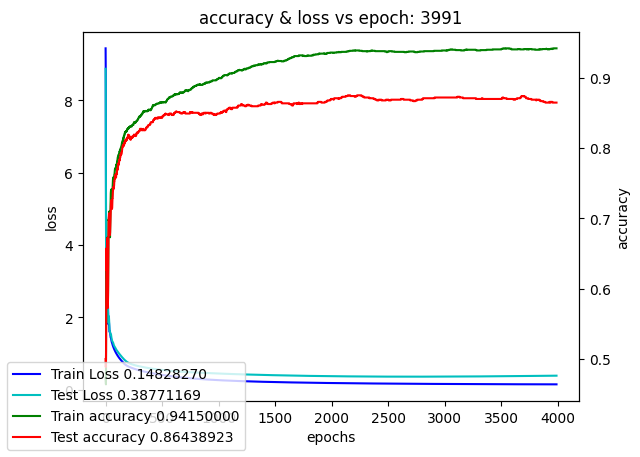

Training model color_cnn_single_kernel:  40%|████      | 4000/10000 [4:42:07<7:04:17,  4.24s/it]

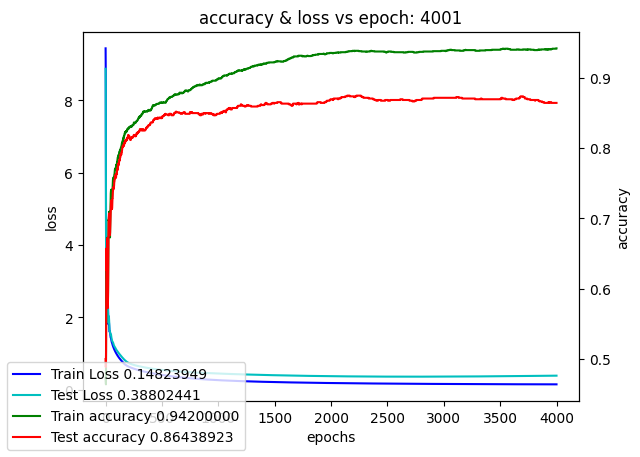

Training model color_cnn_single_kernel:  40%|████      | 4010/10000 [4:42:50<7:00:15,  4.21s/it]

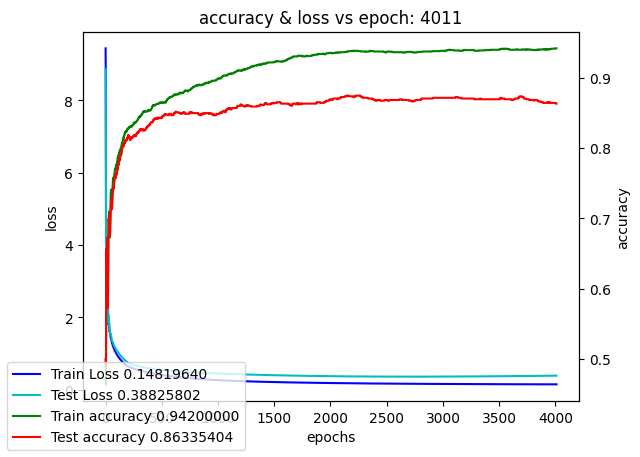

Training model color_cnn_single_kernel:  40%|████      | 4020/10000 [4:43:32<6:57:42,  4.19s/it]

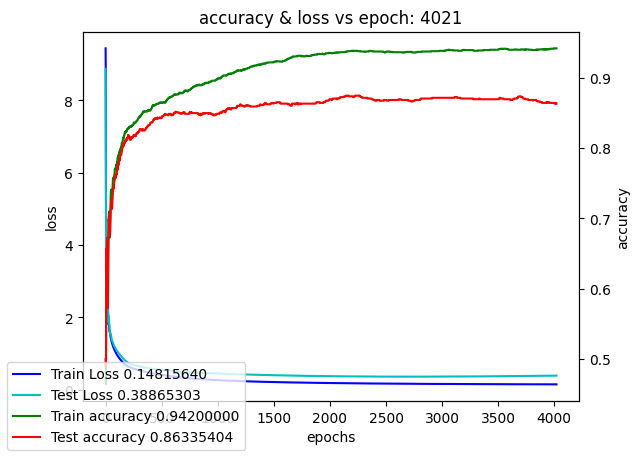

Training model color_cnn_single_kernel:  40%|████      | 4030/10000 [4:44:14<6:56:37,  4.19s/it]

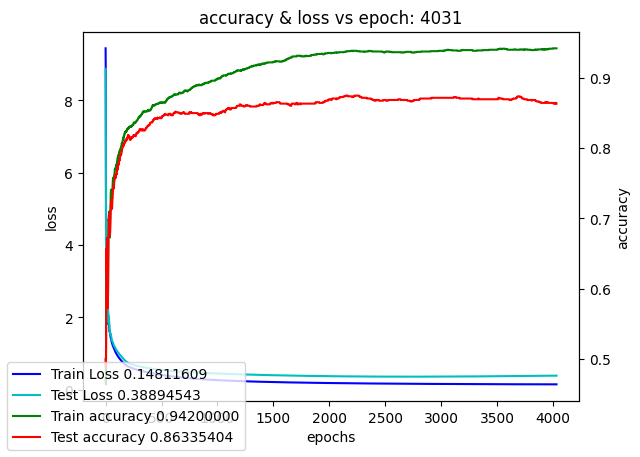

Training model color_cnn_single_kernel:  40%|████      | 4040/10000 [4:44:57<6:59:31,  4.22s/it]

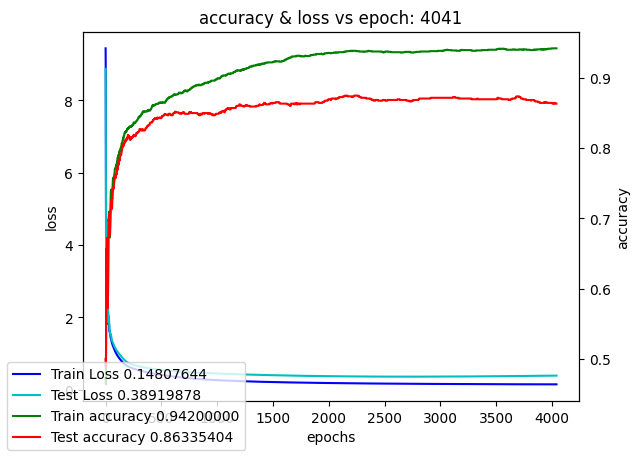

Training model color_cnn_single_kernel:  40%|████      | 4050/10000 [4:45:39<6:58:30,  4.22s/it]

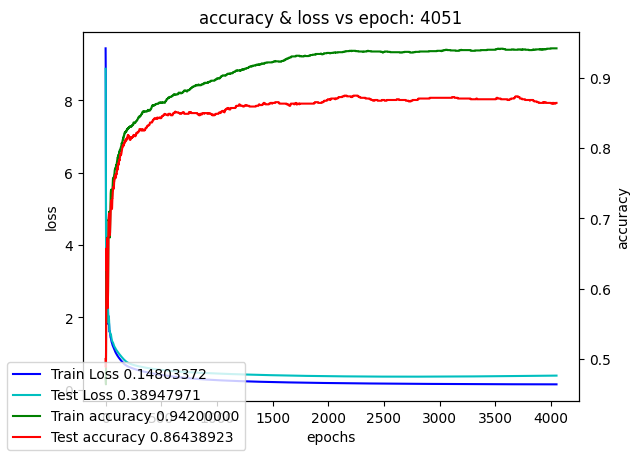

Training model color_cnn_single_kernel:  41%|████      | 4060/10000 [4:46:22<7:01:40,  4.26s/it]

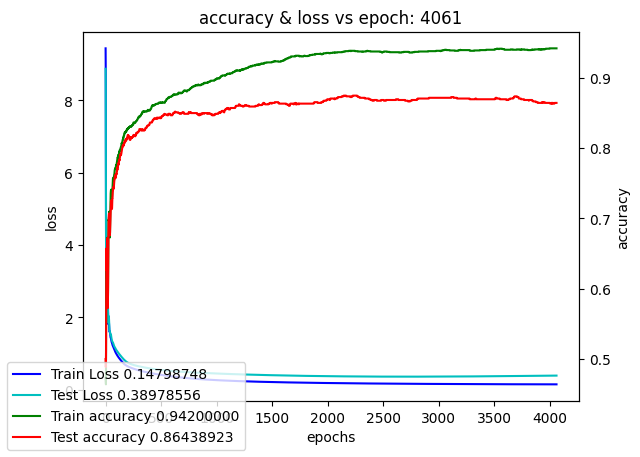

Training model color_cnn_single_kernel:  41%|████      | 4070/10000 [4:47:04<6:57:17,  4.22s/it]

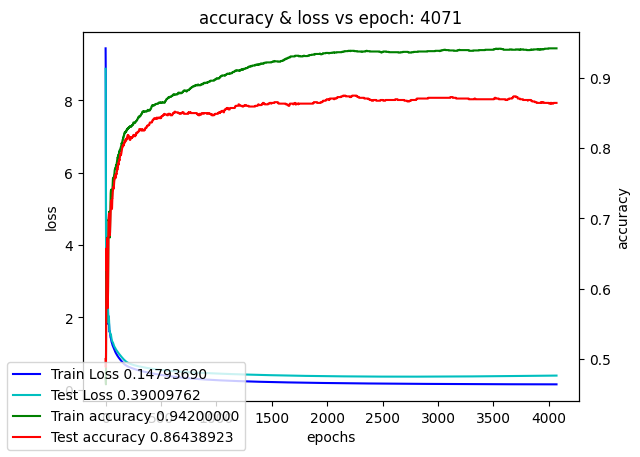

Training model color_cnn_single_kernel:  41%|████      | 4080/10000 [4:47:46<6:55:14,  4.21s/it]

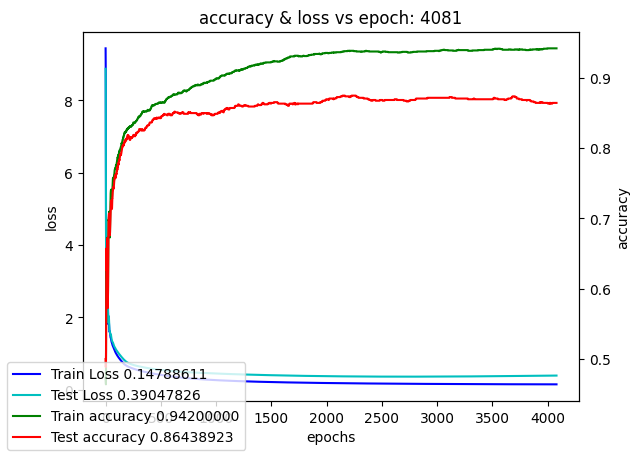

Training model color_cnn_single_kernel:  41%|████      | 4090/10000 [4:48:29<6:59:15,  4.26s/it]

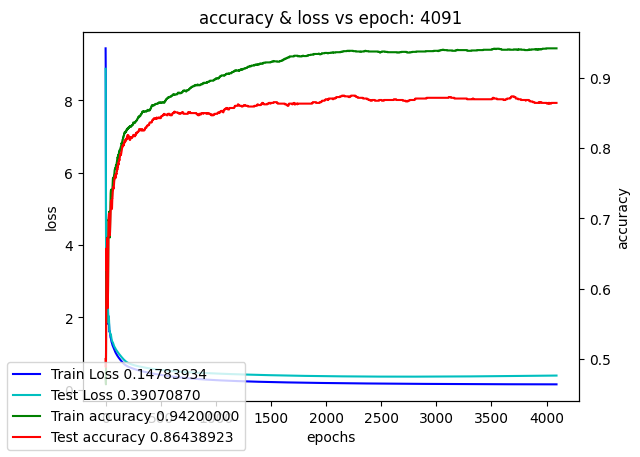

Training model color_cnn_single_kernel:  41%|████      | 4100/10000 [4:49:12<6:57:41,  4.25s/it]

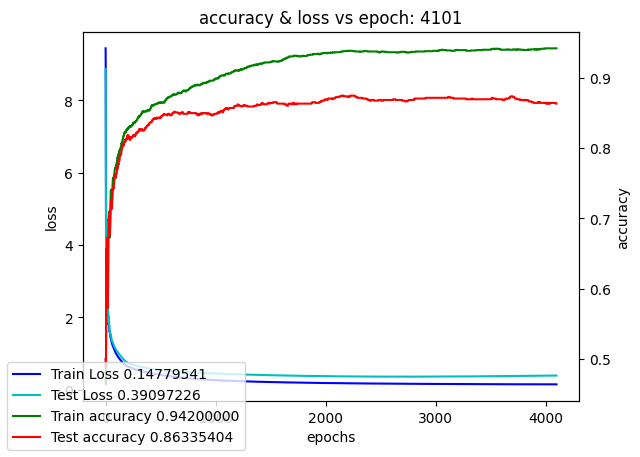

Training model color_cnn_single_kernel:  41%|████      | 4110/10000 [4:49:55<7:00:29,  4.28s/it]

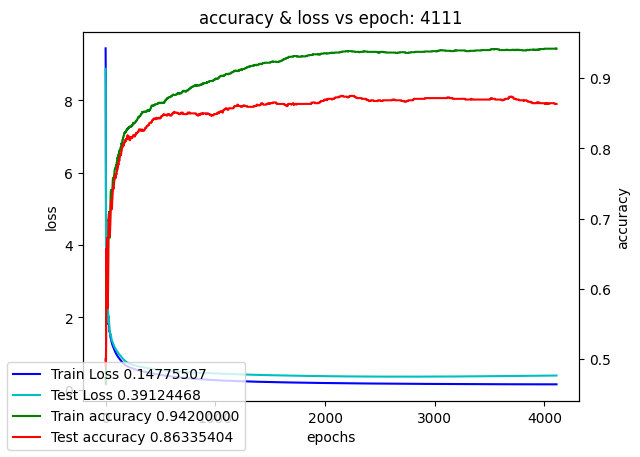

Training model color_cnn_single_kernel:  41%|████      | 4120/10000 [4:50:38<7:01:12,  4.30s/it]

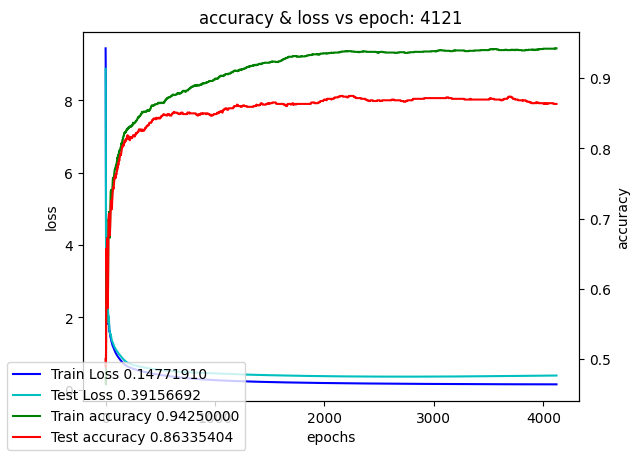

Training model color_cnn_single_kernel:  41%|████▏     | 4130/10000 [4:51:20<6:51:24,  4.21s/it]

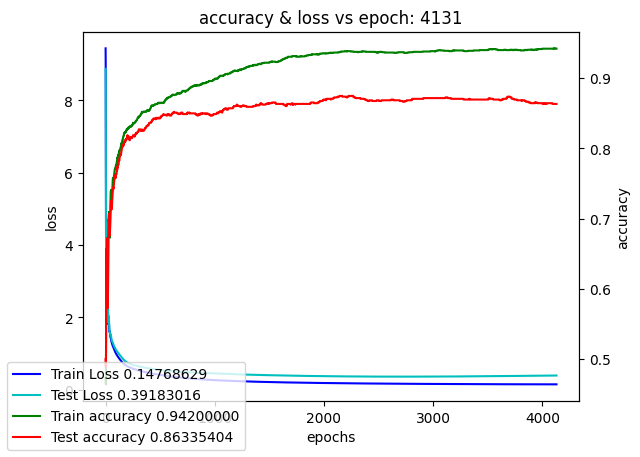

Training model color_cnn_single_kernel:  41%|████▏     | 4140/10000 [4:52:03<6:50:33,  4.20s/it]

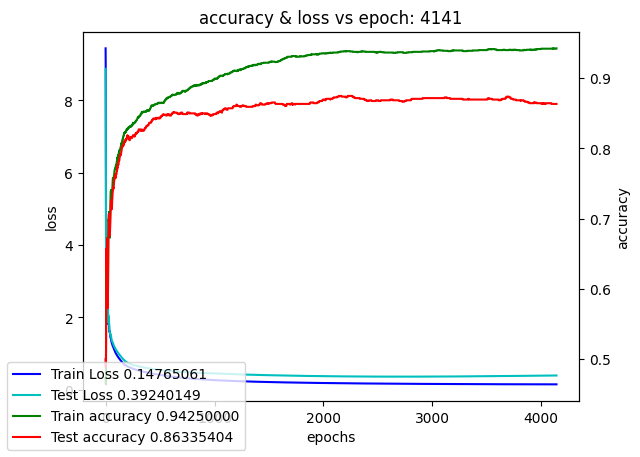

Training model color_cnn_single_kernel:  42%|████▏     | 4150/10000 [4:52:45<6:49:20,  4.20s/it]

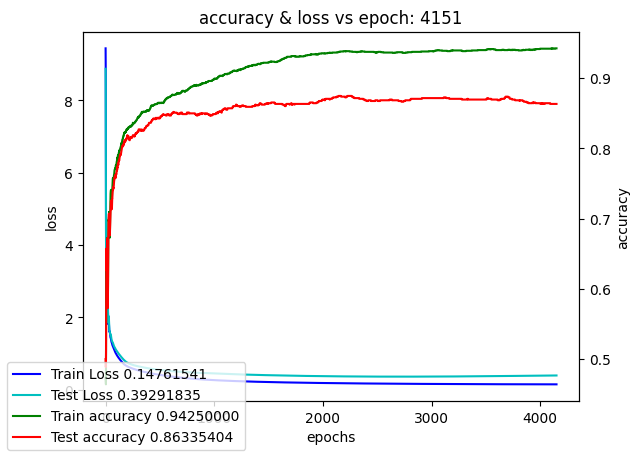

Training model color_cnn_single_kernel:  42%|████▏     | 4160/10000 [4:53:27<6:48:24,  4.20s/it]

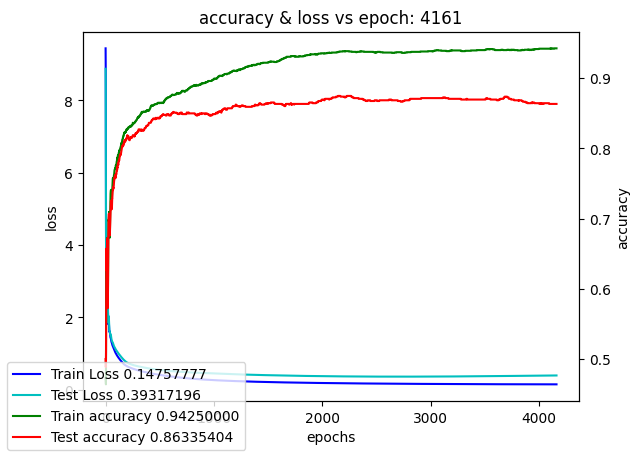

Training model color_cnn_single_kernel:  42%|████▏     | 4170/10000 [4:54:09<6:47:49,  4.20s/it]

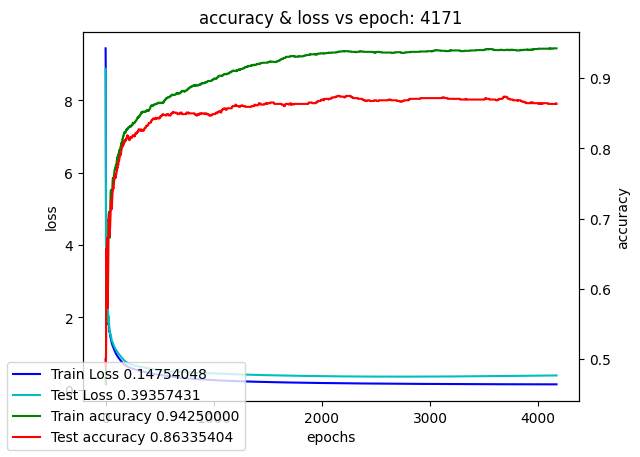

Training model color_cnn_single_kernel:  42%|████▏     | 4180/10000 [4:54:51<6:47:10,  4.20s/it]

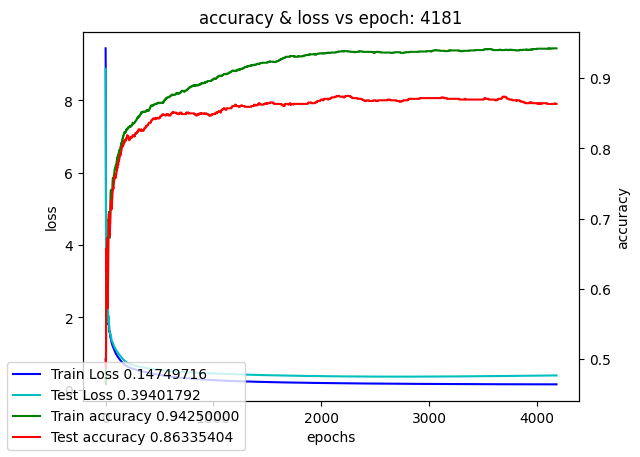

Training model color_cnn_single_kernel:  42%|████▏     | 4190/10000 [4:55:33<6:43:42,  4.17s/it]

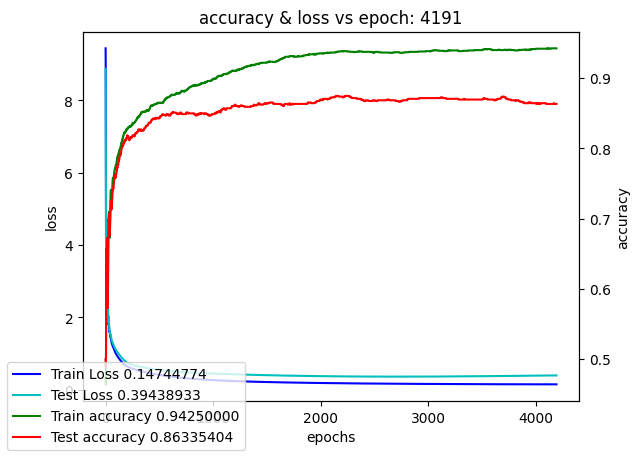

Training model color_cnn_single_kernel:  42%|████▏     | 4200/10000 [4:56:15<6:47:34,  4.22s/it]

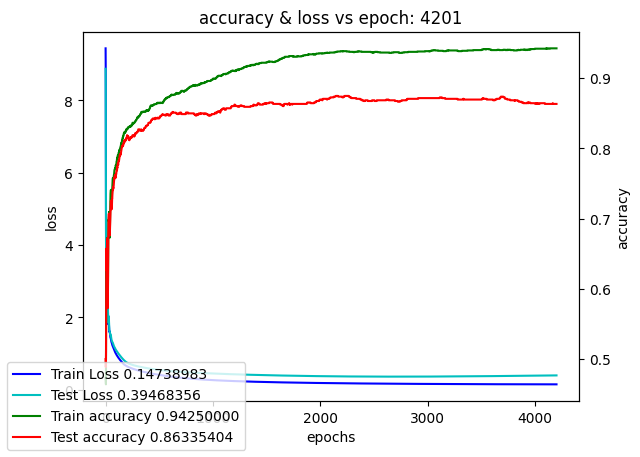

Training model color_cnn_single_kernel:  42%|████▏     | 4210/10000 [4:56:58<6:45:32,  4.20s/it]

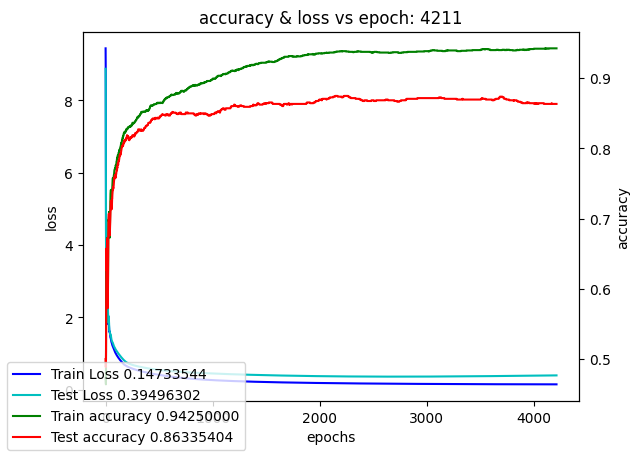

Training model color_cnn_single_kernel:  42%|████▏     | 4220/10000 [4:57:40<6:45:15,  4.21s/it]

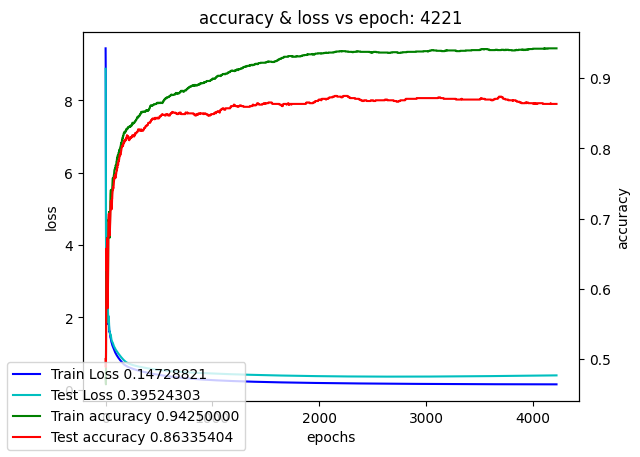

Training model color_cnn_single_kernel:  42%|████▏     | 4230/10000 [4:58:22<6:43:38,  4.20s/it]

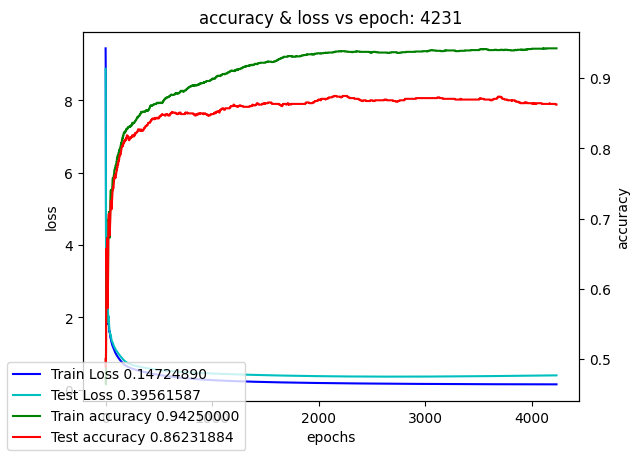

Training model color_cnn_single_kernel:  42%|████▏     | 4240/10000 [4:59:04<6:43:33,  4.20s/it]

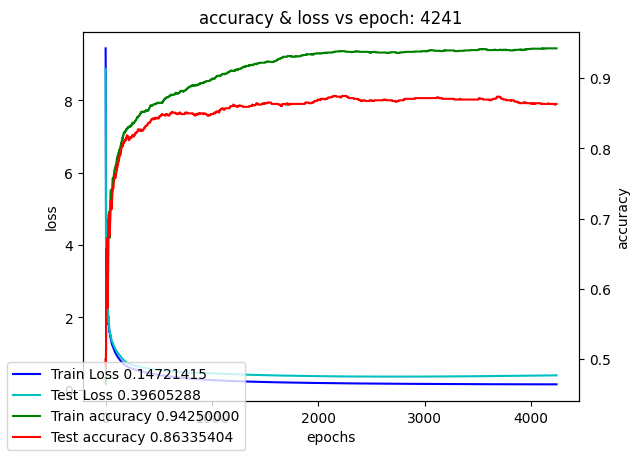

Training model color_cnn_single_kernel:  42%|████▎     | 4250/10000 [4:59:47<6:45:05,  4.23s/it]

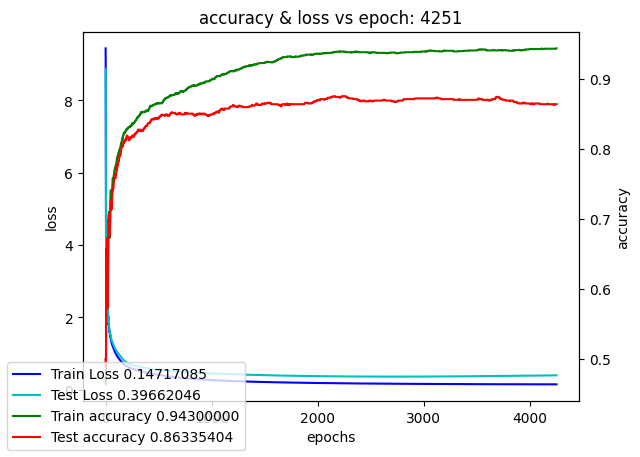

Training model color_cnn_single_kernel:  43%|████▎     | 4260/10000 [5:00:29<6:43:40,  4.22s/it]

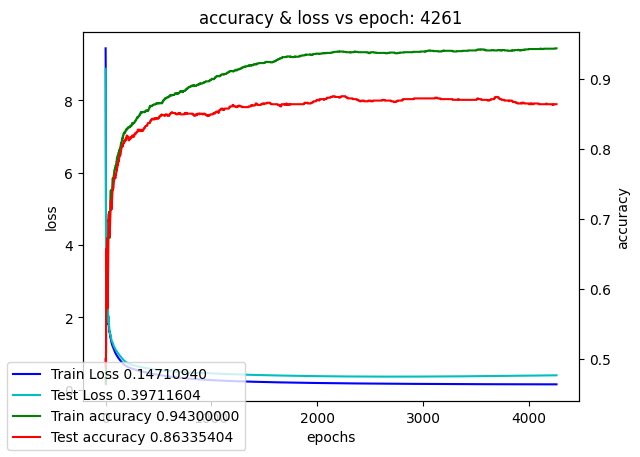

Training model color_cnn_single_kernel:  43%|████▎     | 4270/10000 [5:01:12<6:43:14,  4.22s/it]

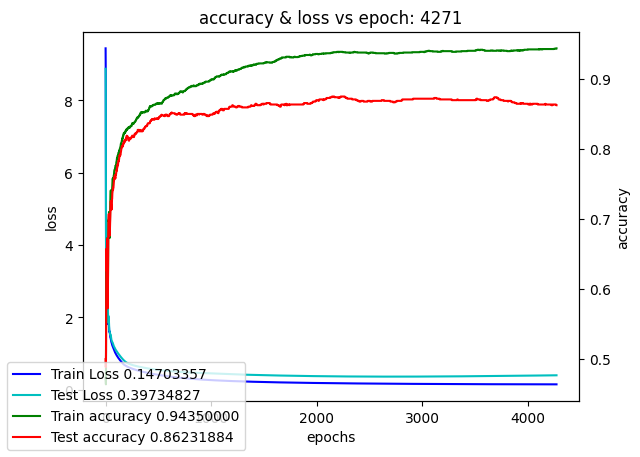

Training model color_cnn_single_kernel:  43%|████▎     | 4280/10000 [5:01:54<6:43:56,  4.24s/it]

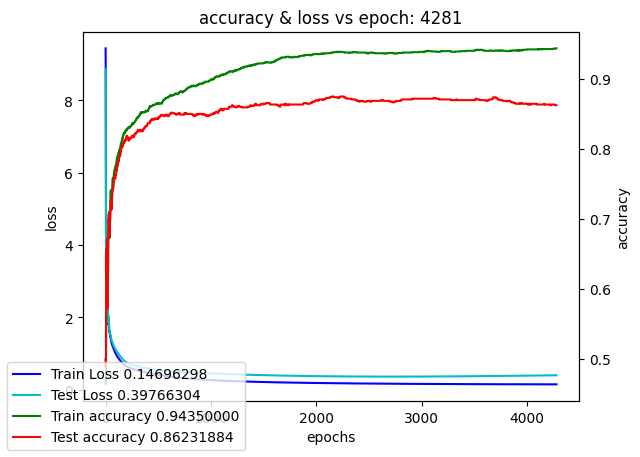

Training model color_cnn_single_kernel:  43%|████▎     | 4290/10000 [5:02:37<6:43:51,  4.24s/it]

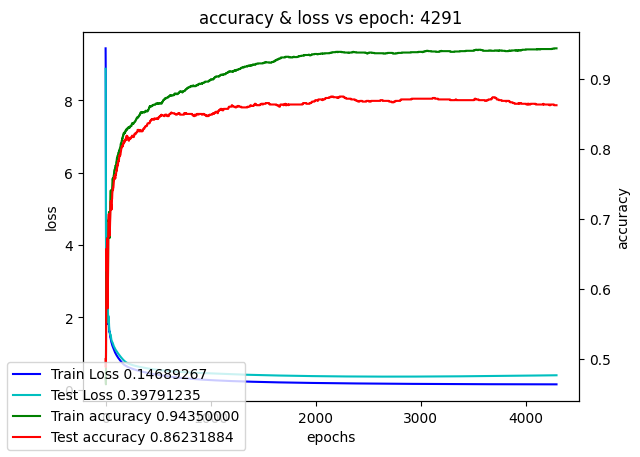

Training model color_cnn_single_kernel:  43%|████▎     | 4300/10000 [5:03:19<6:42:47,  4.24s/it]

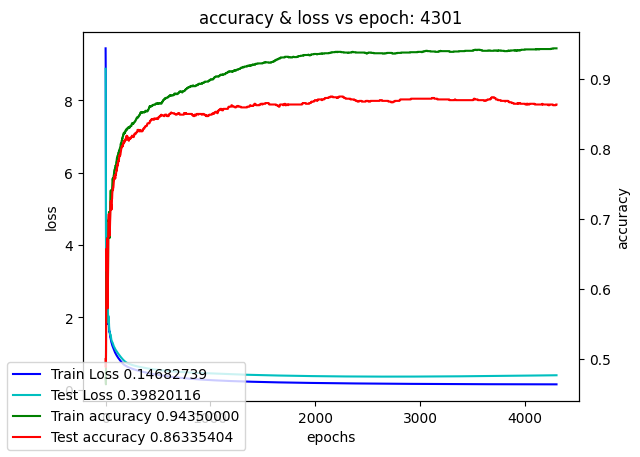

Training model color_cnn_single_kernel:  43%|████▎     | 4310/10000 [5:04:02<6:43:08,  4.25s/it]

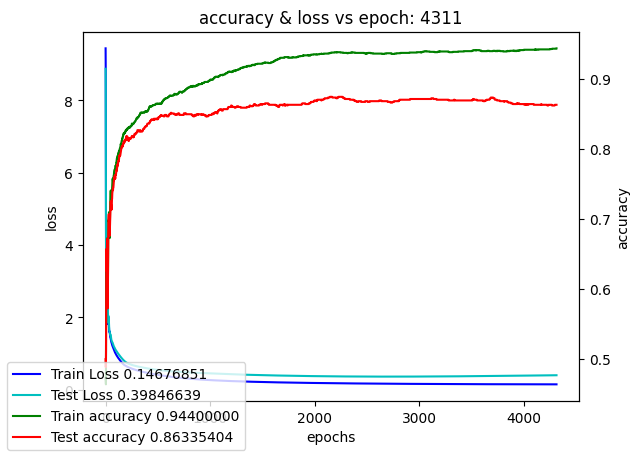

Training model color_cnn_single_kernel:  43%|████▎     | 4320/10000 [5:04:44<6:39:19,  4.22s/it]

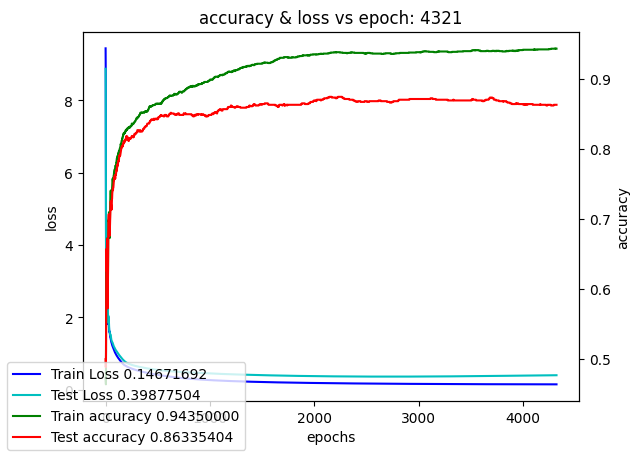

Training model color_cnn_single_kernel:  43%|████▎     | 4330/10000 [5:05:27<6:40:13,  4.24s/it]

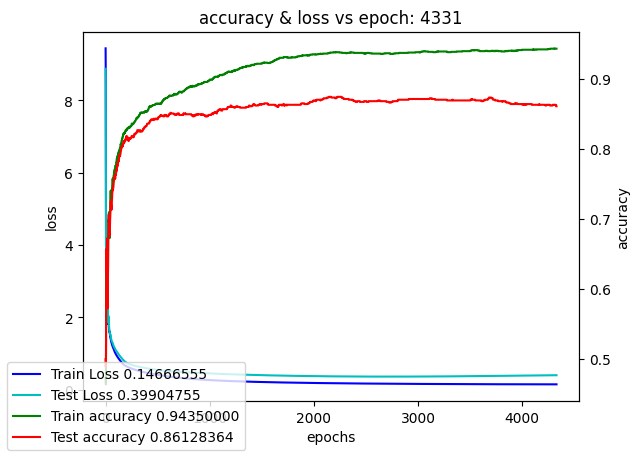

Training model color_cnn_single_kernel:  43%|████▎     | 4340/10000 [5:06:09<6:35:07,  4.19s/it]

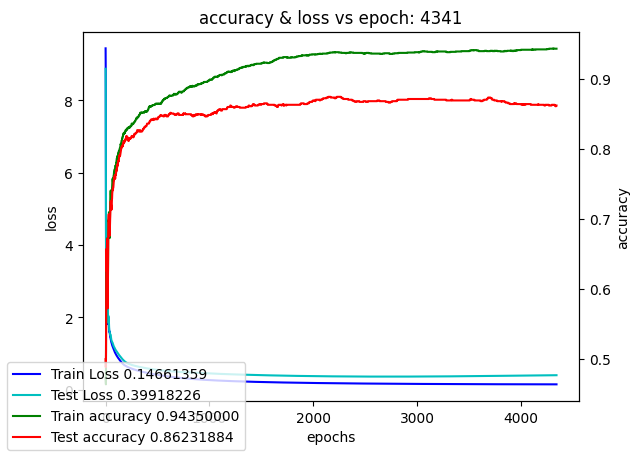

Training model color_cnn_single_kernel:  44%|████▎     | 4350/10000 [5:06:51<6:34:55,  4.19s/it]

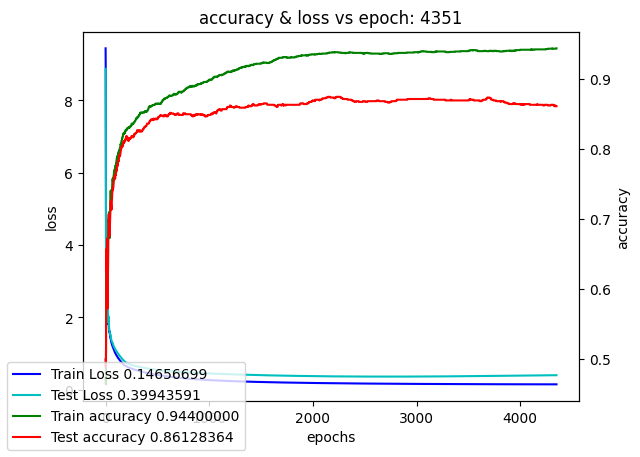

Training model color_cnn_single_kernel:  44%|████▎     | 4360/10000 [5:07:33<6:33:15,  4.18s/it]

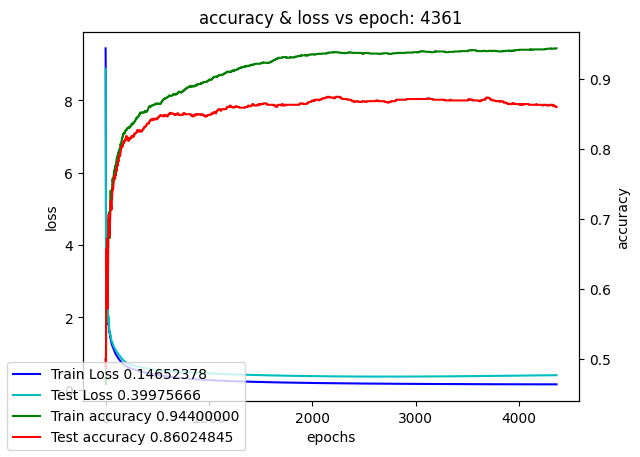

Training model color_cnn_single_kernel:  44%|████▎     | 4370/10000 [5:08:15<6:33:17,  4.19s/it]

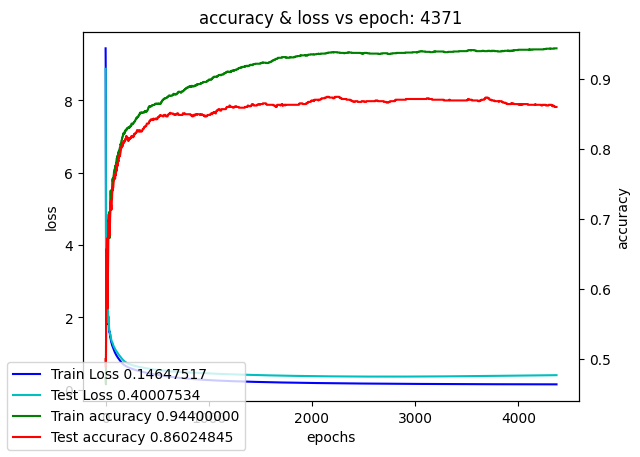

Training model color_cnn_single_kernel:  44%|████▍     | 4380/10000 [5:08:57<6:31:32,  4.18s/it]

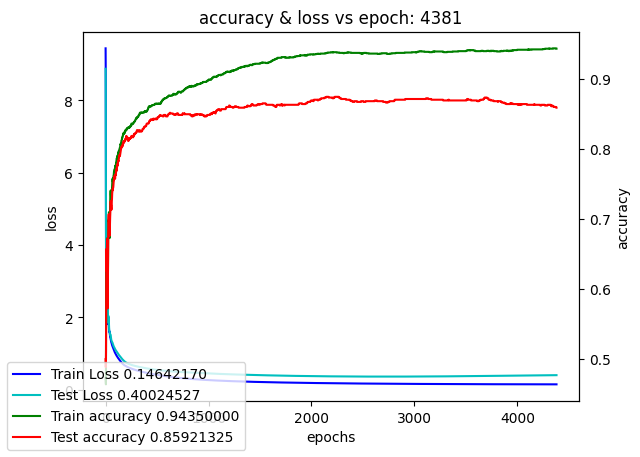

Training model color_cnn_single_kernel:  44%|████▍     | 4390/10000 [5:09:39<6:32:47,  4.20s/it]

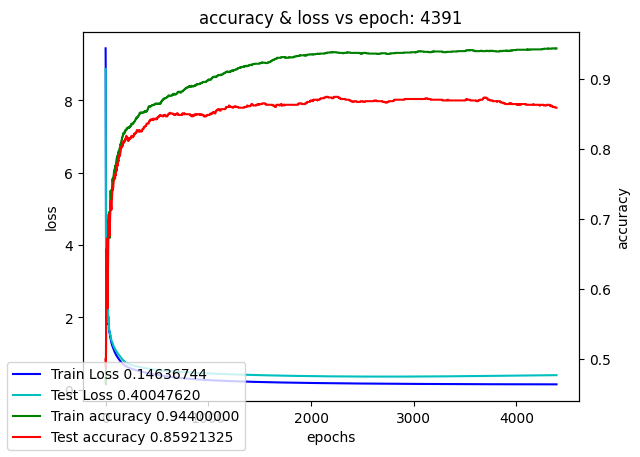

Training model color_cnn_single_kernel:  44%|████▍     | 4400/10000 [5:10:22<6:32:31,  4.21s/it]

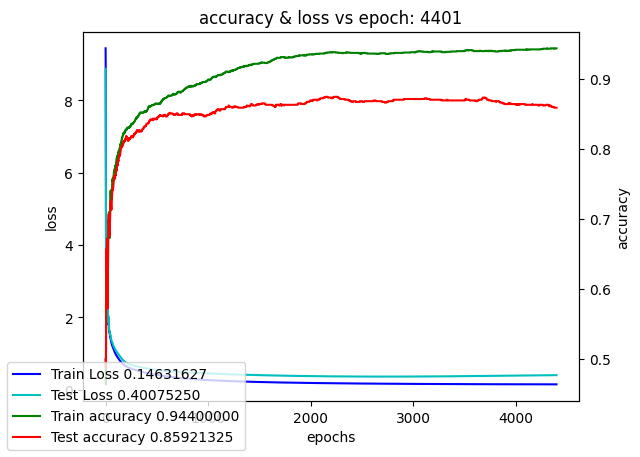

Training model color_cnn_single_kernel:  44%|████▍     | 4410/10000 [5:11:04<6:31:33,  4.20s/it]

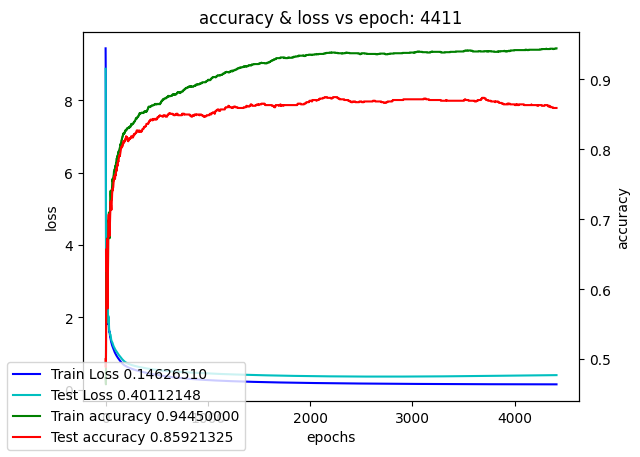

Training model color_cnn_single_kernel:  44%|████▍     | 4420/10000 [5:11:46<6:30:52,  4.20s/it]

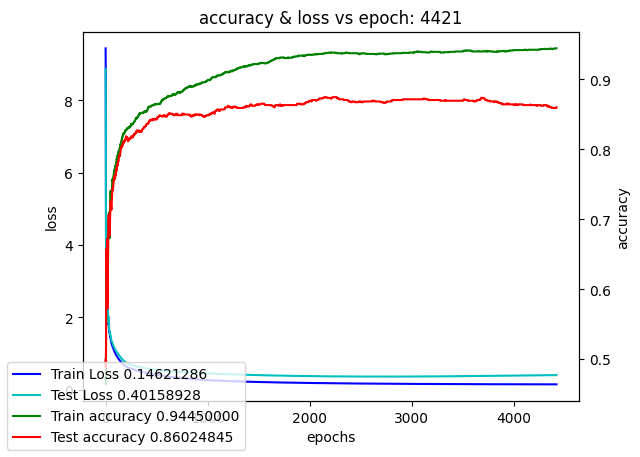

Training model color_cnn_single_kernel:  44%|████▍     | 4430/10000 [5:12:28<6:29:16,  4.19s/it]

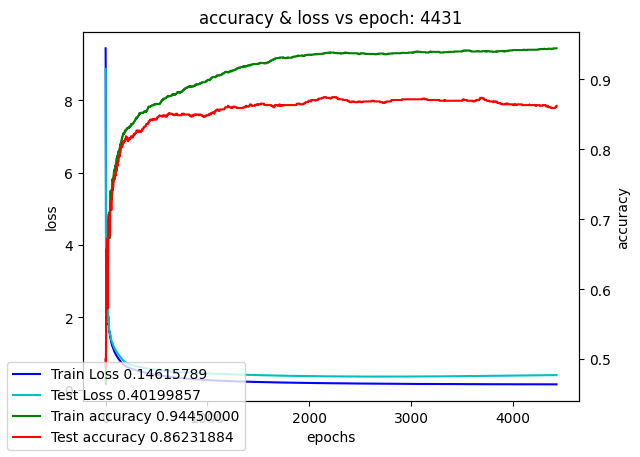

Training model color_cnn_single_kernel:  44%|████▍     | 4440/10000 [5:13:10<6:28:56,  4.20s/it]

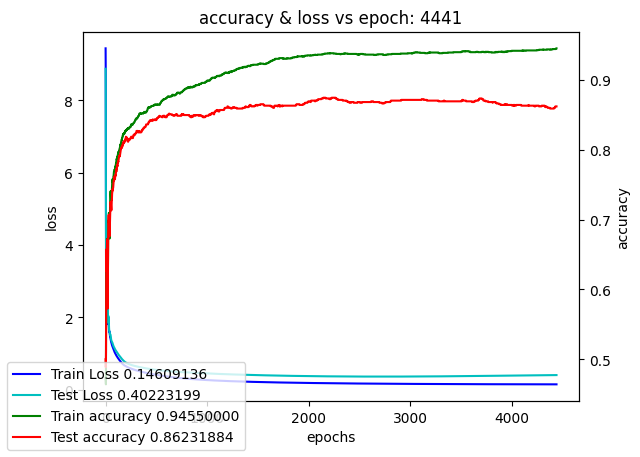

Training model color_cnn_single_kernel:  44%|████▍     | 4450/10000 [5:13:53<6:27:15,  4.19s/it]

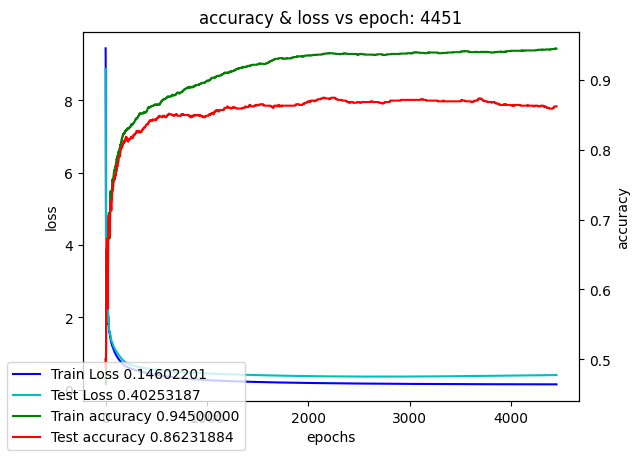

Training model color_cnn_single_kernel:  45%|████▍     | 4460/10000 [5:14:35<6:31:24,  4.24s/it]

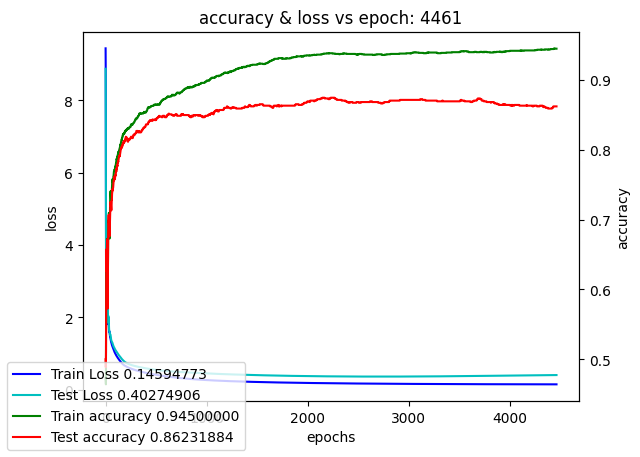

Training model color_cnn_single_kernel:  45%|████▍     | 4470/10000 [5:15:17<6:29:54,  4.23s/it]

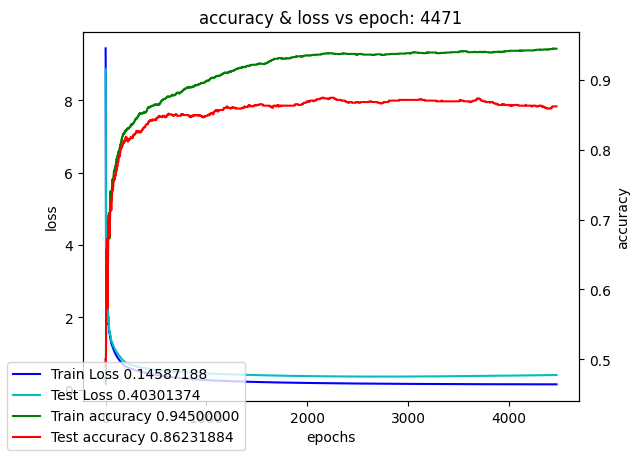

Training model color_cnn_single_kernel:  45%|████▍     | 4480/10000 [5:16:00<6:28:41,  4.22s/it]

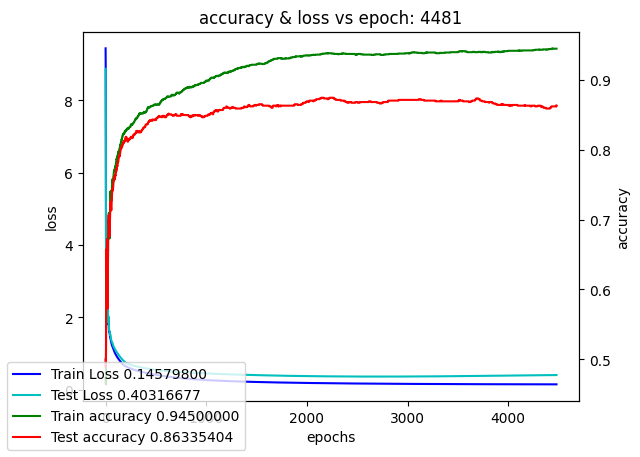

Training model color_cnn_single_kernel:  45%|████▍     | 4490/10000 [5:16:42<6:30:17,  4.25s/it]

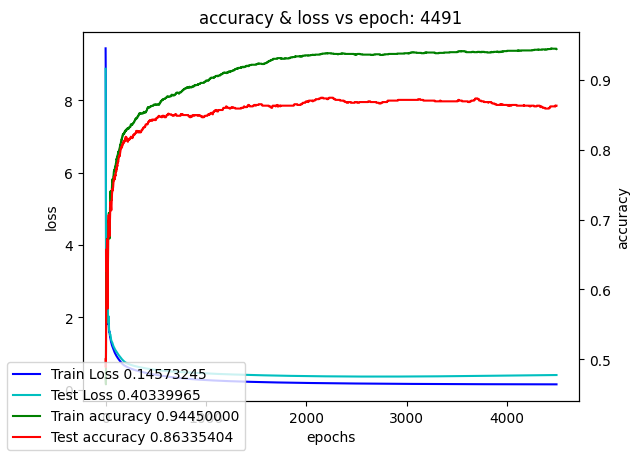

Training model color_cnn_single_kernel:  45%|████▌     | 4500/10000 [5:17:25<6:31:01,  4.27s/it]

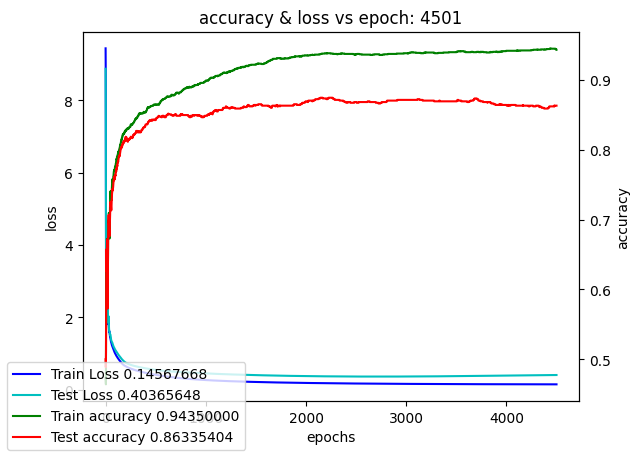

Training model color_cnn_single_kernel:  45%|████▌     | 4510/10000 [5:18:08<6:31:31,  4.28s/it]

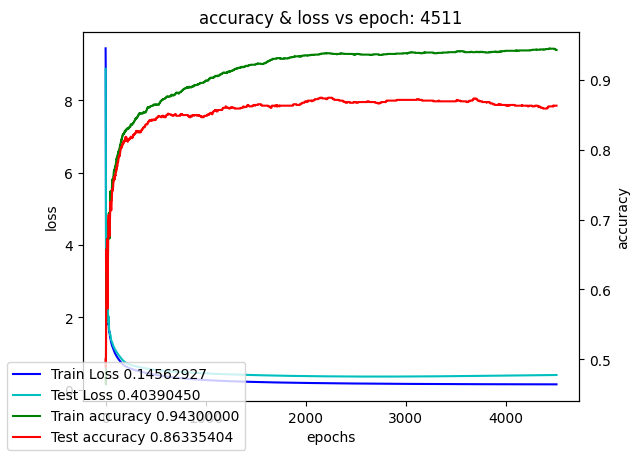

Training model color_cnn_single_kernel:  45%|████▌     | 4520/10000 [5:18:51<6:26:23,  4.23s/it]

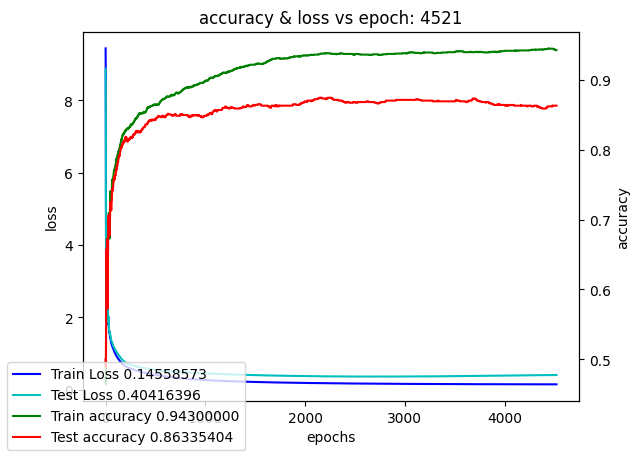

Training model color_cnn_single_kernel:  45%|████▌     | 4530/10000 [5:19:33<6:23:25,  4.21s/it]

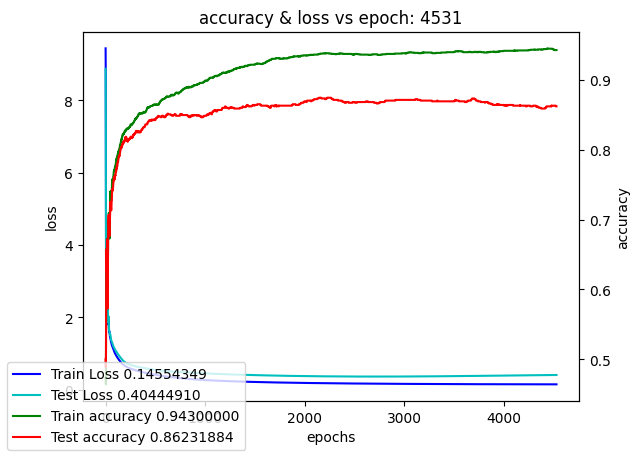

Training model color_cnn_single_kernel:  45%|████▌     | 4540/10000 [5:20:16<6:23:56,  4.22s/it]

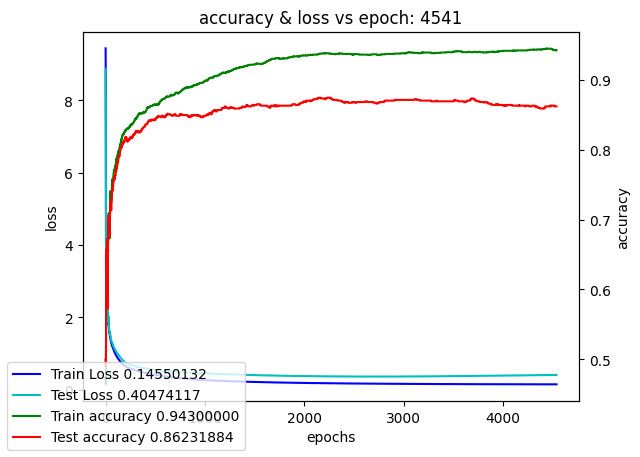

Training model color_cnn_single_kernel:  46%|████▌     | 4550/10000 [5:20:58<6:21:01,  4.19s/it]

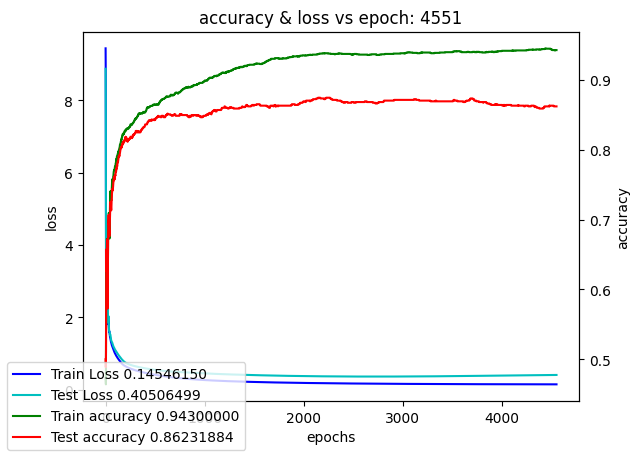

Training model color_cnn_single_kernel:  46%|████▌     | 4560/10000 [5:21:40<6:21:32,  4.21s/it]

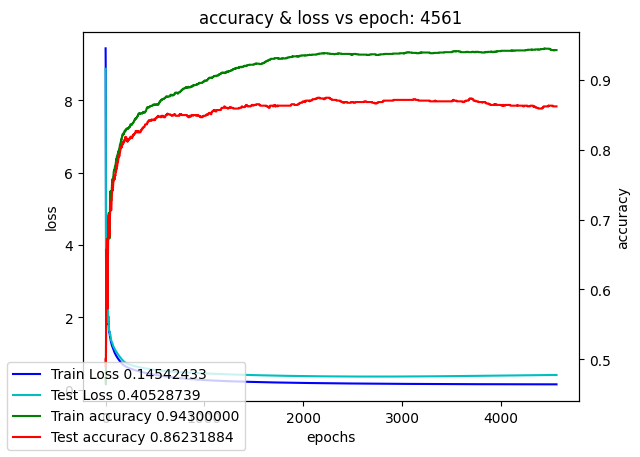

Training model color_cnn_single_kernel:  46%|████▌     | 4570/10000 [5:22:22<6:21:34,  4.22s/it]

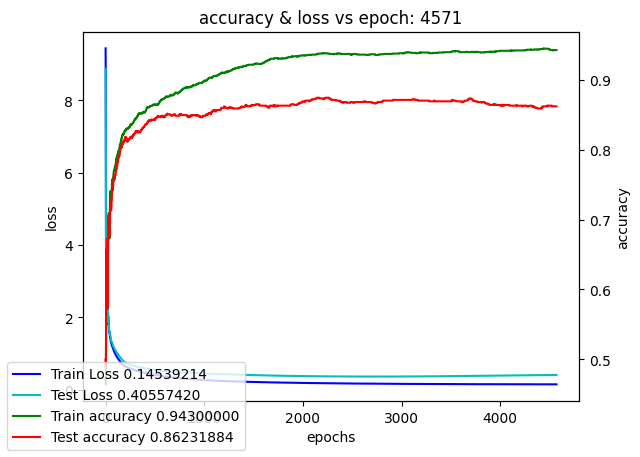

Training model color_cnn_single_kernel:  46%|████▌     | 4580/10000 [5:23:05<6:18:21,  4.19s/it]

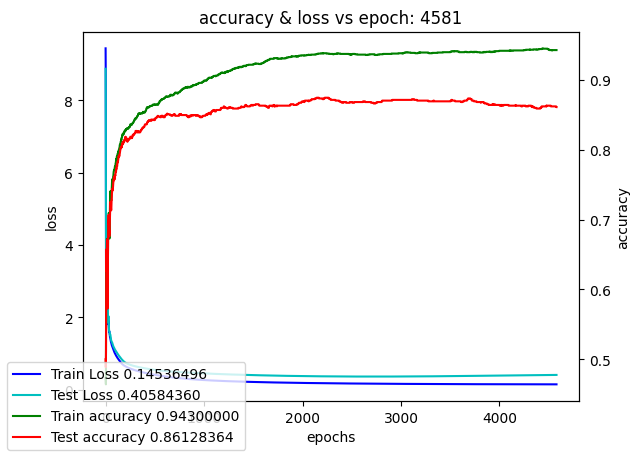

Training model color_cnn_single_kernel:  46%|████▌     | 4590/10000 [5:23:46<6:16:23,  4.17s/it]

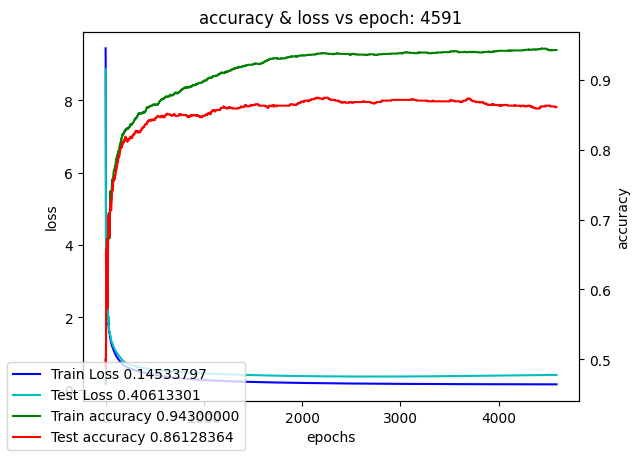

Training model color_cnn_single_kernel:  46%|████▌     | 4600/10000 [5:24:29<6:17:34,  4.20s/it]

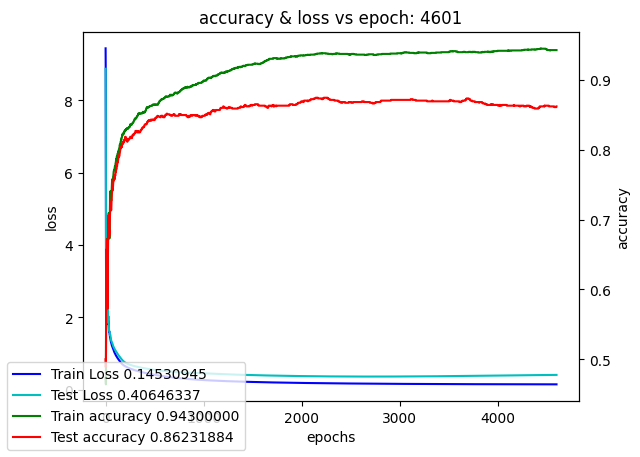

Training model color_cnn_single_kernel:  46%|████▌     | 4610/10000 [5:25:11<6:16:25,  4.19s/it]

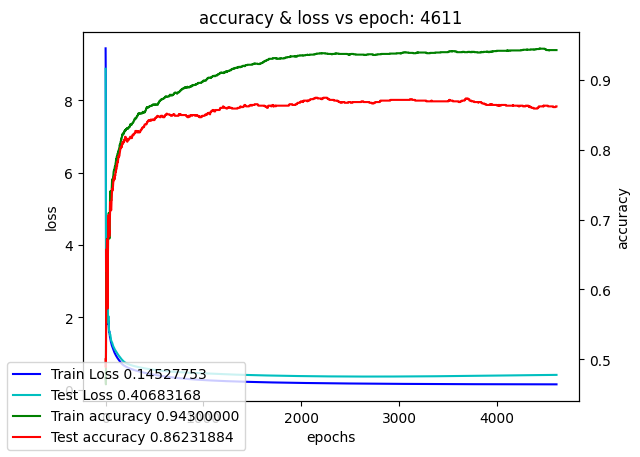

Training model color_cnn_single_kernel:  46%|████▌     | 4620/10000 [5:25:53<6:18:56,  4.23s/it]

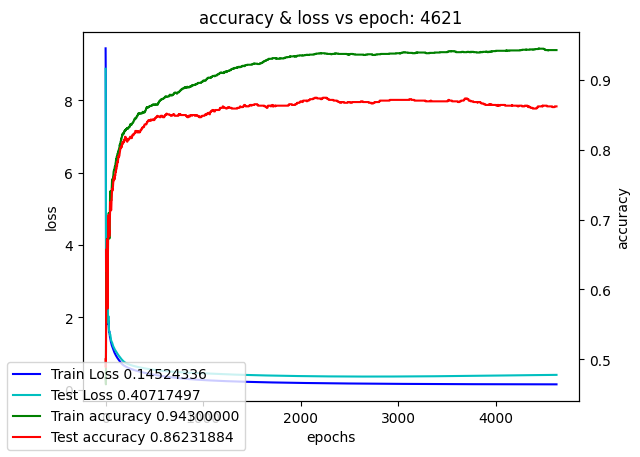

Training model color_cnn_single_kernel:  46%|████▋     | 4630/10000 [5:26:35<6:16:12,  4.20s/it]

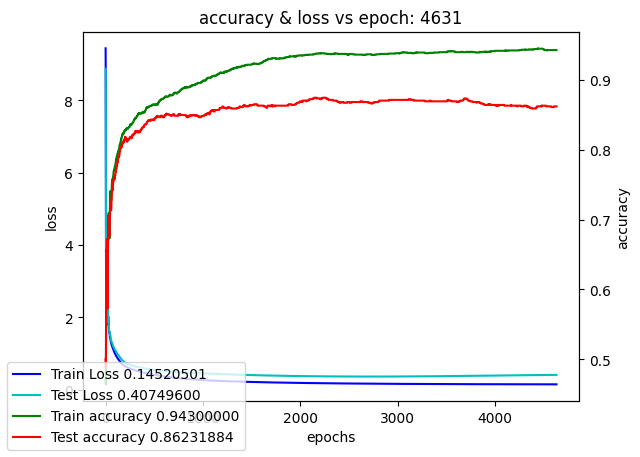

Training model color_cnn_single_kernel:  46%|████▋     | 4640/10000 [5:27:18<6:20:13,  4.26s/it]

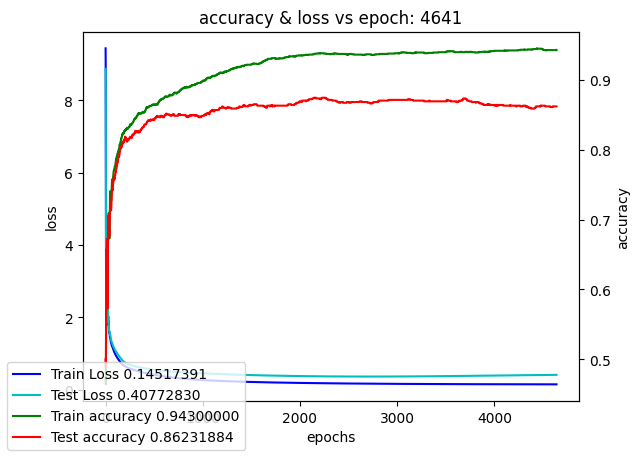

Training model color_cnn_single_kernel:  46%|████▋     | 4650/10000 [5:28:01<6:15:23,  4.21s/it]

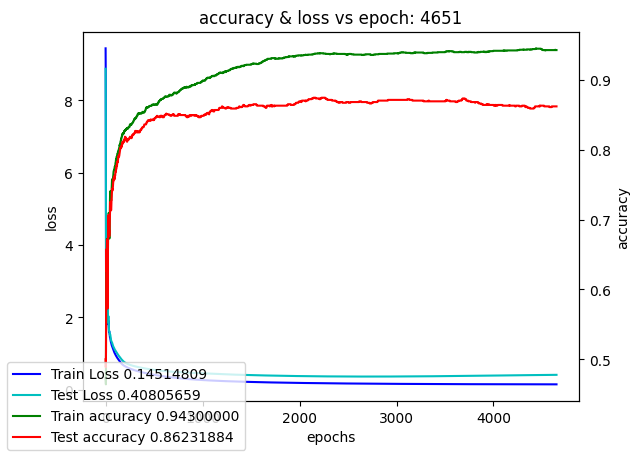

Training model color_cnn_single_kernel:  47%|████▋     | 4660/10000 [5:28:43<6:12:35,  4.19s/it]

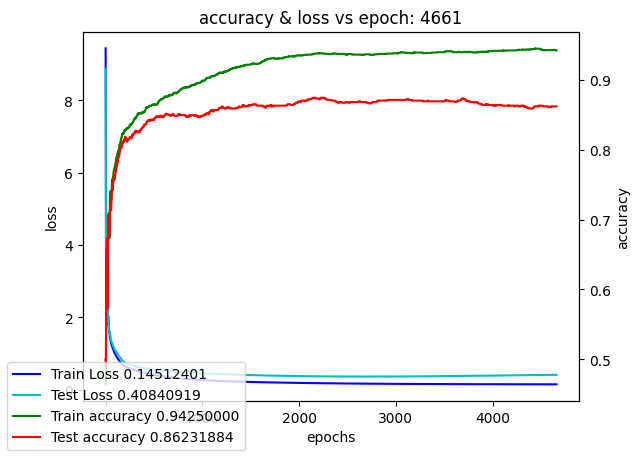

Training model color_cnn_single_kernel:  47%|████▋     | 4670/10000 [5:29:25<6:15:57,  4.23s/it]

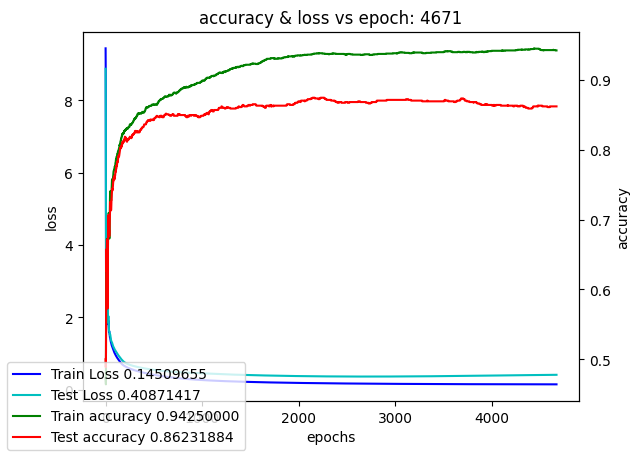

Training model color_cnn_single_kernel:  47%|████▋     | 4680/10000 [5:30:08<6:14:16,  4.22s/it]

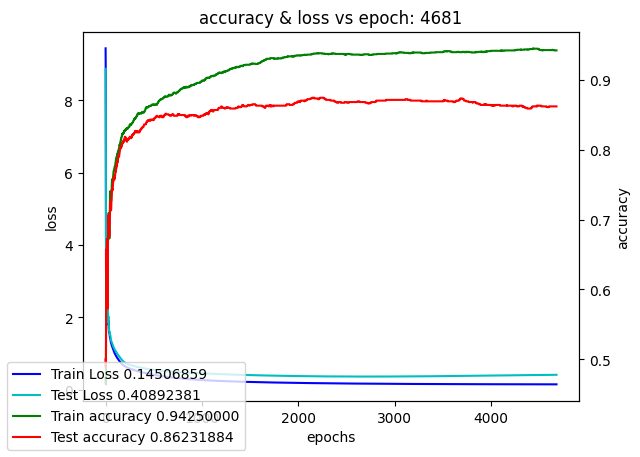

Training model color_cnn_single_kernel:  47%|████▋     | 4690/10000 [5:30:50<6:13:39,  4.22s/it]

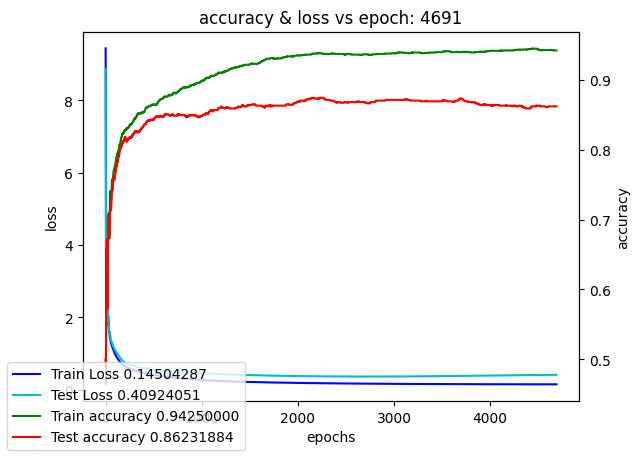

Training model color_cnn_single_kernel:  47%|████▋     | 4700/10000 [5:31:32<6:15:41,  4.25s/it]

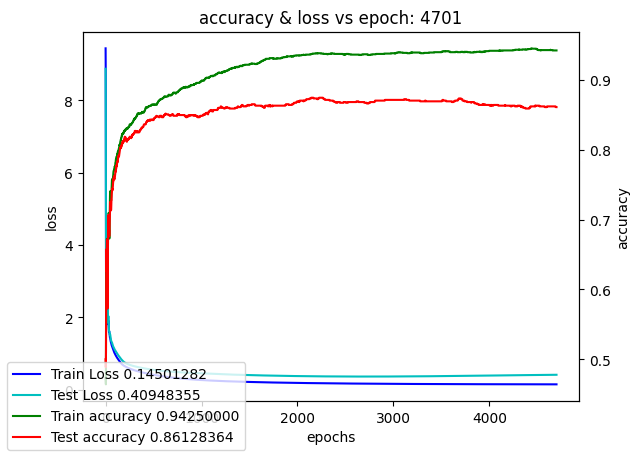

Training model color_cnn_single_kernel:  47%|████▋     | 4710/10000 [5:32:15<6:12:40,  4.23s/it]

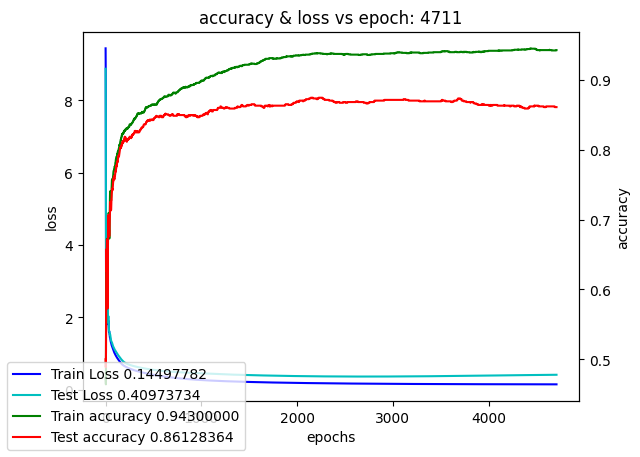

Training model color_cnn_single_kernel:  47%|████▋     | 4720/10000 [5:32:57<6:12:44,  4.24s/it]

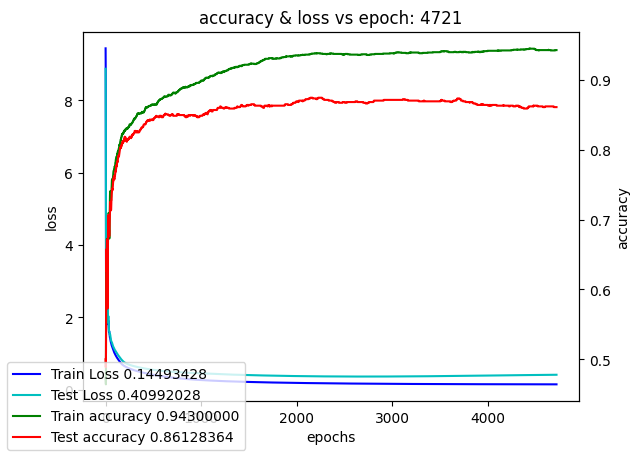

Training model color_cnn_single_kernel:  47%|████▋     | 4730/10000 [5:33:40<6:13:41,  4.25s/it]

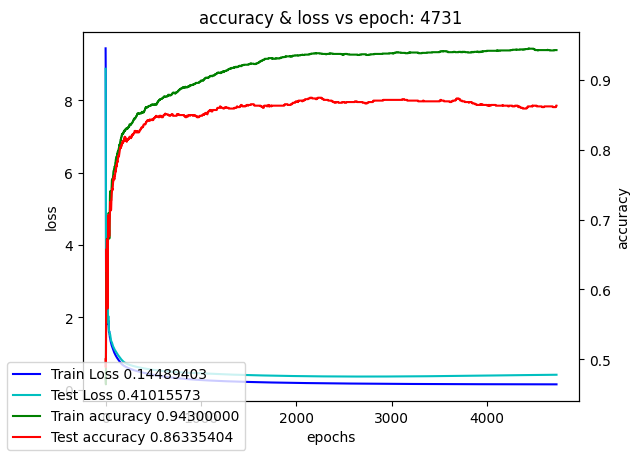

Training model color_cnn_single_kernel:  47%|████▋     | 4740/10000 [5:34:23<6:09:13,  4.21s/it]

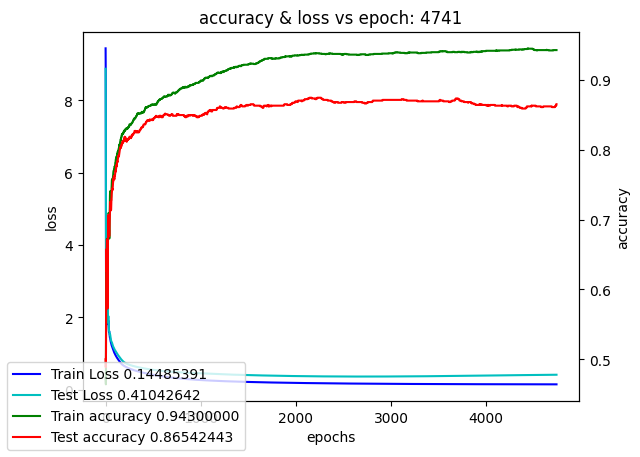

Training model color_cnn_single_kernel:  48%|████▊     | 4750/10000 [5:35:05<6:13:41,  4.27s/it]

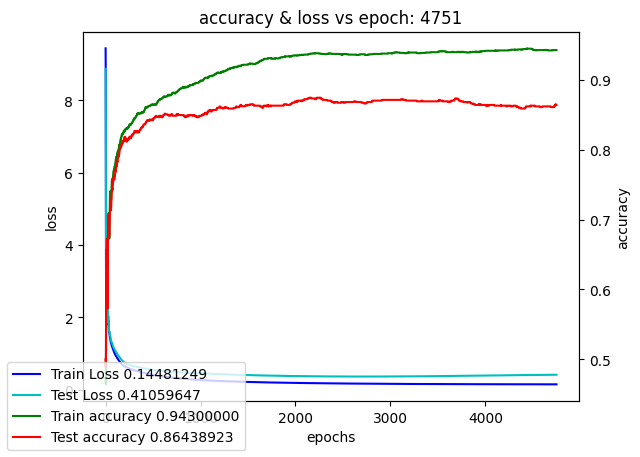

Training model color_cnn_single_kernel:  48%|████▊     | 4760/10000 [5:35:48<6:07:34,  4.21s/it]

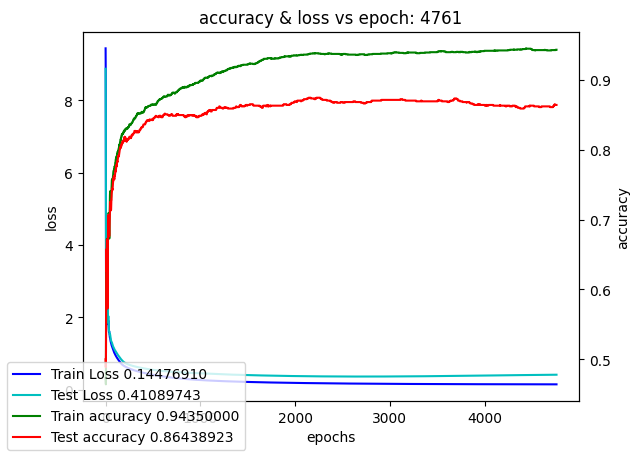

Training model color_cnn_single_kernel:  48%|████▊     | 4770/10000 [5:36:30<6:04:50,  4.19s/it]

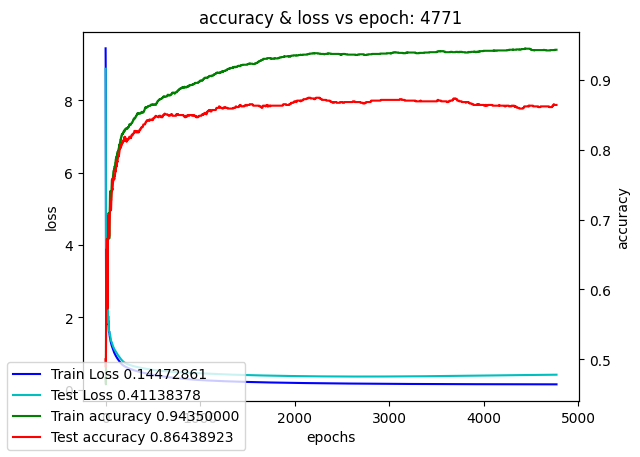

Training model color_cnn_single_kernel:  48%|████▊     | 4780/10000 [5:37:12<6:04:05,  4.19s/it]

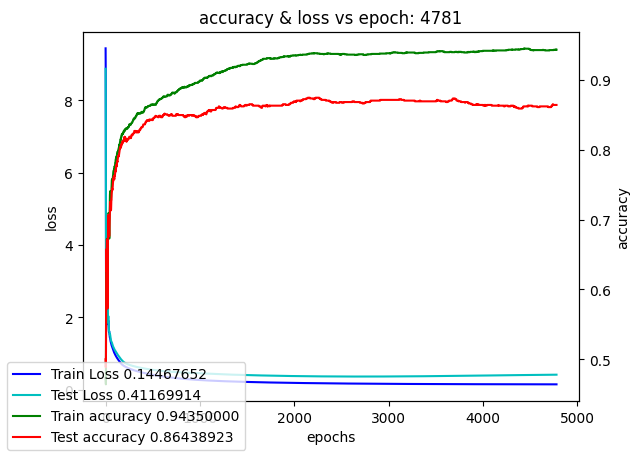

Training model color_cnn_single_kernel:  48%|████▊     | 4790/10000 [5:37:54<6:03:30,  4.19s/it]

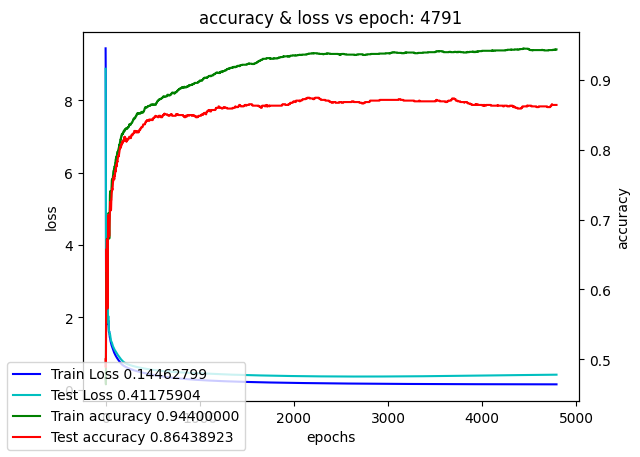

Training model color_cnn_single_kernel:  48%|████▊     | 4800/10000 [5:38:36<6:02:41,  4.18s/it]

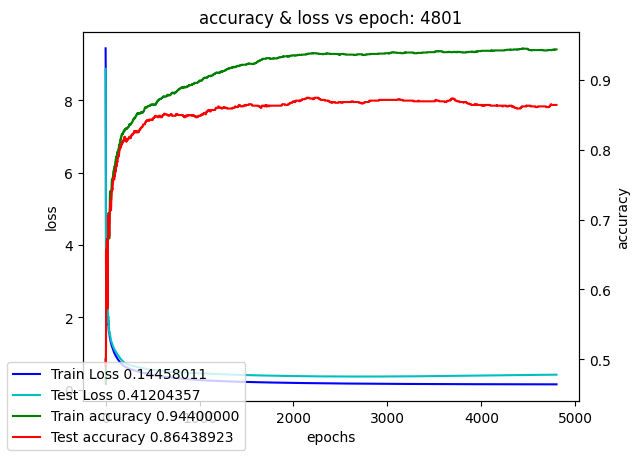

Training model color_cnn_single_kernel:  48%|████▊     | 4810/10000 [5:39:18<6:04:57,  4.22s/it]

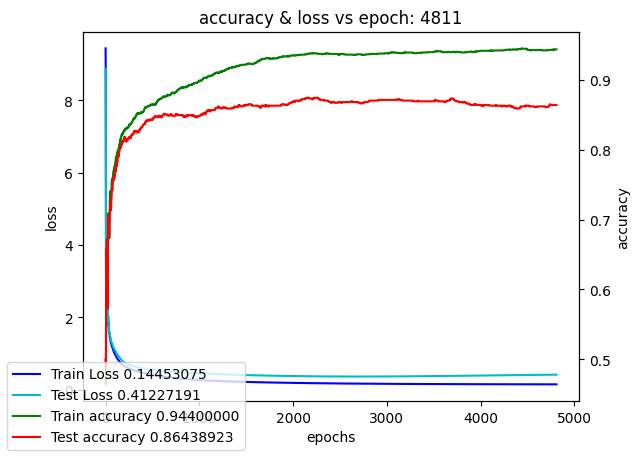

Training model color_cnn_single_kernel:  48%|████▊     | 4820/10000 [5:40:01<6:02:12,  4.20s/it]

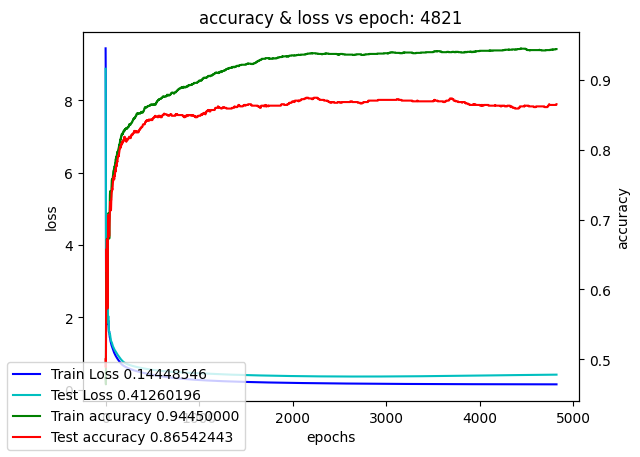

Training model color_cnn_single_kernel:  48%|████▊     | 4830/10000 [5:40:43<6:02:36,  4.21s/it]

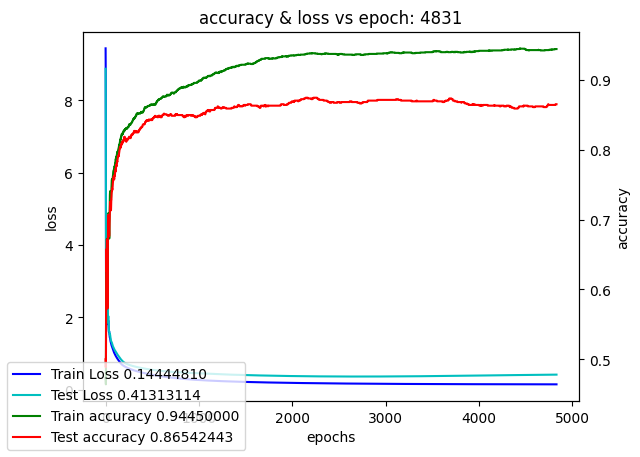

Training model color_cnn_single_kernel:  48%|████▊     | 4840/10000 [5:41:25<6:01:08,  4.20s/it]

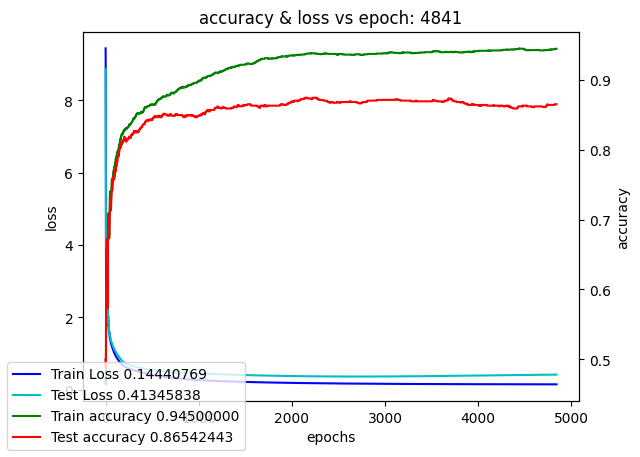

Training model color_cnn_single_kernel:  48%|████▊     | 4850/10000 [5:42:07<6:00:30,  4.20s/it]

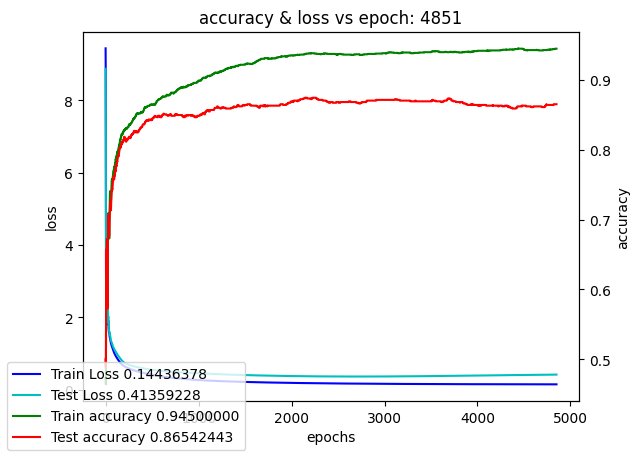

Training model color_cnn_single_kernel:  49%|████▊     | 4860/10000 [5:42:49<5:59:49,  4.20s/it]

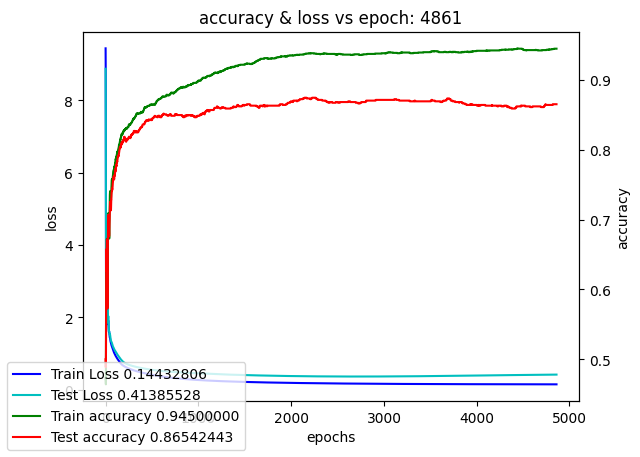

Training model color_cnn_single_kernel:  49%|████▊     | 4870/10000 [5:43:32<5:59:36,  4.21s/it]

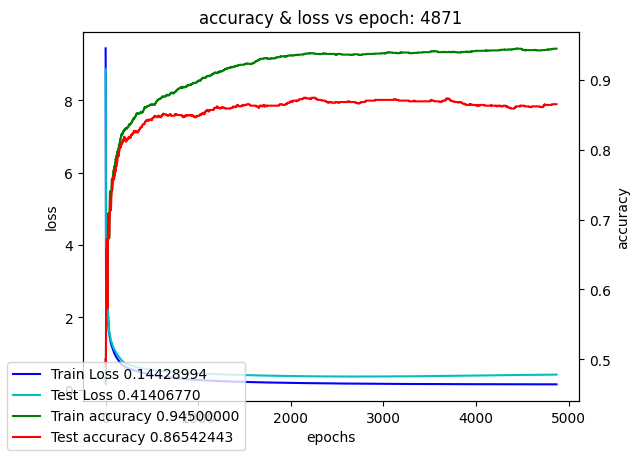

Training model color_cnn_single_kernel:  49%|████▉     | 4880/10000 [5:44:14<6:01:14,  4.23s/it]

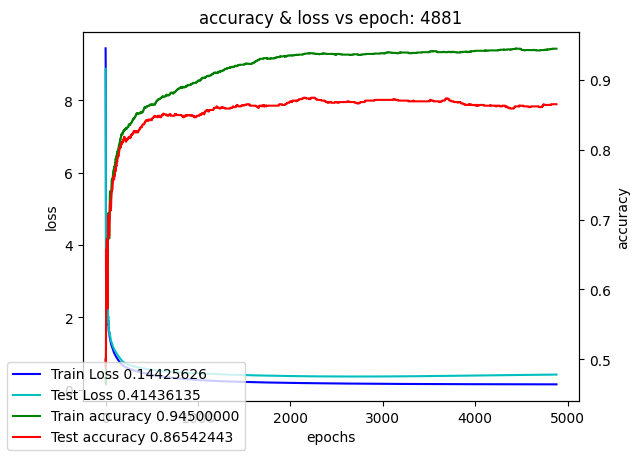

Training model color_cnn_single_kernel:  49%|████▉     | 4890/10000 [5:44:56<5:59:32,  4.22s/it]

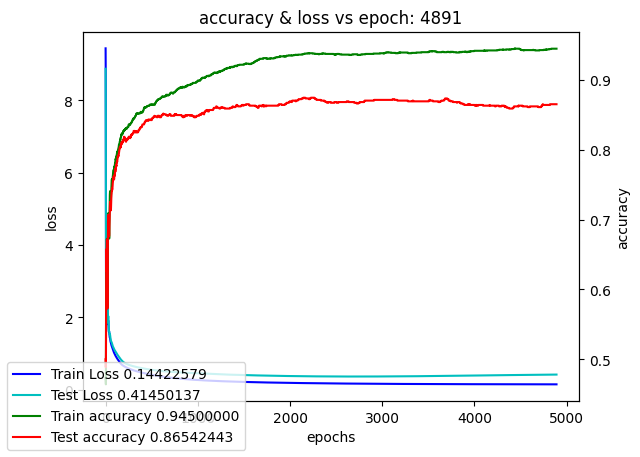

Training model color_cnn_single_kernel:  49%|████▉     | 4900/10000 [5:45:39<5:59:29,  4.23s/it]

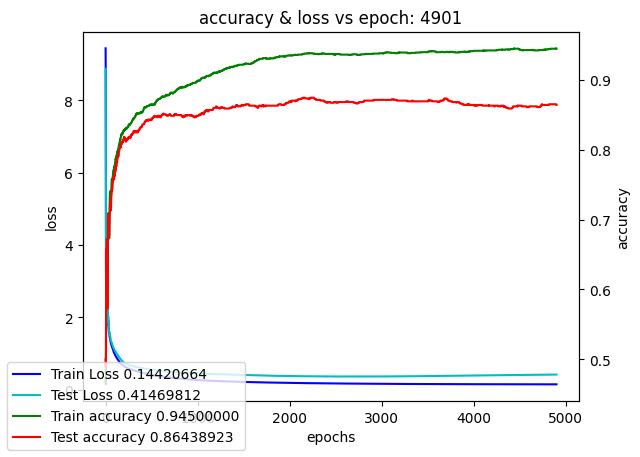

Training model color_cnn_single_kernel:  49%|████▉     | 4910/10000 [5:46:22<5:58:42,  4.23s/it]

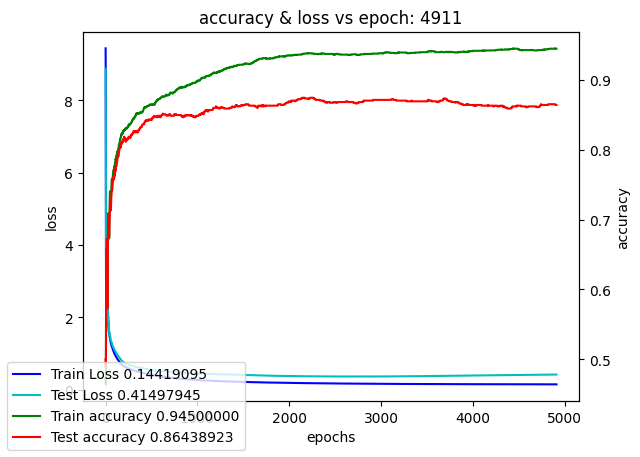

Training model color_cnn_single_kernel:  49%|████▉     | 4920/10000 [5:47:04<5:59:06,  4.24s/it]

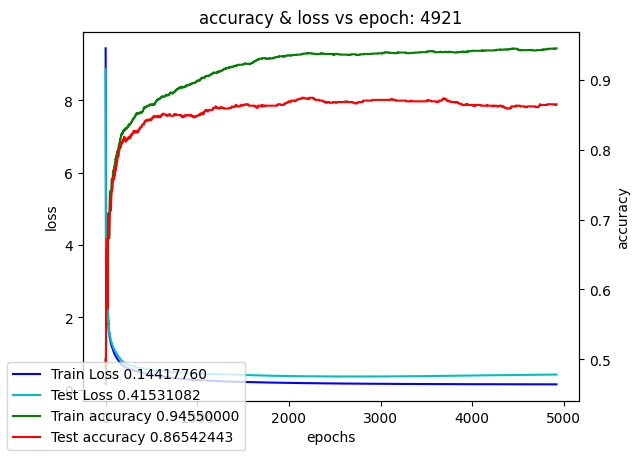

Training model color_cnn_single_kernel:  49%|████▉     | 4930/10000 [5:47:47<5:59:46,  4.26s/it]

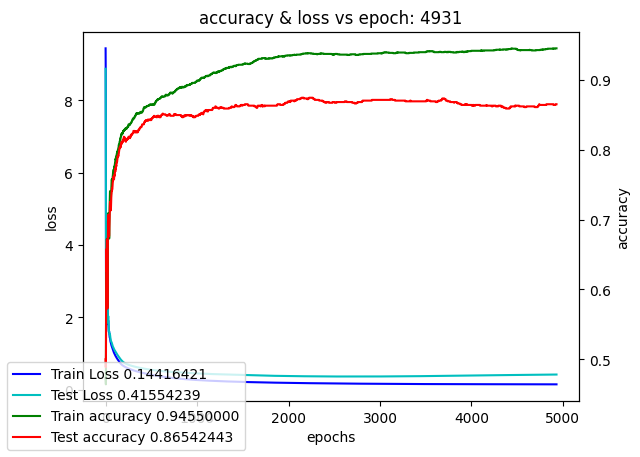

Training model color_cnn_single_kernel:  49%|████▉     | 4940/10000 [5:48:30<6:00:42,  4.28s/it]

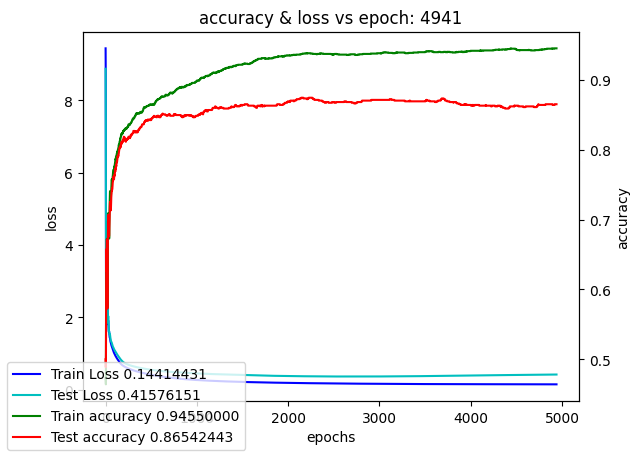

Training model color_cnn_single_kernel:  50%|████▉     | 4950/10000 [5:49:13<5:58:31,  4.26s/it]

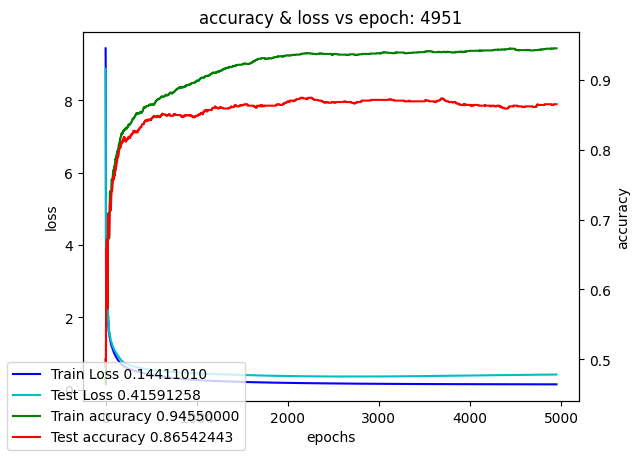

Training model color_cnn_single_kernel:  50%|████▉     | 4960/10000 [5:49:55<5:55:58,  4.24s/it]

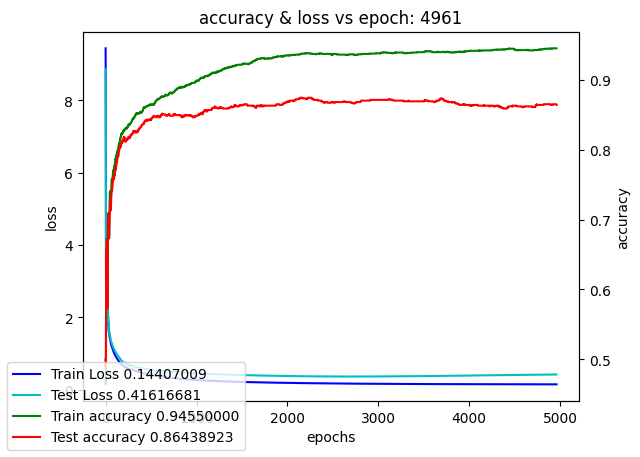

Training model color_cnn_single_kernel:  50%|████▉     | 4970/10000 [5:50:38<5:53:25,  4.22s/it]

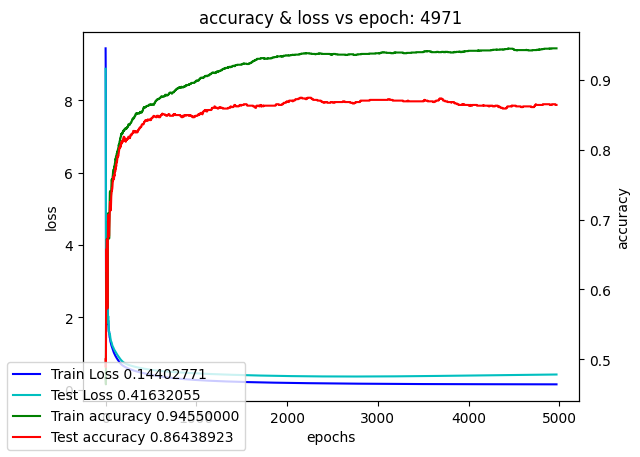

Training model color_cnn_single_kernel:  50%|████▉     | 4980/10000 [5:51:20<5:53:34,  4.23s/it]

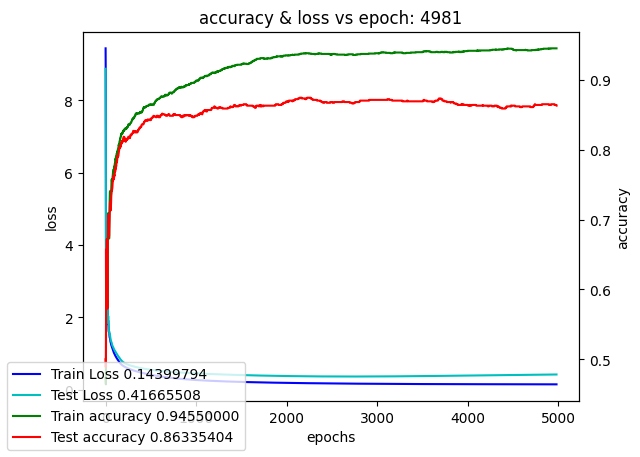

Training model color_cnn_single_kernel:  50%|████▉     | 4990/10000 [5:52:02<5:51:15,  4.21s/it]

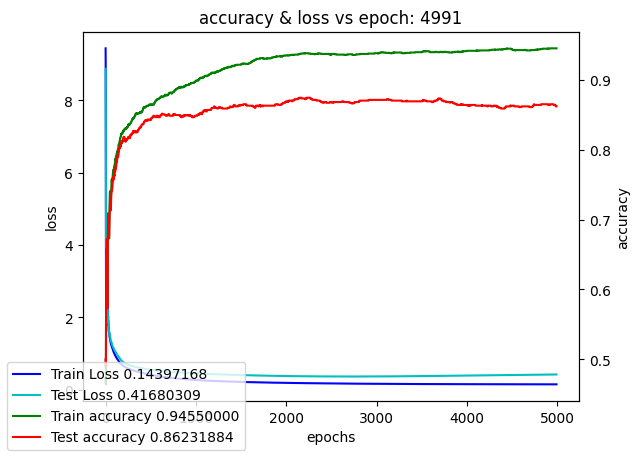

Training model color_cnn_single_kernel:  50%|████▉     | 4995/10000 [5:52:27<5:53:09,  4.23s/it]

Early stopping at epoch 4995


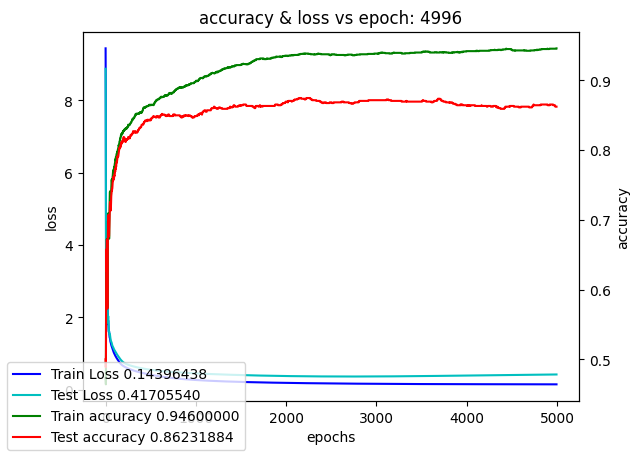

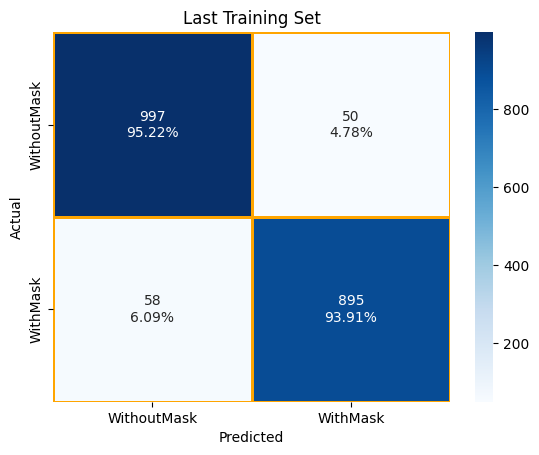

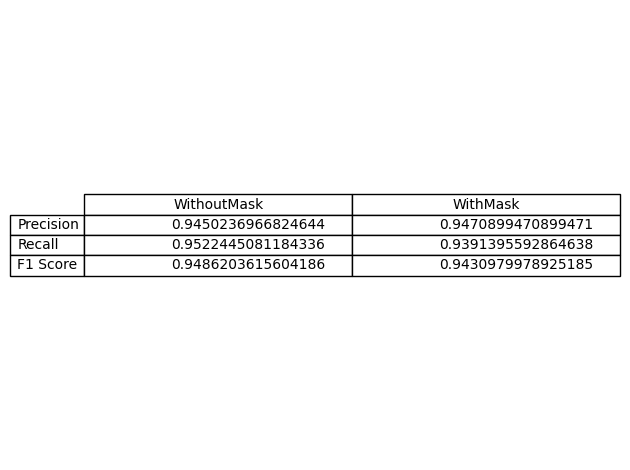

           WithoutMask  WithMask
Precision     0.945024  0.947090
Recall        0.952245  0.939140
F1 Score      0.948620  0.943098


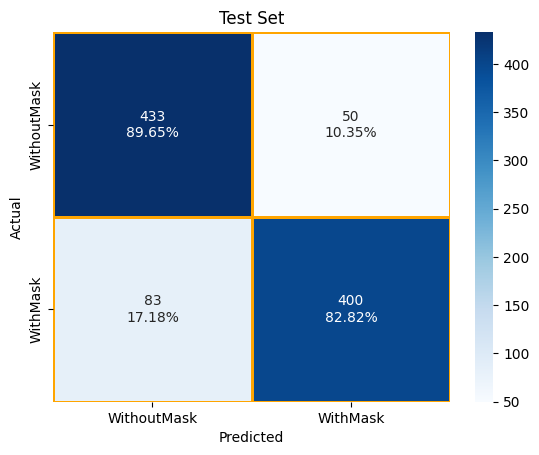

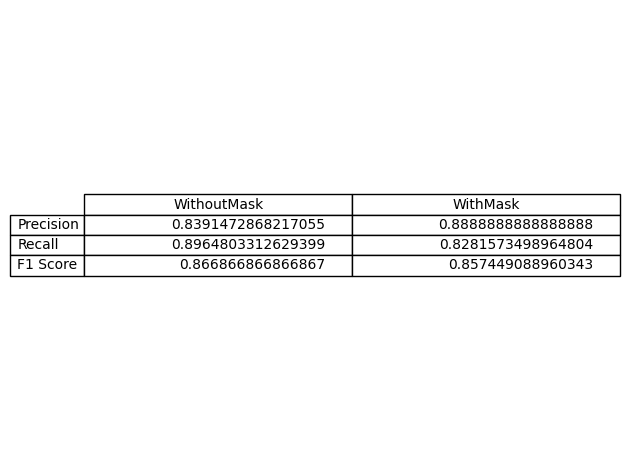

           WithoutMask  WithMask
Precision     0.839147  0.888889
Recall        0.896480  0.828157
F1 Score      0.866867  0.857449
Training Accuracy :  0.946
Test Accuracy :  0.8623188405797102
Run time (minutes) :  352.4537975055333
model saved at file_path='/content/drive/My Drive/CS583/models/color_cnn_single_kernel/color_cnn_single_kernel_2025-11-04 12:20:43.403430.pkl'


In [ ]:
color_cnn_single_kernel_path = os.path.join(data_path, 'color_cnn_single_kernel')
os.makedirs(color_cnn_single_kernel_path, exist_ok=True)

# find pkl model and load it if it exists
CNN = None
for _file in os.listdir(color_cnn_single_kernel_path):
  if _file.endswith('.pkl'):
    CNN = Model.import_model(os.path.join(color_cnn_single_kernel_path, _file))
    break
if CNN is None:
  is_adaptive_learning = True
  layers_single_kernel = [
    ConvolutionalLayer(9, channels=channels, number_kernels=1, is_adaptive=is_adaptive_learning, weight_initializer=kaiming_initialization),
    ReLU(),
    MaxPoolingLayer(2, stride=2),
    FlatteningLayer(),
    FullyConnectedLayer(-1, num_classes, is_adaptive=is_adaptive_learning, weight_initializer=xavier_initialization_uniform),
    SoftmaxLayer(),
    CrossEntropy()
  ]
  CNN = Model(layers_single_kernel, name='color_cnn_single_kernel')
  CNN.set_layers_input_shapes(x_train[0:1].shape)
  CNN.train_model(
      x_train,
      y_train,
      x_test,
      y_test,
      y_class_labels=train_class_labels,
      max_epochs=int(1e4),
      learning_rate=1e-3,
      min_loss=1e-6,
      batch_size=None,
      file_path = color_cnn_single_kernel_path
  )
  CNN.save_model(color_cnn_single_kernel_path)

### 4. CNN w/ multiple CNN layers (+ multi kernels)

input_shape=(1, 40, 40, 3)
0 ConvolutionalLayer output shape: (1, 38, 38, 4)
1 ReLU output shape: (1, 38, 38, 4)
2 MaxPoolingLayer output shape: (1, 19, 19, 4)
3 ConvolutionalLayer output shape: (1, 17, 17, 2)
4 ReLU output shape: (1, 17, 17, 2)
5 MaxPoolingLayer output shape: (1, 8, 8, 2)
6 FlatteningLayer output shape: (1, np.int64(128))
7 FullyConnectedLayer output shape: 2
8 SoftmaxLayer output shape: 2
9 CrossEntropy output shape: 2


Training model color_cnn_multi_kernel_multi_layer:   0%|          | 10/10000 [00:22<6:10:08,  2.22s/it]

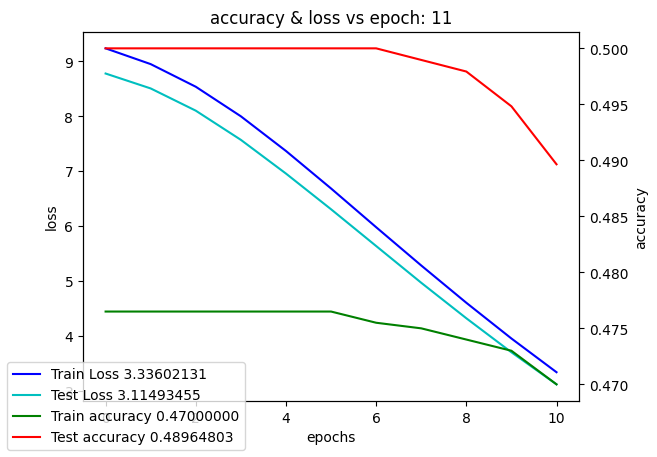

Training model color_cnn_multi_kernel_multi_layer:   0%|          | 20/10000 [00:44<6:13:54,  2.25s/it]

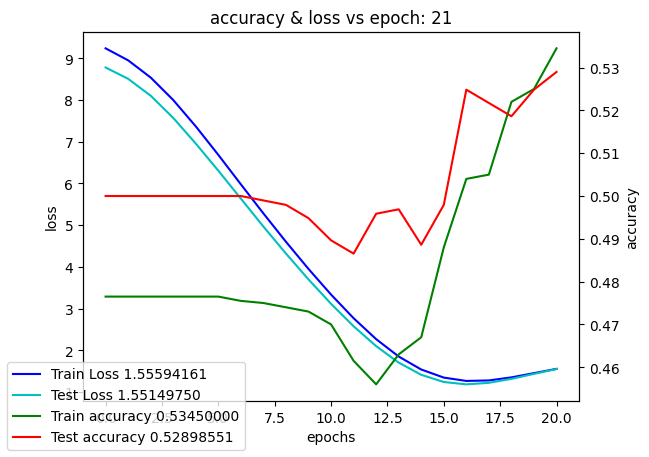

Training model color_cnn_multi_kernel_multi_layer:   0%|          | 30/10000 [01:07<6:11:43,  2.24s/it]

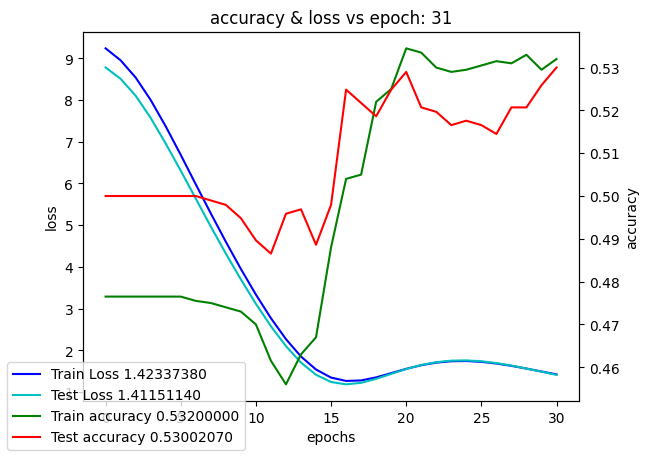

Training model color_cnn_multi_kernel_multi_layer:   0%|          | 40/10000 [01:30<6:12:33,  2.24s/it]

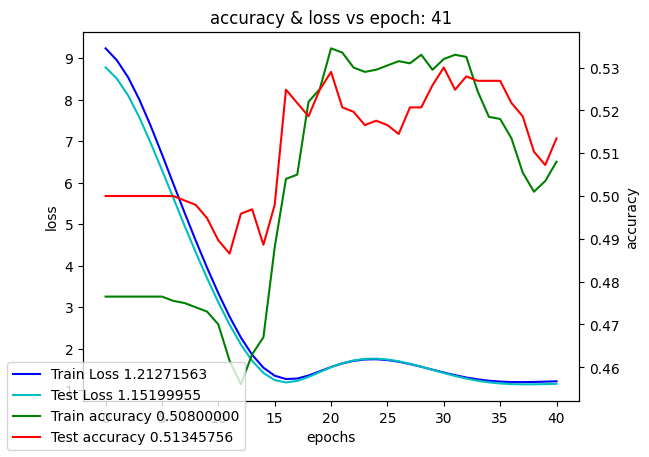

Training model color_cnn_multi_kernel_multi_layer:   0%|          | 50/10000 [01:52<6:12:47,  2.25s/it]

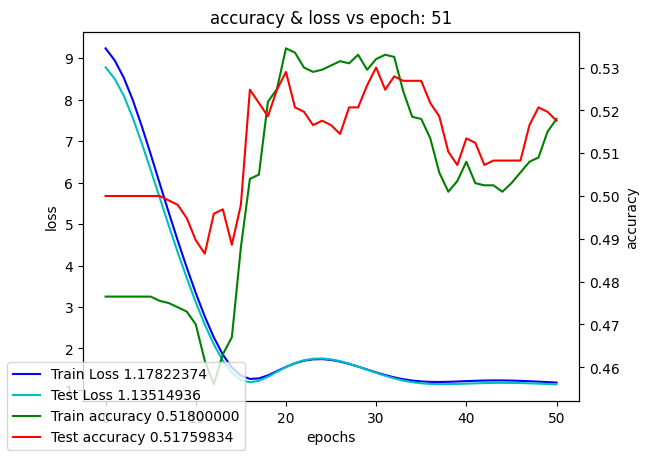

Training model color_cnn_multi_kernel_multi_layer:   1%|          | 60/10000 [02:15<6:13:31,  2.25s/it]

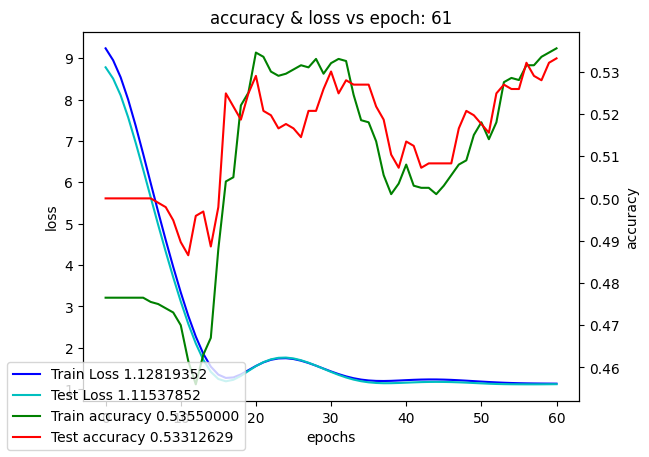

Training model color_cnn_multi_kernel_multi_layer:   1%|          | 70/10000 [02:38<6:11:19,  2.24s/it]

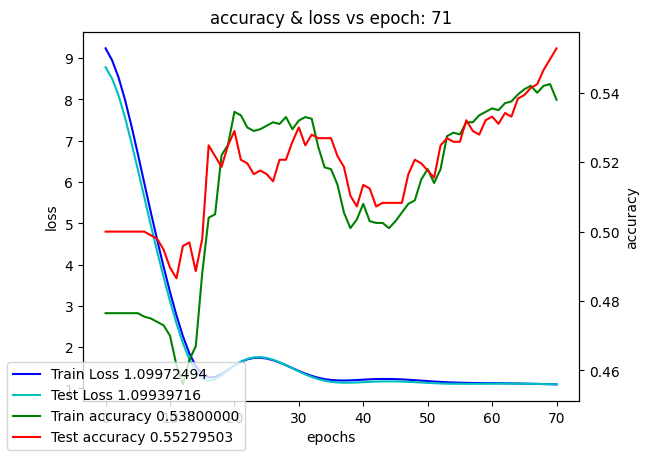

Training model color_cnn_multi_kernel_multi_layer:   1%|          | 80/10000 [03:01<6:12:42,  2.25s/it]

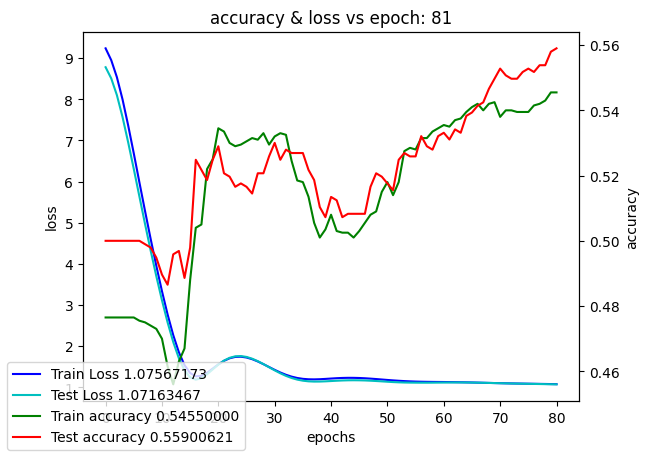

Training model color_cnn_multi_kernel_multi_layer:   1%|          | 90/10000 [03:23<6:11:08,  2.25s/it]

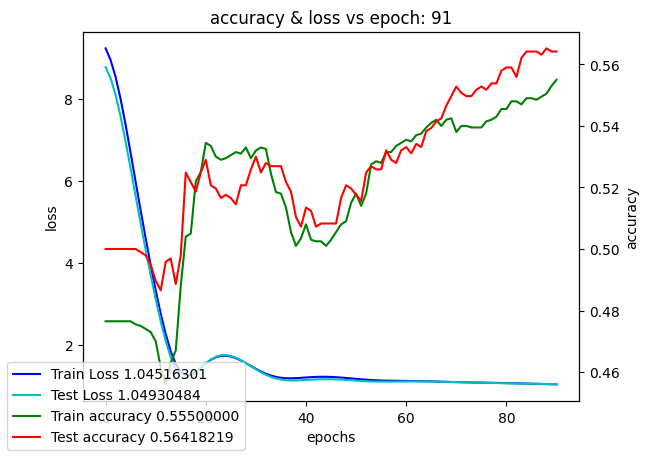

Training model color_cnn_multi_kernel_multi_layer:   1%|          | 100/10000 [03:46<6:14:34,  2.27s/it]

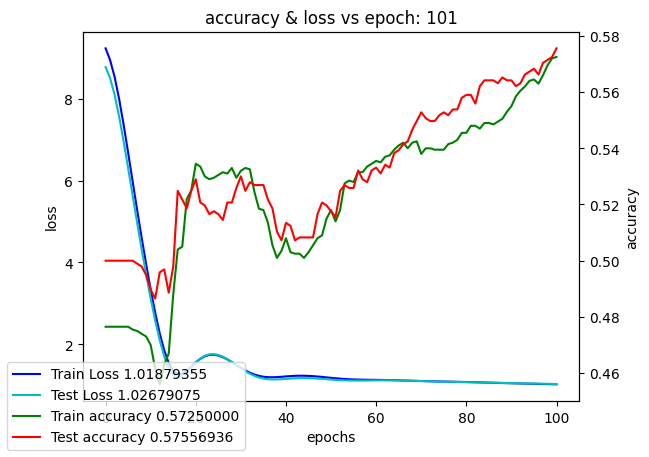

Training model color_cnn_multi_kernel_multi_layer:   1%|          | 110/10000 [04:09<6:13:24,  2.27s/it]

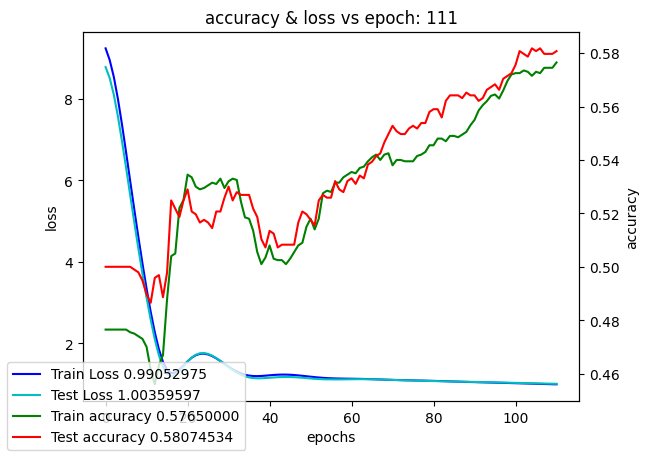

Training model color_cnn_multi_kernel_multi_layer:   1%|          | 120/10000 [04:32<6:09:21,  2.24s/it]

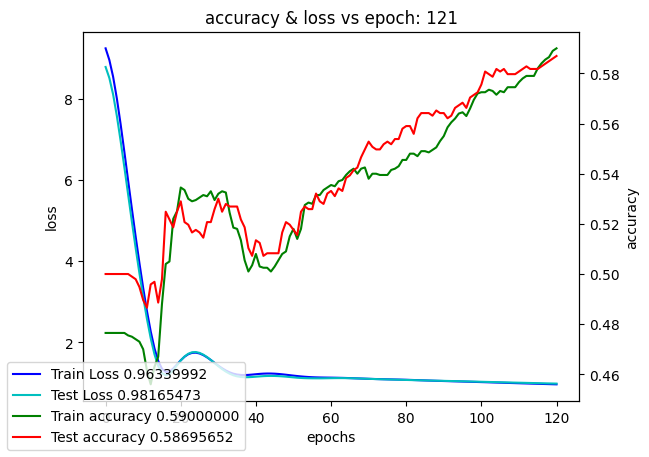

Training model color_cnn_multi_kernel_multi_layer:   1%|▏         | 130/10000 [04:54<6:07:38,  2.23s/it]

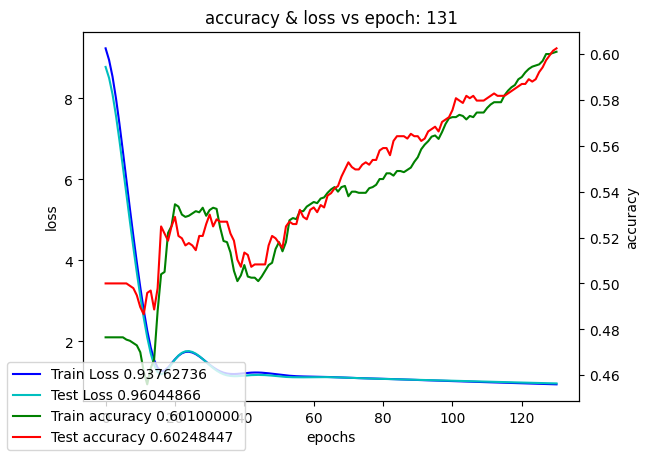

Training model color_cnn_multi_kernel_multi_layer:   1%|▏         | 140/10000 [05:16<6:05:40,  2.23s/it]

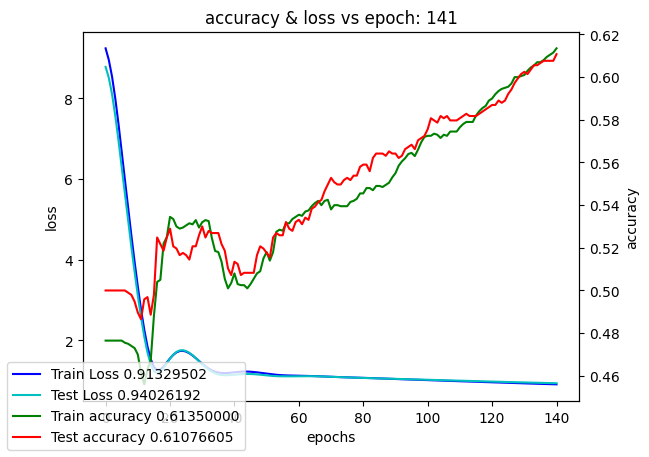

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 150/10000 [05:39<6:05:22,  2.23s/it]

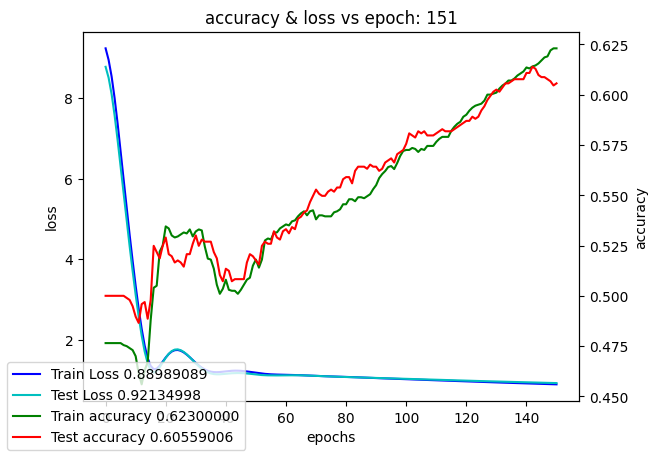

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 160/10000 [06:02<6:06:34,  2.24s/it]

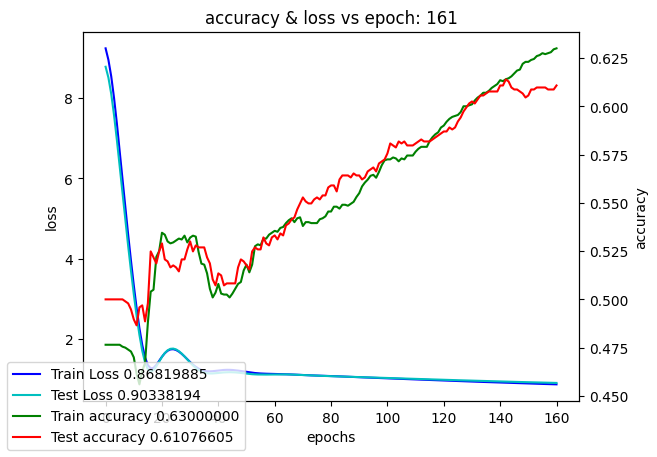

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 170/10000 [06:24<6:04:11,  2.22s/it]

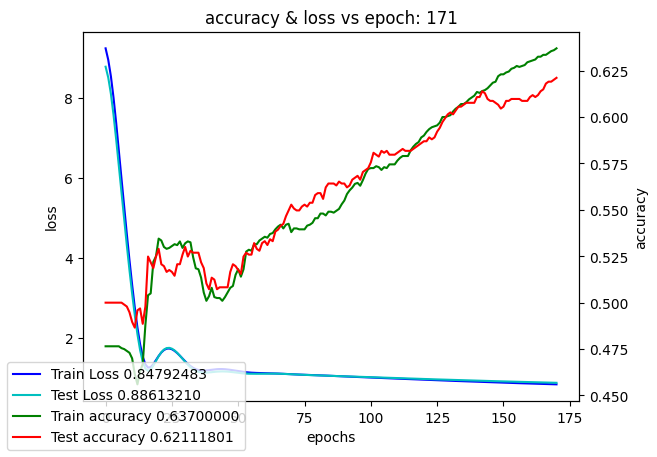

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 180/10000 [06:47<6:04:54,  2.23s/it]

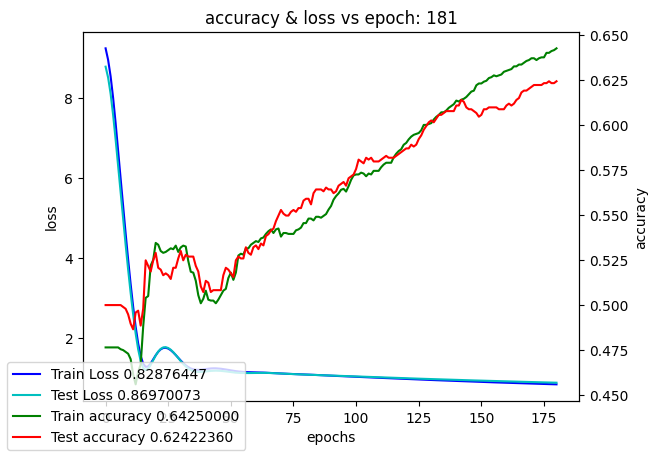

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 190/10000 [07:09<6:04:07,  2.23s/it]

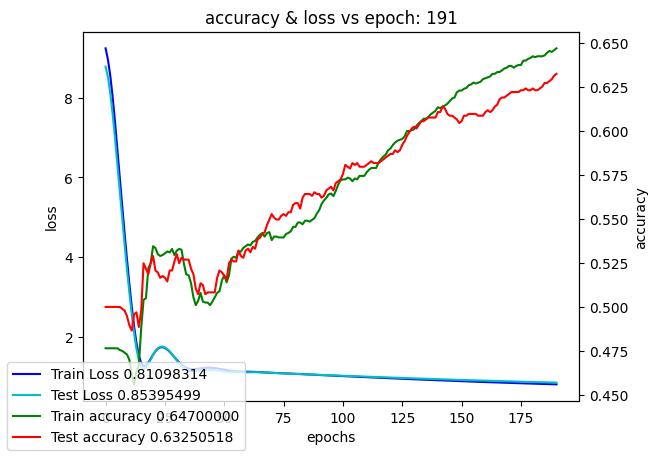

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 200/10000 [07:31<6:04:10,  2.23s/it]

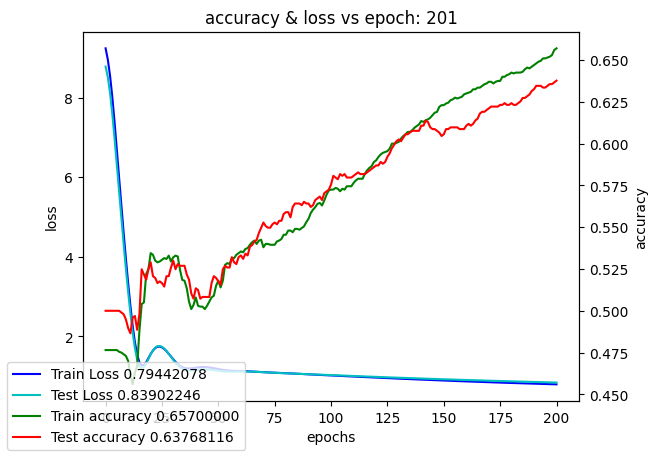

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 210/10000 [07:54<6:04:07,  2.23s/it]

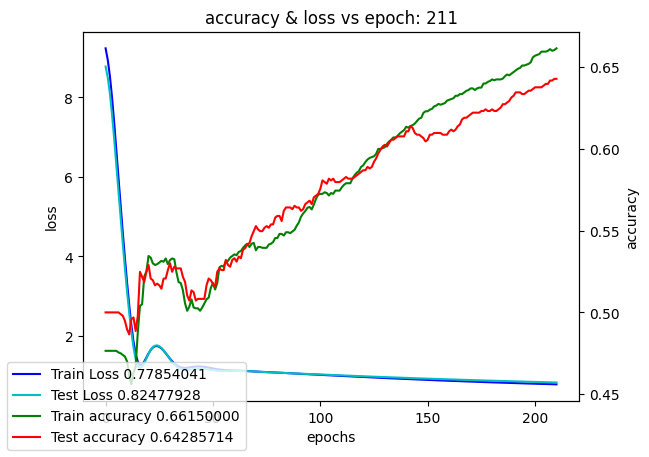

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 220/10000 [08:17<6:06:36,  2.25s/it]

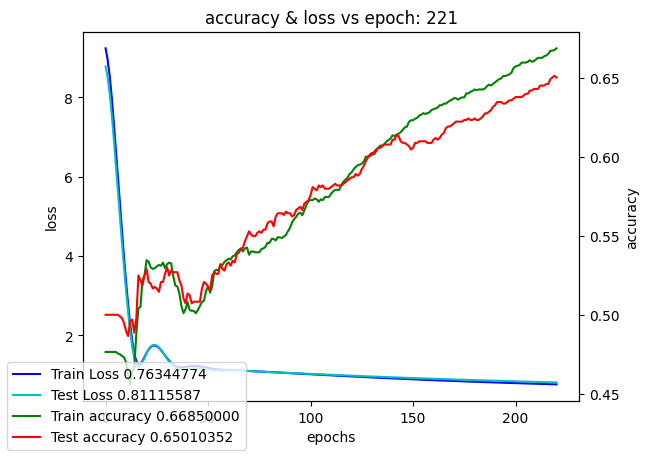

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 230/10000 [08:39<6:02:36,  2.23s/it]

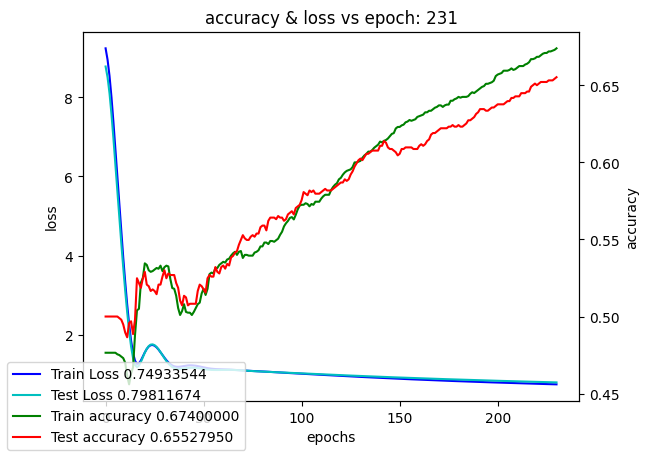

Training model color_cnn_multi_kernel_multi_layer:   2%|▏         | 240/10000 [09:01<6:02:13,  2.23s/it]

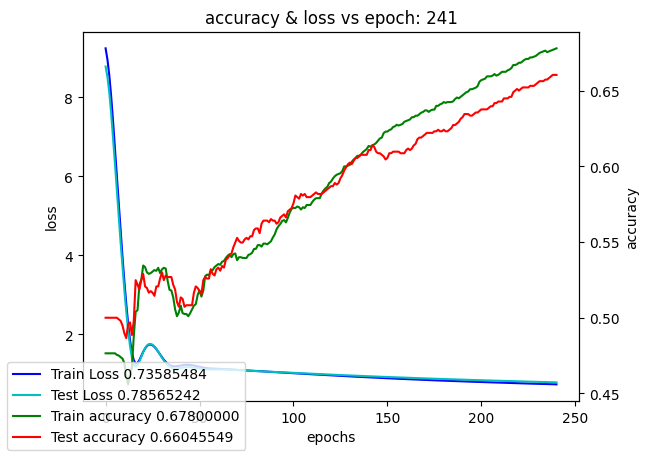

Training model color_cnn_multi_kernel_multi_layer:   2%|▎         | 250/10000 [09:24<6:03:35,  2.24s/it]

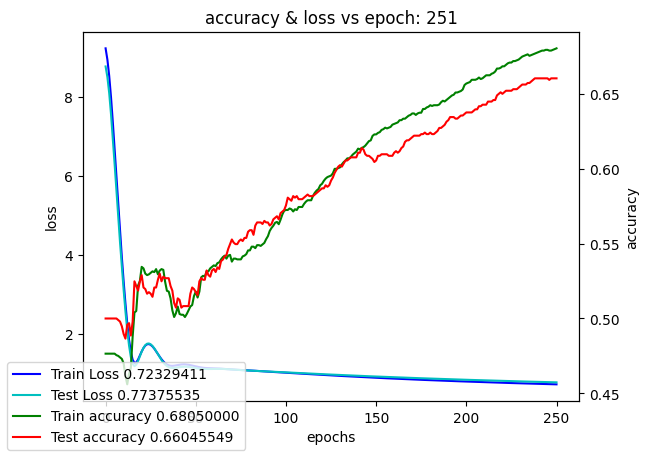

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 260/10000 [09:47<6:03:25,  2.24s/it]

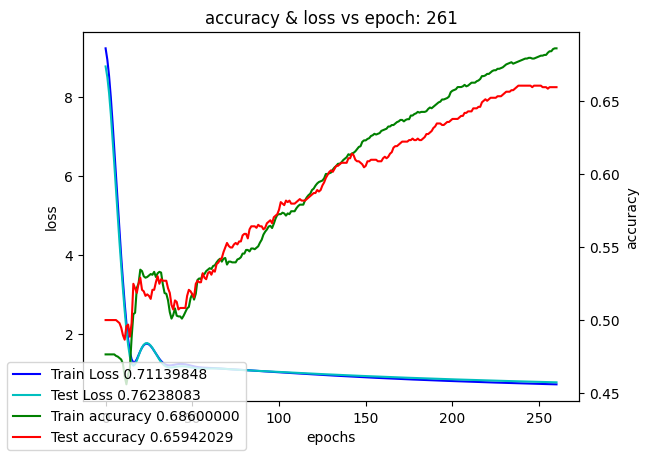

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 270/10000 [10:09<6:03:31,  2.24s/it]

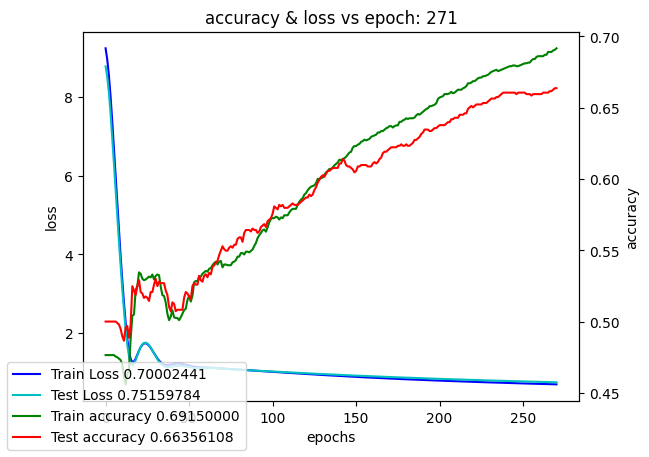

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 280/10000 [10:32<6:04:21,  2.25s/it]

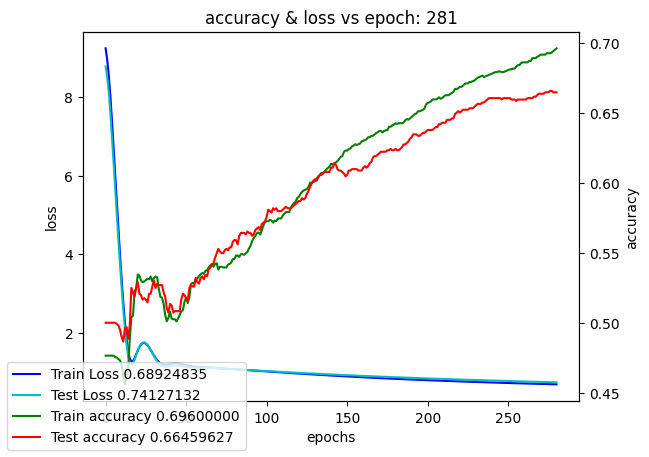

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 290/10000 [10:54<6:01:19,  2.23s/it]

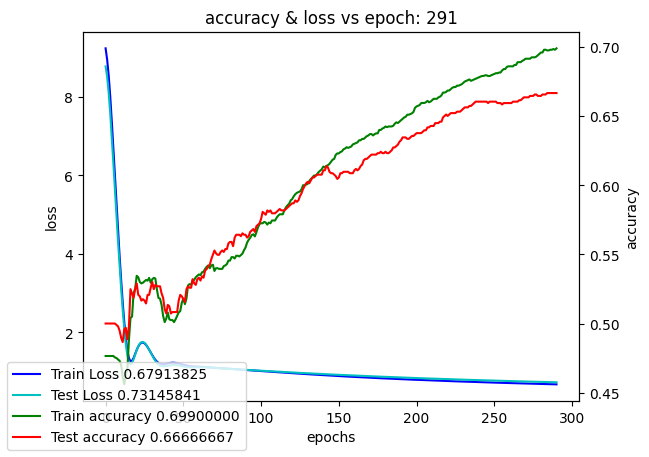

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 300/10000 [11:17<6:06:10,  2.27s/it]

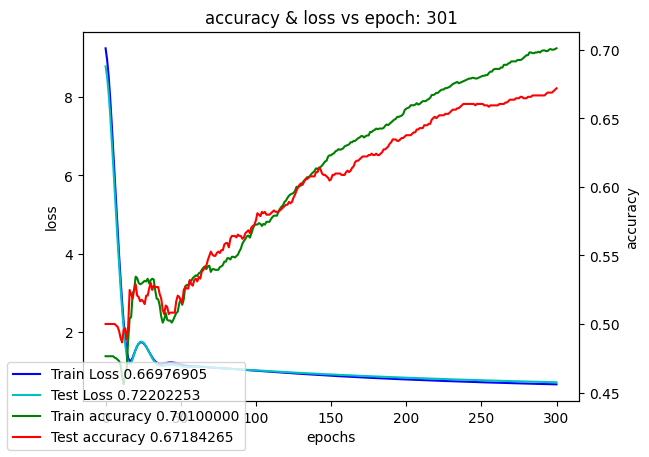

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 310/10000 [11:40<6:04:13,  2.26s/it]

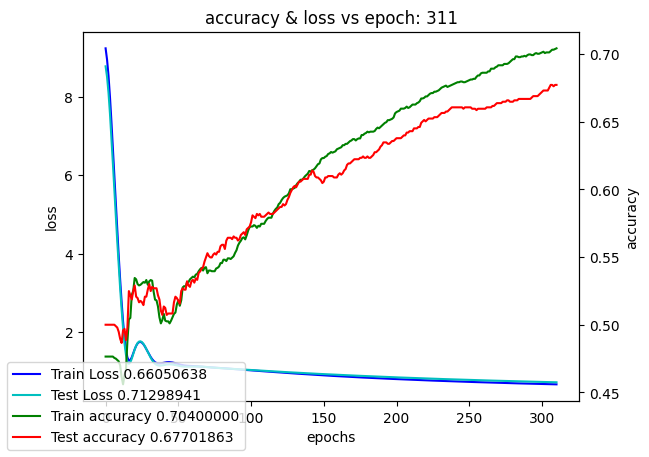

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 320/10000 [12:03<5:59:40,  2.23s/it]

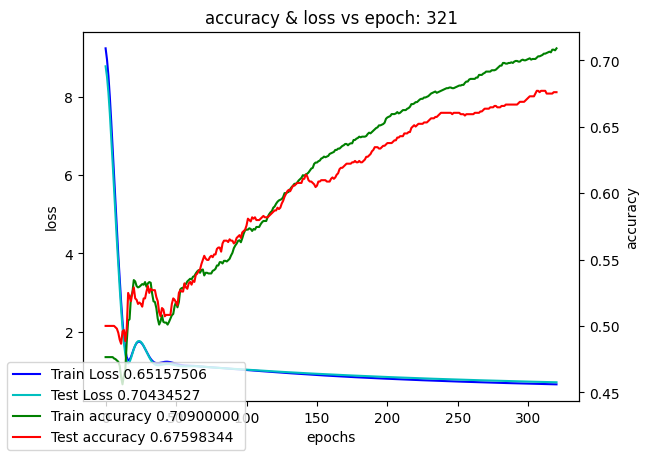

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 330/10000 [12:25<5:59:05,  2.23s/it]

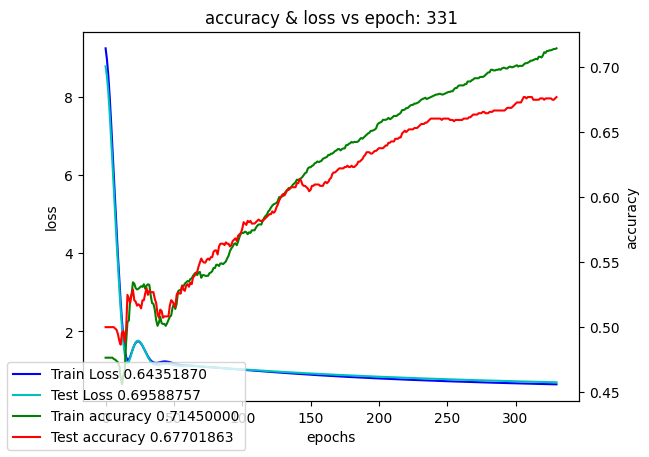

Training model color_cnn_multi_kernel_multi_layer:   3%|▎         | 340/10000 [12:47<5:59:07,  2.23s/it]

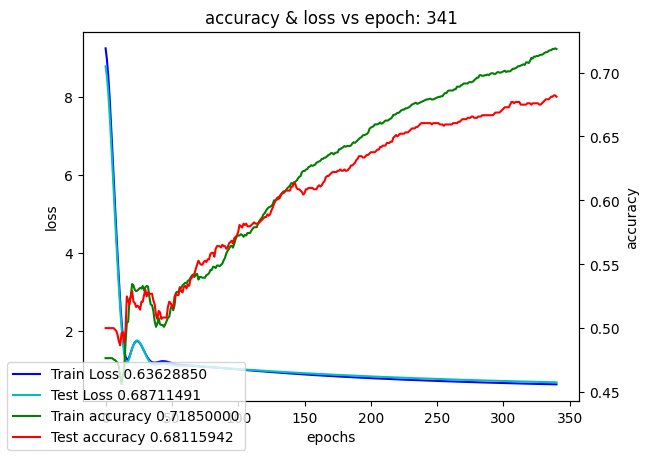

Training model color_cnn_multi_kernel_multi_layer:   4%|▎         | 350/10000 [13:10<5:58:57,  2.23s/it]

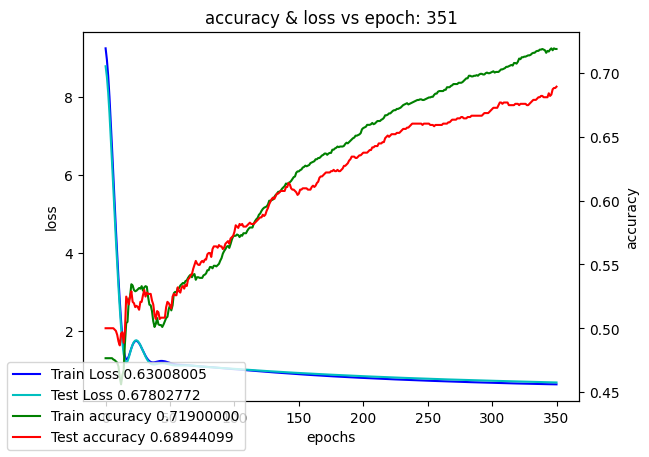

Training model color_cnn_multi_kernel_multi_layer:   4%|▎         | 360/10000 [13:32<5:57:33,  2.23s/it]

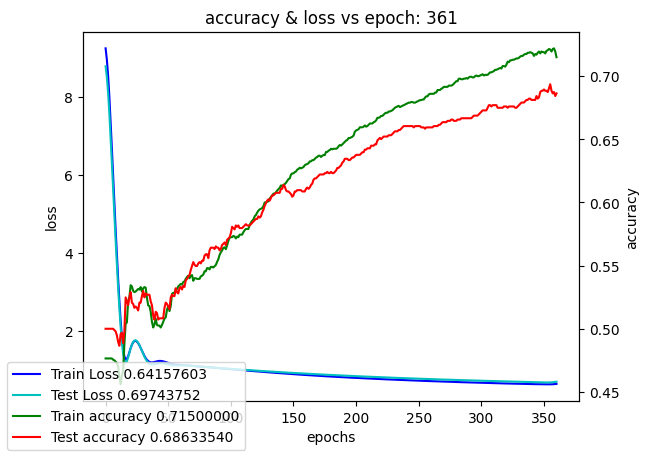

Training model color_cnn_multi_kernel_multi_layer:   4%|▎         | 370/10000 [13:55<5:57:13,  2.23s/it]

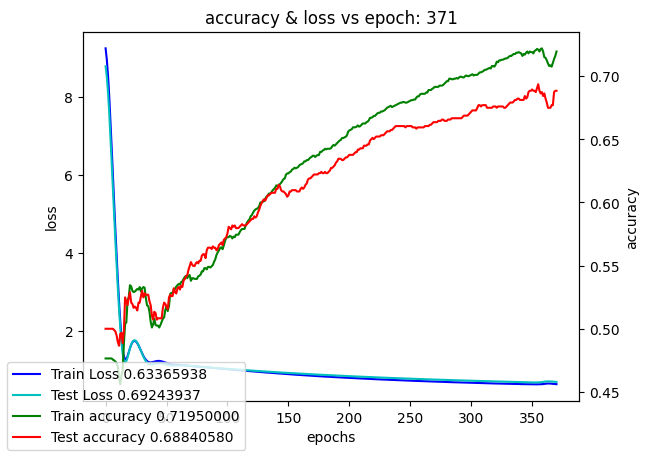

Training model color_cnn_multi_kernel_multi_layer:   4%|▍         | 380/10000 [14:17<5:56:39,  2.22s/it]

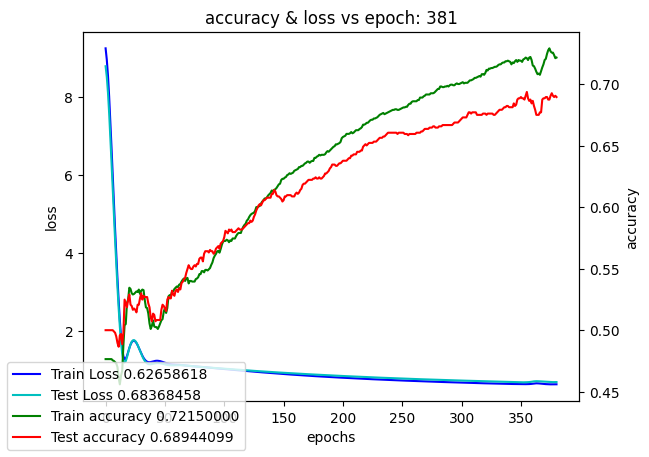

Training model color_cnn_multi_kernel_multi_layer:   4%|▍         | 390/10000 [14:40<5:57:00,  2.23s/it]

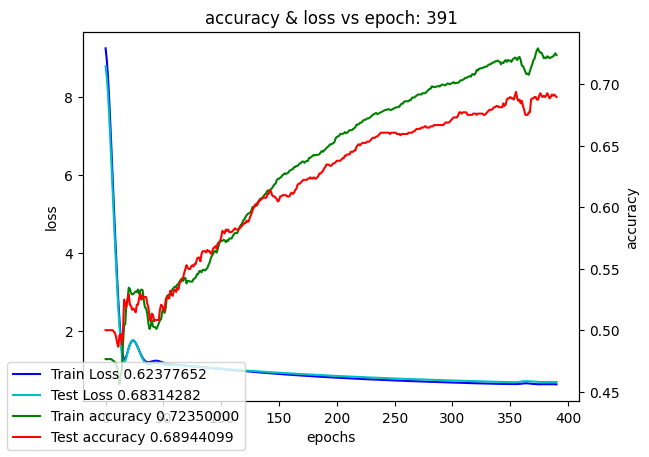

Training model color_cnn_multi_kernel_multi_layer:   4%|▍         | 400/10000 [15:02<5:57:27,  2.23s/it]

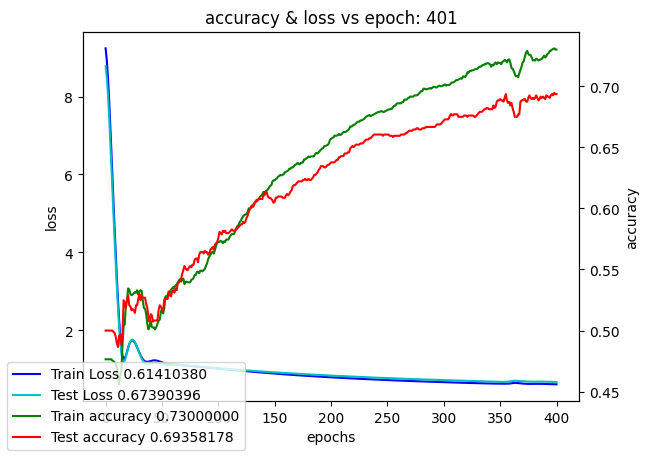

Training model color_cnn_multi_kernel_multi_layer:   4%|▍         | 410/10000 [15:25<5:57:42,  2.24s/it]

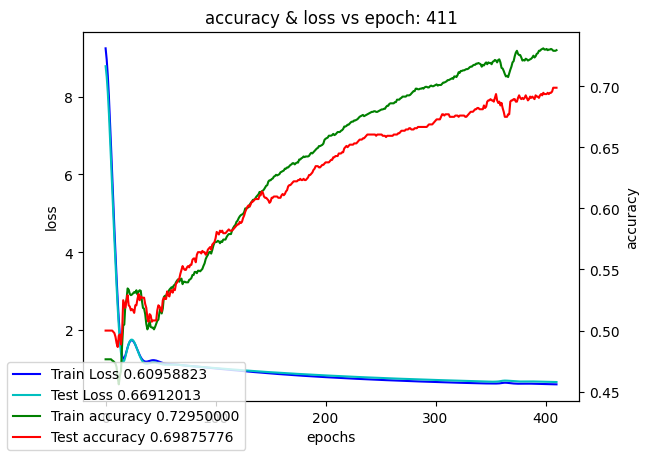

Training model color_cnn_multi_kernel_multi_layer:   4%|▍         | 420/10000 [15:47<5:58:55,  2.25s/it]

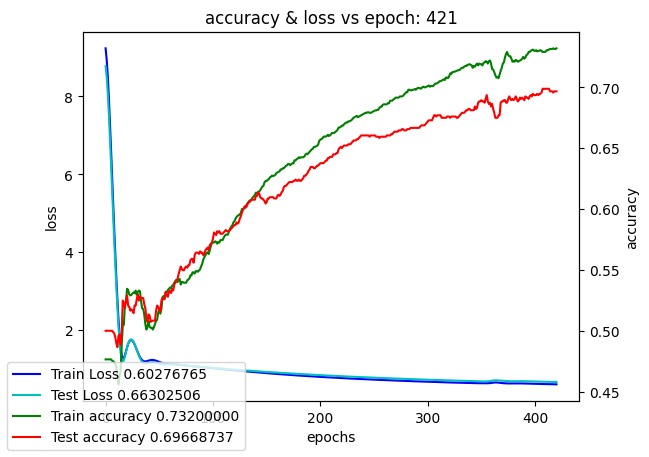

Training model color_cnn_multi_kernel_multi_layer:   4%|▍         | 430/10000 [16:10<5:56:23,  2.23s/it]

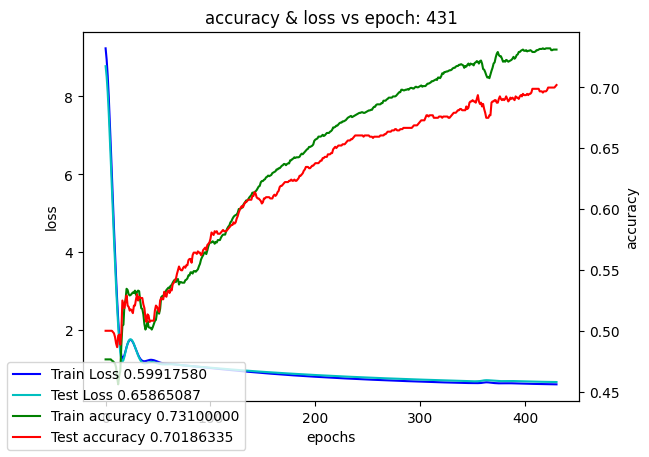

Training model color_cnn_multi_kernel_multi_layer:   4%|▍         | 440/10000 [16:32<5:56:11,  2.24s/it]

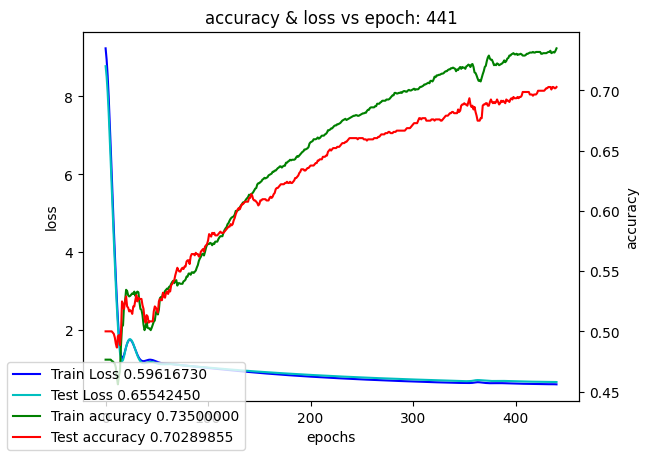

Training model color_cnn_multi_kernel_multi_layer:   4%|▍         | 450/10000 [16:55<5:54:51,  2.23s/it]

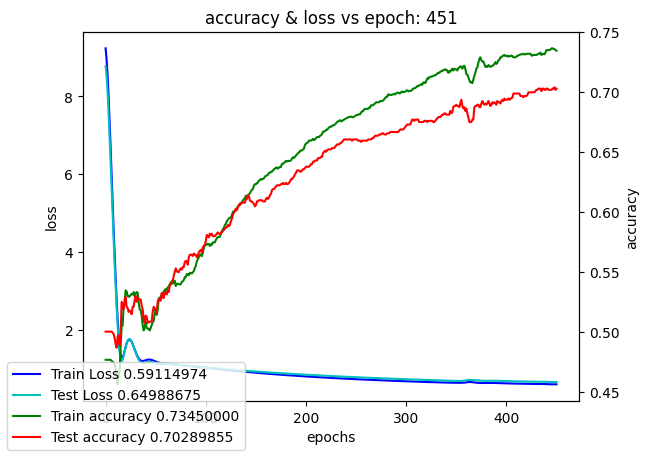

Training model color_cnn_multi_kernel_multi_layer:   5%|▍         | 460/10000 [17:18<5:57:44,  2.25s/it]

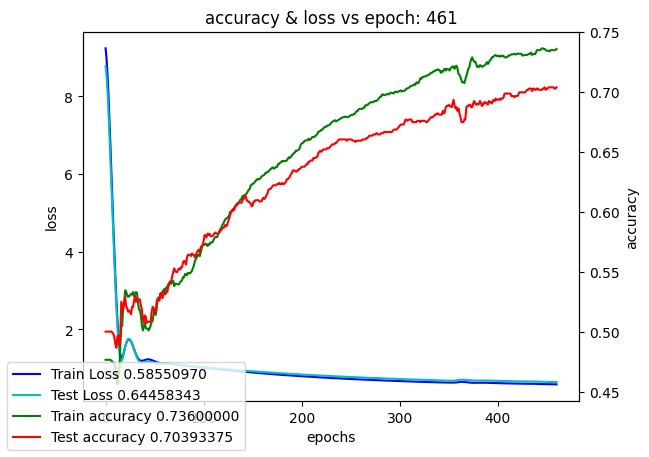

Training model color_cnn_multi_kernel_multi_layer:   5%|▍         | 470/10000 [17:40<5:57:15,  2.25s/it]

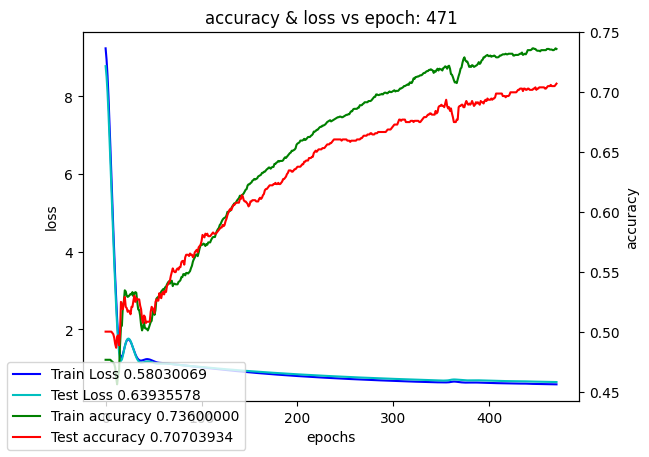

Training model color_cnn_multi_kernel_multi_layer:   5%|▍         | 480/10000 [18:03<5:55:07,  2.24s/it]

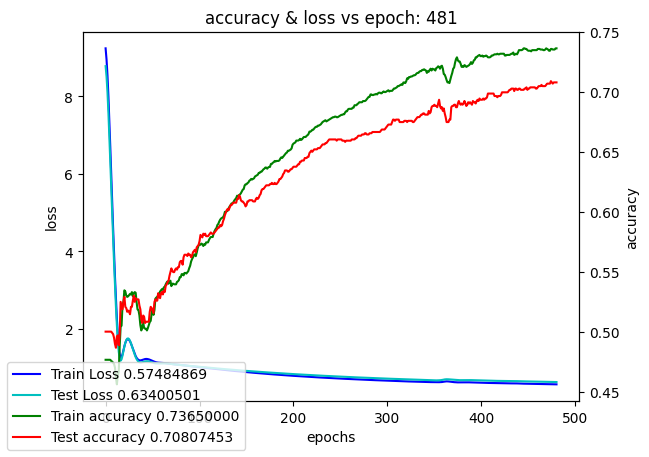

Training model color_cnn_multi_kernel_multi_layer:   5%|▍         | 490/10000 [18:25<5:56:23,  2.25s/it]

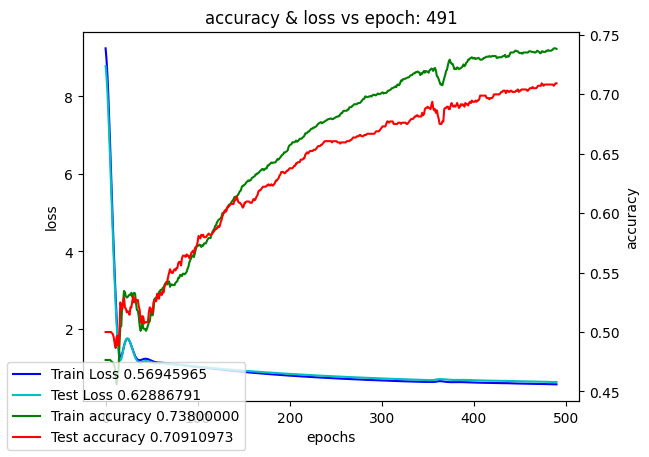

Training model color_cnn_multi_kernel_multi_layer:   5%|▌         | 500/10000 [18:48<5:58:40,  2.27s/it]

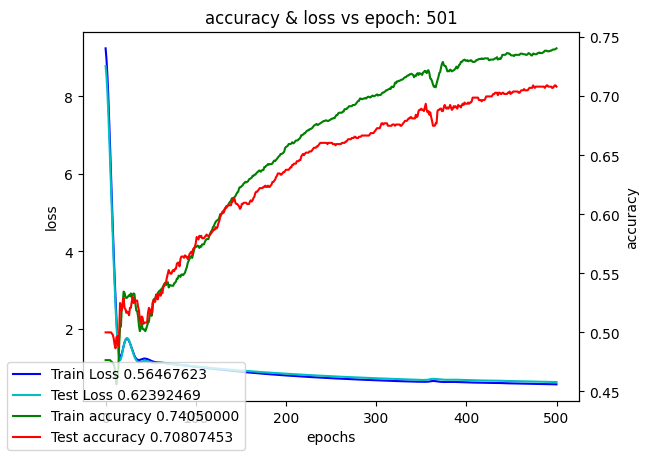

Training model color_cnn_multi_kernel_multi_layer:   5%|▌         | 510/10000 [19:11<5:55:08,  2.25s/it]

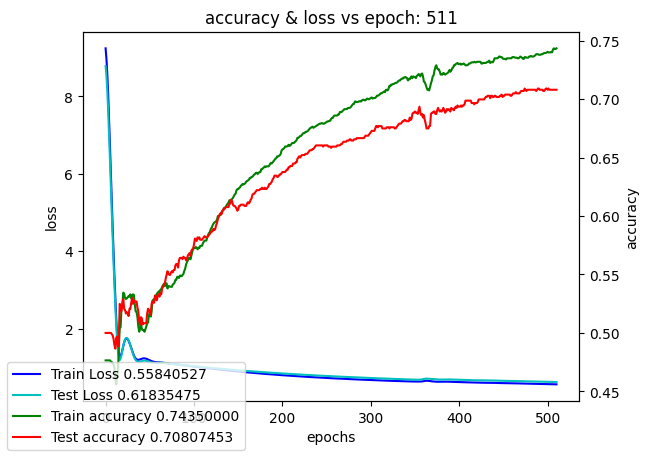

Training model color_cnn_multi_kernel_multi_layer:   5%|▌         | 520/10000 [19:33<5:52:22,  2.23s/it]

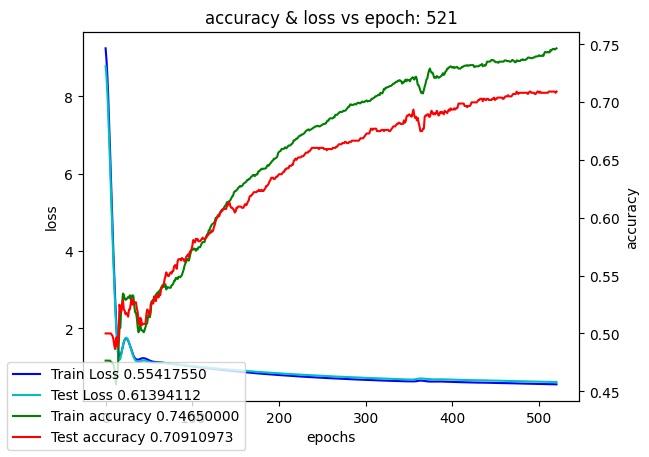

Training model color_cnn_multi_kernel_multi_layer:   5%|▌         | 530/10000 [19:56<5:52:36,  2.23s/it]

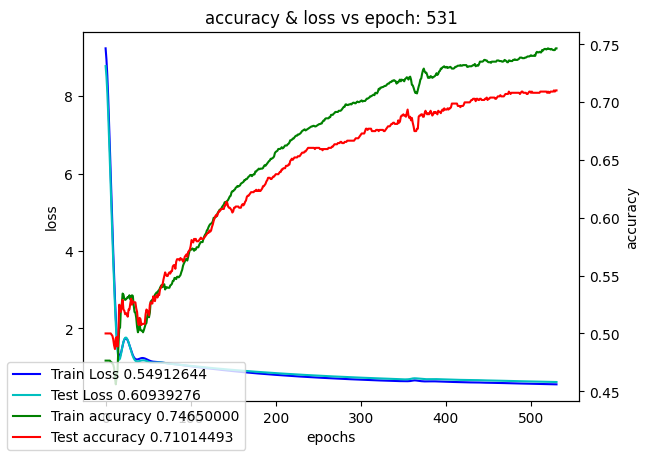

Training model color_cnn_multi_kernel_multi_layer:   5%|▌         | 540/10000 [20:18<5:51:11,  2.23s/it]

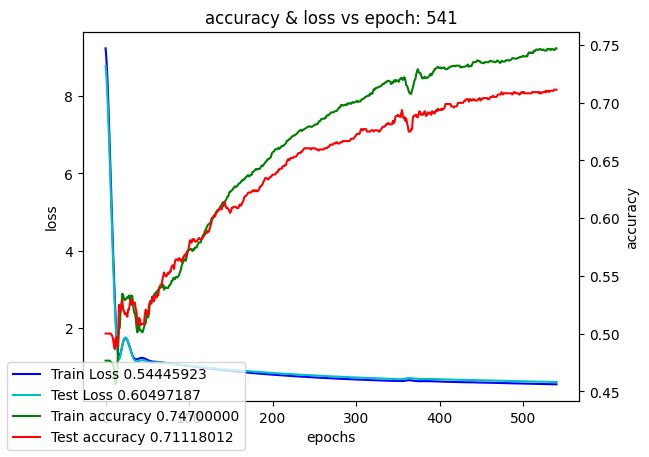

Training model color_cnn_multi_kernel_multi_layer:   6%|▌         | 550/10000 [20:41<5:50:37,  2.23s/it]

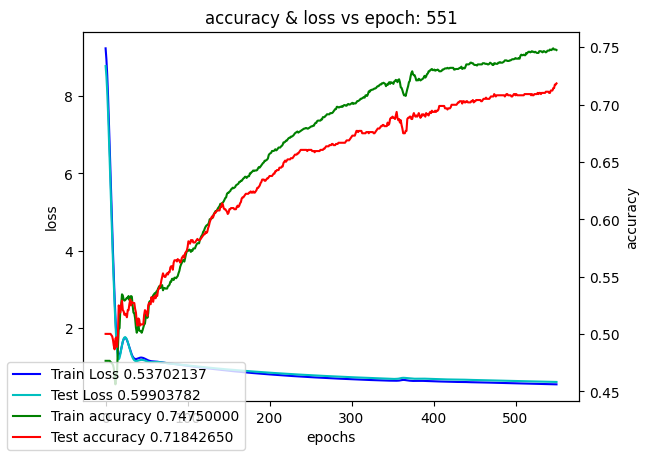

Training model color_cnn_multi_kernel_multi_layer:   6%|▌         | 560/10000 [21:03<5:51:20,  2.23s/it]

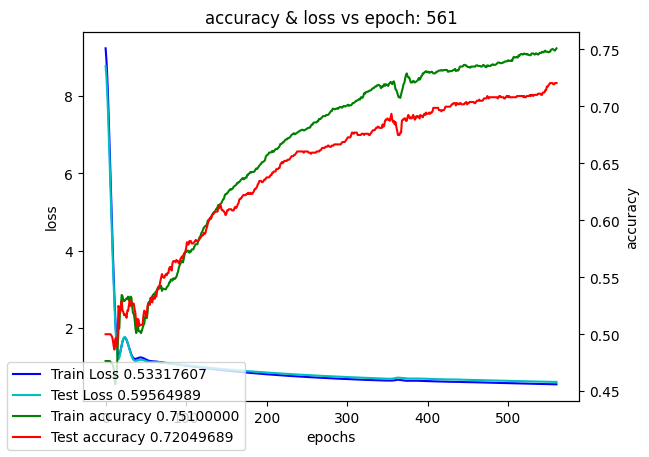

Training model color_cnn_multi_kernel_multi_layer:   6%|▌         | 570/10000 [21:26<5:51:49,  2.24s/it]

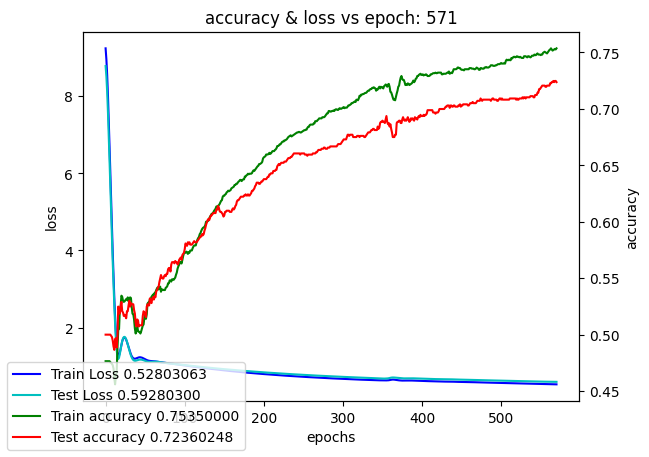

Training model color_cnn_multi_kernel_multi_layer:   6%|▌         | 580/10000 [21:48<5:49:48,  2.23s/it]

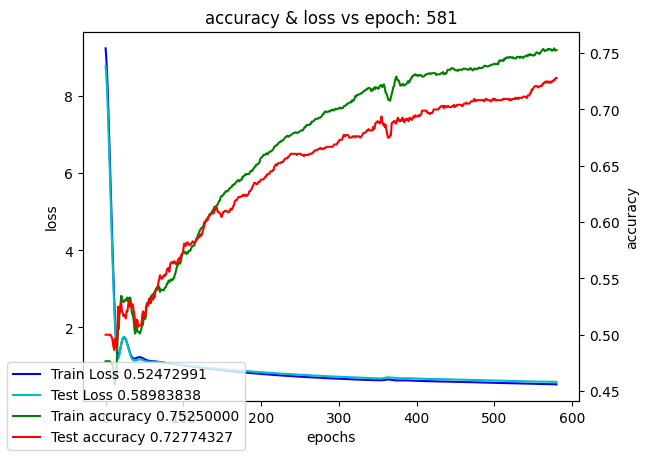

Training model color_cnn_multi_kernel_multi_layer:   6%|▌         | 590/10000 [22:11<5:51:05,  2.24s/it]

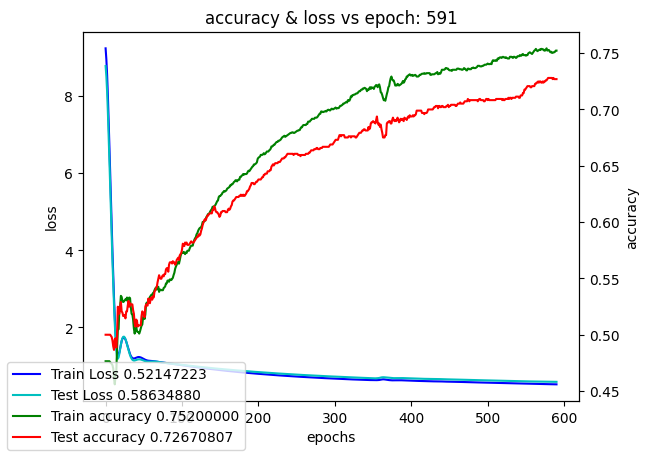

Training model color_cnn_multi_kernel_multi_layer:   6%|▌         | 600/10000 [22:33<5:49:52,  2.23s/it]

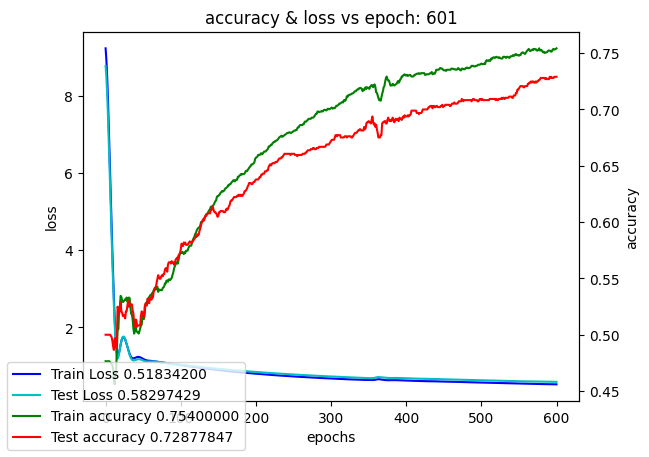

Training model color_cnn_multi_kernel_multi_layer:   6%|▌         | 610/10000 [22:56<5:50:40,  2.24s/it]

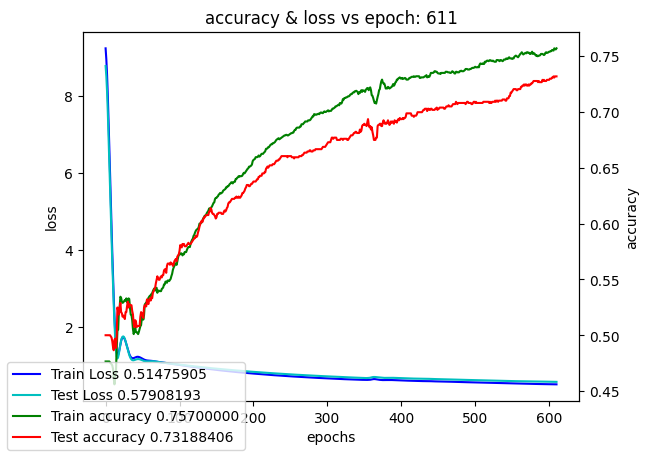

Training model color_cnn_multi_kernel_multi_layer:   6%|▌         | 620/10000 [23:19<5:49:12,  2.23s/it]

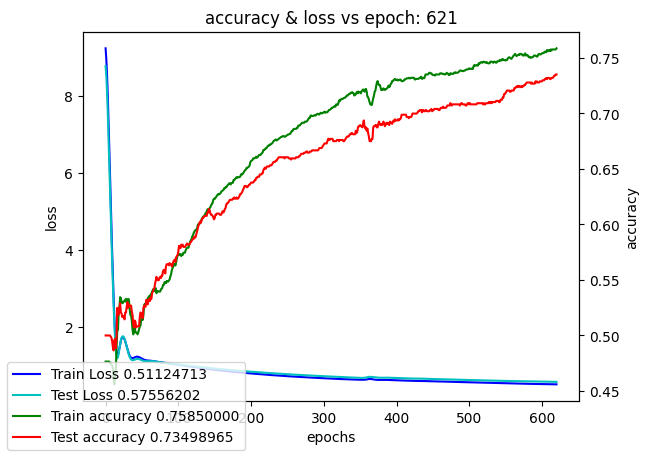

Training model color_cnn_multi_kernel_multi_layer:   6%|▋         | 630/10000 [23:41<5:46:57,  2.22s/it]

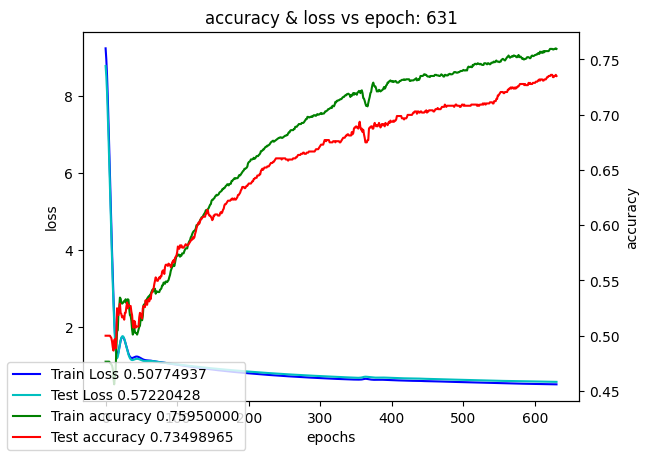

Training model color_cnn_multi_kernel_multi_layer:   6%|▋         | 640/10000 [24:03<5:47:44,  2.23s/it]

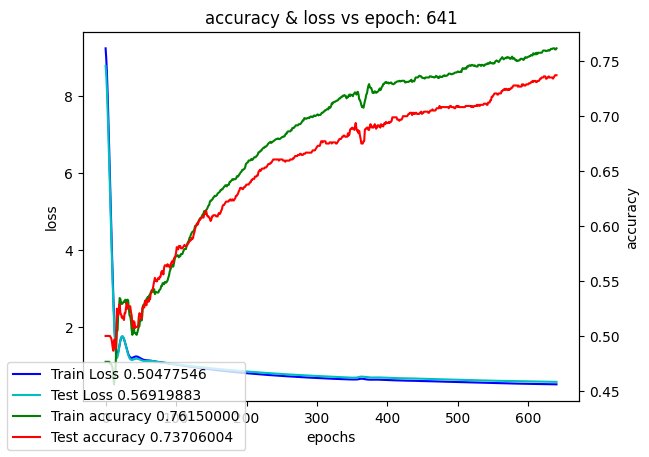

Training model color_cnn_multi_kernel_multi_layer:   6%|▋         | 650/10000 [24:26<5:48:37,  2.24s/it]

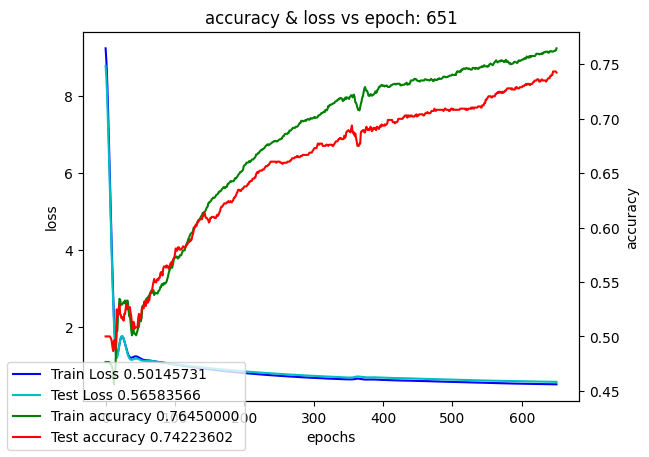

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 660/10000 [24:49<5:49:03,  2.24s/it]

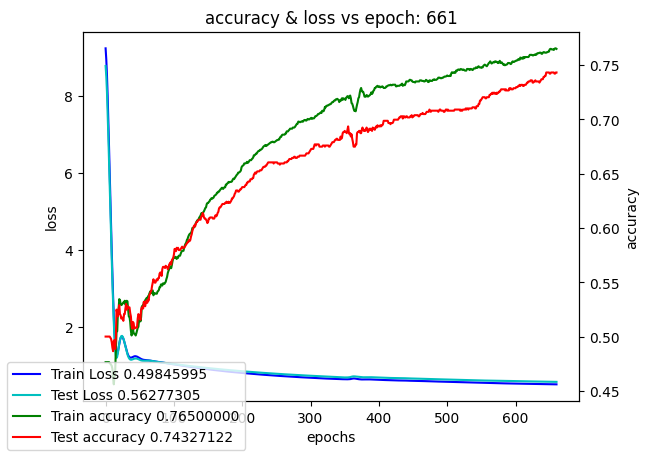

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 670/10000 [25:11<5:46:05,  2.23s/it]

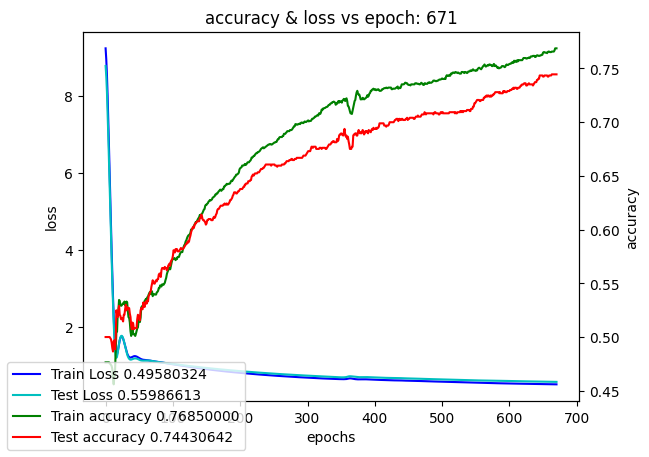

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 680/10000 [25:34<5:48:24,  2.24s/it]

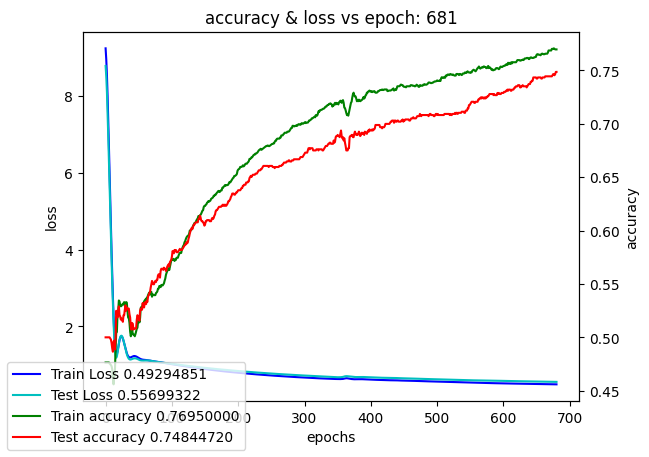

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 690/10000 [25:56<5:46:59,  2.24s/it]

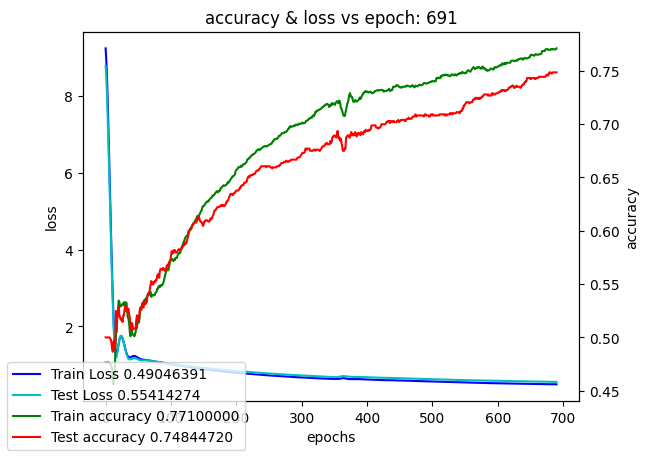

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 700/10000 [26:19<5:46:51,  2.24s/it]

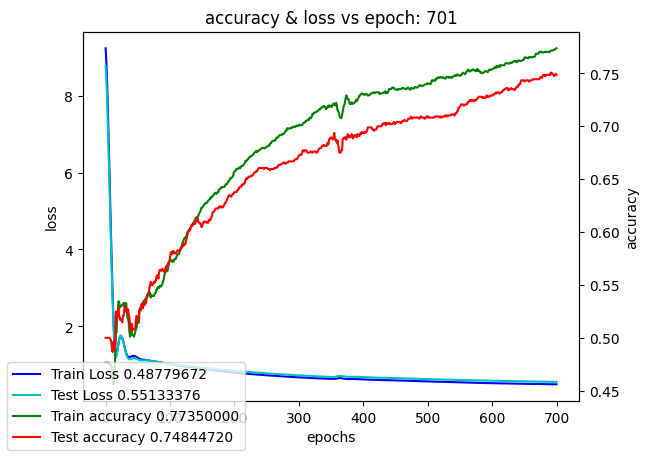

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 710/10000 [26:41<5:46:52,  2.24s/it]

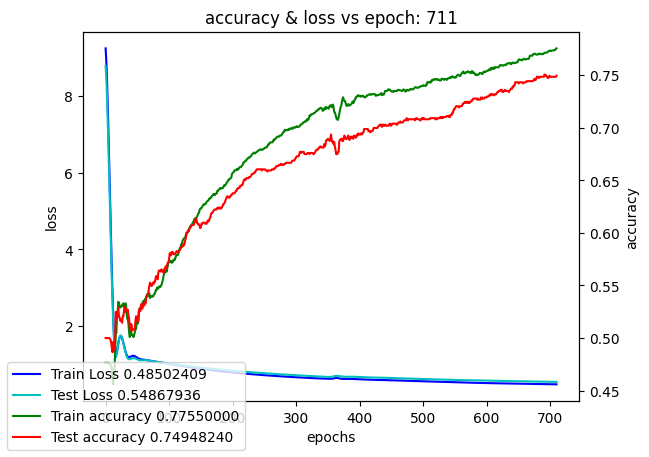

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 720/10000 [27:04<5:45:37,  2.23s/it]

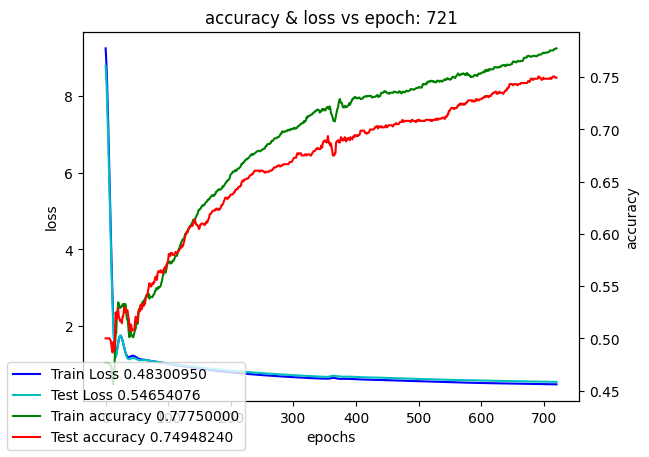

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 730/10000 [27:26<5:45:42,  2.24s/it]

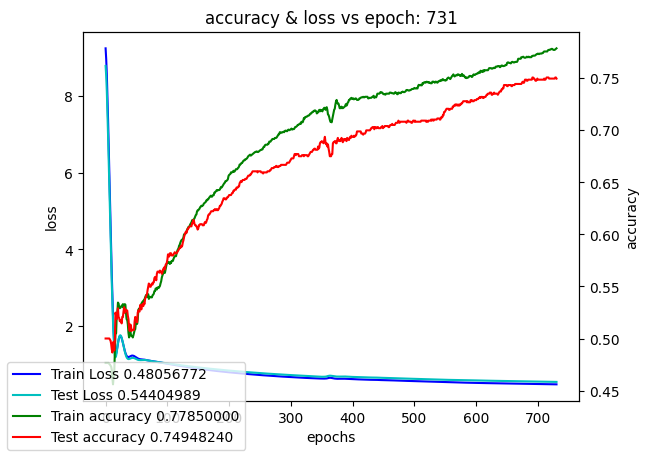

Training model color_cnn_multi_kernel_multi_layer:   7%|▋         | 740/10000 [27:49<5:45:23,  2.24s/it]

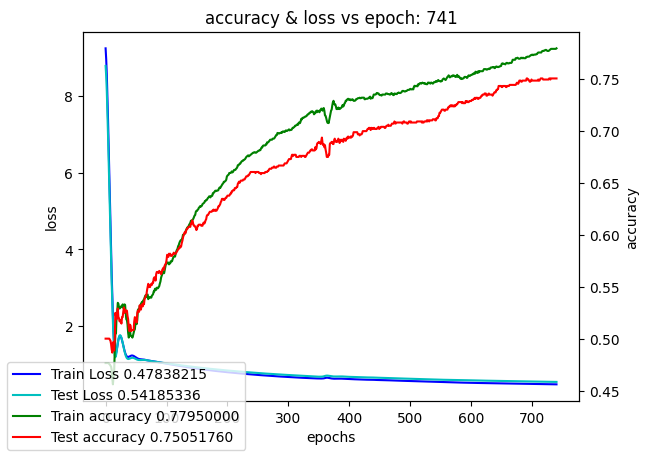

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 750/10000 [28:12<5:47:14,  2.25s/it]

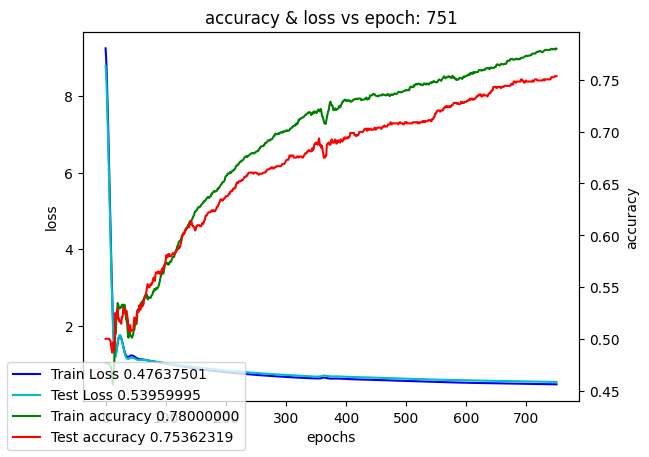

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 760/10000 [28:34<5:44:55,  2.24s/it]

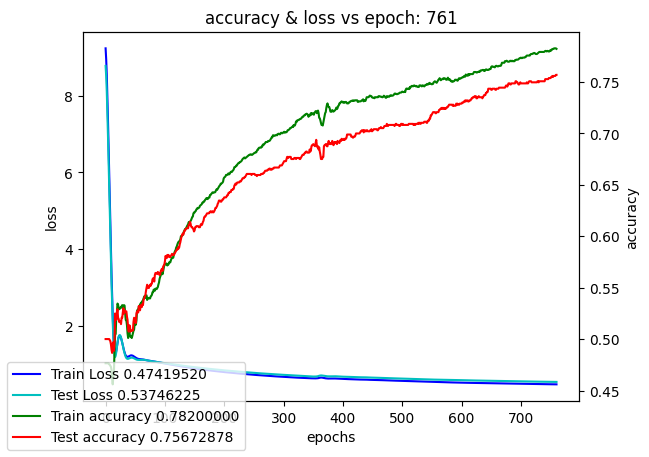

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 770/10000 [28:57<5:45:02,  2.24s/it]

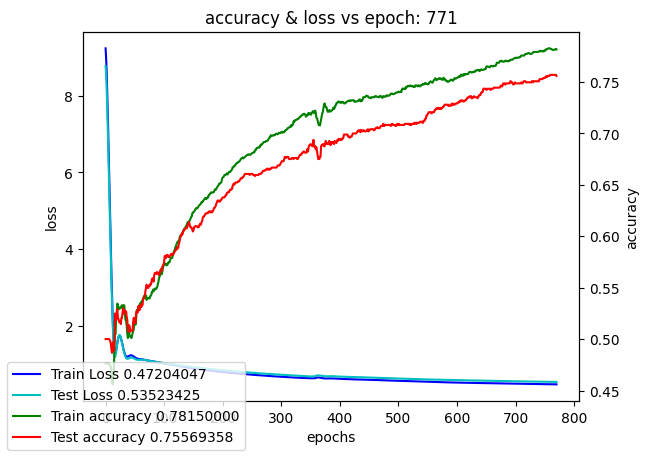

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 780/10000 [29:20<5:46:53,  2.26s/it]

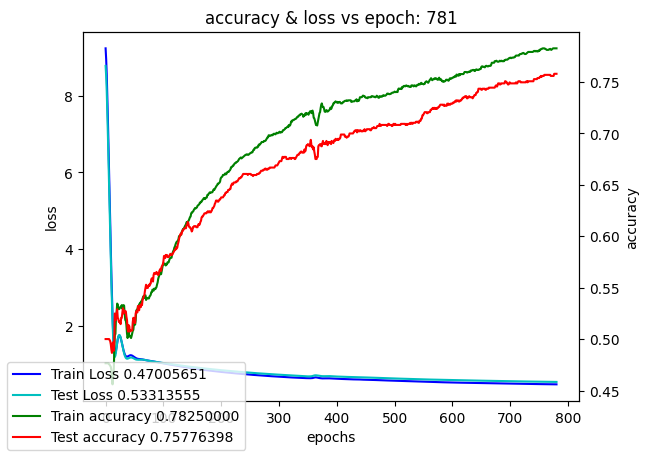

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 790/10000 [29:42<5:44:19,  2.24s/it]

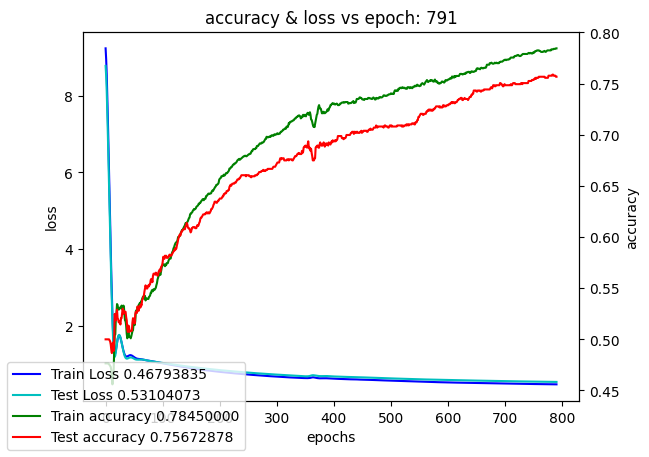

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 800/10000 [30:05<5:44:36,  2.25s/it]

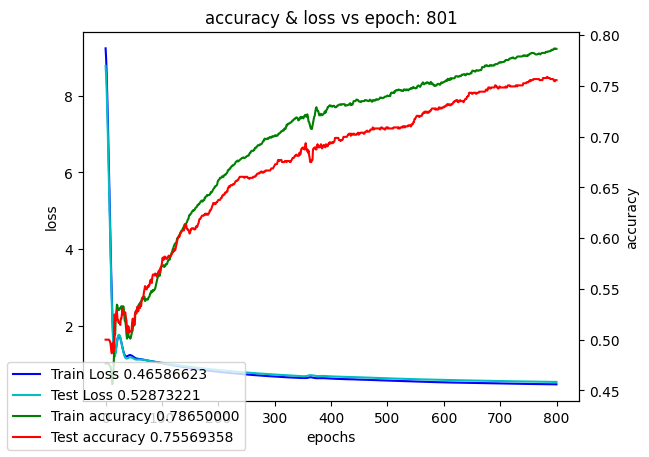

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 810/10000 [30:28<5:47:05,  2.27s/it]

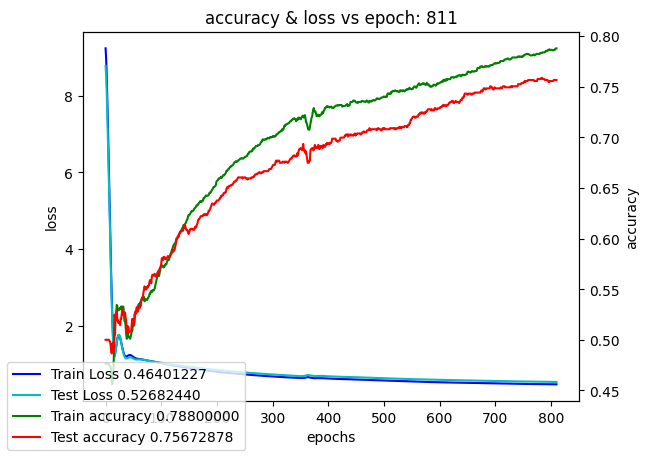

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 820/10000 [30:51<5:41:47,  2.23s/it]

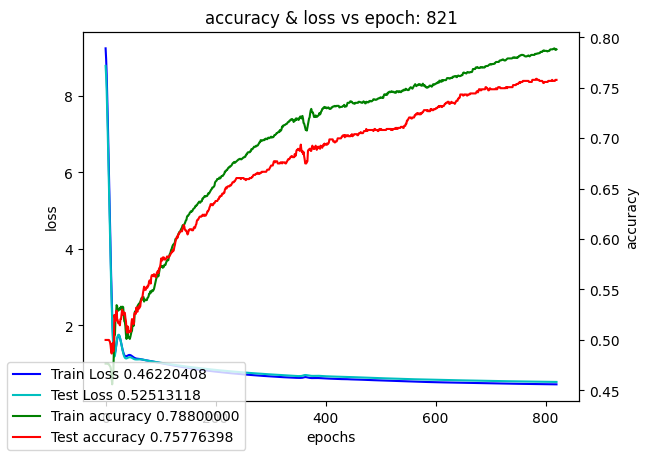

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 830/10000 [31:13<5:42:46,  2.24s/it]

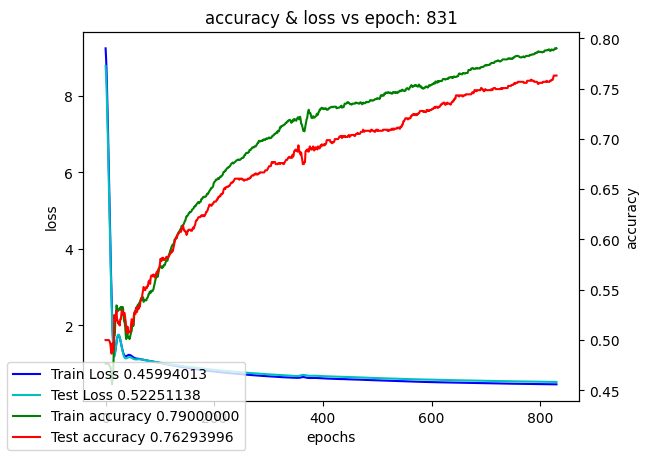

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 840/10000 [31:36<5:40:34,  2.23s/it]

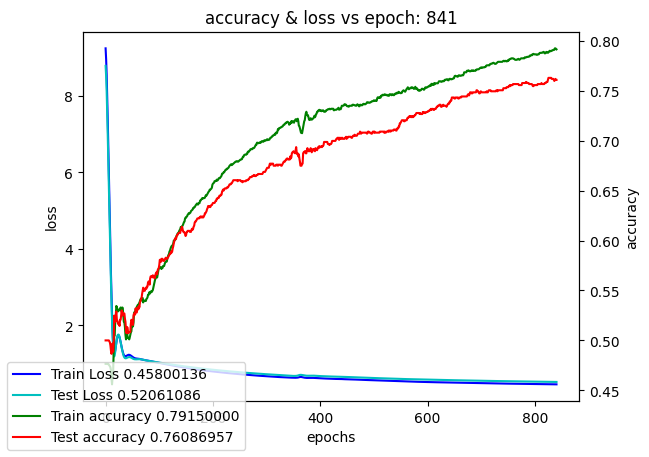

Training model color_cnn_multi_kernel_multi_layer:   8%|▊         | 850/10000 [31:58<5:39:23,  2.23s/it]

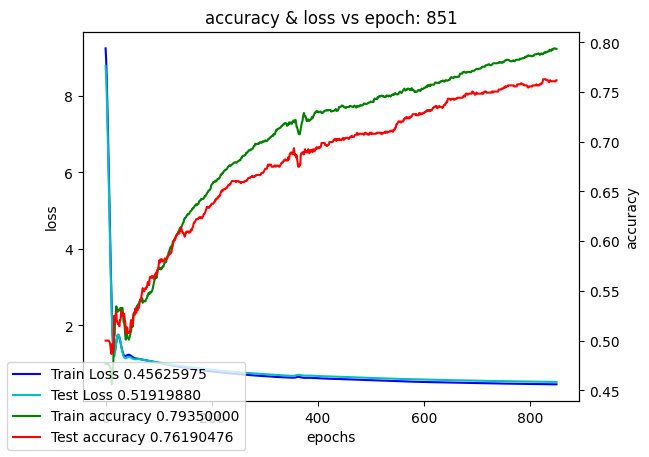

Training model color_cnn_multi_kernel_multi_layer:   9%|▊         | 860/10000 [32:21<5:41:10,  2.24s/it]

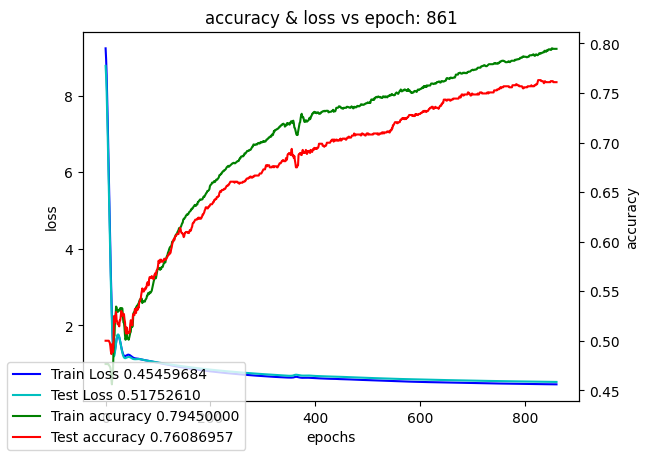

Training model color_cnn_multi_kernel_multi_layer:   9%|▊         | 870/10000 [32:43<5:41:23,  2.24s/it]

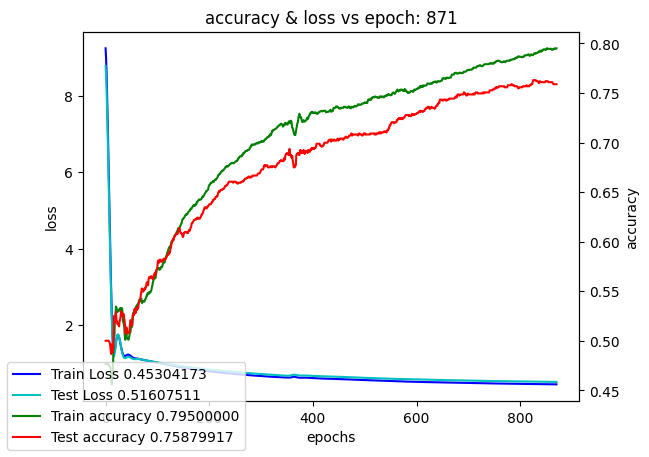

Training model color_cnn_multi_kernel_multi_layer:   9%|▉         | 880/10000 [33:06<5:39:07,  2.23s/it]

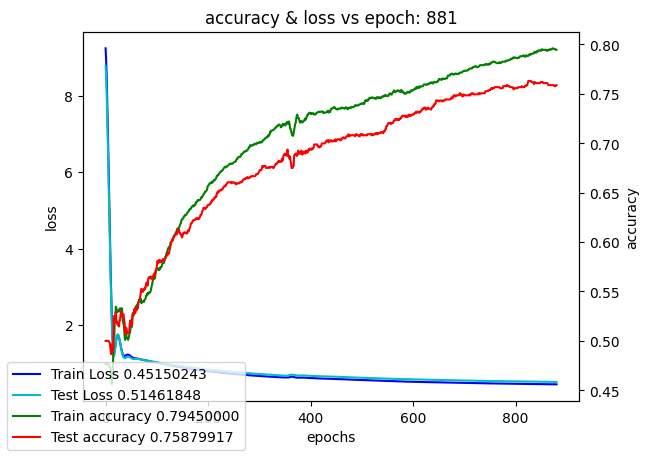

Training model color_cnn_multi_kernel_multi_layer:   9%|▉         | 890/10000 [33:28<5:39:01,  2.23s/it]

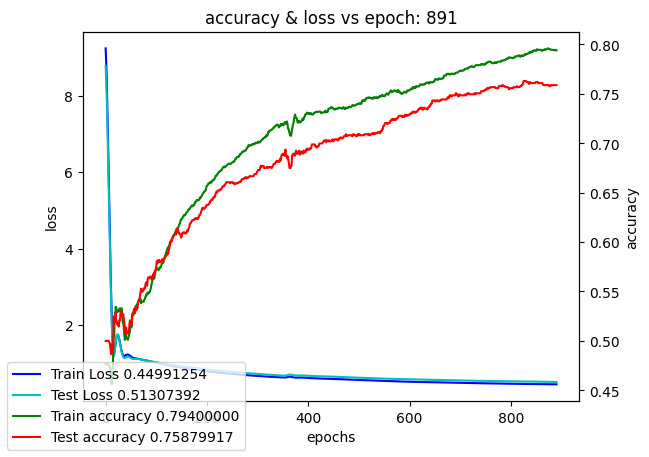

Training model color_cnn_multi_kernel_multi_layer:   9%|▉         | 900/10000 [33:51<5:38:51,  2.23s/it]

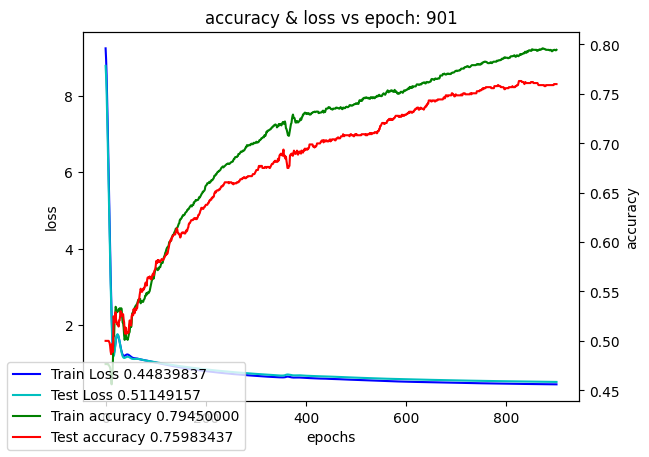

Training model color_cnn_multi_kernel_multi_layer:   9%|▉         | 910/10000 [34:13<5:38:41,  2.24s/it]

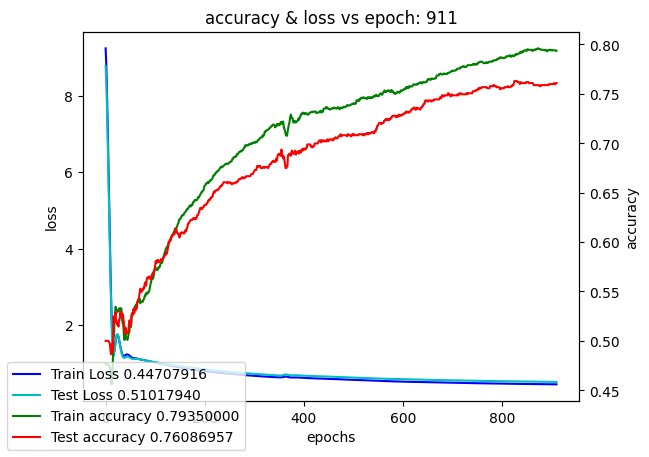

Training model color_cnn_multi_kernel_multi_layer:   9%|▉         | 920/10000 [34:36<5:39:07,  2.24s/it]

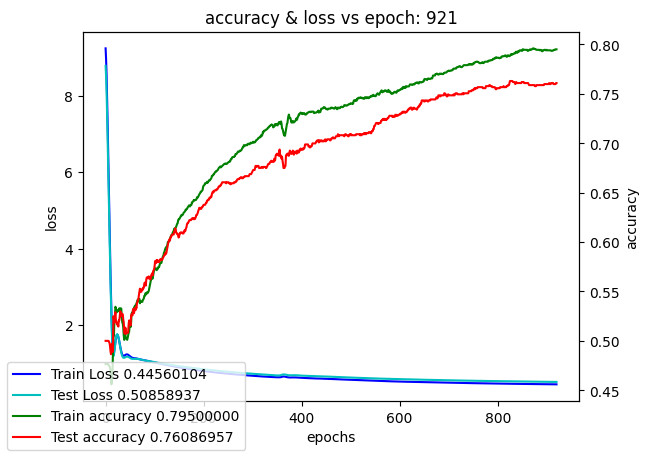

Training model color_cnn_multi_kernel_multi_layer:   9%|▉         | 930/10000 [34:59<5:38:12,  2.24s/it]

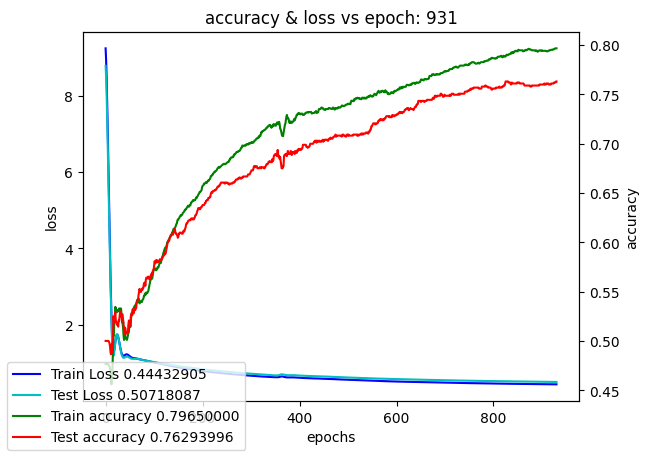

Training model color_cnn_multi_kernel_multi_layer:   9%|▉         | 940/10000 [35:21<5:37:39,  2.24s/it]

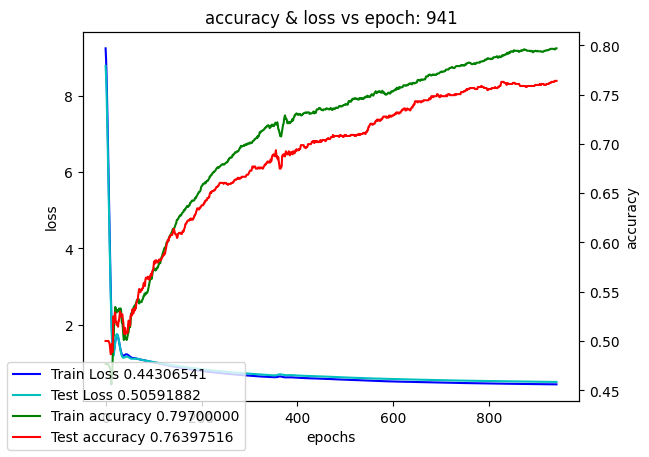

Training model color_cnn_multi_kernel_multi_layer:  10%|▉         | 950/10000 [35:44<5:37:16,  2.24s/it]

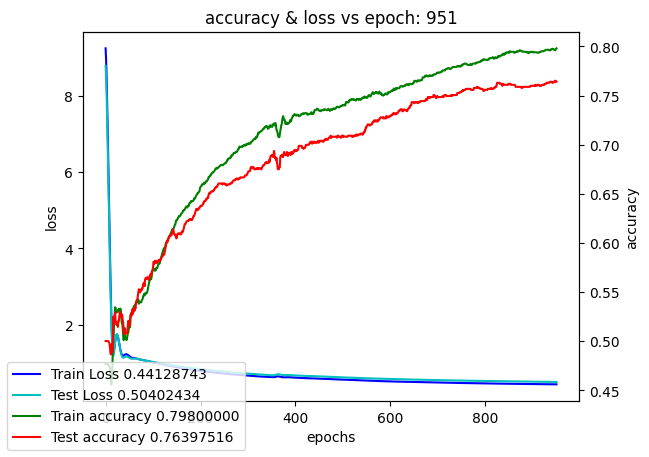

Training model color_cnn_multi_kernel_multi_layer:  10%|▉         | 960/10000 [36:06<5:36:50,  2.24s/it]

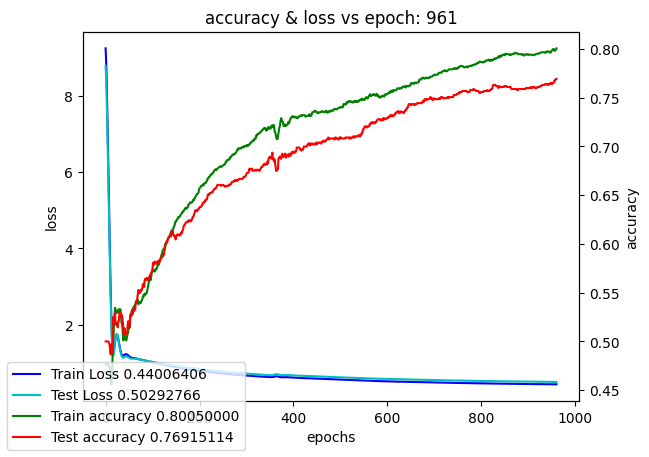

Training model color_cnn_multi_kernel_multi_layer:  10%|▉         | 970/10000 [36:29<5:36:05,  2.23s/it]

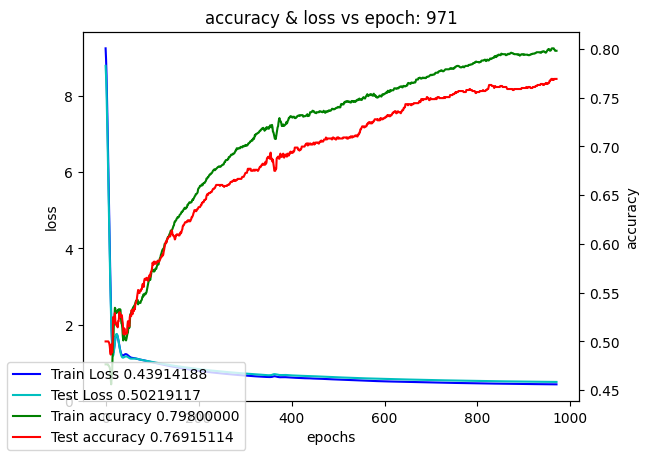

Training model color_cnn_multi_kernel_multi_layer:  10%|▉         | 980/10000 [36:51<5:36:19,  2.24s/it]

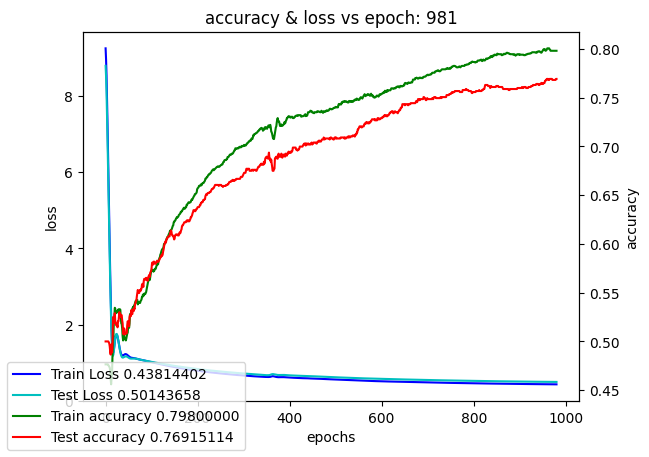

Training model color_cnn_multi_kernel_multi_layer:  10%|▉         | 990/10000 [37:14<5:34:29,  2.23s/it]

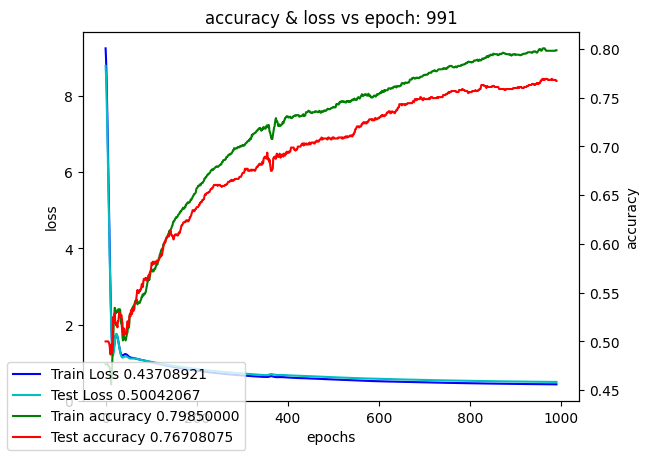

Training model color_cnn_multi_kernel_multi_layer:  10%|█         | 1000/10000 [37:36<5:35:03,  2.23s/it]

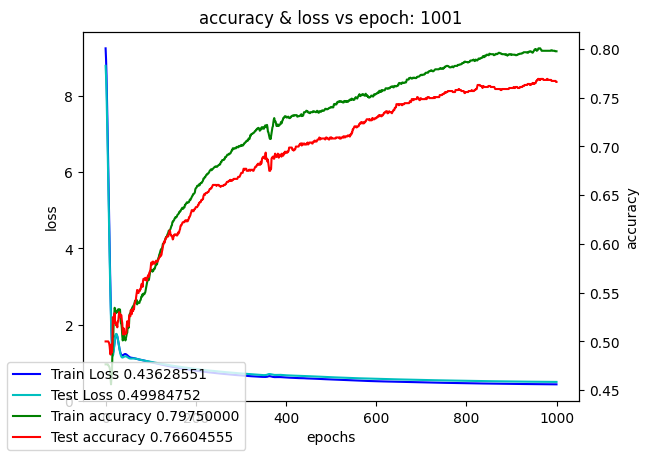

Training model color_cnn_multi_kernel_multi_layer:  10%|█         | 1010/10000 [37:59<5:34:50,  2.23s/it]

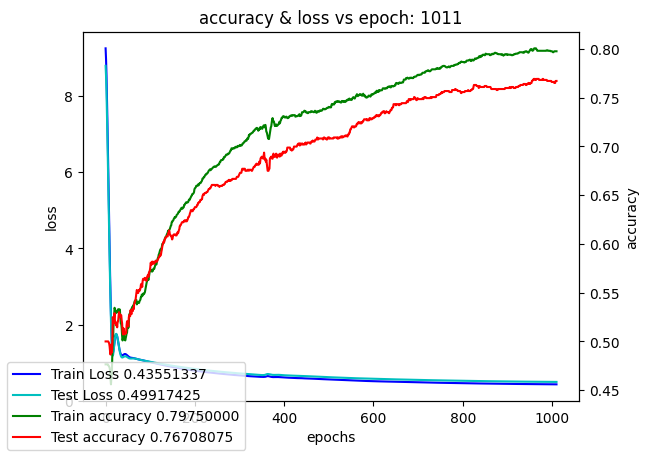

Training model color_cnn_multi_kernel_multi_layer:  10%|█         | 1020/10000 [38:21<5:35:37,  2.24s/it]

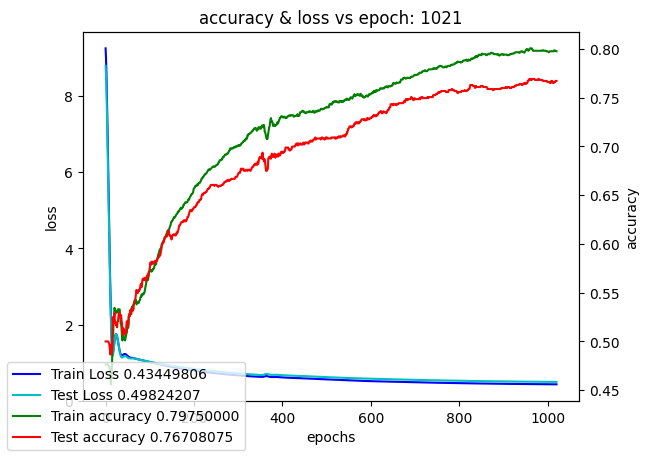

Training model color_cnn_multi_kernel_multi_layer:  10%|█         | 1030/10000 [38:44<5:33:33,  2.23s/it]

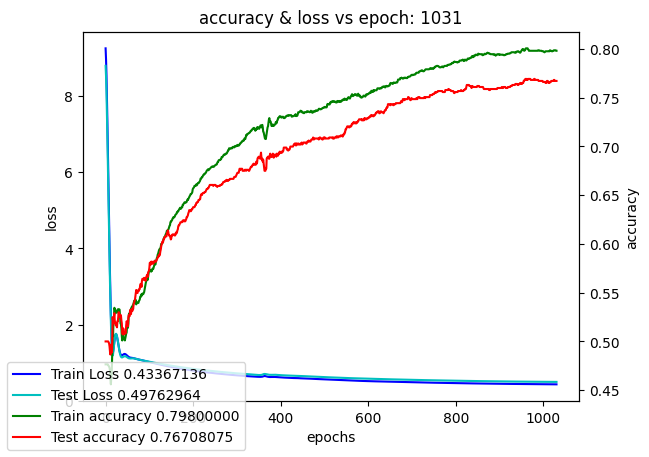

Training model color_cnn_multi_kernel_multi_layer:  10%|█         | 1040/10000 [39:06<5:32:01,  2.22s/it]

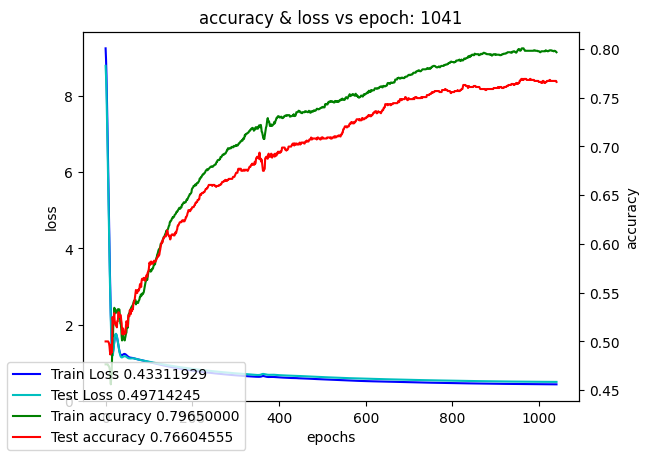

Training model color_cnn_multi_kernel_multi_layer:  10%|█         | 1050/10000 [39:29<5:32:15,  2.23s/it]

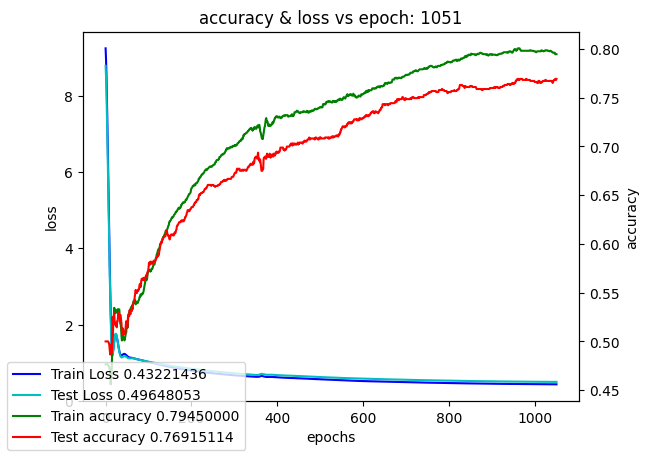

Training model color_cnn_multi_kernel_multi_layer:  11%|█         | 1060/10000 [39:51<5:32:02,  2.23s/it]

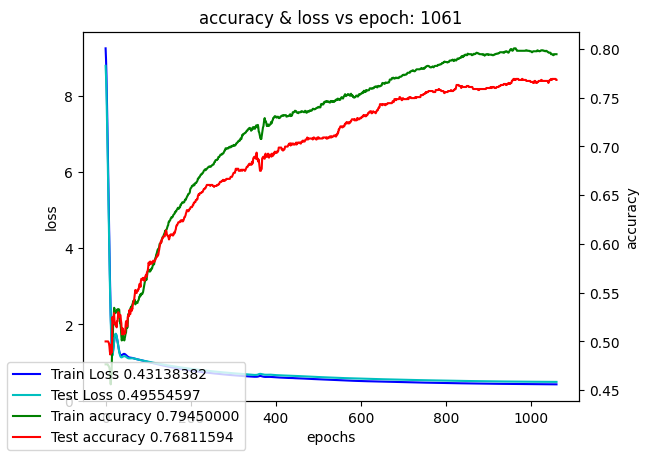

Training model color_cnn_multi_kernel_multi_layer:  11%|█         | 1070/10000 [40:14<5:32:51,  2.24s/it]

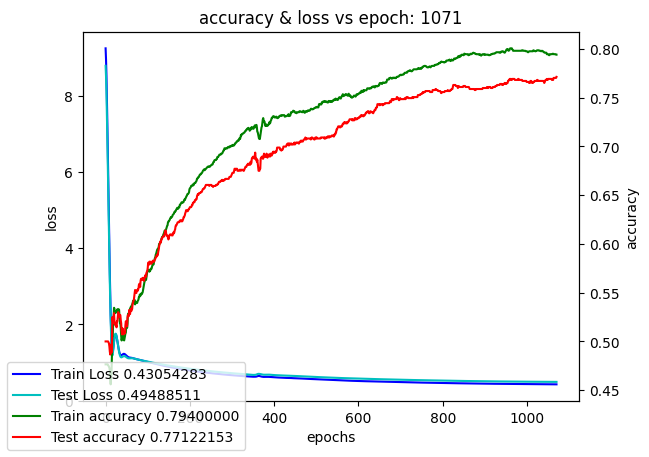

Training model color_cnn_multi_kernel_multi_layer:  11%|█         | 1080/10000 [40:36<5:32:32,  2.24s/it]

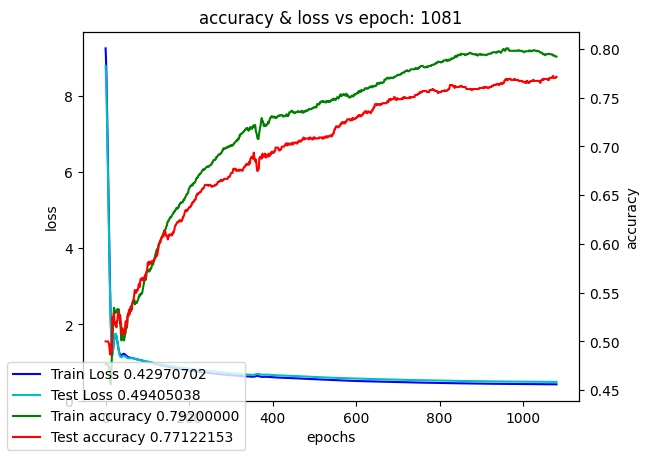

Training model color_cnn_multi_kernel_multi_layer:  11%|█         | 1090/10000 [40:59<5:31:40,  2.23s/it]

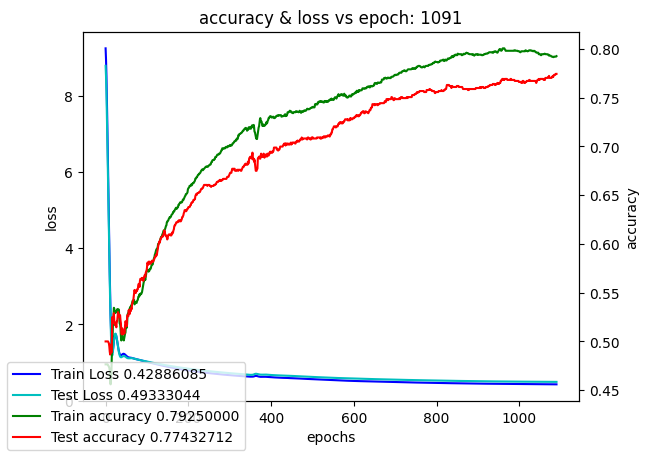

Training model color_cnn_multi_kernel_multi_layer:  11%|█         | 1100/10000 [41:21<5:30:09,  2.23s/it]

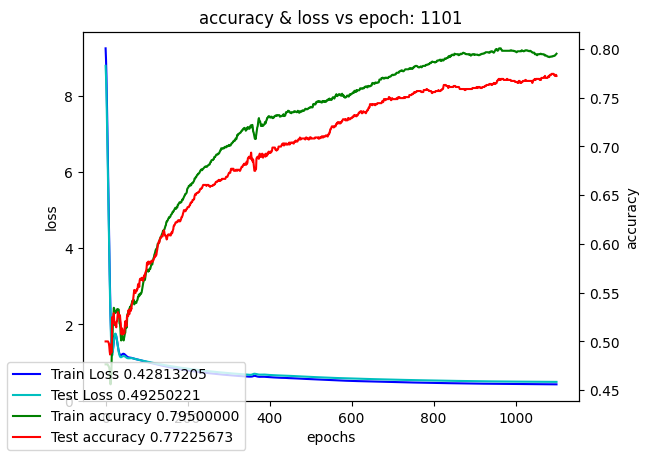

Training model color_cnn_multi_kernel_multi_layer:  11%|█         | 1110/10000 [41:44<5:30:42,  2.23s/it]

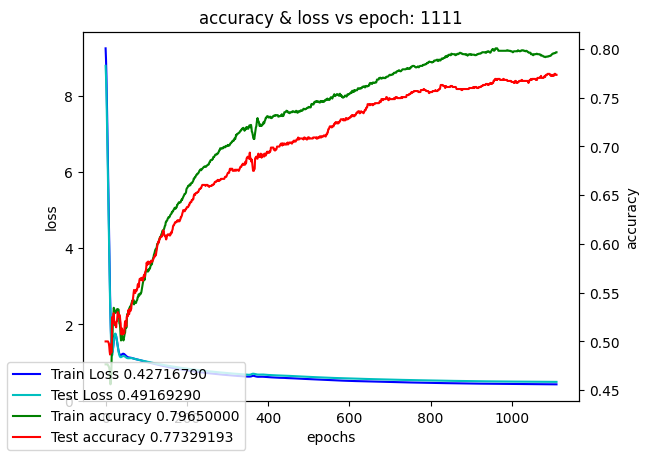

Training model color_cnn_multi_kernel_multi_layer:  11%|█         | 1120/10000 [42:06<5:30:25,  2.23s/it]

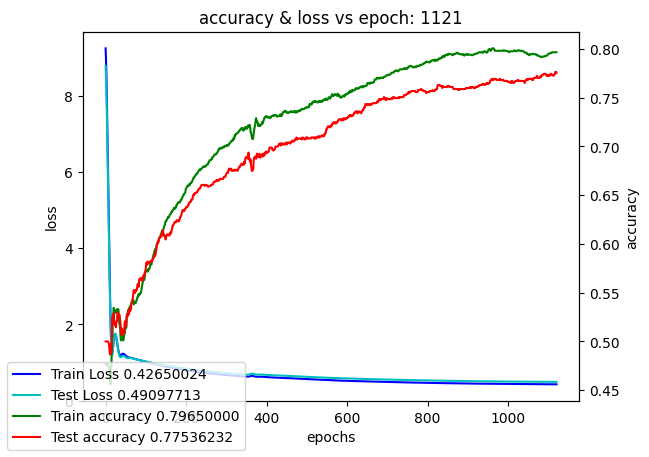

Training model color_cnn_multi_kernel_multi_layer:  11%|█▏        | 1130/10000 [42:29<5:28:48,  2.22s/it]

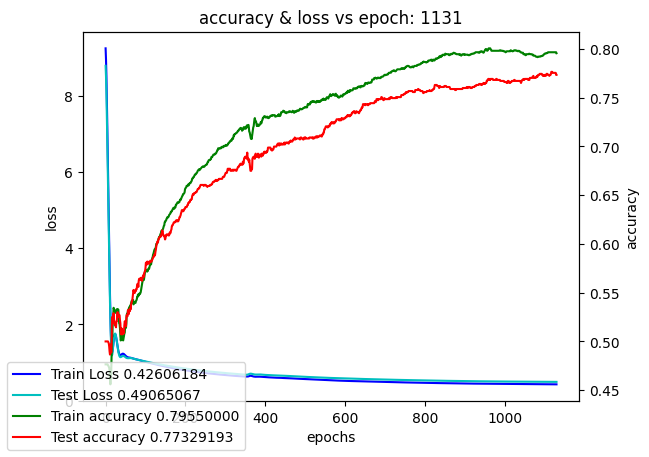

Training model color_cnn_multi_kernel_multi_layer:  11%|█▏        | 1140/10000 [42:51<5:29:59,  2.23s/it]

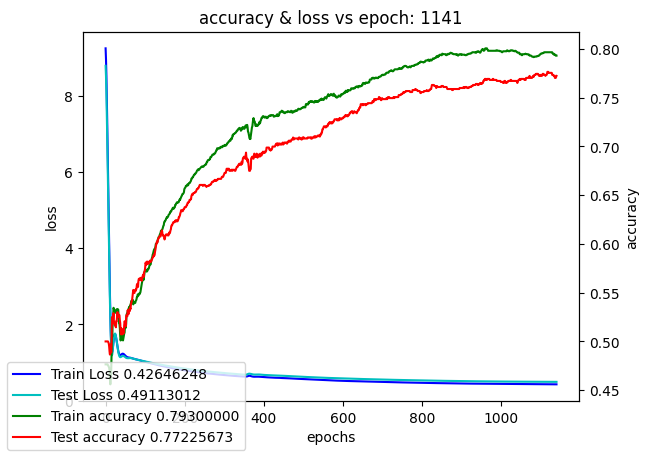

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1150/10000 [43:14<5:29:24,  2.23s/it]

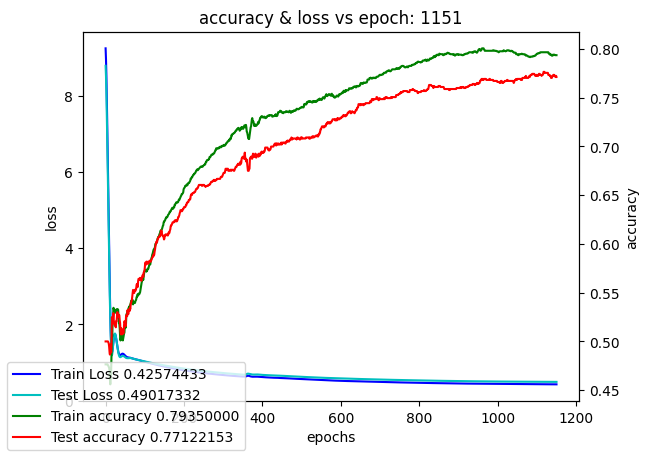

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1160/10000 [43:36<5:28:28,  2.23s/it]

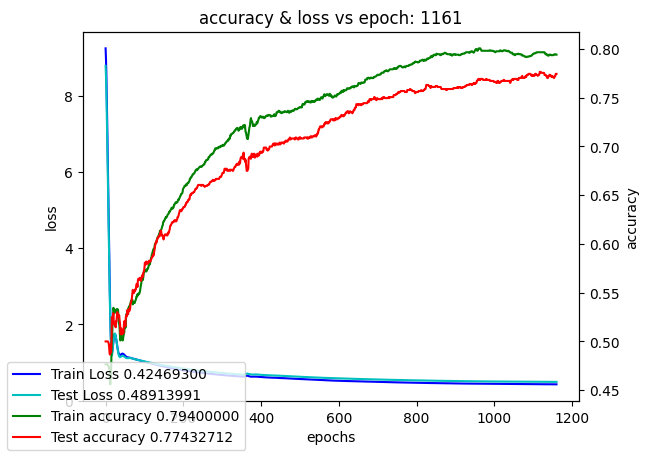

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1170/10000 [43:59<5:28:20,  2.23s/it]

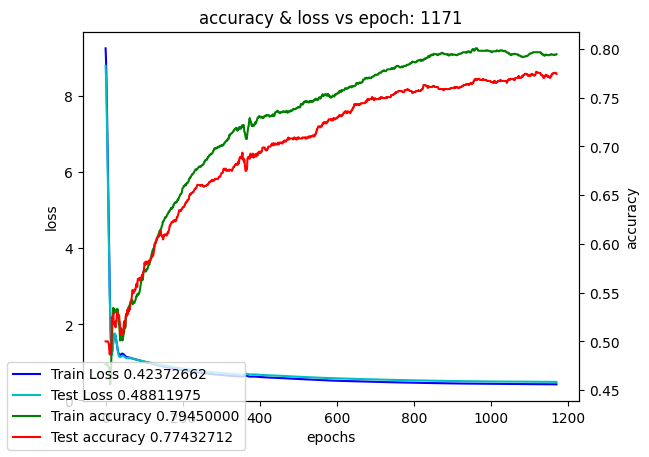

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1180/10000 [44:21<5:28:52,  2.24s/it]

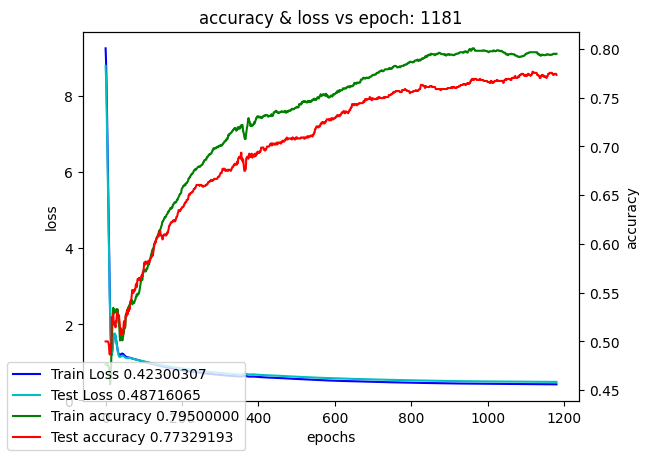

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1190/10000 [44:44<5:28:00,  2.23s/it]

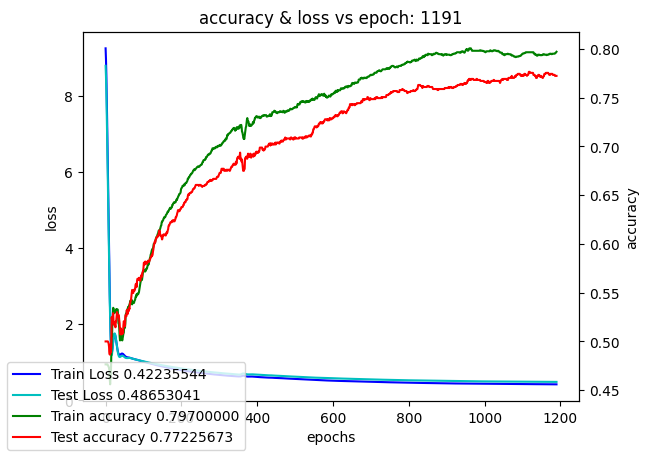

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1200/10000 [45:06<5:26:20,  2.23s/it]

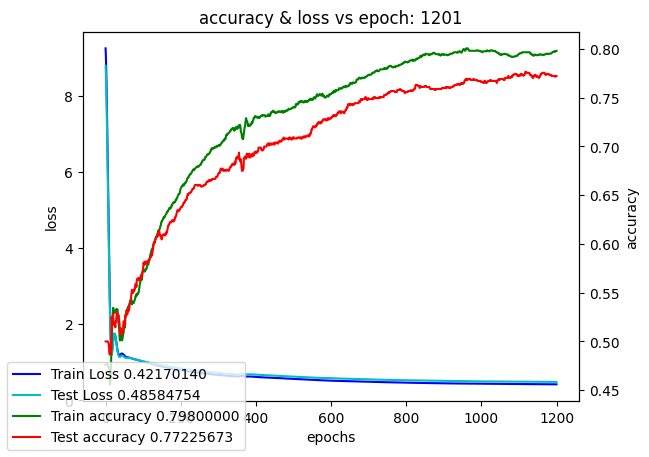

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1210/10000 [45:29<5:26:08,  2.23s/it]

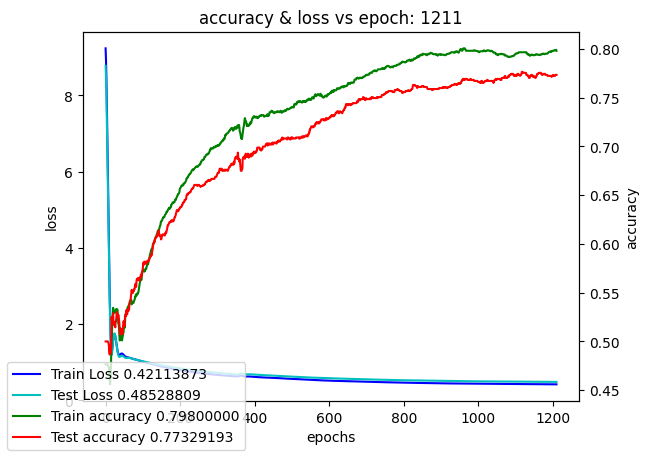

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1220/10000 [45:51<5:26:51,  2.23s/it]

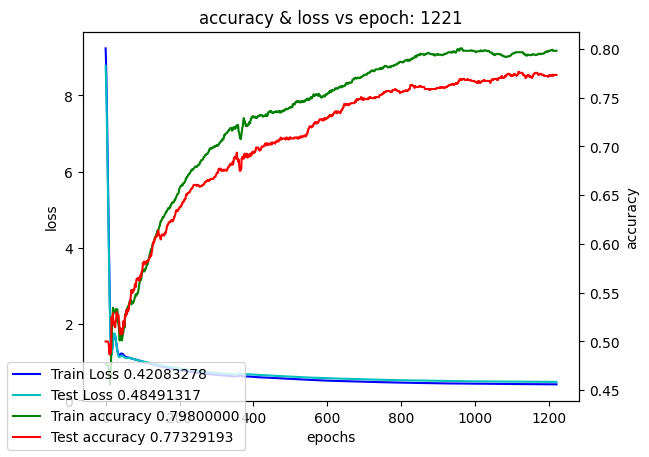

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1230/10000 [46:14<5:25:27,  2.23s/it]

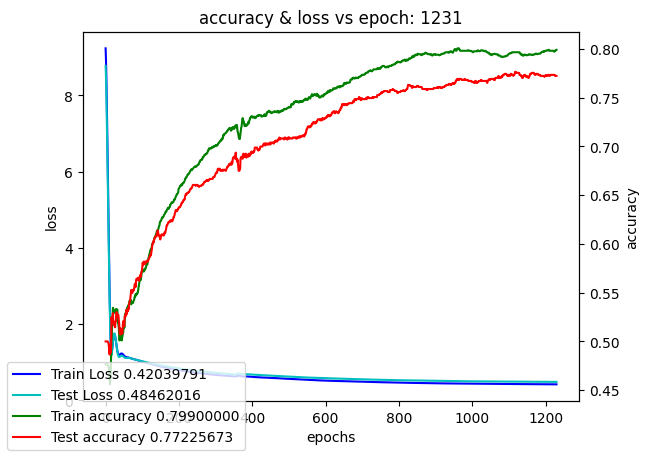

Training model color_cnn_multi_kernel_multi_layer:  12%|█▏        | 1240/10000 [46:36<5:25:41,  2.23s/it]

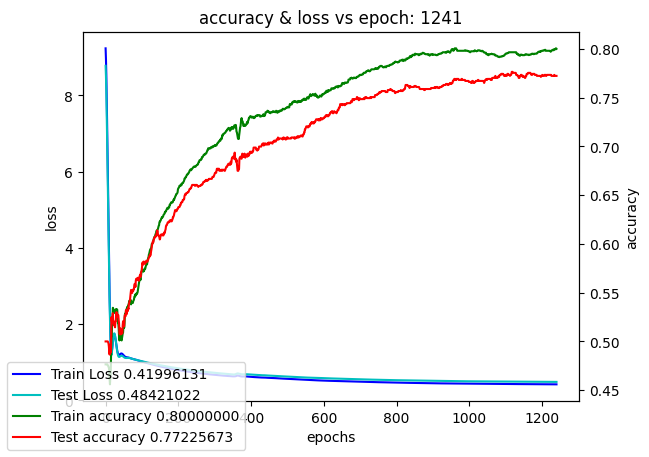

Training model color_cnn_multi_kernel_multi_layer:  12%|█▎        | 1250/10000 [46:59<5:25:34,  2.23s/it]

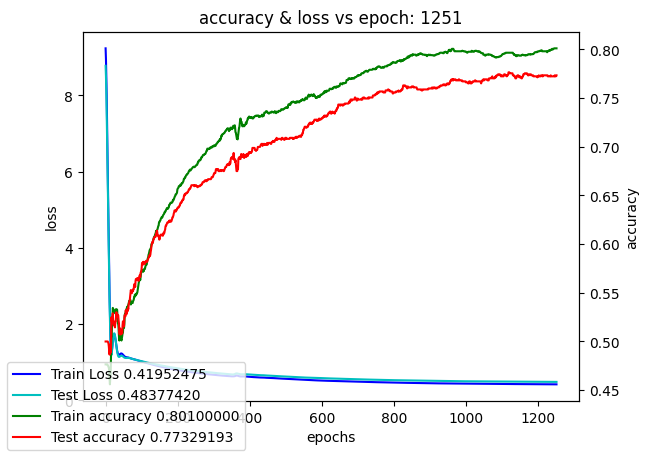

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1260/10000 [47:22<5:25:44,  2.24s/it]

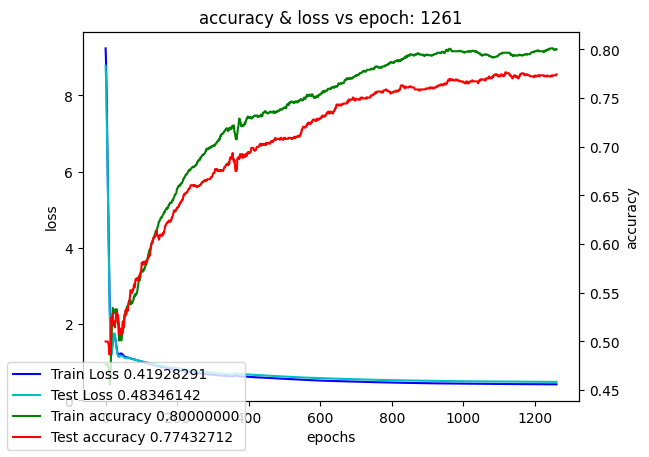

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1270/10000 [47:44<5:25:35,  2.24s/it]

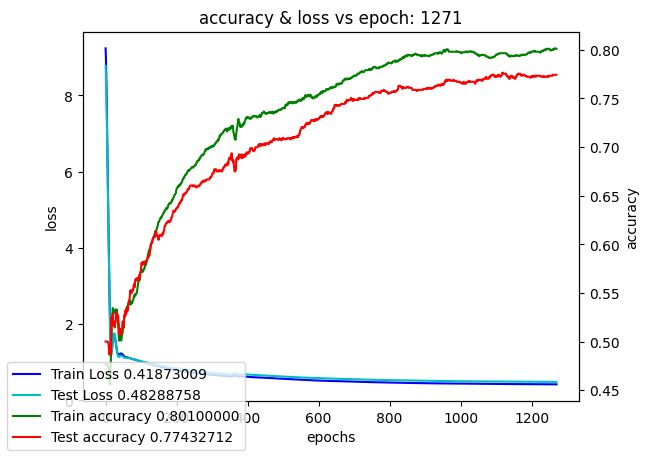

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1280/10000 [48:07<5:24:19,  2.23s/it]

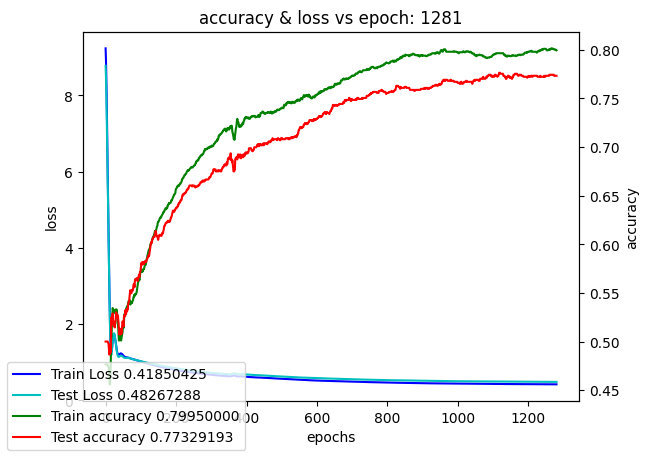

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1290/10000 [48:29<5:24:07,  2.23s/it]

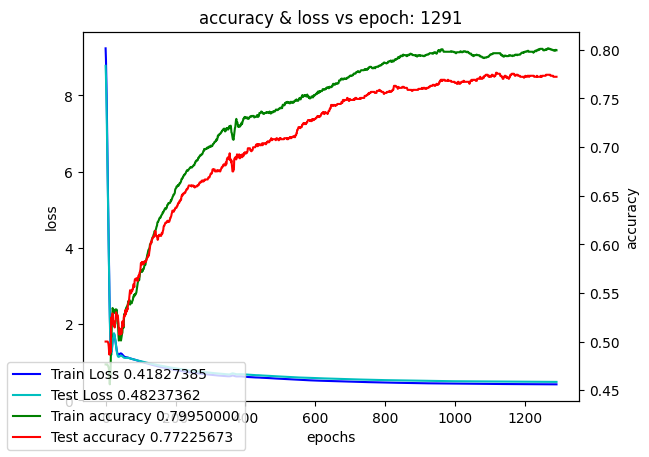

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1300/10000 [48:51<5:23:22,  2.23s/it]

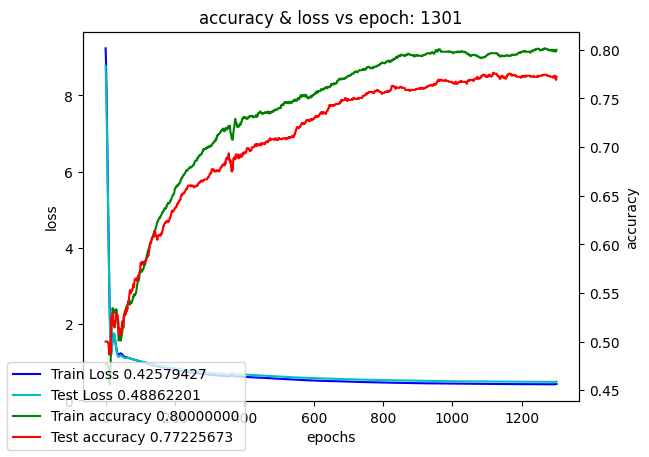

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1310/10000 [49:14<5:23:28,  2.23s/it]

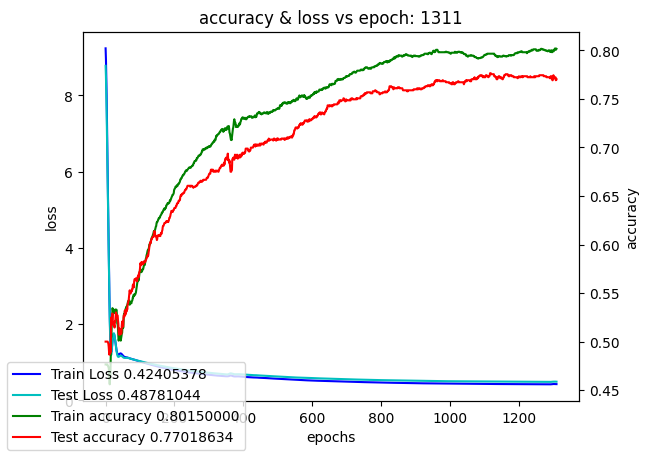

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1320/10000 [49:37<5:22:23,  2.23s/it]

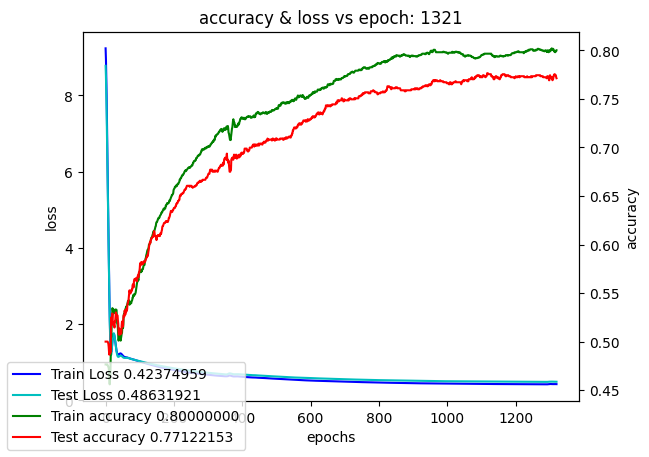

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1330/10000 [49:59<5:23:06,  2.24s/it]

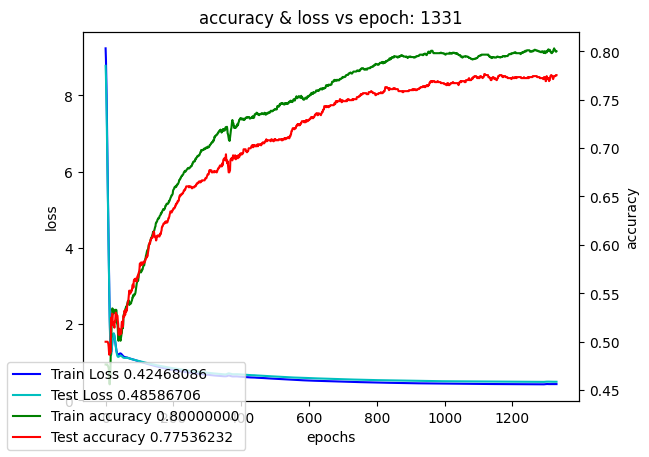

Training model color_cnn_multi_kernel_multi_layer:  13%|█▎        | 1340/10000 [50:22<5:21:45,  2.23s/it]

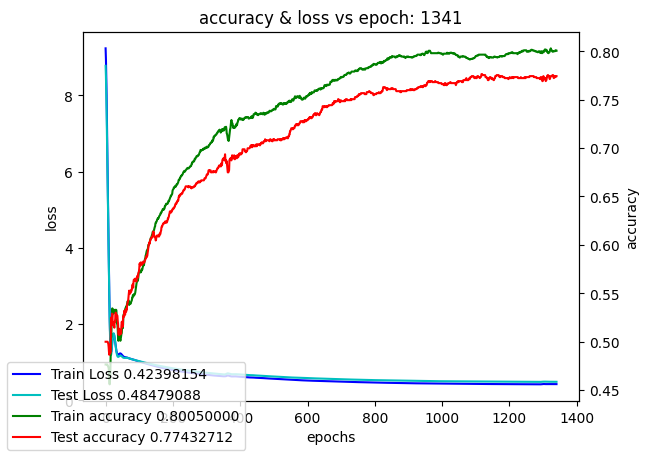

Training model color_cnn_multi_kernel_multi_layer:  14%|█▎        | 1350/10000 [50:44<5:22:17,  2.24s/it]

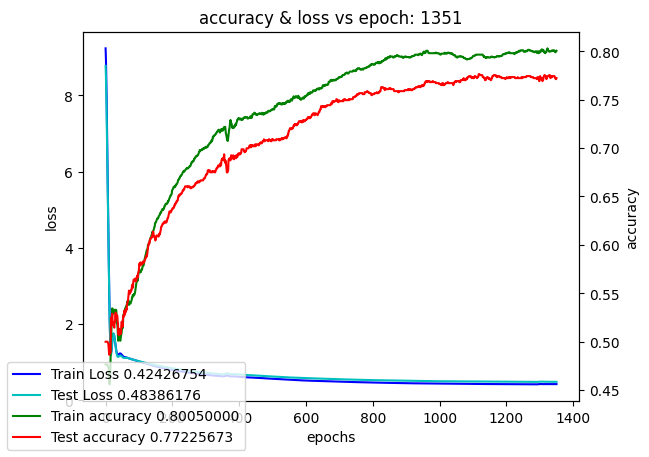

Training model color_cnn_multi_kernel_multi_layer:  14%|█▎        | 1360/10000 [51:07<5:21:23,  2.23s/it]

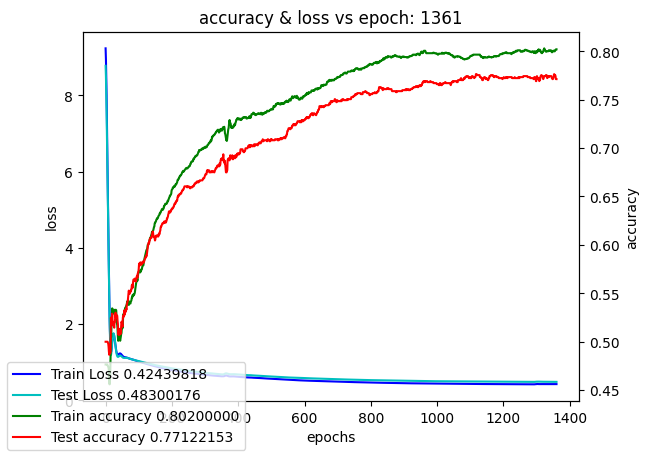

Training model color_cnn_multi_kernel_multi_layer:  14%|█▎        | 1370/10000 [51:29<5:22:08,  2.24s/it]

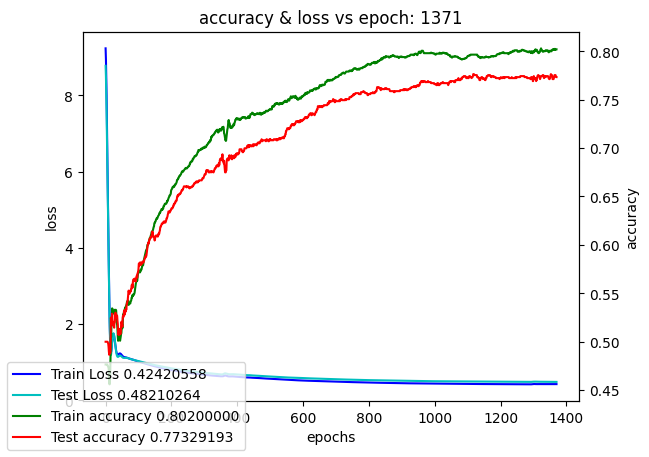

Training model color_cnn_multi_kernel_multi_layer:  14%|█▍        | 1380/10000 [51:52<5:21:42,  2.24s/it]

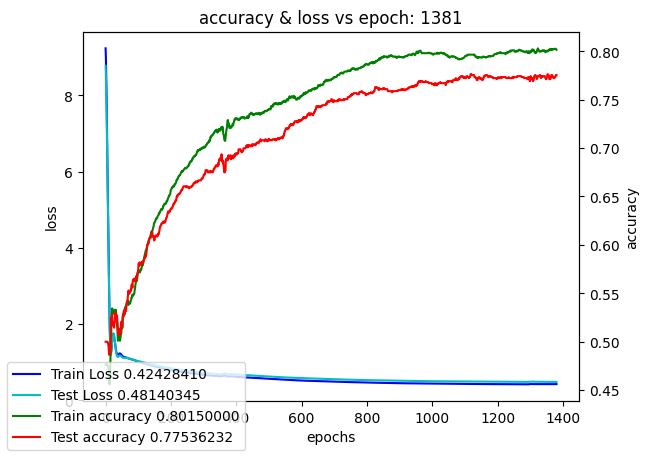

Training model color_cnn_multi_kernel_multi_layer:  14%|█▍        | 1390/10000 [52:14<5:19:55,  2.23s/it]

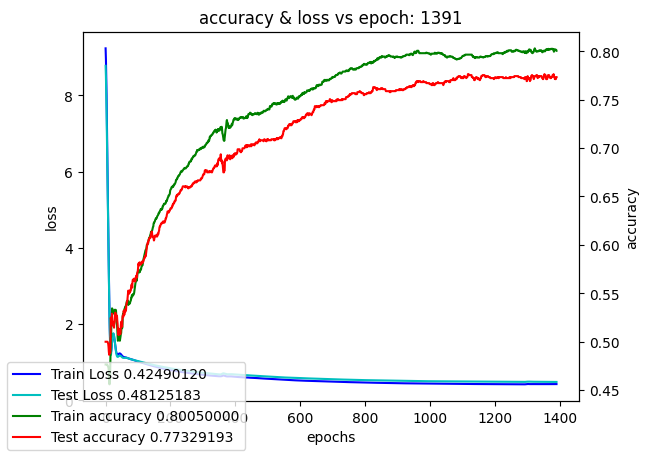

Training model color_cnn_multi_kernel_multi_layer:  14%|█▍        | 1400/10000 [52:37<5:19:38,  2.23s/it]

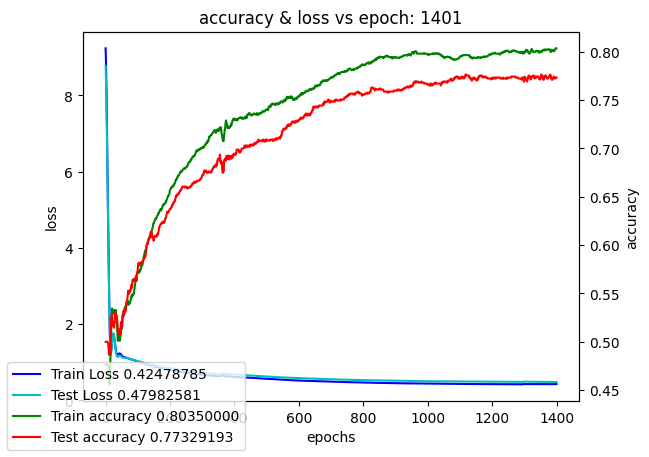

Training model color_cnn_multi_kernel_multi_layer:  14%|█▍        | 1410/10000 [52:59<5:20:23,  2.24s/it]

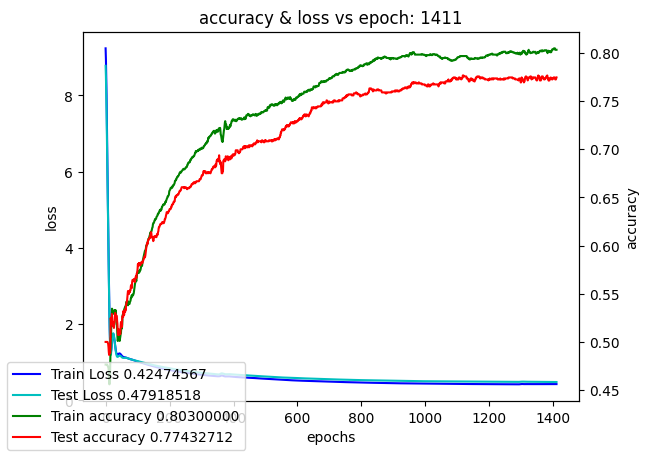

Training model color_cnn_multi_kernel_multi_layer:  14%|█▍        | 1420/10000 [53:22<5:19:43,  2.24s/it]

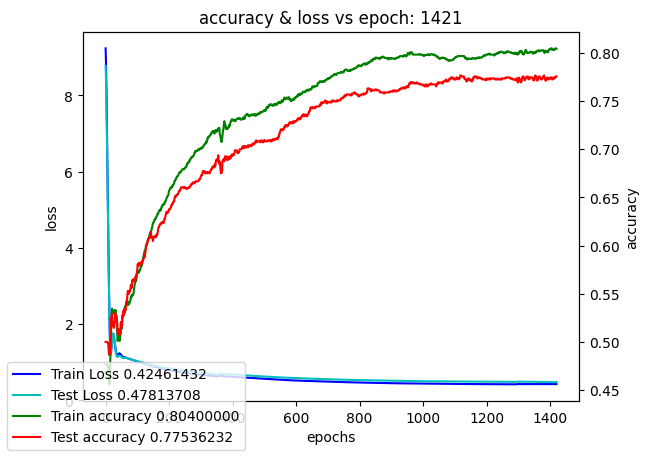

Training model color_cnn_multi_kernel_multi_layer:  14%|█▍        | 1430/10000 [53:45<5:19:25,  2.24s/it]

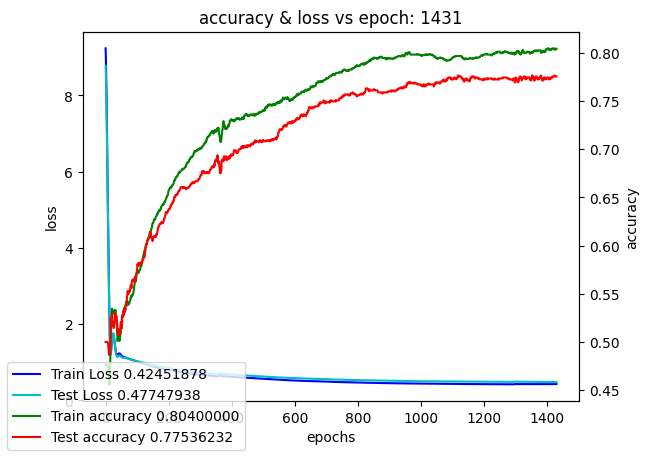

Training model color_cnn_multi_kernel_multi_layer:  14%|█▍        | 1440/10000 [54:07<5:19:32,  2.24s/it]

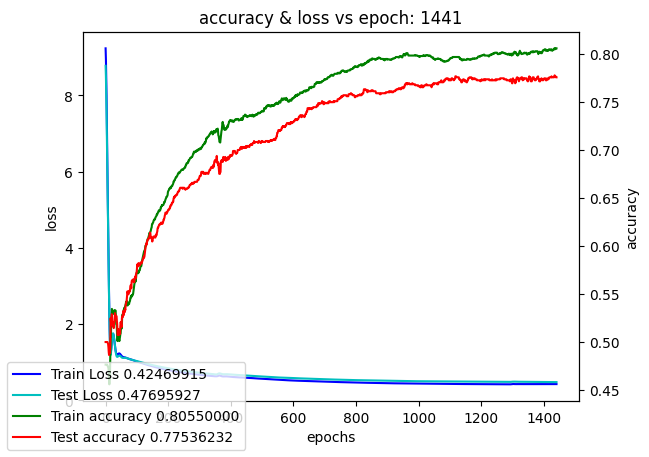

Training model color_cnn_multi_kernel_multi_layer:  14%|█▍        | 1450/10000 [54:30<5:18:47,  2.24s/it]

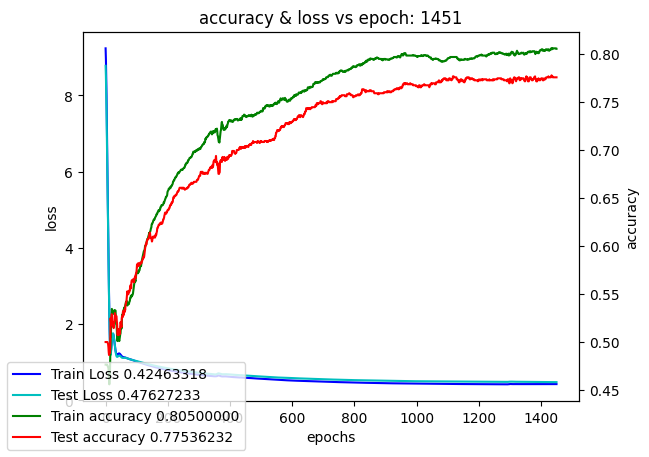

Training model color_cnn_multi_kernel_multi_layer:  15%|█▍        | 1460/10000 [54:52<5:17:16,  2.23s/it]

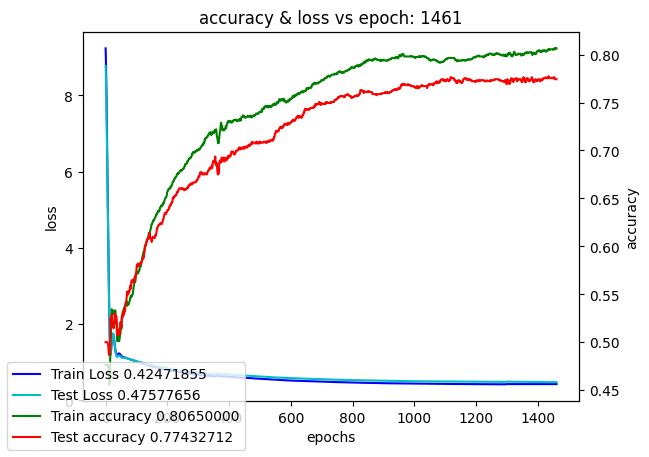

Training model color_cnn_multi_kernel_multi_layer:  15%|█▍        | 1463/10000 [55:00<5:21:02,  2.26s/it]

Early stopping at epoch 1463


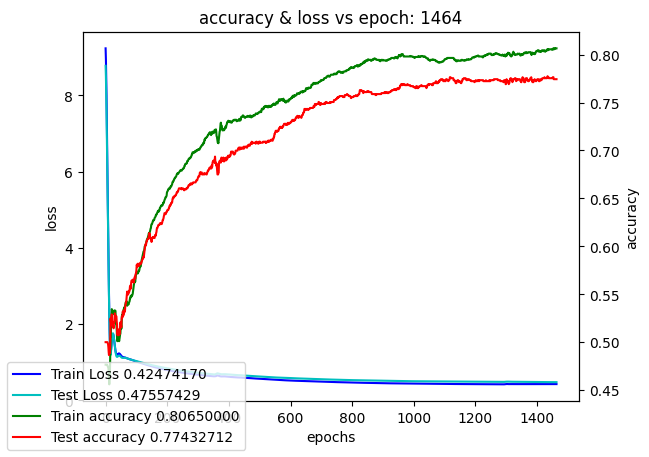

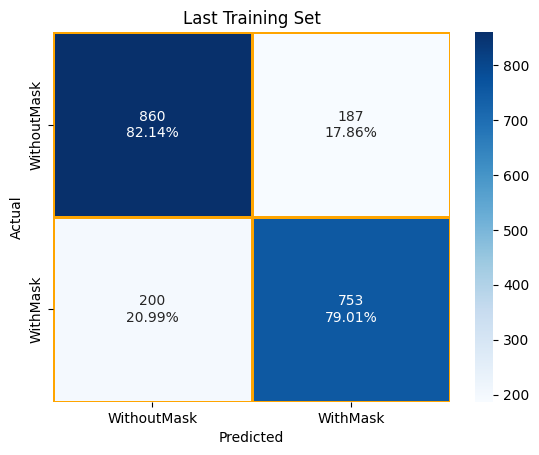

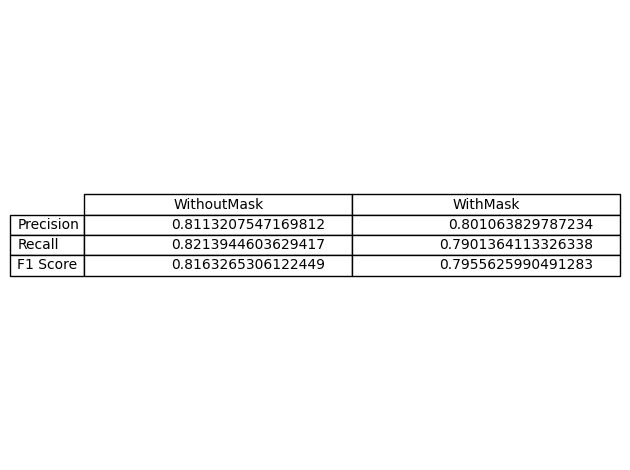

           WithoutMask  WithMask
Precision     0.811321  0.801064
Recall        0.821394  0.790136
F1 Score      0.816327  0.795563


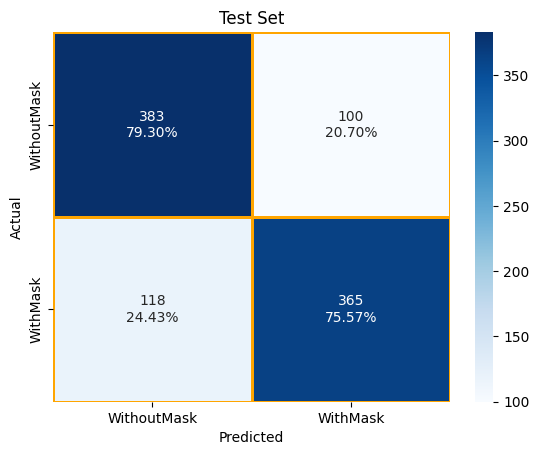

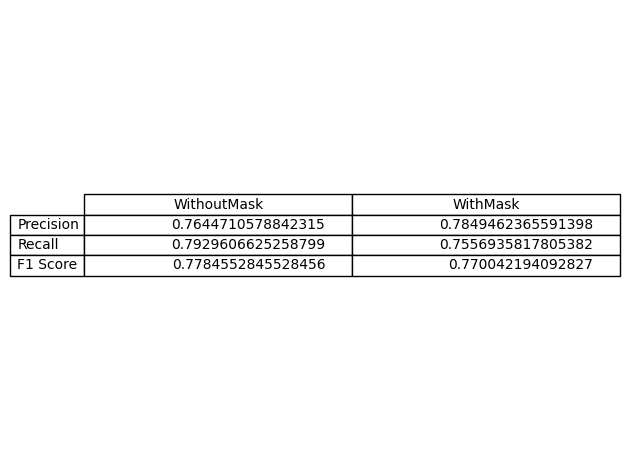

           WithoutMask  WithMask
Precision     0.764471  0.784946
Recall        0.792961  0.755694
F1 Score      0.778455  0.770042
Training Accuracy :  0.8065
Test Accuracy :  0.7743271221532091
Run time (minutes) :  55.01656121309995
model saved at file_path='/content/drive/My Drive/CS583/models/color_cnn_multi_kernel_multi_layer/color_cnn_multi_kernel_multi_layer_2025-11-04 13:15:45.680270.pkl'


In [ ]:
color_cnn_multi_kernel_multi_layer_path = os.path.join(data_path, 'color_cnn_multi_kernel_multi_layer')
os.makedirs(color_cnn_multi_kernel_multi_layer_path, exist_ok=True)

# find pkl model and load it if it exists
CNN = None
for _file in os.listdir(color_cnn_multi_kernel_multi_layer_path):
  if _file.endswith('.pkl'):
    CNN = Model.import_model(os.path.join(color_cnn_multi_kernel_multi_layer_path, _file))
    break
if CNN is None:
  is_adaptive_learning = True
  cnn_multiple_layers = [
    ConvolutionalLayer(3, channels=channels, number_kernels=num_classes**2, is_adaptive=is_adaptive_learning, weight_initializer=kaiming_initialization),
    ReLU(),
    MaxPoolingLayer(2, stride=2),
    ConvolutionalLayer(3, channels=num_classes**2, number_kernels=num_classes, is_adaptive=is_adaptive_learning, weight_initializer=kaiming_initialization),
    ReLU(),
    MaxPoolingLayer(2, stride=2),
    FlatteningLayer(),
    FullyConnectedLayer(-1, num_classes, is_adaptive=is_adaptive_learning, weight_initializer=xavier_initialization_uniform),
    SoftmaxLayer(),
    CrossEntropy()
]
  CNN = Model(cnn_multiple_layers, name='color_cnn_multi_kernel_multi_layer')
  CNN.set_layers_input_shapes(x_train[0:1].shape)
  CNN.train_model(
      x_train,
      y_train,
      x_test,
      y_test,
      y_class_labels=train_class_labels,
      max_epochs=int(1e4),
      learning_rate=1e-3,
      # need higher loss to get same results
      min_loss=1e-7,
      batch_size=None,
      file_path = color_cnn_multi_kernel_multi_layer_path
  )
  CNN.save_model(color_cnn_multi_kernel_multi_layer_path)

## Grayscale CNN


#### load grayscale data

In [ ]:
from os.path import join
import cv2
dataset_path = join(fetch_dataset_path(), 'dataset')
TESTING, TRAINING = join(dataset_path, 'Testing'), join(dataset_path, 'Training')

# IMAGE_MODE = cv2.IMREAD_COLOR
IMAGE_MODE = cv2.IMREAD_GRAYSCALE
image_size = (40, 40)

x_train_gray, y_train_gray, train_class_labels = load_images_from_directory(TRAINING, image_size, image_mode = IMAGE_MODE)
x_test_gray, y_test_gray, test_class_labels = load_images_from_directory(TESTING, image_size, image_mode = IMAGE_MODE)
assert set(train_class_labels) == set(test_class_labels)
num_classes = len(set(train_class_labels))
print(f'{x_train_gray.shape=}, {y_train_gray.shape=}')
print(f'{x_test_gray.shape=}, {y_test_gray.shape=}')
gray_channels = x_train_gray.shape[-1]
assert x_train_gray.shape[0] == y_train_gray.shape[0]
assert x_test_gray.shape[0] == y_test_gray.shape[0]

import matplotlib.pyplot as plt
plt.imshow(x_train_gray[0], cmap='gray')
plt.show()

### 1. Simple CNN on grayscale version of images.

In [ ]:
gray_cnn_single_kernel_path = os.path.join(data_path, 'gray_cnn_single_kernel')
os.makedirs(gray_cnn_single_kernel_path, exist_ok=True)

# find pkl model and load it if it exists
CNN = None
for _file in os.listdir(gray_cnn_single_kernel_path):
  if _file.endswith('.pkl'):
    # CNN = Model.import_model(os.path.join(gray_cnn_single_kernel_path, _file))
    break
if CNN is None:
  is_adaptive_learning = True
  layers_single_kernel_gray = [
      ConvolutionalLayer(9, channels=gray_channels, number_kernels=1, is_adaptive=is_adaptive_learning, weight_initializer=kaiming_initialization),
      ReLU(),
      MaxPoolingLayer(2, stride=2),
      FlatteningLayer(),
      FullyConnectedLayer(-1, num_classes, is_adaptive=is_adaptive_learning, weight_initializer=xavier_initialization_uniform),
      SoftmaxLayer(),
      CrossEntropy()
  ]
  CNN = Model(layers_single_kernel_gray, name='gray_cnn_single_kernel')
  CNN.set_layers_input_shapes(x_train_gray[0:1].shape)
  CNN.train_model(
      x_train_gray,
      y_train_gray,
      x_test_gray,
      y_test_gray,
      y_class_labels=train_class_labels,
      max_epochs=int(1e4),
      learning_rate=1e-3,
      # doesn't perfom well if less than 1e-4
      min_loss=1e-4,
      batch_size=None,
      file_path = gray_cnn_single_kernel_path
  )
  CNN.save_model(gray_cnn_single_kernel_path)

### 5. (extra) CNN multi kernel on grayscale images

In [ ]:
gray_cnn_multi_kernel_path = os.path.join(data_path, 'gray_cnn_multi_kernel')
os.makedirs(gray_cnn_multi_kernel_path, exist_ok=True)

# find pkl model and load it if it exists
CNN = None
for _file in os.listdir(gray_cnn_multi_kernel_path):
  if _file.endswith('.pkl'):
    CNN = Model.import_model(os.path.join(gray_cnn_multi_kernel_path, _file))
    break
if CNN is None:
  is_adaptive_learning = True
  layers_single_kernel_gray = [
      ConvolutionalLayer(9, channels=gray_channels, number_kernels=num_classes, is_adaptive=is_adaptive_learning, weight_initializer=kaiming_initialization),
      ReLU(),
      MaxPoolingLayer(2, stride=2),
      FlatteningLayer(),
      FullyConnectedLayer(-1, num_classes, is_adaptive=is_adaptive_learning, weight_initializer=xavier_initialization_uniform),
      SoftmaxLayer(),
      CrossEntropy()
  ]
  CNN = Model(layers_single_kernel_gray, name='gray_cnn_multi_kernel')
  CNN.set_layers_input_shapes(x_train_gray[0:1].shape)
  CNN.train_model(
      x_train_gray,
      y_train_gray,
      x_test_gray,
      y_test_gray,
      y_class_labels=train_class_labels,
      max_epochs=int(1e4),
      learning_rate=1e-3,
      # doesn't perfom well if less than 1e-4
      min_loss=1e-6,
      batch_size=None,
      file_path = gray_cnn_multi_kernel_path
  )
  CNN.save_model(gray_cnn_multi_kernel_path)

# bottom

In [ ]:
# random stuff goes here